### Required Libraries

In [1]:
import numpy as np 
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import statsmodels.api as sm
import statsmodels.formula.api as smf
from sklearn.model_selection import train_test_split #Package to split a dataframe into train and test data
from sklearn import neighbors # To implement kNN algorithm
from sklearn.metrics import mean_squared_error  #Package to calculate mean square error
from math import sqrt 
from sklearn import linear_model #To implement linear regression model
import os
import re
import pprint
from sklearn.impute import SimpleImputer # To perform data imputation
from sklearn.metrics import mean_absolute_error

from statsmodels.tsa.arima_model import ARMA
from statsmodels.tsa.statespace.sarimax import SARIMAX
from pylab import rcParams

### Reading the dataset

In [2]:
filename = '/Users/vegi/Documents/USC_Masters/ML/DemandForecasts/cp_forecasting_data_till_201903.csv'
df = pd.read_csv(filename,parse_dates=['order_creation_date_id'],index_col='order_creation_date_id')
df.head()

,source_sku_id,sku_description,cp
order_creation_date_id,,,
2014-08-01,10000148,Fresho onion 1 kg,29.21
2018-12-15,10000031,Fresho banana-yelakki 1 kg,40.41
2014-03-08,10000067,Fresho capsicum-green 1 kg,21.14
2017-08-28,10000200,Fresho tomato-hybrid 1 kg,39.43
2019-02-15,10000159,Fresho potato 1 kg,17.68


In [3]:
unique_products  = df['sku_description'].unique()
print("The {0} different products are -{1}".format(len(unique_products),unique_products))

sku_pc_metric = np.sum([1 if 'pc' in sku else 0 for sku in unique_products])
print("\n\nThe number of SKUs with kgs metric:{0}".format(len(unique_products)-sku_pc_metric))
print("\nThe number of SKUs with pcs metric:{0}".format(sku_pc_metric))

The 15 different products are -['Fresho onion 1 kg' 'Fresho banana-yelakki 1 kg'
 'Fresho capsicum-green 1 kg' 'Fresho tomato-hybrid 1 kg'
 'Fresho potato 1 kg' 'Fresho cucumber-english 1 kg'
 'Fresho cucumber 1 kg' 'Fresho ridge-gourd 1 kg'
 'Fresho ladies-finger 1 kg' 'Fresho banana-robusta 1 kg'
 'Fresho tomato-local 1 kg' 'Fresho bottle-gourd 1 kg'
 'Fresho watermelon-small 1 pc  1.7 - 2.5 kg' 'Fresho beetroot 1 kg'
 'Fresho carrot-local 1 kg']


The number of SKUs with kgs metric:14

The number of SKUs with pcs metric:1


### Number of observations per SKU

In [4]:
pd.set_option('display.max_row', 100)

observations_per_SKU = []
for skuname in unique_products:
    shape = df[df['sku_description']==skuname].shape
    observations_per_SKU.append(shape[0])

observations_summary = pd.DataFrame({'SKU':unique_products,'Observations per SKU':observations_per_SKU})
observations_summary.style

,SKU,Observations per SKU
0,Fresho onion 1 kg,2671
1,Fresho banana-yelakki 1 kg,2674
2,Fresho capsicum-green 1 kg,2273
3,Fresho tomato-hybrid 1 kg,2675
4,Fresho potato 1 kg,2676
5,Fresho cucumber-english 1 kg,2100
6,Fresho cucumber 1 kg,2671
7,Fresho ridge-gourd 1 kg,2637
8,Fresho ladies-finger 1 kg,2657
9,Fresho banana-robusta 1 kg,2666


In [5]:
observations_summary.to_csv("/Users/vegi/Documents/USC_Masters/ML/DemandForecasts/observations_summary.csv", sep=",", float_format='%.2f',index=False, line_terminator='\n',encoding='utf-8')

### Start date of each SKU

In [6]:
start_dates = []
observations_present = []
for skuname in unique_products:
    temp_df = df[df['sku_description']==skuname]
    index = temp_df.index
    start_dates.append(min(index))
    observations_present.append(max(index)-min(index))
sku_start_date = pd.DataFrame({'SKU':unique_products,'Start Date':start_dates,'Expected Observations':
                               observations_present,'Observations per SKU':observations_per_SKU})

sku_start_date.style

,SKU,Start Date,Expected Observations,Observations per SKU
0,Fresho onion 1 kg,2011-12-03 00:00:00,2675 days 00:00:00,2671
1,Fresho banana-yelakki 1 kg,2011-12-03 00:00:00,2675 days 00:00:00,2674
2,Fresho capsicum-green 1 kg,2011-12-04 00:00:00,2674 days 00:00:00,2273
3,Fresho tomato-hybrid 1 kg,2011-12-03 00:00:00,2675 days 00:00:00,2675
4,Fresho potato 1 kg,2011-12-03 00:00:00,2675 days 00:00:00,2676
5,Fresho cucumber-english 1 kg,2013-04-21 00:00:00,2170 days 00:00:00,2100
6,Fresho cucumber 1 kg,2011-12-03 00:00:00,2675 days 00:00:00,2671
7,Fresho ridge-gourd 1 kg,2011-12-03 00:00:00,2675 days 00:00:00,2637
8,Fresho ladies-finger 1 kg,2011-12-04 00:00:00,2674 days 00:00:00,2657
9,Fresho banana-robusta 1 kg,2011-12-04 00:00:00,2674 days 00:00:00,2666


In [11]:
sku_start_date.to_csv("/Users/vegi/Documents/USC_Masters/ML/DemandForecasts/sku_start_date.csv", sep=",", float_format='%.2f',index=False, line_terminator='\n',encoding='utf-8')

In [12]:
# Splitting the product names into a list of words
unique_products_split = []
for prod in unique_products:
    unique_products_split.append(prod.split())

In [9]:
for i,prod_split in enumerate(unique_products_split):
    #Checking the metric
    if prod_split[-1]!='gm' and prod_split[-1]!='kg' and not prod_split[-1].startswith('pc'):
        temp_split = prod_split[-1].split('-')
        prod_split.pop()
        #For uniformity - changing the SKUs with just g in metric to gm
        if 'g' in temp_split[-1] and 'kg' not in temp_split[-1]:
            num = ""
            for char in temp_split[-1]:
                if char.isdigit():
                    num = num+char
            unique_products_split[i].extend([num,'gm'])
unique_products_split

[['Fresho', 'onion', '1', 'kg'],
 ['Fresho', 'banana-yelakki', '1', 'kg'],
 ['Fresho', 'capsicum-green', '1', 'kg'],
 ['Fresho', 'tomato-hybrid', '1', 'kg'],
 ['Fresho', 'potato', '1', 'kg'],
 ['Fresho', 'cucumber-english', '1', 'kg'],
 ['Fresho', 'cucumber', '1', 'kg'],
 ['Fresho', 'ridge-gourd', '1', 'kg'],
 ['Fresho', 'ladies-finger', '1', 'kg'],
 ['Fresho', 'banana-robusta', '1', 'kg'],
 ['Fresho', 'tomato-local', '1', 'kg'],
 ['Fresho', 'bottle-gourd', '1', 'kg'],
 ['Fresho', 'watermelon-small', '1', 'pc', '1.7', '-', '2.5', 'kg'],
 ['Fresho', 'beetroot', '1', 'kg'],
 ['Fresho', 'carrot-local', '1', 'kg']]

__watermelon-small__<br>
In the below cell we fix the above anomaly, the above product has quantities in both pcs and kgs, we strip off the kgs metric

In [10]:
#Iterating over all products again and making changes to products that have quantities in both kgs and pcs
for i,prod_split in enumerate(unique_products_split):
    if prod_split[-1]!='gm' and prod_split[-1]!='kg' and not prod_split[-1].startswith('pc'):
        temp_split = prod_split[-1].split('-')
        prod_split.pop()
        if 'g' in temp_split[-1] and 'kg' not in temp_split[-1]:
            num = ""
            for char in temp_split[-1]:
                if char.isdigit():
                    num = num+char
            unique_products_split[i].extend([num,'gm'])

    #For cases where both pcs and kg/gm are present in the SKU
    if ('kg' in prod_split or 'gm' in prod_split or 'gms' in prod_split) and ('pc' in prod_split or 'pcs' in prod_split):
        print("Anomaly:",prod_split)
        pcs_idx = [i for i, item in enumerate(prod_split) if re.search('pc', item)]
        unique_products_split[i] = prod_split[:pcs_idx[0]+1] 
        print("After fixing anomaly:",unique_products_split[i])
        print('\n')

Anomaly: ['Fresho', 'watermelon-small', '1', 'pc', '1.7', '-', '2.5', 'kg']
After fixing anomaly: ['Fresho', 'watermelon-small', '1', 'pc']




### Obtaining Normalizing factor based on metric
1. Per piece price for SKUs having the metric as 'pc'<br>
2. Per gram price for SKUs having the metric as 'kg'/'gm'

In [10]:
normalize_price_factor = []
for prod_split in unique_products_split:
    if ('kg' in prod_split or 'gm' in prod_split or 'gms' in prod_split) and ('pc' in prod_split or 'pcs' in prod_split):
        print(prod_split)
    if prod_split[-1]=='kg':
        price_factor = abs(float(prod_split[-2])*1000)
        normalize_price_factor.append(1/price_factor)
        continue
    elif prod_split[-1]=='gm':
        price_factor = abs(float(prod_split[-2]))
        normalize_price_factor.append(1/price_factor)
        continue
    elif prod_split[-1].startswith('pc'):
        price_factor = abs(float(prod_split[-2]))
        normalize_price_factor.append(1/price_factor)
        continue

### Displaying the Normalizing Price Factor for each product

In [11]:
df_prize_factor_summary = pd.DataFrame({'Unique Products':unique_products_split,'Normalized Prize Factor':normalize_price_factor})
df_prize_factor_summary.style

,Unique Products,Normalized Prize Factor
0,"['Fresho', 'onion', '1', 'kg']",0.001
1,"['Fresho', 'banana-yelakki', '1', 'kg']",0.001
2,"['Fresho', 'capsicum-green', '1', 'kg']",0.001
3,"['Fresho', 'tomato-hybrid', '1', 'kg']",0.001
4,"['Fresho', 'potato', '1', 'kg']",0.001
5,"['Fresho', 'cucumber-english', '1', 'kg']",0.001
6,"['Fresho', 'cucumber', '1', 'kg']",0.001
7,"['Fresho', 'ridge-gourd', '1', 'kg']",0.001
8,"['Fresho', 'ladies-finger', '1', 'kg']",0.001
9,"['Fresho', 'banana-robusta', '1', 'kg']",0.001


In [12]:
#Creating a copy of the dataframe
modified_df = df.copy()

#Creating a normalized price column
modified_df['Normalized Price'] = 0.0

#Iterating over each of the 65 unique products and calculating the pertaining Normalized price
for i,prod in enumerate(unique_products):
    modified_df.loc[modified_df['sku_description']==prod,'Normalized Price'] = modified_df['cp'][modified_df['sku_description']==prod]*normalize_price_factor[i]
    
    
modified_df.head()

,source_sku_id,sku_description,cp,Normalized Price
order_creation_date_id,,,,
2014-08-01,10000148,Fresho onion 1 kg,29.21,0.02921
2018-12-15,10000031,Fresho banana-yelakki 1 kg,40.41,0.04041
2014-03-08,10000067,Fresho capsicum-green 1 kg,21.14,0.02114
2017-08-28,10000200,Fresho tomato-hybrid 1 kg,39.43,0.03943
2019-02-15,10000159,Fresho potato 1 kg,17.68,0.01768


In [13]:
dict_prod_factor = {}
for i,prod in enumerate(unique_products):
    dict_prod_factor[prod] = normalize_price_factor[i]

pp = pprint.PrettyPrinter(depth=6)
pp.pprint(dict_prod_factor)

{'Fresho banana-robusta 1 kg': 0.001,
 'Fresho banana-yelakki 1 kg': 0.001,
 'Fresho beetroot 1 kg': 0.001,
 'Fresho bottle-gourd 1 kg': 0.001,
 'Fresho capsicum-green 1 kg': 0.001,
 'Fresho carrot-local 1 kg': 0.001,
 'Fresho cucumber 1 kg': 0.001,
 'Fresho cucumber-english 1 kg': 0.001,
 'Fresho ladies-finger 1 kg': 0.001,
 'Fresho onion 1 kg': 0.001,
 'Fresho potato 1 kg': 0.001,
 'Fresho ridge-gourd 1 kg': 0.001,
 'Fresho tomato-hybrid 1 kg': 0.001,
 'Fresho tomato-local 1 kg': 0.001,
 'Fresho watermelon-small 1 pc  1.7 - 2.5 kg': 1.0}


In [14]:
#Adding a product group column
modified_df['PROD_GROUP'] = None
modified_df.head()

,source_sku_id,sku_description,cp,Normalized Price,PROD_GROUP
order_creation_date_id,,,,,
2014-08-01,10000148,Fresho onion 1 kg,29.21,0.02921,None
2018-12-15,10000031,Fresho banana-yelakki 1 kg,40.41,0.04041,None
2014-03-08,10000067,Fresho capsicum-green 1 kg,21.14,0.02114,None
2017-08-28,10000200,Fresho tomato-hybrid 1 kg,39.43,0.03943,None
2019-02-15,10000159,Fresho potato 1 kg,17.68,0.01768,None


### Associating each product with a product group

In [15]:
prod_dict = {}
for prod in unique_products_split:
    #Forming a different value for SKUs measured in pieces
    """
    if prod[-1] == 'pc' or prod[-1] == 'pcs':
        prod_words = prod[1].split('-')
        value = '' 
        for word in prod_words:
            value = value+' '+word
        value = value.strip()
        #Changed the S here
        value = value+' '+'pcs'
        prod_dict[prod[1]+'-pcs'] = value
    """
    #Forming a value for SKUs measured in gms/kgs
    if prod[1] not in prod_dict:
        prod_words = prod[1].split('-')
        value = '' 
        for word in prod_words:
            value = value+' '+word
        value = value.strip()
        prod_dict[prod[1]] = value
    #If a key has been formed for a product alread, we continue
    else:
        continue

pp = pprint.PrettyPrinter(depth=6)
pp.pprint(prod_dict)

{'banana-robusta': 'banana robusta',
 'banana-yelakki': 'banana yelakki',
 'beetroot': 'beetroot',
 'bottle-gourd': 'bottle gourd',
 'capsicum-green': 'capsicum green',
 'carrot-local': 'carrot local',
 'cucumber': 'cucumber',
 'cucumber-english': 'cucumber english',
 'ladies-finger': 'ladies finger',
 'onion': 'onion',
 'potato': 'potato',
 'ridge-gourd': 'ridge gourd',
 'tomato-hybrid': 'tomato hybrid',
 'tomato-local': 'tomato local',
 'watermelon-small': 'watermelon small'}


In [16]:
for i,prod in enumerate(unique_products_split):
    
    #Getting the key for the dictionary
    #if prod[-1] == 'pc' or prod[-1] == 'pcs':
        #print("Product:",split_prod[1])
    #    key = (prod[1]+'-pcs')
    #else:
    key = prod[1]
        
    modified_df.loc[(modified_df['sku_description']==unique_products[i]),'PROD_GROUP'] = prod_dict[key]

modified_df.head()

,source_sku_id,sku_description,cp,Normalized Price,PROD_GROUP
order_creation_date_id,,,,,
2014-08-01,10000148,Fresho onion 1 kg,29.21,0.02921,onion
2018-12-15,10000031,Fresho banana-yelakki 1 kg,40.41,0.04041,banana yelakki
2014-03-08,10000067,Fresho capsicum-green 1 kg,21.14,0.02114,capsicum green
2017-08-28,10000200,Fresho tomato-hybrid 1 kg,39.43,0.03943,tomato hybrid
2019-02-15,10000159,Fresho potato 1 kg,17.68,0.01768,potato


In [17]:
prod_groups = modified_df['PROD_GROUP'].unique()
print("The {0} different product groups are -{1}".format(len(prod_groups),prod_groups))

The 15 different product groups are -['onion' 'banana yelakki' 'capsicum green' 'tomato hybrid' 'potato'
 'cucumber english' 'cucumber' 'ridge gourd' 'ladies finger'
 'banana robusta' 'tomato local' 'bottle gourd' 'watermelon small'
 'beetroot' 'carrot local']


### Dictionary between product group and unique_products_split

In [18]:
dict_prod_group_prod_split = {}
for prod in prod_groups:
    #print("Product:",prod)
    for i in unique_products_split:
        check_in = [word for word in i[1].split('-')]
        check_in = ' '.join(check_in)
        if prod in check_in:
            #print(prod,i[1])
            dict_prod_group_prod_split[prod] = i

pp = pprint.PrettyPrinter(depth=6)
pp.pprint(dict_prod_group_prod_split)

{'banana robusta': ['Fresho', 'banana-robusta', '1', 'kg'],
 'banana yelakki': ['Fresho', 'banana-yelakki', '1', 'kg'],
 'beetroot': ['Fresho', 'beetroot', '1', 'kg'],
 'bottle gourd': ['Fresho', 'bottle-gourd', '1', 'kg'],
 'capsicum green': ['Fresho', 'capsicum-green', '1', 'kg'],
 'carrot local': ['Fresho', 'carrot-local', '1', 'kg'],
 'cucumber': ['Fresho', 'cucumber', '1', 'kg'],
 'cucumber english': ['Fresho', 'cucumber-english', '1', 'kg'],
 'ladies finger': ['Fresho', 'ladies-finger', '1', 'kg'],
 'onion': ['Fresho', 'onion', '1', 'kg'],
 'potato': ['Fresho', 'potato', '1', 'kg'],
 'ridge gourd': ['Fresho', 'ridge-gourd', '1', 'kg'],
 'tomato hybrid': ['Fresho', 'tomato-hybrid', '1', 'kg'],
 'tomato local': ['Fresho', 'tomato-local', '1', 'kg'],
 'watermelon small': ['Fresho', 'watermelon-small', '1', 'pc']}


In [19]:
df_names = []
all_datasets = []

df_prod_group = modified_df.loc[:,:].copy()

for i,prod in enumerate(prod_groups):
    df_name = ''
    df_name = prod.replace(' ','_')
    df_names.append(df_name)
    temp_df = df_prod_group[(df_prod_group['PROD_GROUP']==prod)]
    vars()[df_name] = temp_df.copy()
    all_datasets.append(vars()[df_name])

### Resampling and taking mean of the daily available data and checking for common trends among different product groups
We take the mean because, in some cases there are multiple observations on a single day

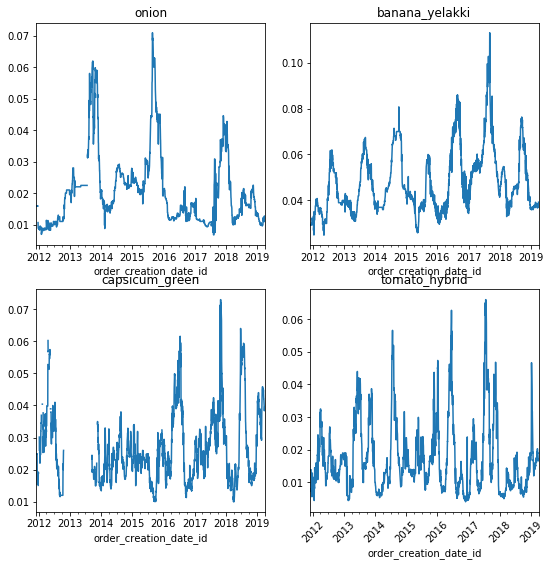

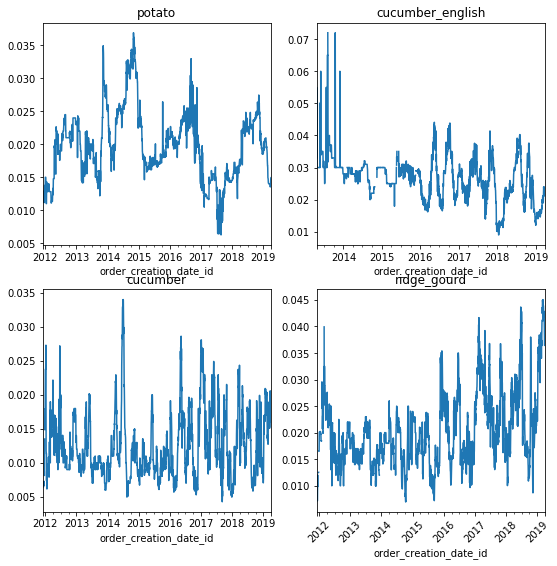

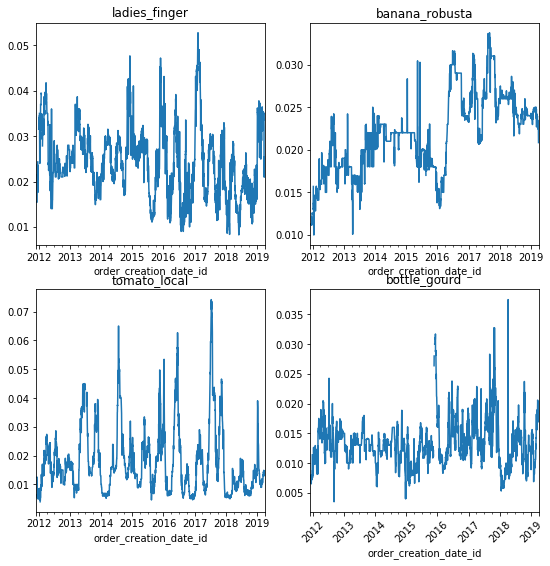

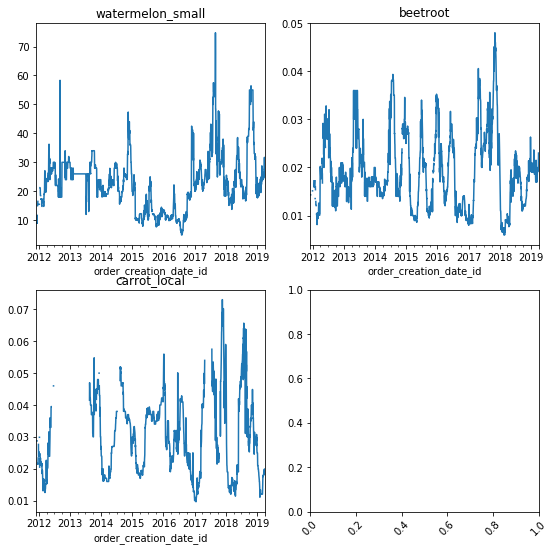

In [20]:
count = 0
for i in range(4):
    fig, ax = plt.subplots(nrows=2, ncols=2,figsize=(9, 9))
    for row in ax:
        for col in row:
        #plt.figure(figsize=(7,7))
            if count!=15:
                all_datasets[count]['Normalized Price'].resample('D').mean().plot(ax=col)
                plt.xticks(rotation=45)
                col.title.set_text(df_names[count])
                count = count+1

### Implementing first for potato (Since it has no missing values)

In [21]:
columns_needed = ['cp','Normalized Price']

temp_df = modified_df[modified_df['PROD_GROUP']=='potato'].loc[:,columns_needed].copy()
temp_df = temp_df.resample('D').mean()

#print(sum(pd.isna(temp_df['Normalized Price'].values)))

### Augmented Dickyfuller Test

In [57]:
from statsmodels.tsa.stattools import adfuller

result = adfuller(temp_df['Normalized Price'].values)
print("Augmented Dickyfuller Test Result:",result)

# Print test statistic
print("\n\nTest Statistic(More -ve, more stationary):",result[0])

# Print p-value
print("\n\nP-Value(If less than 0.05, reject null)",result[1])
print("Reject Null Hypothesis(Series is non-stationary):",result[1]<=0.05)

# Print critical values
print("\n\nCritical Values:",result[4]) 

Augmented Dickyfuller Test Result: (-3.1360593021866294, 0.02399719457553686, 22, 2653, {'1%': -3.432817259126433, '5%': -2.8626300496109773, '10%': -2.5673502709390714}, -29514.688547463247)


Test Statistic(More -ve, more stationary): -3.1360593021866294


P-Value(If less than 0.05, reject null) 0.02399719457553686
Reject Null Hypothesis(Series is non-stationary): True


Critical Values: {'1%': -3.432817259126433, '5%': -2.8626300496109773, '10%': -2.5673502709390714}


### Iterating over different values of p,d,q to find out which model best fits the data

In [524]:
order_scores = []
trend_list = ['n','c','t','ct']
for p in range(4):
    for q in range(4):
        for d in range(3):
            for t in trend_list:
                try:
                    # Instantiate the model
                    #model = SARIMAX(y, order=(p,d,q))
                    model = SARIMAX(temp_df[:-90]['Normalized Price'].values, order=(p,d,q),trend=t)

                    # Fit the model
                    results = model.fit()
                
                    #Prints results
                    order_scores.append((p,d,q,t,results.aic,results.bic))
        
                except:
                    #print("In except")
                    continue
            
order_scores = pd.DataFrame(order_scores,columns=['p','d','q','trend','aic','bic'])

In [525]:
order_scores.sort_values(by='aic').head()

,p,d,q,trend,aic,bic
131,2,0,3,c,-28742.873165,-28701.868092
179,3,0,3,c,-28740.756128,-28693.893188
133,2,0,3,ct,-28738.636688,-28691.773748
181,3,0,3,ct,-28736.593752,-28683.872944
130,2,0,3,n,-28736.185528,-28701.038322


In [22]:
# Instantiate the best model
model = SARIMAX(temp_df[:-90]['Normalized Price'].values, order=(2,0,3),trend='c')
# Fit the model
results = model.fit()

# Print summary
print(results.summary())

# Generate predictions
one_step_forecast = results.get_prediction(start=-30)

# Extract prediction mean
mean_forecast = one_step_forecast.predicted_mean

# Get confidence intervals of predictions
confidence_intervals = one_step_forecast.conf_int()
#print(confidence_intervals)
#print(confidence_intervals[0])
# Select lower and upper confidence limits
lower_limits = [i[0] for i in confidence_intervals]
upper_limits = [i[1] for i in confidence_intervals]
#lower_limits = confidence_intervals.iloc[:,0]
#upper_limits = confidence_intervals.iloc[:,1]

                           Statespace Model Results                           
Dep. Variable:                      y   No. Observations:                 2586
Model:               SARIMAX(2, 0, 3)   Log Likelihood               14378.437
Date:                Fri, 11 Oct 2019   AIC                         -28742.873
Time:                        14:16:15   BIC                         -28701.868
Sample:                             0   HQIC                        -28728.012
                               - 2586                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.0002   5.87e-05      3.536      0.000    9.25e-05       0.000
ar.L1          0.6164      0.059     10.360      0.000       0.500       0.733
ar.L2          0.3729      0.059      6.347      0.0

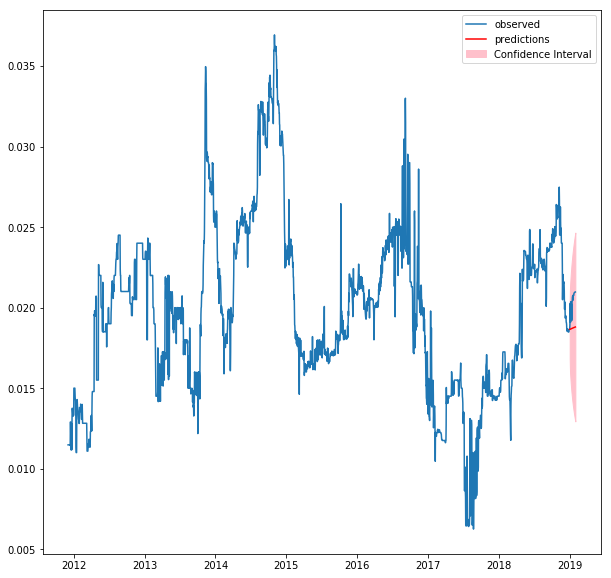

In [23]:
dynamic_forecast_30_days = results.get_forecast(30, alpha=0.05)  # 95% conf

#Mean of forecast
mean_forecast_30_days = dynamic_forecast_30_days.predicted_mean

#Confidence intervals
confidence_intervals_30_days = dynamic_forecast_30_days.conf_int()

lower_limits_30_days = [i[0] for i in confidence_intervals_30_days]
upper_limits_30_days = [i[1] for i in confidence_intervals_30_days]


#Plot the graph
dates = temp_df[:-60].index
dates_2 = dates[-30:]


plt.fill_between(dates_2,lower_limits_30_days,upper_limits_30_days,color='pink',label='Confidence Interval')
plt.legend(loc='best')

### Metrics for 30 days

In [22]:
def diff_csv_mape(cellValCSV1,cellValCSV2):
    diff = np.nan
    if len(cellValCSV1)!=0 and len(cellValCSV2)!=0:
        diff = abs((cellValCSV1 - cellValCSV2)/(cellValCSV1))
    return diff

In [25]:
temp_df_tail = temp_df[:-60].tail(30)
rmse = mean_squared_error(temp_df_tail['Normalized Price'],mean_forecast_30_days)
print("RMSE:",rmse)

print("RMSE on Actual Price:",rmse*1000)

RMSE: 3.021094680546106e-06
RMSE on Actual Price: 0.003021094680546106


In [26]:
cost_price_predictions = mean_forecast_30_days*1000
mae = mean_absolute_error(temp_df_tail['cp'],cost_price_predictions)
print("MAE:",mae)

MAPE_diff = diff_csv_mape(temp_df_tail['cp'],cost_price_predictions)
#print(MAPE_diff)
mape_sum = np.sum(MAPE_diff)
MAPE = mape_sum/30
print("MAPE:",MAPE)

MAE: 1.6132384189757274
MAPE: 0.07830798263985292


### Compute Moving Average for missing data

In [26]:
def moving_average(norm_price):
    index_nan = np.argwhere(np.isnan(norm_price))
    #missing_dates = index_dates[index_nan]
    #print(missing_dates)
    for index in index_nan:
        index_to_use = np.arange(index-3,index)
        sum_last_3 = np.sum(norm_price[index_to_use])
        norm_price[index] = sum_last_3/3
        #print("Dates used:",index_dates[index_to_use])
    #print("Length of New Normalized Price:",len(norm_price))
    
    return norm_price

In [27]:
df_copy = modified_df.copy()
col = modified_df.columns
df_final = pd.DataFrame({},columns=col)

sum = 0
count = 0
for prod in prod_groups:
        print("Product:",prod)
        
        #Obtaining observataions of a particular product
        df_temp = df_copy[df_copy['PROD_GROUP']== prod]
        
        #Obtaing SKU ID--->Column(source_sku_id)
        sku_id = df_temp['source_sku_id'].unique()
        #Obtaing SKU description--->Column(sku_description)
        sku_desc = df_temp['sku_description'].unique()
        
        #Obtaining normalization factor
        normalization_factor = dict_prod_factor[sku_desc[0]]
        
        #Resampling Data
        df_temp = df_temp.resample('D').mean()
        
        #Index of the resampled data
        index_df_temp = df_temp.index
        
        #print(df_temp.head())
        #Printing number of missing values
        #print("Number of missing values:",sum(pd.isna(df_temp['Normalized Price'])))
        
        #print(len(df_test['Normalized Price'].values))
        new_normalized_price = moving_average(df_temp['Normalized Price'].values)

        #print("After function call:")
        #print("Number of missing values:",sum(pd.isna(df_temp['Normalized Price'])))
        
        cp = (new_normalized_price)/normalization_factor
        
        #Creating arrays of product group,sku id and sku description
        prod_group_array = np.full(len(new_normalized_price), prod, order='C')
        sku_id_array = np.full(len(new_normalized_price), sku_id, order='C')
        sku_desc_array = np.full(len(new_normalized_price), sku_desc, order='C')
        
        sum = sum+len(new_normalized_price)
        df_new = pd.DataFrame({'cp':cp,'Normalized Price':new_normalized_price,'PROD_GROUP':prod_group_array,'sku_description':sku_desc_array,
        'source_sku_id':sku_id_array},columns=col, index = index_df_temp)

        df_final = pd.concat([df_final,df_new])
        print("Dataframe Shape:",df_final.shape)

Product: onion
Dataframe Shape: (2676, 5)
Product: banana yelakki
Dataframe Shape: (5352, 5)
Product: capsicum green
Dataframe Shape: (8027, 5)
Product: tomato hybrid
Dataframe Shape: (10703, 5)
Product: potato
Dataframe Shape: (13379, 5)
Product: cucumber english
Dataframe Shape: (15550, 5)
Product: cucumber
Dataframe Shape: (18226, 5)
Product: ridge gourd
Dataframe Shape: (20902, 5)
Product: ladies finger
Dataframe Shape: (23577, 5)
Product: banana robusta
Dataframe Shape: (26252, 5)
Product: tomato local
Dataframe Shape: (28928, 5)
Product: bottle gourd
Dataframe Shape: (31604, 5)
Product: watermelon small
Dataframe Shape: (34280, 5)
Product: beetroot
Dataframe Shape: (36956, 5)
Product: carrot local
Dataframe Shape: (39632, 5)


In [28]:
#df_temp.head(1)
df_temp = df_final[df_final['PROD_GROUP']== 'banana yelakki']
if (pd.isna(df_temp['Normalized Price']).any()):
    print("Missing Values")
else:
    print("No missing values")

No missing values


In [29]:
df_final.head()

,source_sku_id,sku_description,cp,Normalized Price,PROD_GROUP
2011-12-03,10000148,Fresho onion 1 kg,15.89,0.01589,onion
2011-12-04,10000148,Fresho onion 1 kg,15.89,0.01589,onion
2011-12-05,10000148,Fresho onion 1 kg,15.89,0.01589,onion
2011-12-06,10000148,Fresho onion 1 kg,15.89,0.01589,onion
2011-12-07,10000148,Fresho onion 1 kg,15.89,0.01589,onion


In [61]:
#Storing the dataframe

df_final.to_csv("/Users/vegi/Documents/df_final.csv", sep=",", float_format='%.6f',index=False, line_terminator='\n',encoding='utf-8')

In [66]:
####TEST
columns_needed = ['cp','Normalized Price']

temp_df = df_final[df_final['PROD_GROUP']=='onion'].loc[:,columns_needed].copy()
#temp_df = temp_df.resample('D').mean()

#print(sum(pd.isna(temp_df['Normalized Price'].values)))

In [67]:
from statsmodels.tsa.stattools import adfuller

result = adfuller(temp_df['Normalized Price'].values)
print("Augmented Dickyfuller Test Result:",result)

# Print test statistic
print("\n\nTest Statistic(More -ve, more stationary):",result[0])

# Print p-value
print("\n\nP-Value(If less than 0.05, reject null)",result[1])
print("Reject Null Hypothesis(Series is non-stationary):",result[1]<=0.05)

# Print critical values
print("\n\nCritical Values:",result[4]) 

Augmented Dickyfuller Test Result: (-3.3018466841858265, 0.014796129188200096, 24, 2651, {'1%': -3.4328191223134246, '5%': -2.862630872437016, '10%': -2.567350709015523}, -27922.733828756176)


Test Statistic(More -ve, more stationary): -3.3018466841858265


P-Value(If less than 0.05, reject null) 0.014796129188200096
Reject Null Hypothesis(Series is non-stationary): True


Critical Values: {'1%': -3.4328191223134246, '5%': -2.862630872437016, '10%': -2.567350709015523}


In [556]:
order_scores = []
trend_list = ['n','c','t','ct']
for p in range(4):
    for q in range(4):
        for d in range(3):
            for t in trend_list:
                try:
                    # Instantiate the model
                    #model = SARIMAX(y, order=(p,d,q))
                    model = SARIMAX(temp_df[:-90]['Normalized Price'].values, order=(p,d,q),trend=t)

                    # Fit the model
                    results = model.fit()
                
                    #Prints results
                    order_scores.append((p,d,q,t,results.aic,results.bic))
        
                except:
                    #print("In except")
                    continue
            
order_scores = pd.DataFrame(order_scores,columns=['p','d','q','trend','aic','bic'])

In [557]:
order_scores.sort_values(by='aic').head()

,p,d,q,trend,aic,bic
143,3,0,0,c,-27160.195292,-27130.905954
73,1,0,2,c,-27159.512980,-27130.223643
178,3,0,3,c,-27158.759758,-27111.896817
49,1,0,0,c,-27158.170620,-27140.597018
145,3,0,0,ct,-27158.034564,-27122.887358


In [68]:
# Instantiate the best model
model = SARIMAX(temp_df[:-90]['Normalized Price'].values, order=(3,0,0),trend='c')
# Fit the model
results = model.fit()

# Print summary
print(results.summary())

# Generate predictions
one_step_forecast = results.get_prediction(start=-30)

# Extract prediction mean
mean_forecast = one_step_forecast.predicted_mean

# Get confidence intervals of predictions
confidence_intervals = one_step_forecast.conf_int()
#print(confidence_intervals)
#print(confidence_intervals[0])
# Select lower and upper confidence limits
lower_limits = [i[0] for i in confidence_intervals]
upper_limits = [i[1] for i in confidence_intervals]
#lower_limits = confidence_intervals.iloc[:,0]
#upper_limits = confidence_intervals.iloc[:,1]

                           Statespace Model Results                           
Dep. Variable:                      y   No. Observations:                 2586
Model:               SARIMAX(3, 0, 0)   Log Likelihood               13585.098
Date:                Sat, 12 Oct 2019   AIC                         -27160.195
Time:                        19:27:12   BIC                         -27130.906
Sample:                             0   HQIC                        -27149.580
                               - 2586                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.0001   5.93e-05      1.852      0.064   -6.41e-06       0.000
ar.L1          0.9914      0.007    135.956      0.000       0.977       1.006
ar.L2         -0.0449      0.008     -5.436      0.0

/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


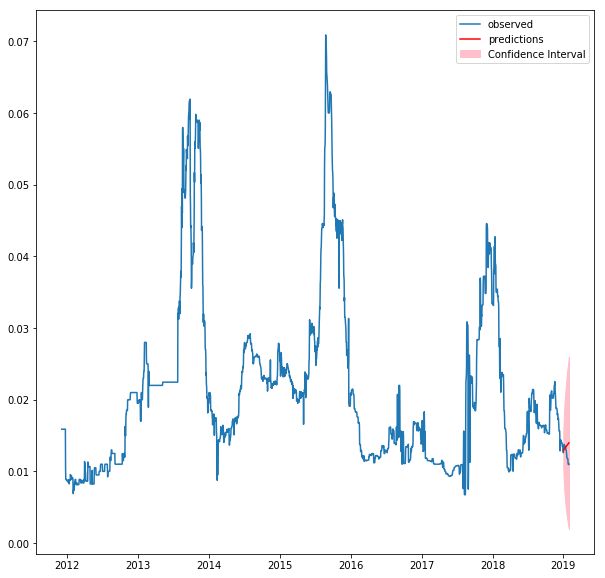

In [69]:
dynamic_forecast_30_days = results.get_forecast(30, alpha=0.05)  # 95% conf

#Mean of forecast
mean_forecast_30_days = dynamic_forecast_30_days.predicted_mean

#Confidence intervals
confidence_intervals_30_days = dynamic_forecast_30_days.conf_int()

lower_limits_30_days = [i[0] for i in confidence_intervals_30_days]
upper_limits_30_days = [i[1] for i in confidence_intervals_30_days]

#Plot the graph
dates = temp_df[:-60].index
dates_2 = dates[-30:]

plt.figure(figsize=(10,10))
plt.plot(dates,temp_df[:-60]['Normalized Price'].values, label='observed')
plt.plot(dates_2,mean_forecast_30_days,color='red', label='predictions')
plt.fill_between(dates_2,lower_limits_30_days,upper_limits_30_days,color='pink',label='Confidence Interval')
plt.legend(loc='best')

In [34]:
cost_price_predictions = mean_forecast_30_days*1000
mae = mean_absolute_error(temp_df[-90:-60]['cp'],cost_price_predictions)
print("MAE:",mae)

MAPE_diff = diff_csv_mape(temp_df[-90:-60]['cp'],cost_price_predictions)
#print(MAPE_diff)
mape_sum = np.sum(MAPE_diff)
MAPE = mape_sum/30
print("MAPE:",MAPE)

MAE: 1.1877832521932818
MAPE: 0.10166346346963695


### Function for augmented Dicky Fuller Test

In [59]:
def adf(y):
    result = adfuller(y)

    # Print test statistic
    print("\n\nTest Statistic(More -ve, more stationary):",result[0])

    # Print p-value
    print("\n\nP-Value(If less than 0.05, reject null)",result[1])
    p_value_bool = result[1]<=0.05
    print("Reject Null Hypothesis(Series is non-stationary):",result[1]<=0.05)

    return p_value_bool

### Function to plot decomposition plot

Decomposition plots provide a useful abstract model for thinking about time series generally and for better understanding problems during time series analysis and forecasting. It gives a clear picture of the tends, seasonality and the noise in the time series.

In [55]:
def plot_decomposition(y,name):
    rcParams['figure.figsize'] = 18, 8
    decomposition = sm.tsa.seasonal_decompose(y, model='additive')
    fig = decomposition.plot()
    plt.title(name)
    plt.show()

### Function to find the best model for a given time series

In [37]:
def find_best_model(df):
    order_scores = []
    for p in range(4):
        for q in range(4):
            for d in range(3):
                for t in trend_list:
                    try:
                        # Instantiate the model
                        #model = SARIMAX(y, order=(p,d,q))
                        model = SARIMAX(df[:-90]['Normalized Price'].values, order=(p,d,q),trend=t)
                        # Fit the model
                        results = model.fit()
                        #Obtain results
                        order_scores.append((p,d,q,t,results.aic,results.bic))
        
                    except:
                        continue
            
    order_scores = pd.DataFrame(order_scores,columns=['p','d','q','trend','aic','bic'])
    order_scores.sort_values('aic',inplace = True)
    
    p,d,q,trend,aic,bic = order_scores.iloc[0,0],order_scores.iloc[0,1],order_scores.iloc[0,2],order_scores.iloc[0,3],order_scores.iloc[0,4],order_scores.iloc[0,5]
    return p,d,q,trend,aic,bic

### Function to build a model after obtaining suitable parameters

In [38]:
def SARIMAX_model(df,p,d,q,trend,name):
    # Instantiate the best model
    model = SARIMAX(df[:-90]['Normalized Price'].values, order=(p,d,q),trend=trend)

    # Fit the model
    results = model.fit()

    # Generate predictions
    dynamic_forecast_30_days = results.get_forecast(30, alpha=0.05)  # 95% conf

    # Extract prediction mean
    mean_forecast_30_days = dynamic_forecast_30_days.predicted_mean
    
    #print(mean_forecast)
    # Get confidence intervals of predictions
    confidence_intervals_30_days = dynamic_forecast_30_days.conf_int()
    # Select lower and upper confidence limits
    lower_limits_30_days = [i[0] for i in confidence_intervals_30_days]
    upper_limits_30_days = [i[1] for i in confidence_intervals_30_days]

    #Plot the graph
    dates = df[:-60].index
    dates_2 = dates[-30:]
    plt.plot(dates,df[:-60]['Normalized Price'].values, label='observed')
    plt.plot(dates_2,mean_forecast_30_days,color='red', label='predictions')
    plt.fill_between(dates_2,lower_limits_30_days,upper_limits_30_days,color='pink',label='Confidence Interval')
    plt.legend(loc='best')
    plt.title("Projected price for:"+name)

### Iterating over all product groups and making calls to the aforementioned functions

Product: onion


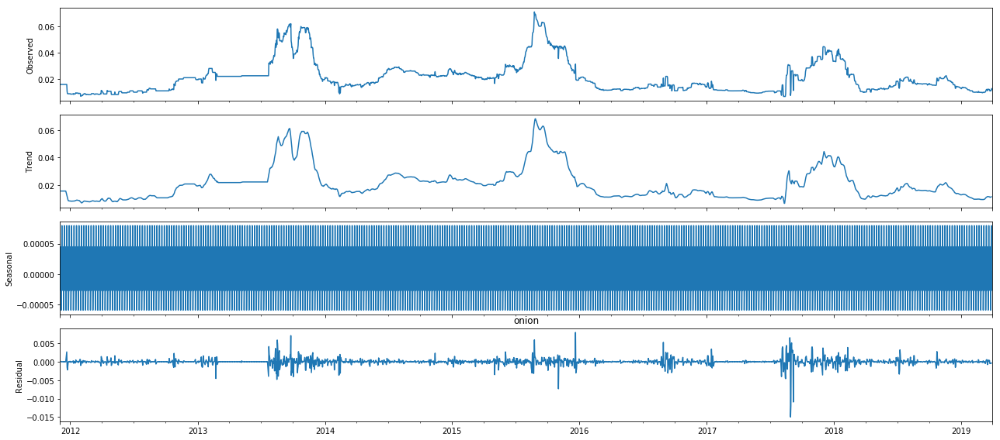



Test Statistic(More -ve, more stationary): -3.3018466841858265


P-Value(If less than 0.05, reject null) 0.014796129188200096
Reject Null Hypothesis(Series is non-stationary): True
Best Model:
p: 3
q: 0
d: 0
trend: c
Number of products left: 14
Product: banana yelakki


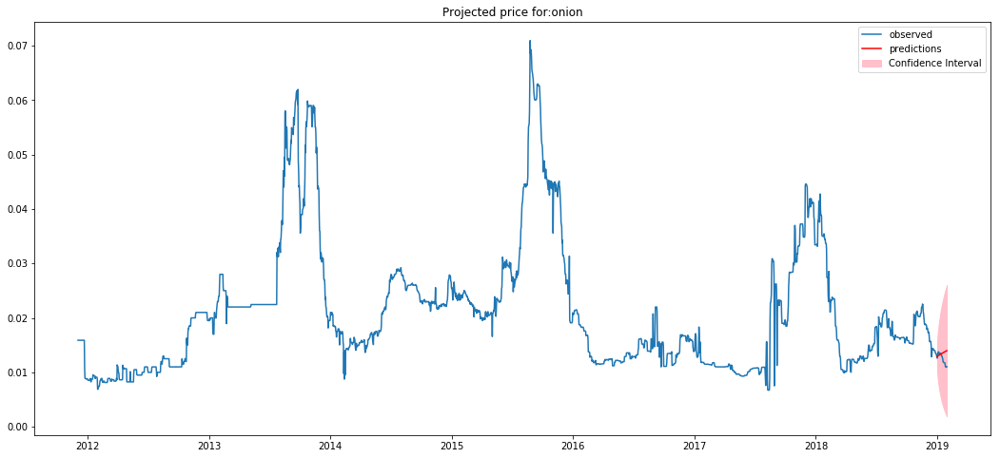

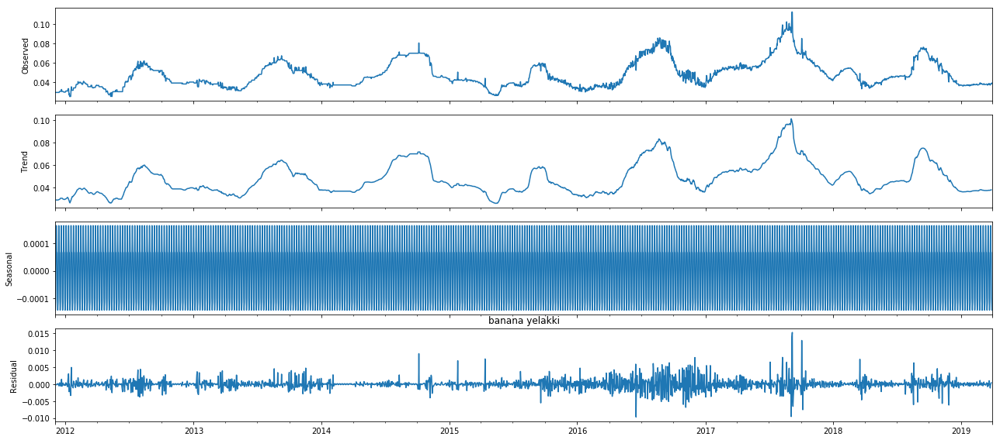



Test Statistic(More -ve, more stationary): -4.295456764777353


P-Value(If less than 0.05, reject null) 0.00045232867073604537
Reject Null Hypothesis(Series is non-stationary): True
Best Model:
p: 3
q: 3
d: 0
trend: n
Number of products left: 13
Product: capsicum green


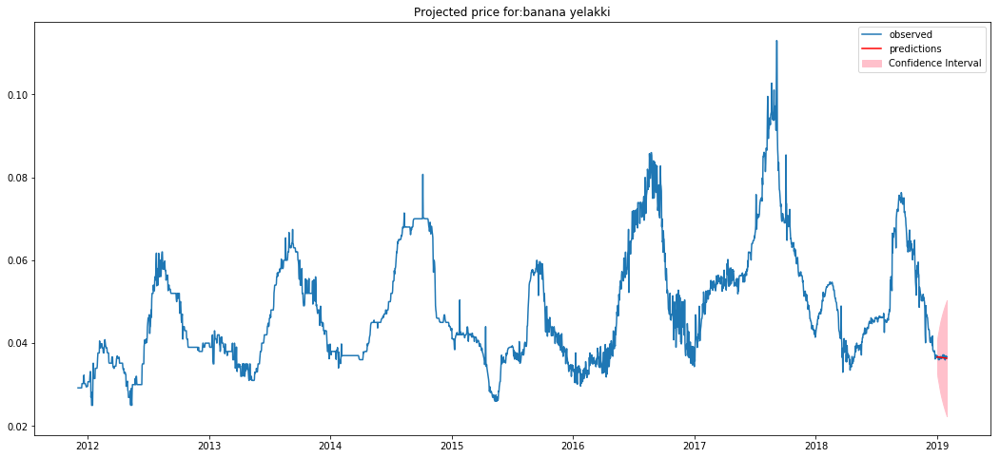

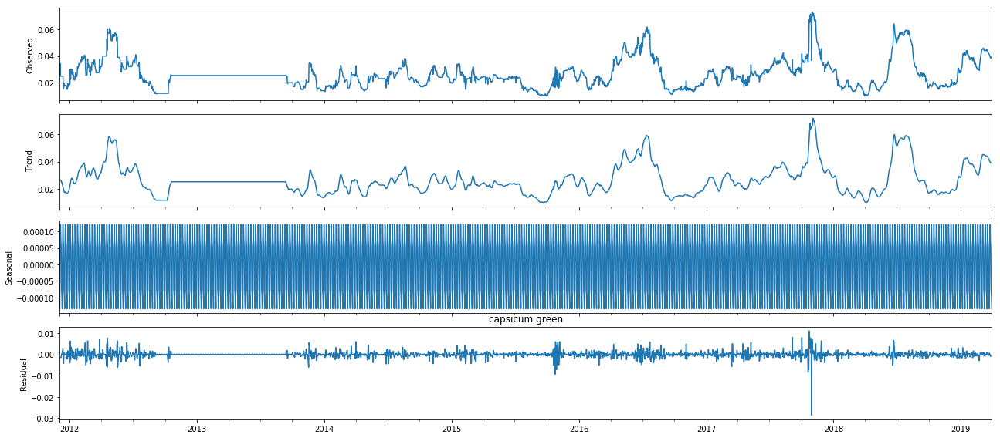



Test Statistic(More -ve, more stationary): -4.402118295637327


P-Value(If less than 0.05, reject null) 0.0002942808110651836
Reject Null Hypothesis(Series is non-stationary): True
Best Model:
p: 1
q: 3
d: 0
trend: c
Number of products left: 12
Product: tomato hybrid


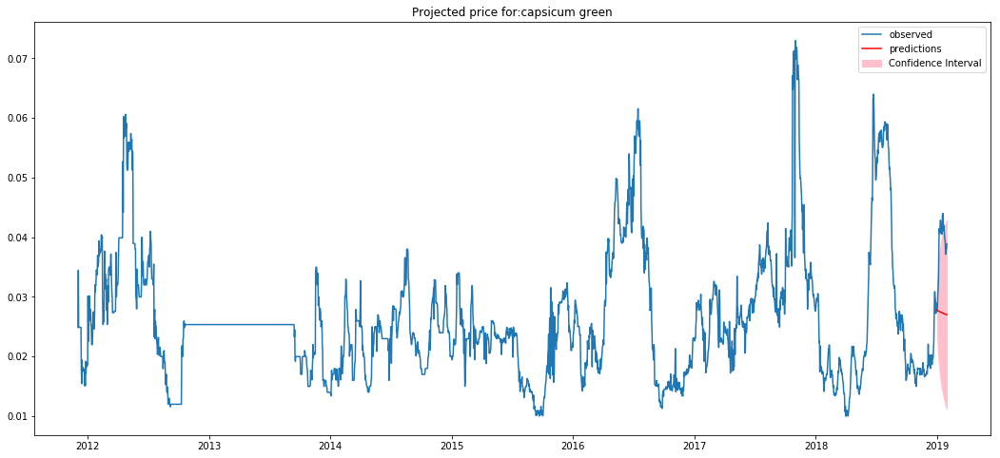

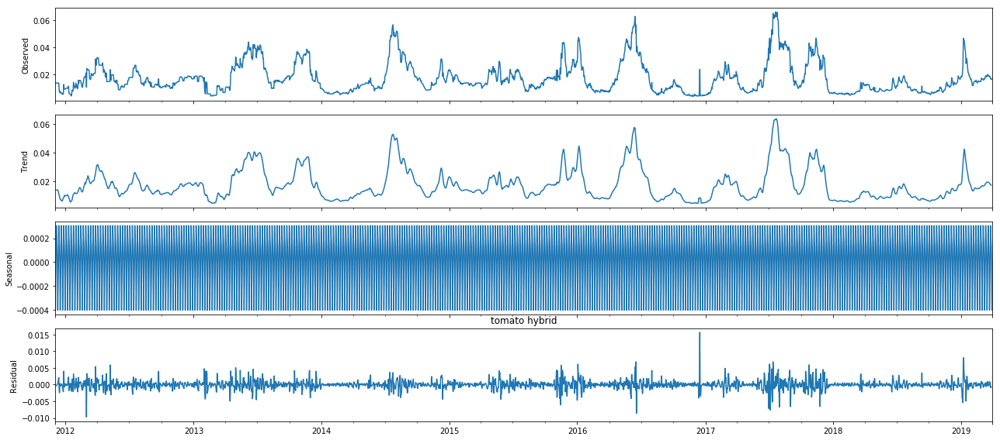



Test Statistic(More -ve, more stationary): -5.866996051572197


P-Value(If less than 0.05, reject null) 3.307599743595315e-07
Reject Null Hypothesis(Series is non-stationary): True
Best Model:
p: 1
q: 3
d: 0
trend: c
Number of products left: 11
Product: potato


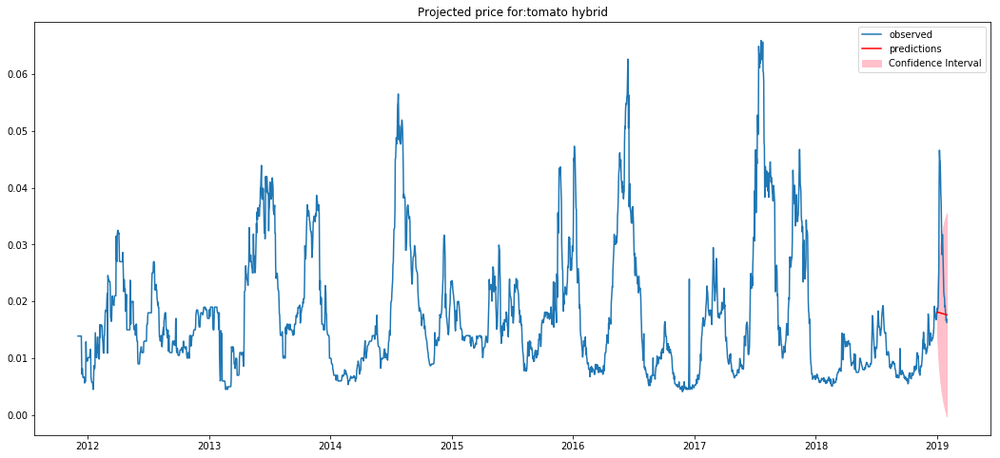

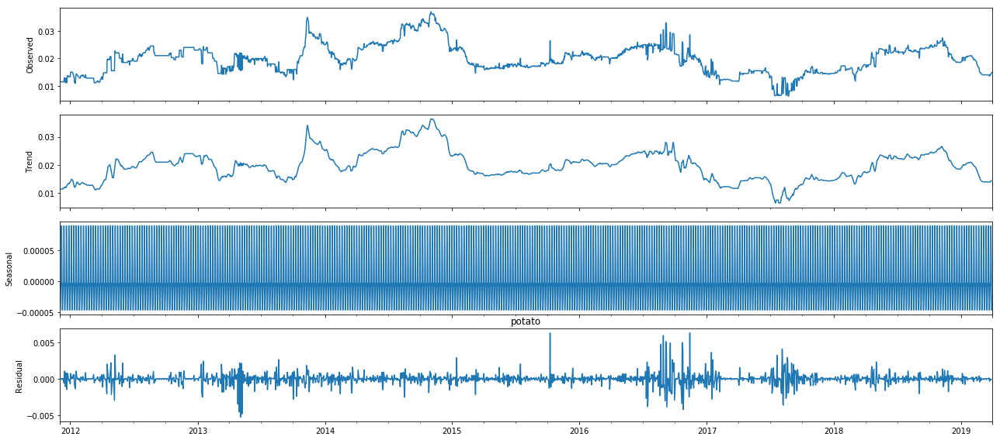



Test Statistic(More -ve, more stationary): -3.1360593021866294


P-Value(If less than 0.05, reject null) 0.02399719457553686
Reject Null Hypothesis(Series is non-stationary): True
Best Model:
p: 2
q: 3
d: 0
trend: c
Number of products left: 10
Product: cucumber english


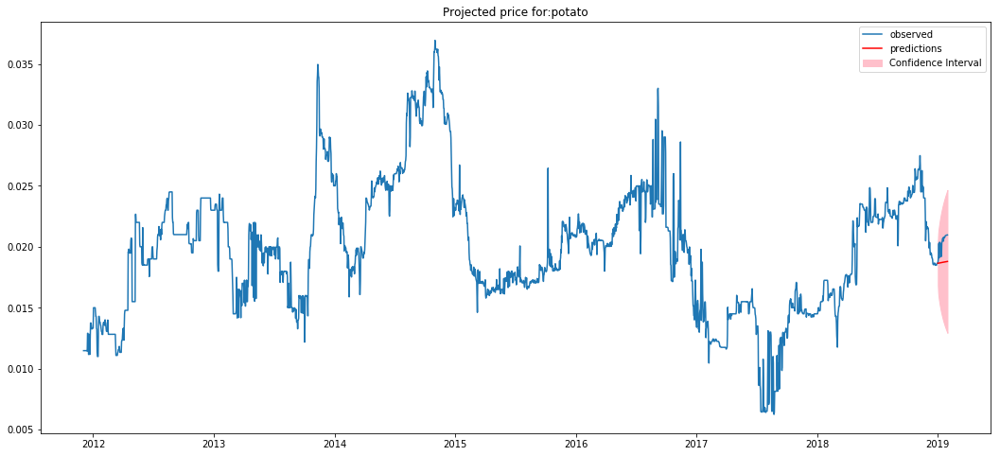

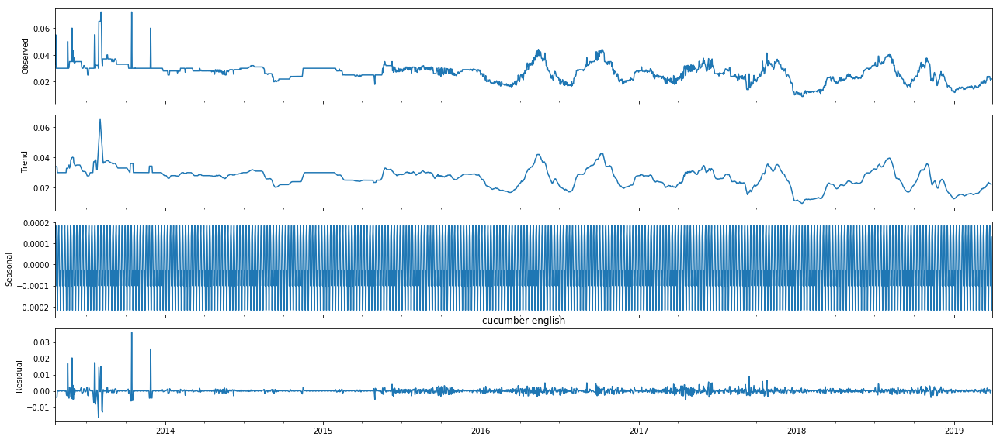



Test Statistic(More -ve, more stationary): -5.314505173607439


P-Value(If less than 0.05, reject null) 5.10927116158411e-06
Reject Null Hypothesis(Series is non-stationary): True
Best Model:
p: 2
q: 3
d: 0
trend: ct
Number of products left: 9
Product: cucumber


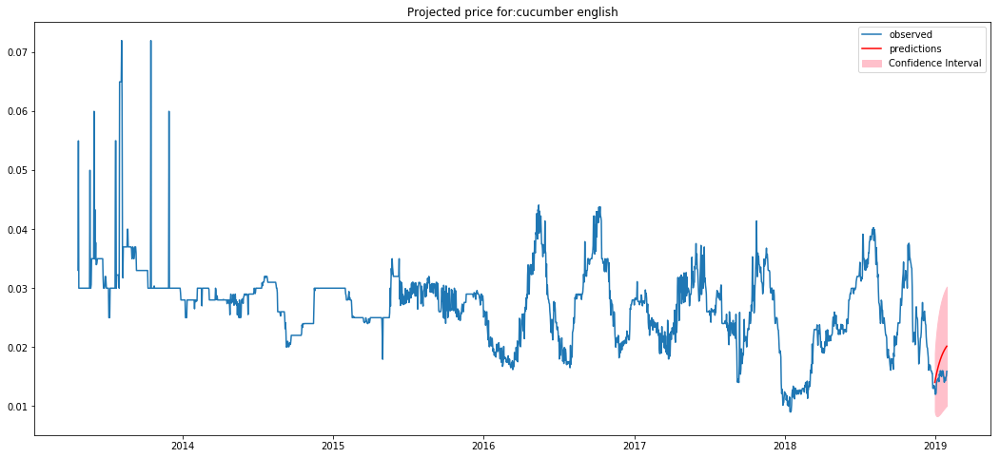

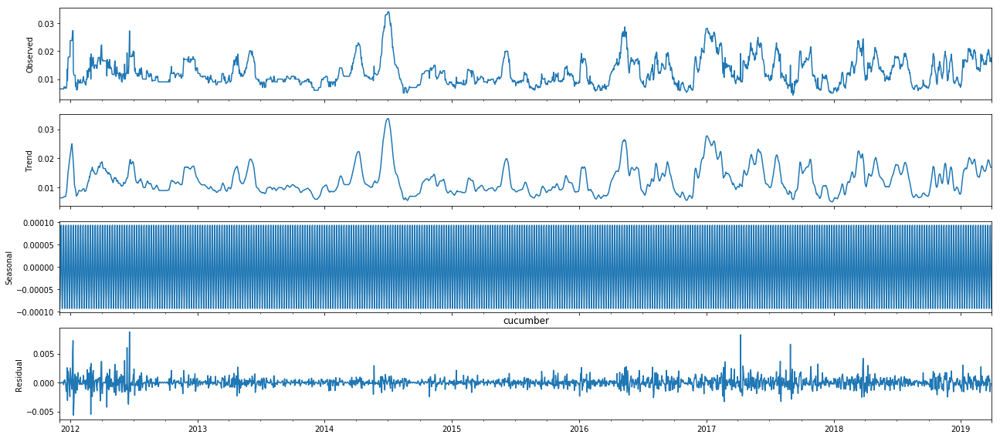



Test Statistic(More -ve, more stationary): -7.4598757108814135


P-Value(If less than 0.05, reject null) 5.3890946151712586e-11
Reject Null Hypothesis(Series is non-stationary): True
Best Model:
p: 1
q: 3
d: 0
trend: c
Number of products left: 8
Product: ridge gourd


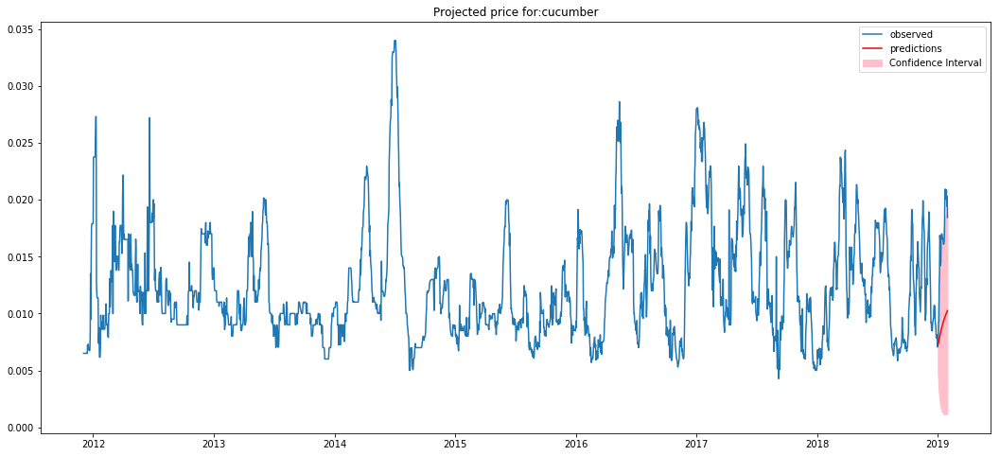

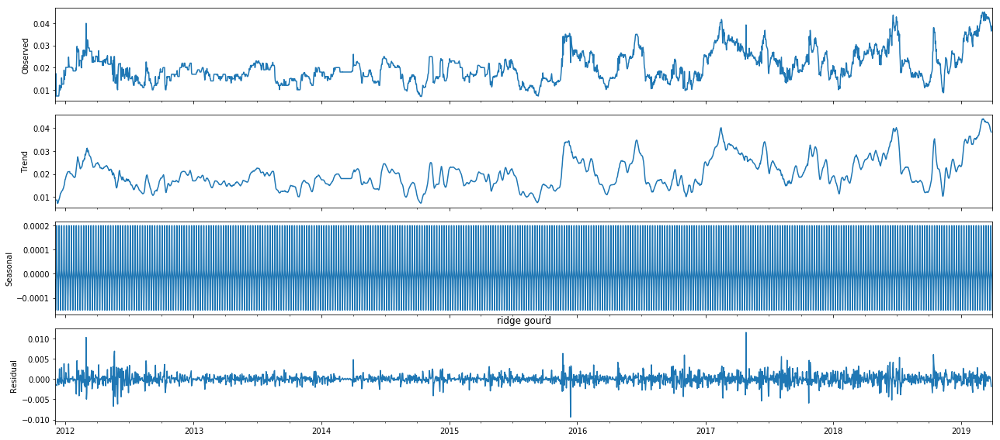



Test Statistic(More -ve, more stationary): -3.9426285150947926


P-Value(If less than 0.05, reject null) 0.0017425866470657725
Reject Null Hypothesis(Series is non-stationary): True
Best Model:
p: 1
q: 3
d: 0
trend: ct
Number of products left: 7
Product: ladies finger


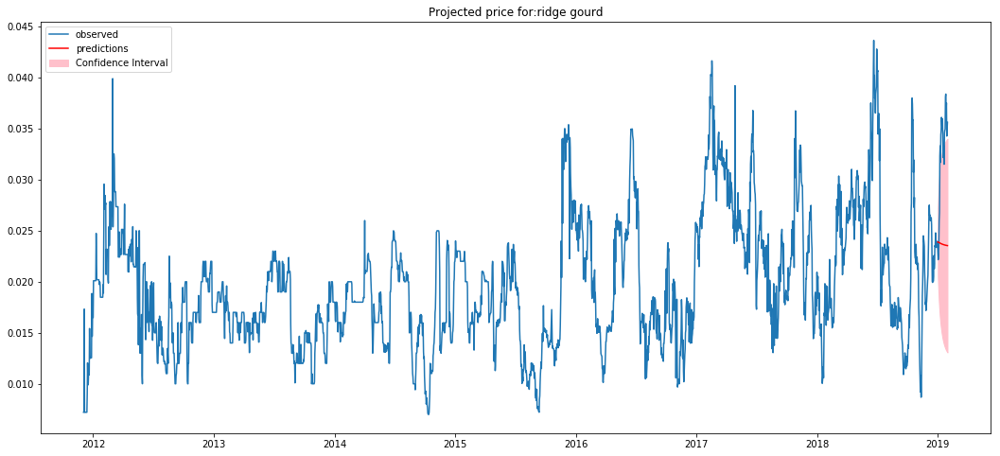

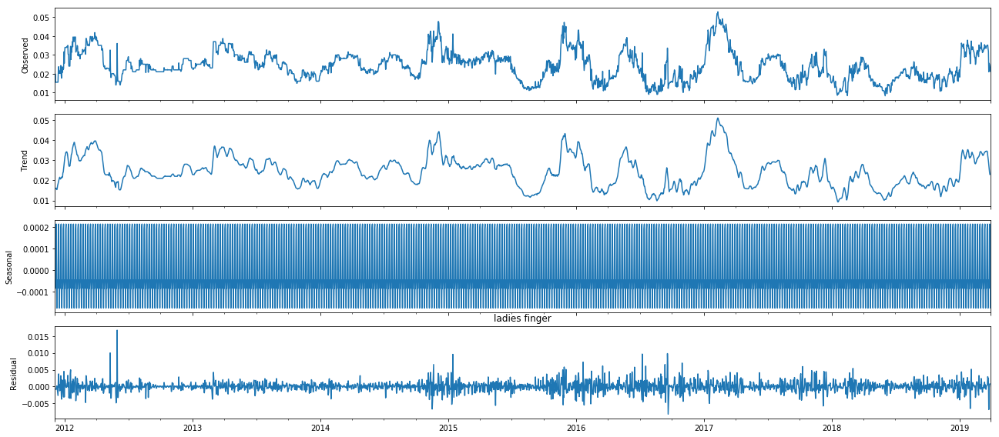



Test Statistic(More -ve, more stationary): -5.389886922992589


P-Value(If less than 0.05, reject null) 3.5568667012890877e-06
Reject Null Hypothesis(Series is non-stationary): True
Best Model:
p: 1
q: 2
d: 0
trend: c
Number of products left: 6
Product: banana robusta


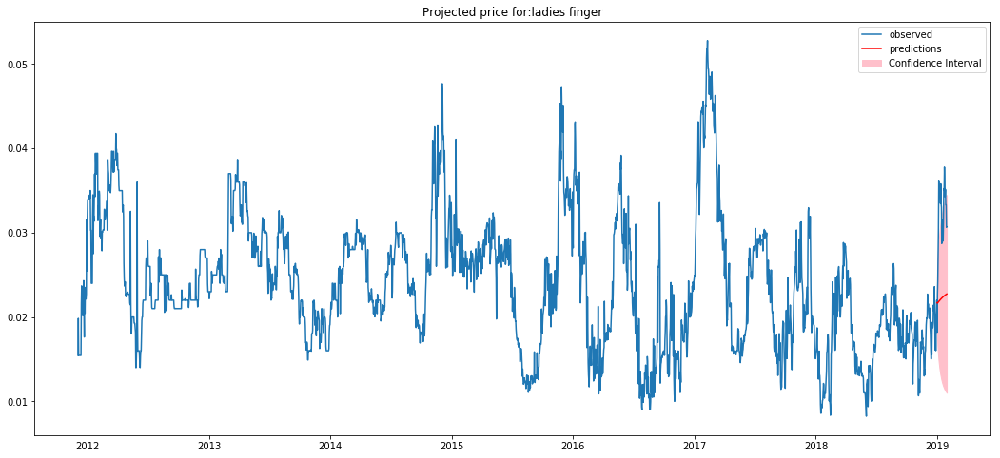

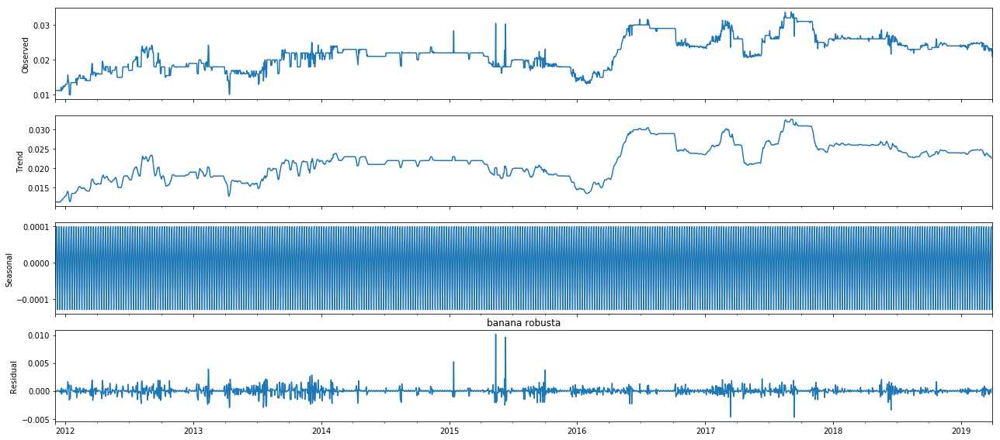



Test Statistic(More -ve, more stationary): -2.892944773772115


P-Value(If less than 0.05, reject null) 0.04617459702387811
Reject Null Hypothesis(Series is non-stationary): True
Best Model:
p: 3
q: 3
d: 1
trend: n
Number of products left: 5
Product: tomato local


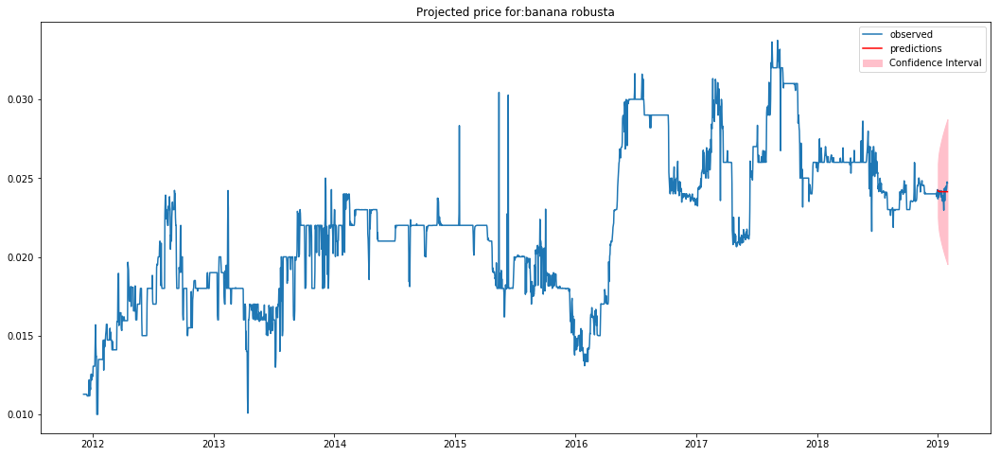

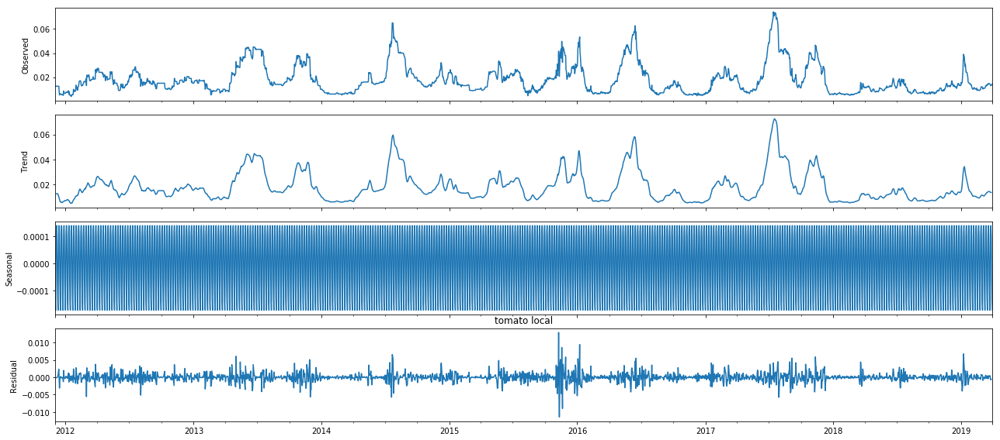



Test Statistic(More -ve, more stationary): -5.480304936502795


P-Value(If less than 0.05, reject null) 2.292262472281214e-06
Reject Null Hypothesis(Series is non-stationary): True
Best Model:
p: 1
q: 3
d: 0
trend: c
Number of products left: 4
Product: bottle gourd


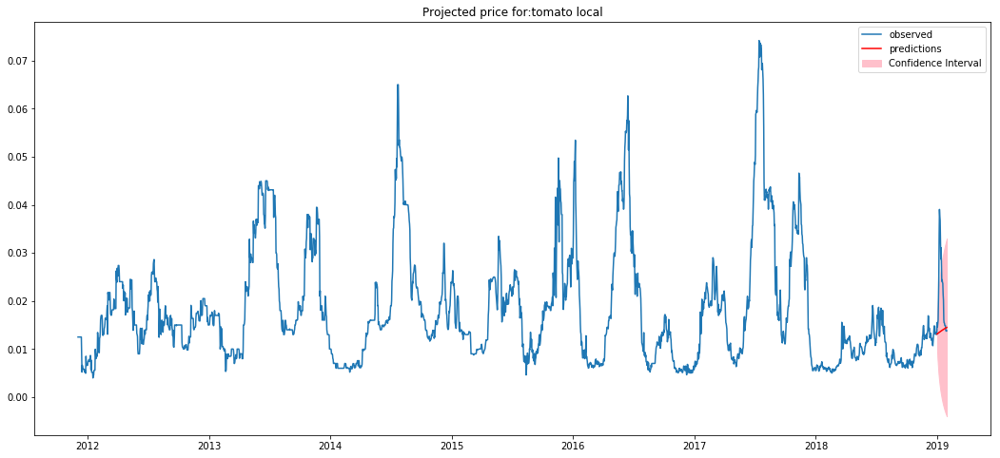

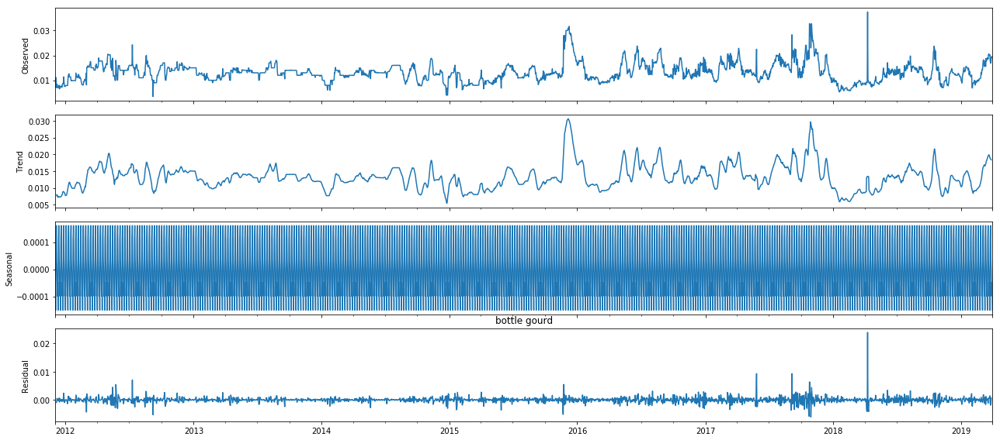



Test Statistic(More -ve, more stationary): -7.585937478661072


P-Value(If less than 0.05, reject null) 2.6067444781333317e-11
Reject Null Hypothesis(Series is non-stationary): True
Best Model:
p: 3
q: 0
d: 0
trend: c
Number of products left: 3
Product: watermelon small


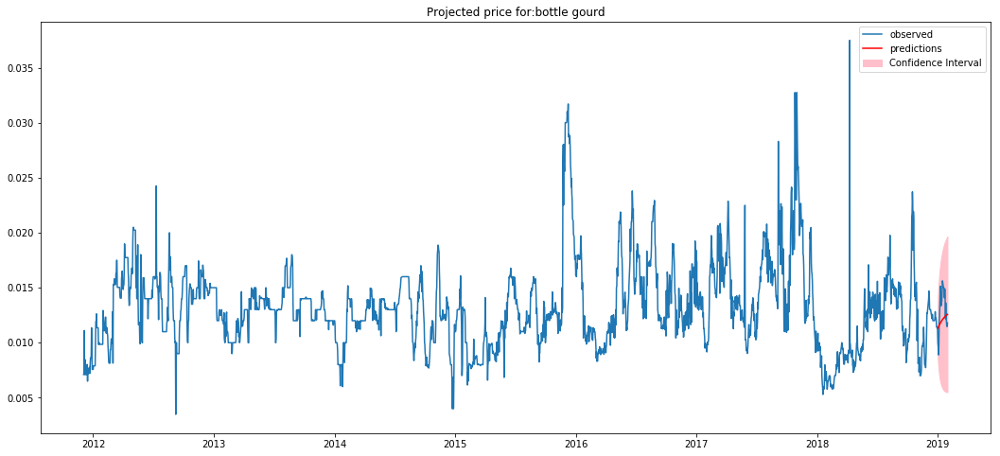

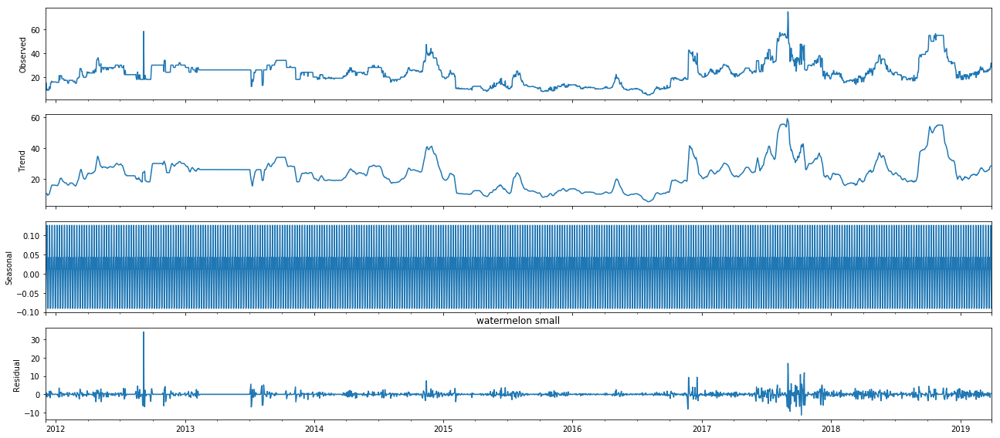



Test Statistic(More -ve, more stationary): -3.932587645605222


P-Value(If less than 0.05, reject null) 0.0018076883478711967
Reject Null Hypothesis(Series is non-stationary): True
Best Model:
p: 2
q: 3
d: 0
trend: c
Number of products left: 2
Product: beetroot


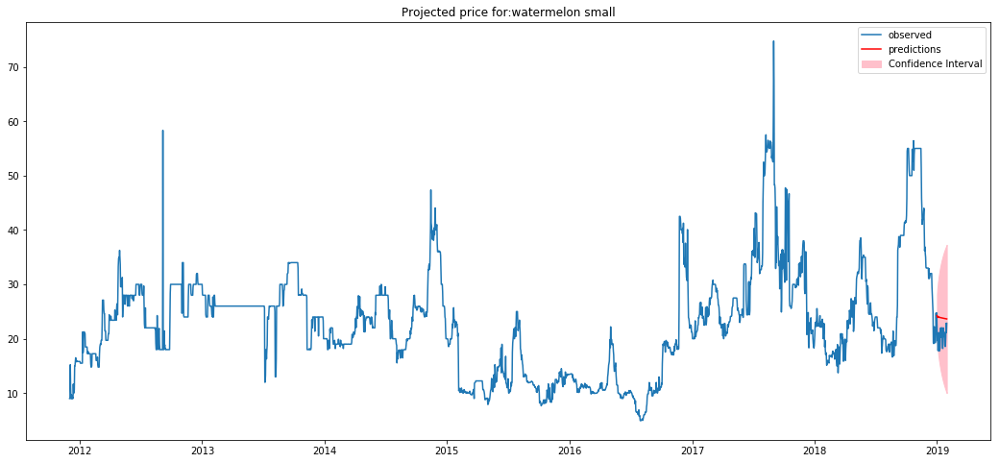

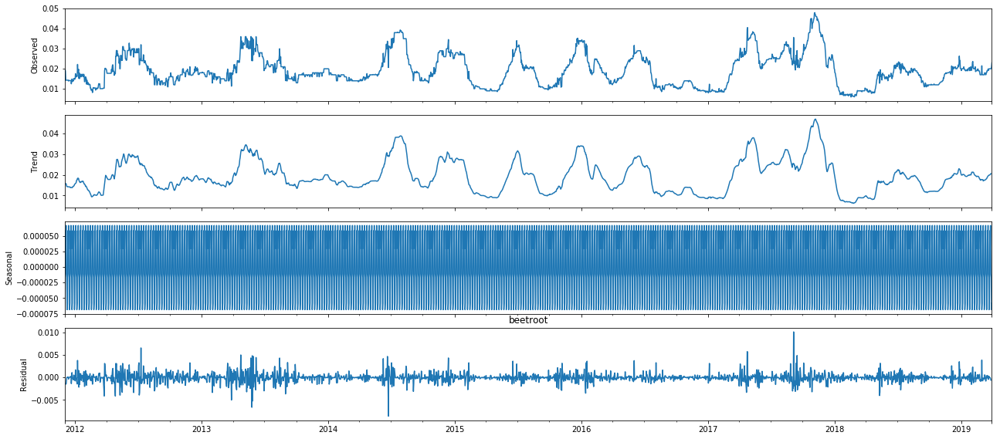



Test Statistic(More -ve, more stationary): -5.5467779703365565


P-Value(If less than 0.05, reject null) 1.6540206843465818e-06
Reject Null Hypothesis(Series is non-stationary): True
Best Model:
p: 3
q: 1
d: 0
trend: c
Number of products left: 1
Product: carrot local


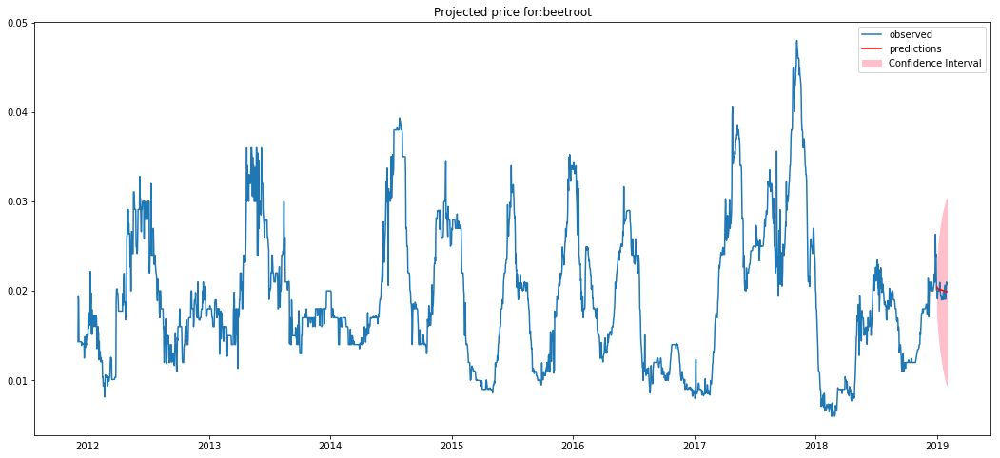

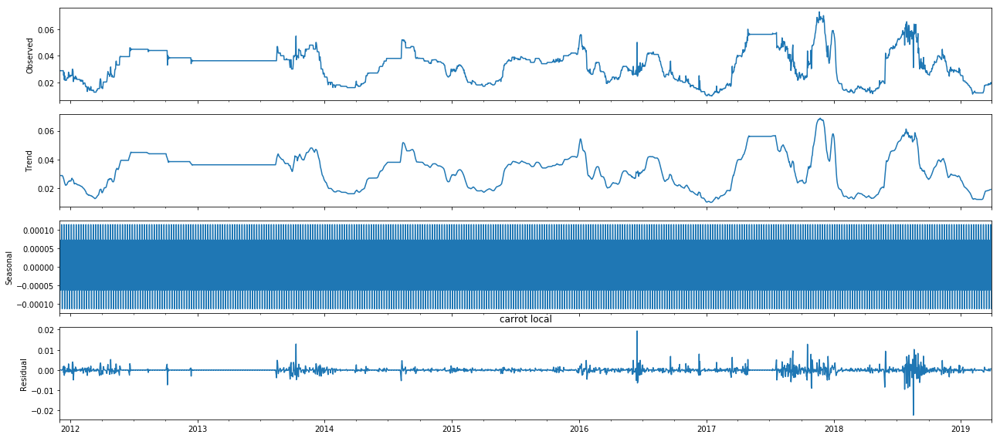



Test Statistic(More -ve, more stationary): -4.685250668627307


P-Value(If less than 0.05, reject null) 8.968862767295612e-05
Reject Null Hypothesis(Series is non-stationary): True
Best Model:
p: 3
q: 2
d: 0
trend: c
Number of products left: 0


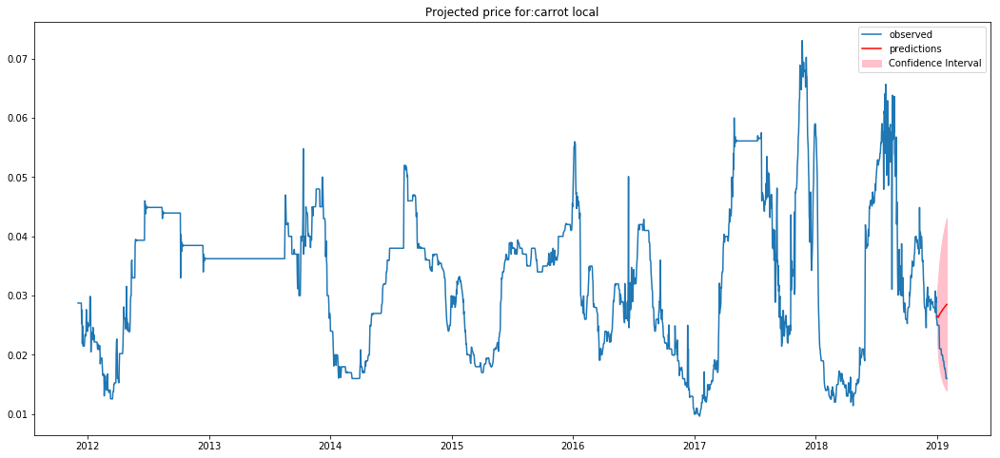

In [584]:
import warnings
warnings.filterwarnings('ignore')

list_summary = []

columns_needed = ['cp','Normalized Price']

count = len(prod_groups)
for prod in prod_groups:
    print("Product:",prod)
    
    temp_df_exog = df_final[df_final['PROD_GROUP']==prod].loc[:,columns_needed].copy()
    
    #Resampling
    #temp_df_exog = temp_df_exog.resample('D').mean()
   
   
    #if sum(pd.isna(temp_df_exog['Normalized Price'].values))!=0:
    #    index_nan = np.argwhere(np.isnan(temp_df_exog['Normalized Price'].values))
    #    index = index_nan[-1][-1]
    #    temp_df_exog = temp_df_exog.iloc[index+1:][:]
        
    #Calling function to plot the decomposition plot
    plot_decomposition(temp_df_exog['Normalized Price'],prod)
    
    #Obtaining ADF Results
    adf(temp_df_exog['Normalized Price'])
    
    
    #except:
    #    print("Sample size is too small for:",prod)
    #    prod_skipped.append(prod)
    #    count = count-1
    #    print("Number of products left:",count)
    #    continue
    #Obtain best model
    
    p,d,q,trend,aic,bic = find_best_model(temp_df_exog)
    
    list_summary.append([prod,p,d,q,trend])
    print("Best Model:")
    print("p:",p)
    print("q:",q)
    print("d:",d)
    print("trend:",trend)
    
    SARIMAX_model(temp_df_exog,p,d,q,trend,prod)
    
    count = count-1
    print("Number of products left:",count)

In [585]:
df_summary = pd.DataFrame(list_summary,columns=['product','p','d','q','trend'])

df_summary.style

,product,p,d,q,trend
0,onion,3,0,0,c
1,banana yelakki,3,0,3,n
2,capsicum green,1,0,3,c
3,tomato hybrid,1,0,3,c
4,potato,2,0,3,c
5,cucumber english,2,0,3,ct
6,cucumber,1,0,3,c
7,ridge gourd,1,0,3,ct
8,ladies finger,1,0,2,c
9,banana robusta,3,1,3,n


In [586]:
df_summary.to_csv("/Users/vegi/Documents/USC_Masters/ML/DemandForecasts/df_new_summary_trend.csv", sep=",", float_format='%.2f',index=False, line_terminator='\n',encoding='utf-8')

In [588]:
filename = '/Users/vegi/Documents/USC_Masters/ML/DemandForecasts/df_new_summary_trend.csv'
df_summary = pd.read_csv(filename)

df_summary

,product,p,d,q,trend
0,onion,3,0,0,c
1,banana yelakki,3,0,3,n
2,capsicum green,1,0,3,c
3,tomato hybrid,1,0,3,c
4,potato,2,0,3,c
5,cucumber english,2,0,3,ct
6,cucumber,1,0,3,c
7,ridge gourd,1,0,3,ct
8,ladies finger,1,0,2,c
9,banana robusta,3,1,3,n


### Forecasting for a given SKU

In [589]:
#Dictionary of Unique Products and Normalised Factor
dict_prod_factor = {}

#Iterating over each of the unique products
for i,prod in enumerate(unique_products):
    dict_prod_factor[prod] = normalize_price_factor[i]

### Function to get the product group

In [53]:
def get_prod_group(sku):
    #Getting the key for the dictionary
    key = sku[1]
    
    return prod_dict[key]

### Function to get model parameters

In [594]:
#This function picks up the p,d and q parameters from the df_summary dataframe
def get_pdq(prod_group):
    if prod_group in list(df_summary['product']):
        return df_summary[df_summary['product']==prod_group]['p'].item(),df_summary[df_summary['product']==prod_group]['d'].item(),df_summary[df_summary['product']==prod_group]['q'].item(),df_summary[df_summary['product']==prod_group]['trend'].item()

### Function to build the best model for a given SKU

In [596]:
def forecast_model(df,p,d,q,trend,name):
    # Instantiate the best model
    model = SARIMAX(df[:-90]['Normalized Price'].values, order=(p,d,q),trend=trend)

    # Fit the model
    results = model.fit()

    # Generate predictions
    dynamic_forecast_30_days = results.get_forecast(30, alpha=0.05)  # 95% conf
    
    # Extract prediction mean
    mean_forecast_30_days = dynamic_forecast_30_days.predicted_mean

    # Get confidence intervals of predictions
    confidence_intervals_30_days = dynamic_forecast_30_days.conf_int()
    # Select lower and upper confidence limits
    #lower_limits = confidence_intervals.loc[:,'lower y']
    #upper_limits = confidence_intervals.loc[:,'upper y']
    
    lower_limits_30_days = [i[0] for i in confidence_intervals_30_days]
    upper_limits_30_days = [i[1] for i in confidence_intervals_30_days]

    dates = df[:-60].index
    
    plt.plot(dates,df[:-60]['Normalized Price'].values, label='observed')
    plt.plot(dates_2,mean_forecast_30_days,color='red', label='predictions')
    plt.fill_between(dates_2,lower_limits_30_days,upper_limits_30_days,color='pink',label='Confidence Interval')
    plt.legend(loc='best')
    plt.title("Projected price for:"+name)

    return mean_forecast_30_days,dates_2

### Function to get the forecast

In [597]:
def get_forecast(selected_sku,actual_prod):
    #Obtaining the normalizing factor for the SKU
    normalizing_factor_sku = dict_prod_factor[actual_prod]
    print("Normalizing factor:",normalizing_factor_sku)
    
    #Obtaining the product group
    sku_prod_group = get_prod_group(selected_sku)
    print("Product Group:",sku_prod_group)
    
    #Obtaining the model parameters
    p,d,q,trend = get_pdq(sku_prod_group)
        
    #Printing Model parameters
    print("Model Parameters:")
    print("p:",p)
    print("d:",d)
    print("q:",q)
    print("trend:",trend)
    
    #return

    #Creating a dataframe with observations from a certain prodcut
    temp_df_exog = df_final[df_final['PROD_GROUP']==sku_prod_group].loc[:,columns_needed].copy()
    
    #Resampling the data
    #temp_df_exog = temp_df_exog.resample('D').mean()
    
#    if sum(pd.isna(temp_df_exog['Normalized Price']))!=0:
#        index_nan = np.argwhere(np.isnan(temp_df_exog['Normalized Price'].values))
#        index = index_nan[-1][-1]
#        temp_df_exog = temp_df_exog.iloc[index+1:][:]
    
    number_of_observations = len(temp_df_exog)
    
    avg_price = np.average(temp_df_exog['cp'])
    
    #print("Average Cost Price:",avg_price)
    #Calling function to plot the decomposition plot
    plot_decomposition(temp_df_exog['Normalized Price'],sku_prod_group)
    
    #Obtaining ADF Results
    adf(temp_df_exog['Normalized Price'])
    
    predictions,dates = forecast_model(temp_df_exog,p,d,q,trend,sku_prod_group)
    #print("Predicted Normalized Price:",list(predictions))
    cost_price_predictions = np.array(predictions)/normalizing_factor_sku
    
    actual_price = (temp_df_exog[-90:-60]['Normalized Price'].values)/normalizing_factor_sku
    #print("Prediction of cost price:",cost_price_predictions)
    #print("Actual cost price:",actual_price)
    
    #print(number_of_observations)
    #print(avg_price)
    return cost_price_predictions,actual_price,dates,number_of_observations,avg_price

For SKU: Fresho onion 1 kg
Normalizing factor: 0.001
Product Group: onion
Model Parameters:
p: 3
d: 0
q: 0
trend: c


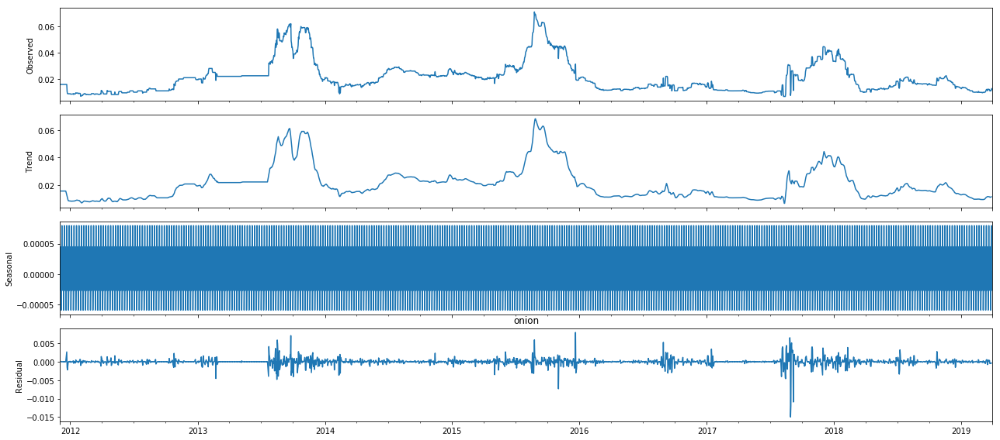



Test Statistic(More -ve, more stationary): -3.3018466841858265


P-Value(If less than 0.05, reject null) 0.014796129188200096
Reject Null Hypothesis(Series is non-stationary): True
RMSE: 2.4535430747814417
MAE: 1.1877832521932818




For SKU: Fresho banana-yelakki 1 kg
Normalizing factor: 0.001
Product Group: banana yelakki
Model Parameters:
p: 3
d: 0
q: 3
trend: n


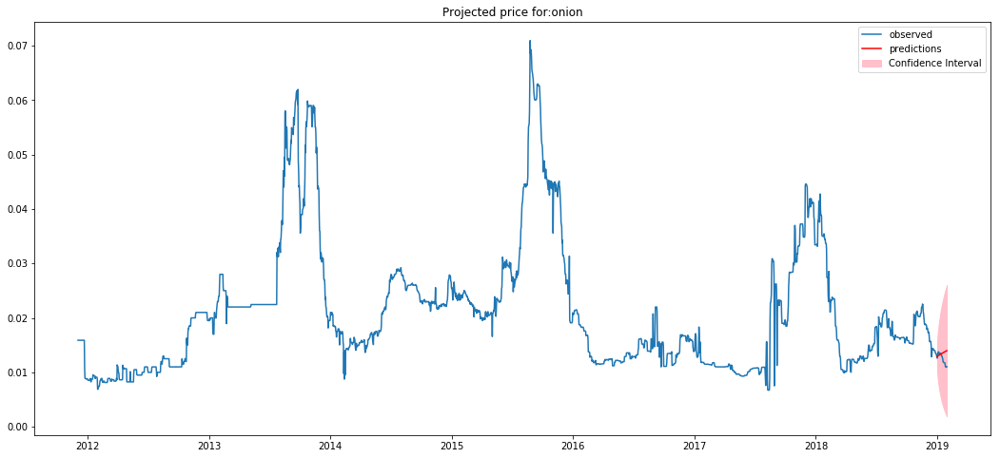

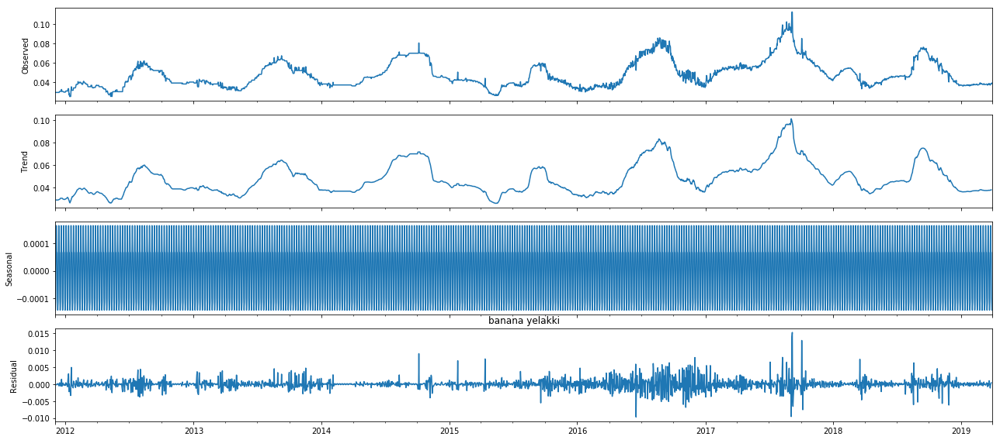



Test Statistic(More -ve, more stationary): -4.295456764777353


P-Value(If less than 0.05, reject null) 0.00045232867073604537
Reject Null Hypothesis(Series is non-stationary): True
RMSE: 0.13359131604631097
MAE: 0.30781455425101806




For SKU: Fresho capsicum-green 1 kg
Normalizing factor: 0.001
Product Group: capsicum green
Model Parameters:
p: 1
d: 0
q: 3
trend: c


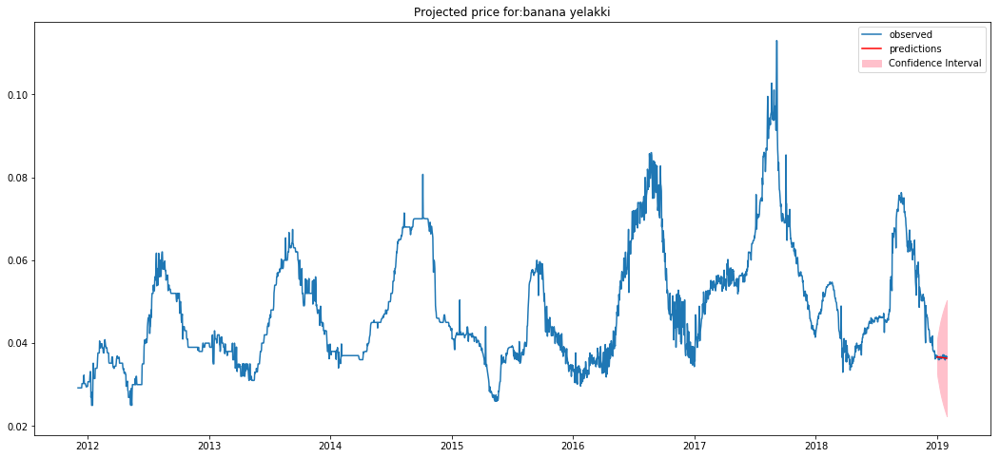

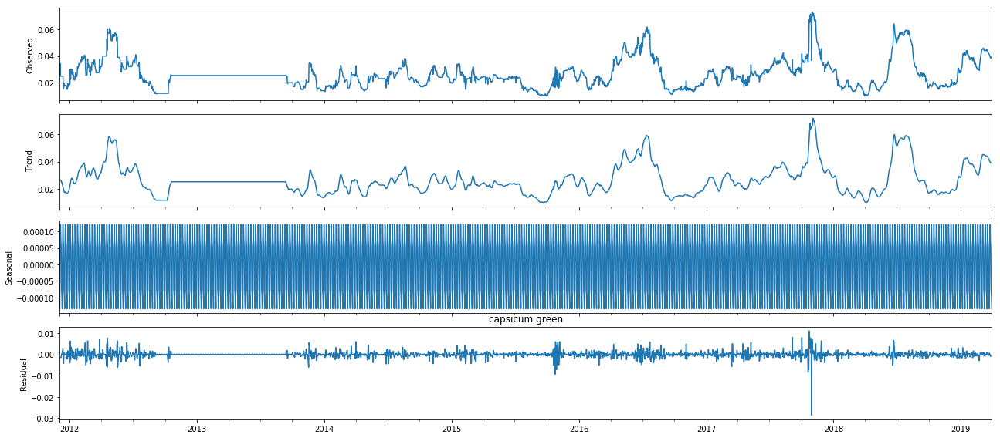



Test Statistic(More -ve, more stationary): -4.402118295637327


P-Value(If less than 0.05, reject null) 0.0002942808110651836
Reject Null Hypothesis(Series is non-stationary): True
RMSE: 155.23756135158948
MAE: 11.639523476430657




For SKU: Fresho tomato-hybrid 1 kg
Normalizing factor: 0.001
Product Group: tomato hybrid
Model Parameters:
p: 1
d: 0
q: 3
trend: c


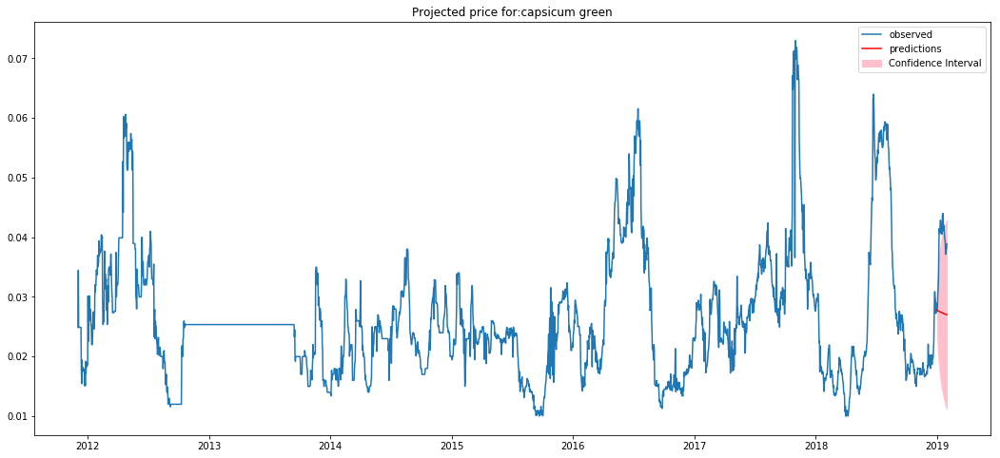

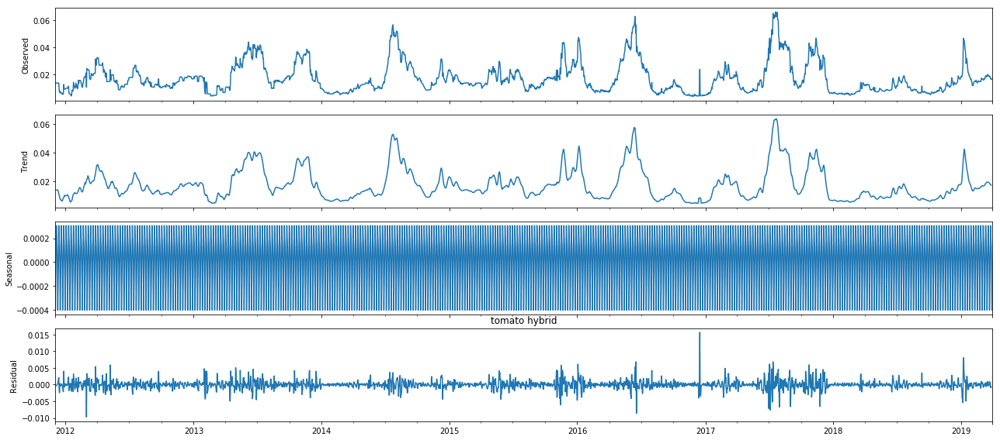



Test Statistic(More -ve, more stationary): -5.866996051572197


P-Value(If less than 0.05, reject null) 3.307599743595315e-07
Reject Null Hypothesis(Series is non-stationary): True
RMSE: 176.32459605878267
MAE: 9.354075090678672




For SKU: Fresho potato 1 kg
Normalizing factor: 0.001
Product Group: potato
Model Parameters:
p: 2
d: 0
q: 3
trend: c


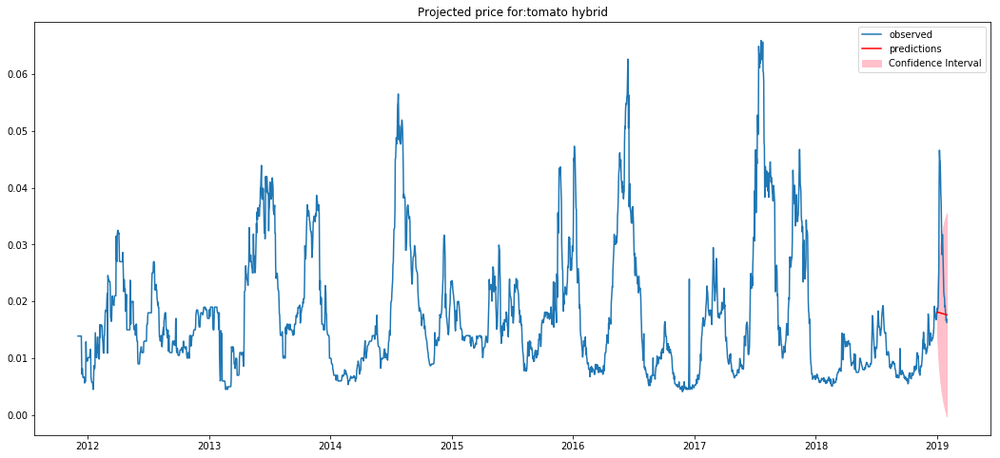

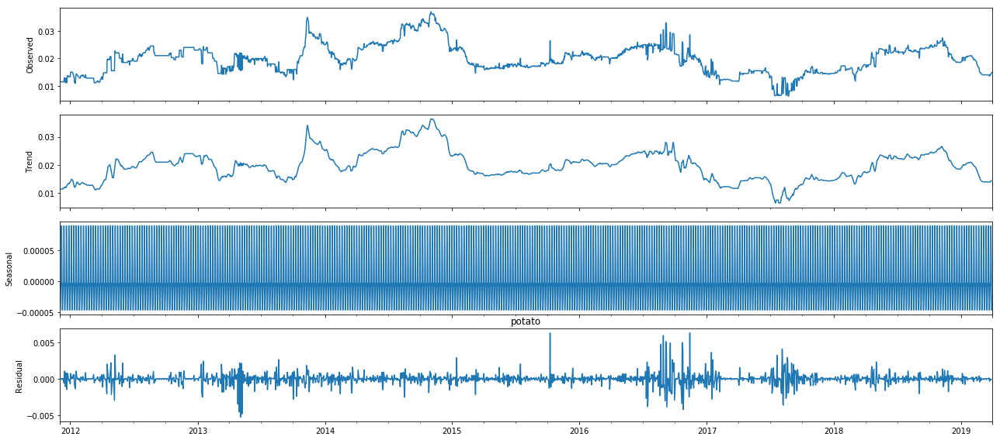



Test Statistic(More -ve, more stationary): -3.1360593021866294


P-Value(If less than 0.05, reject null) 0.02399719457553686
Reject Null Hypothesis(Series is non-stationary): True
RMSE: 3.0210946805461036
MAE: 1.613238418975728




For SKU: Fresho cucumber-english 1 kg
Normalizing factor: 0.001
Product Group: cucumber english
Model Parameters:
p: 2
d: 0
q: 3
trend: ct


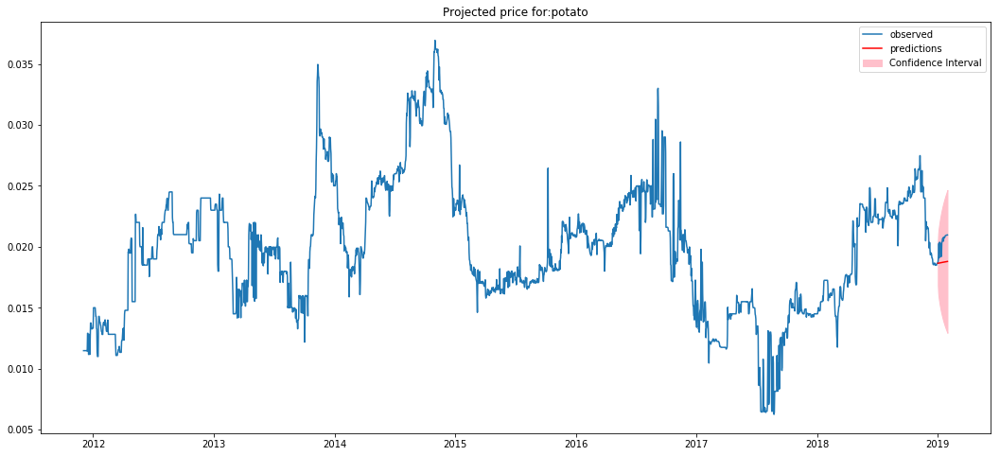

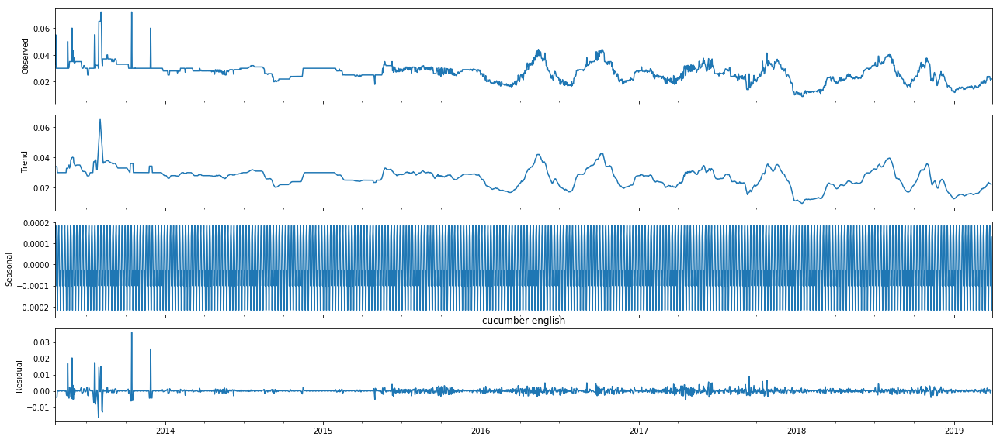



Test Statistic(More -ve, more stationary): -5.314505173607439


P-Value(If less than 0.05, reject null) 5.10927116158411e-06
Reject Null Hypothesis(Series is non-stationary): True
RMSE: 11.352322349765307
MAE: 3.108631490702008




For SKU: Fresho cucumber 1 kg
Normalizing factor: 0.001
Product Group: cucumber
Model Parameters:
p: 1
d: 0
q: 3
trend: c


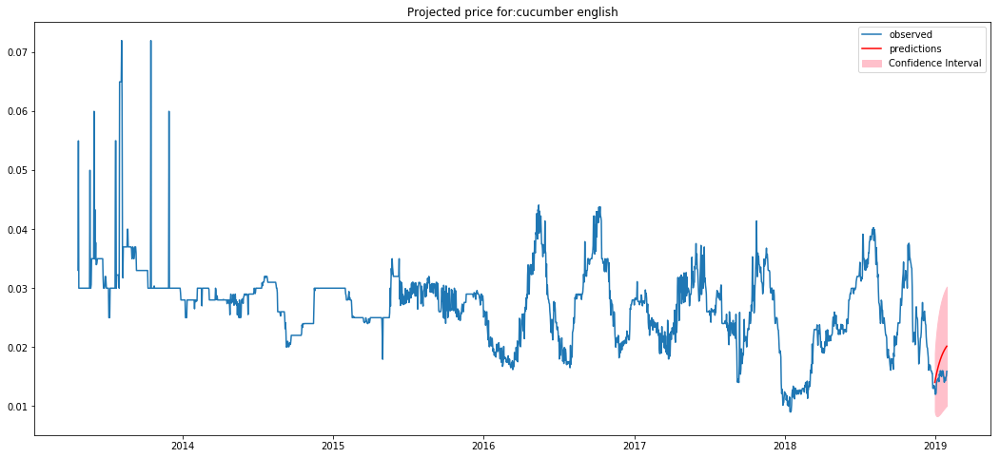

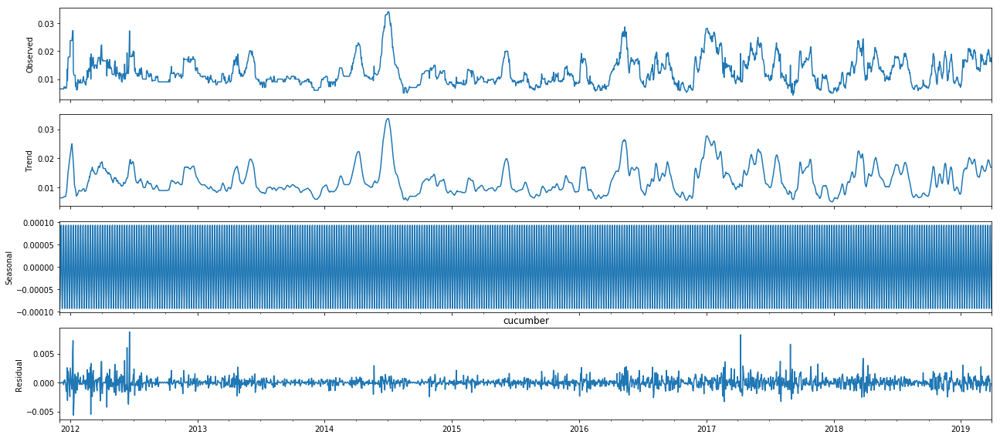



Test Statistic(More -ve, more stationary): -7.4598757108814135


P-Value(If less than 0.05, reject null) 5.3890946151712586e-11
Reject Null Hypothesis(Series is non-stationary): True
RMSE: 60.68547528705555
MAE: 7.227153267036146




For SKU: Fresho ridge-gourd 1 kg
Normalizing factor: 0.001
Product Group: ridge gourd
Model Parameters:
p: 1
d: 0
q: 3
trend: ct


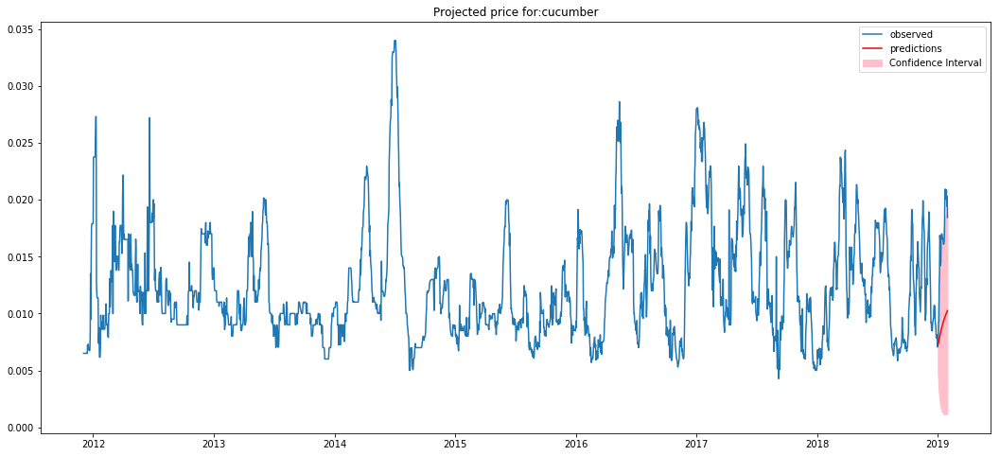

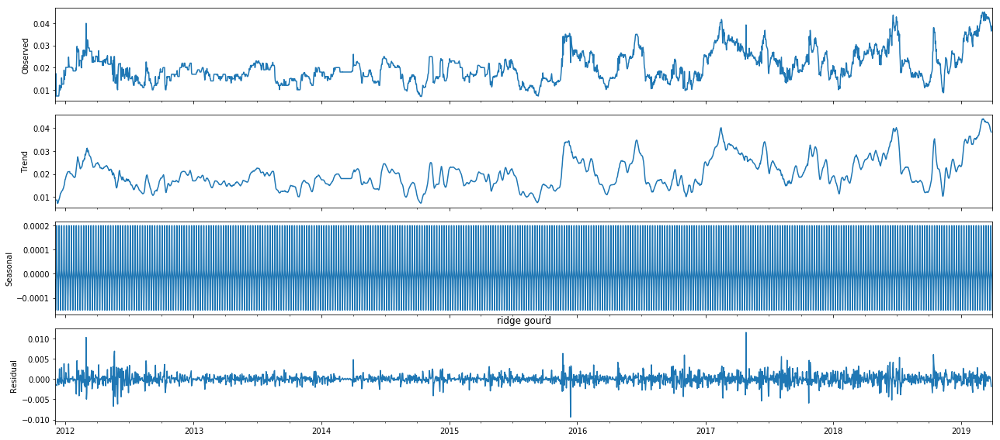



Test Statistic(More -ve, more stationary): -3.9426285150947926


P-Value(If less than 0.05, reject null) 0.0017425866470657725
Reject Null Hypothesis(Series is non-stationary): True
RMSE: 101.73324057254685
MAE: 9.171110141705293




For SKU: Fresho ladies-finger 1 kg
Normalizing factor: 0.001
Product Group: ladies finger
Model Parameters:
p: 1
d: 0
q: 2
trend: c


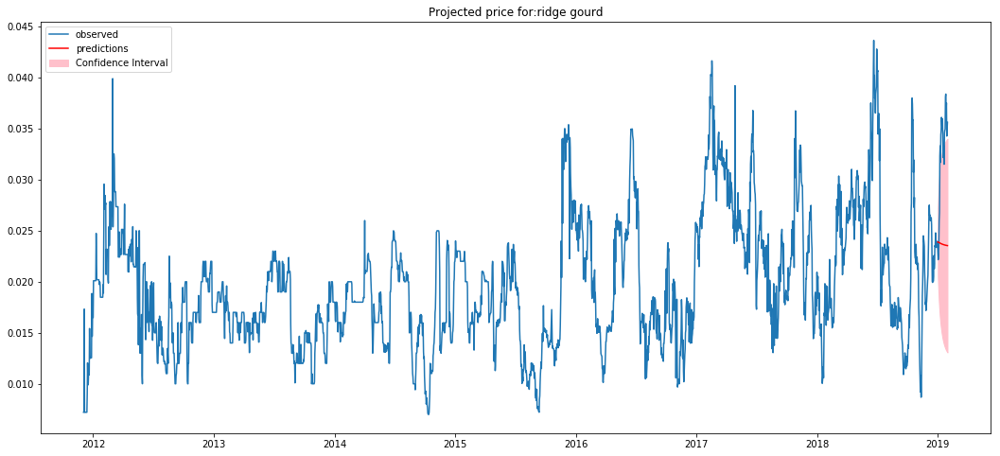

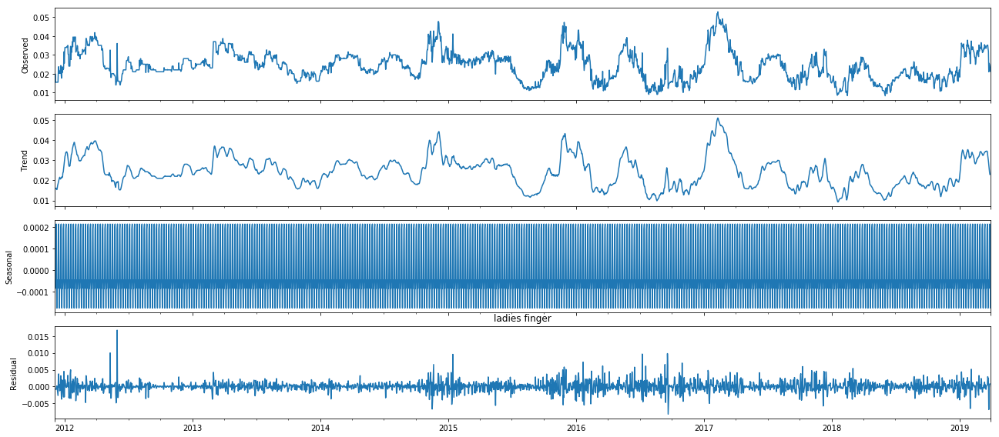



Test Statistic(More -ve, more stationary): -5.389886922992589


P-Value(If less than 0.05, reject null) 3.5568667012890877e-06
Reject Null Hypothesis(Series is non-stationary): True
RMSE: 110.78667112607852
MAE: 9.911628751045443




For SKU: Fresho banana-robusta 1 kg
Normalizing factor: 0.001
Product Group: banana robusta
Model Parameters:
p: 3
d: 1
q: 3
trend: n


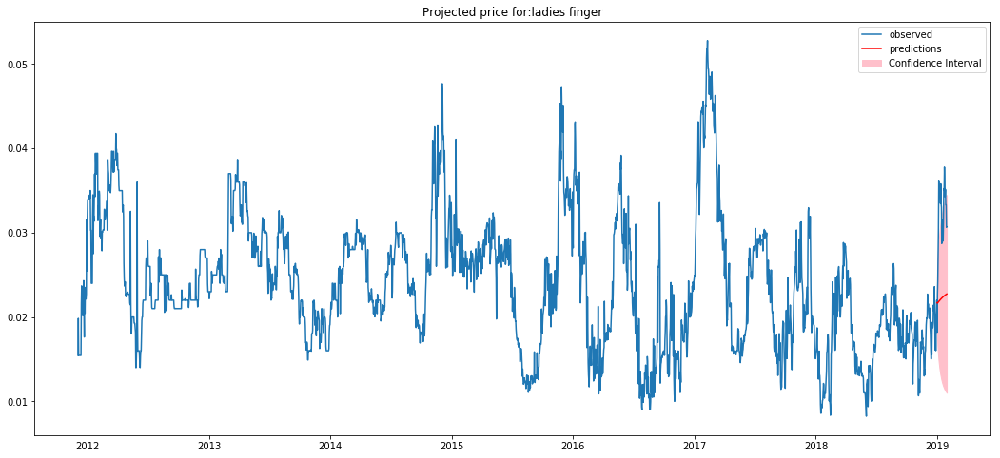

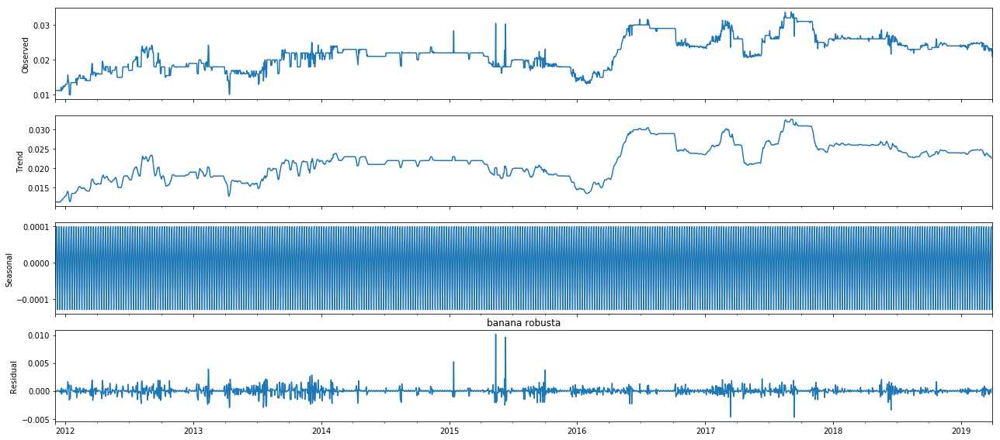



Test Statistic(More -ve, more stationary): -2.892944773772115


P-Value(If less than 0.05, reject null) 0.04617459702387811
Reject Null Hypothesis(Series is non-stationary): True
RMSE: 0.16390759403271593
MAE: 0.31946094899166605




For SKU: Fresho tomato-local 1 kg
Normalizing factor: 0.001
Product Group: tomato local
Model Parameters:
p: 1
d: 0
q: 3
trend: c


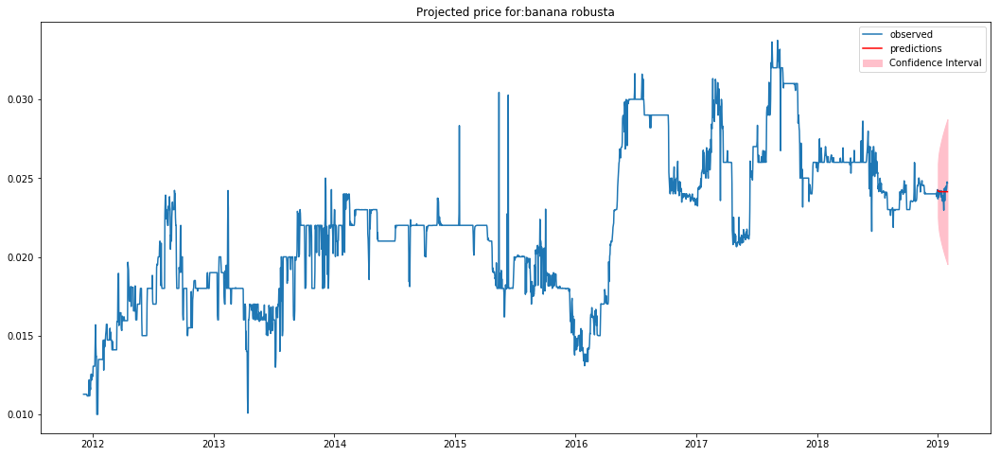

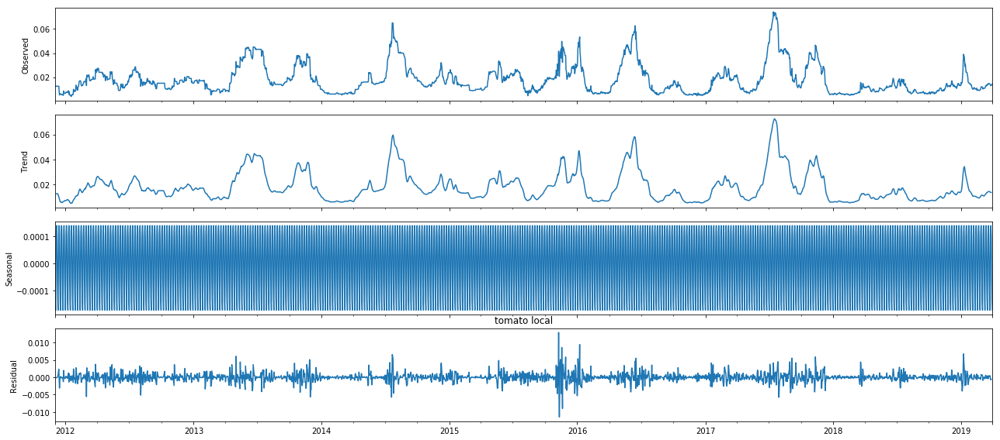



Test Statistic(More -ve, more stationary): -5.480304936502795


P-Value(If less than 0.05, reject null) 2.292262472281214e-06
Reject Null Hypothesis(Series is non-stationary): True
RMSE: 132.29210910130723
MAE: 8.264765084595275




For SKU: Fresho bottle-gourd 1 kg
Normalizing factor: 0.001
Product Group: bottle gourd
Model Parameters:
p: 3
d: 0
q: 0
trend: c


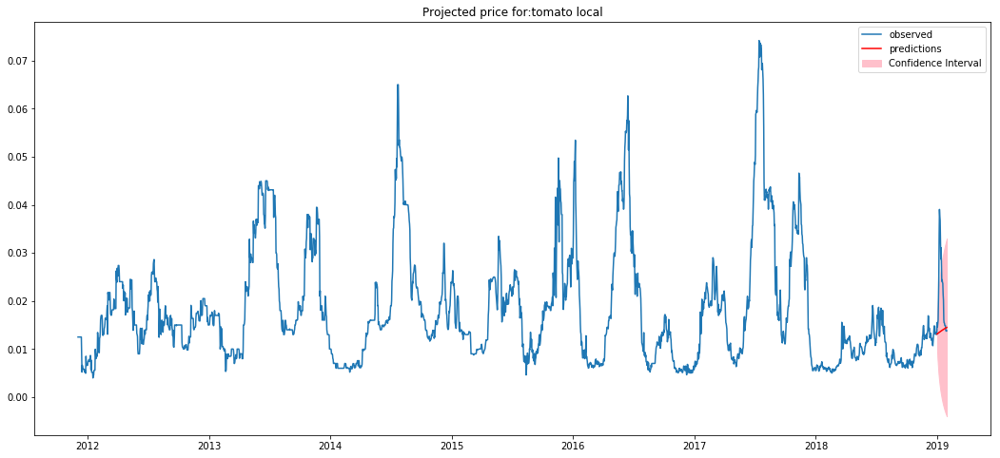

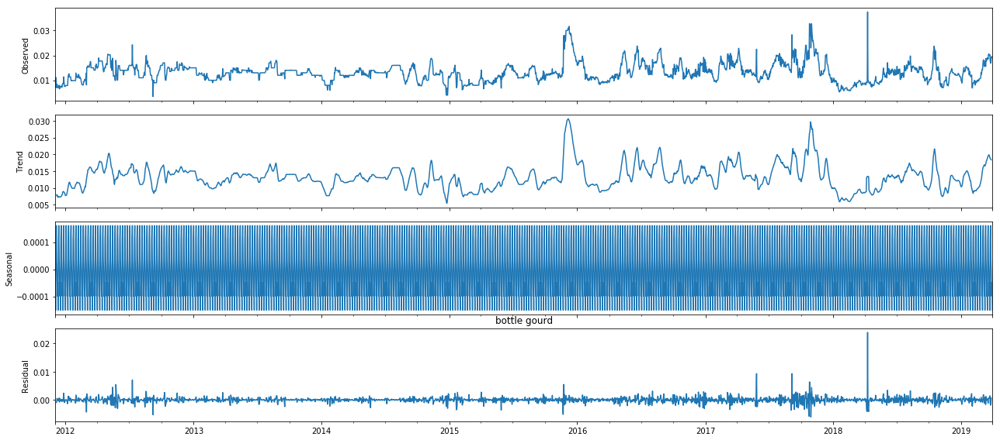



Test Statistic(More -ve, more stationary): -7.585937478661072


P-Value(If less than 0.05, reject null) 2.6067444781333317e-11
Reject Null Hypothesis(Series is non-stationary): True
RMSE: 4.2107984123497095
MAE: 1.8187366913581051




For SKU: Fresho watermelon-small 1 pc  1.7 - 2.5 kg
Normalizing factor: 1.0
Product Group: watermelon small
Model Parameters:
p: 2
d: 0
q: 3
trend: c


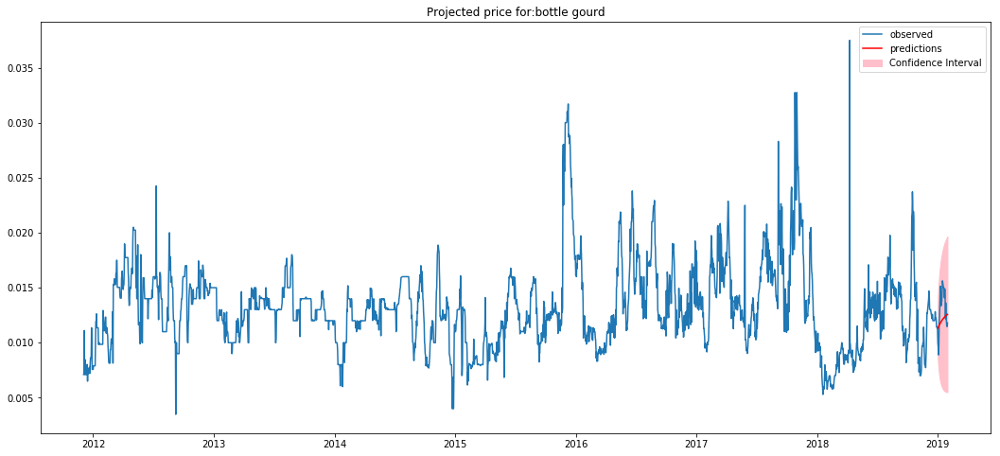

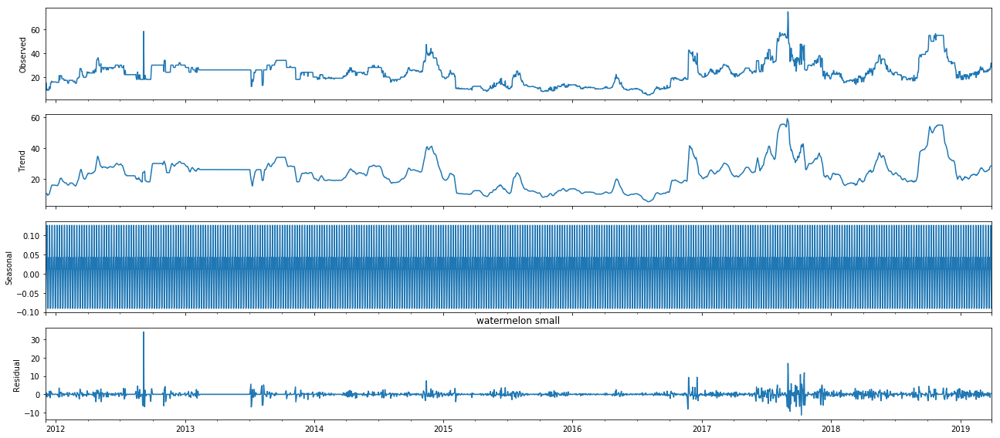



Test Statistic(More -ve, more stationary): -3.932587645605222


P-Value(If less than 0.05, reject null) 0.0018076883478711967
Reject Null Hypothesis(Series is non-stationary): True
RMSE: 14.58139974385201
MAE: 3.4735377253722683




For SKU: Fresho beetroot 1 kg
Normalizing factor: 0.001
Product Group: beetroot
Model Parameters:
p: 3
d: 0
q: 1
trend: c


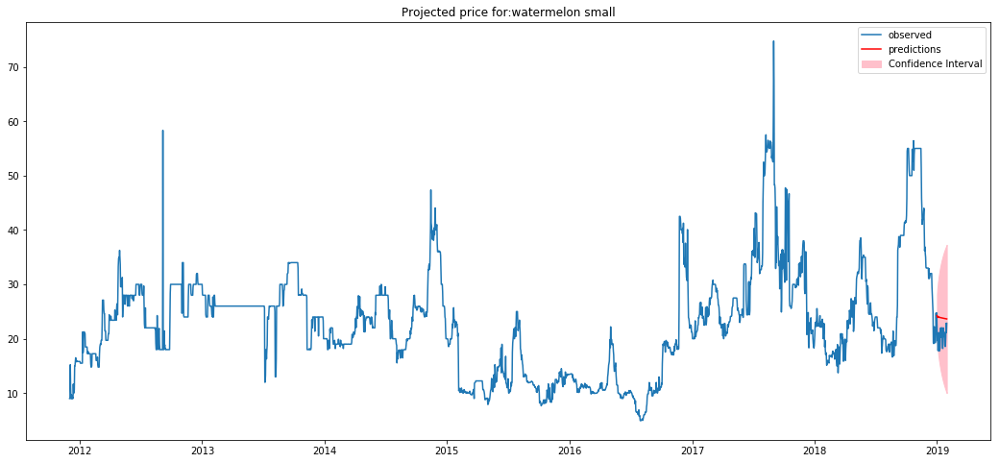

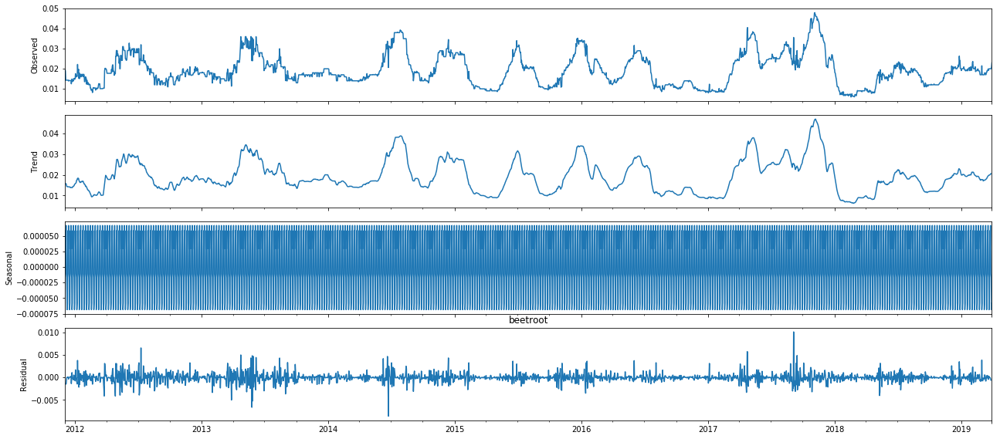



Test Statistic(More -ve, more stationary): -5.5467779703365565


P-Value(If less than 0.05, reject null) 1.6540206843465818e-06
Reject Null Hypothesis(Series is non-stationary): True
RMSE: 0.45008493282772594
MAE: 0.5498051678062211




For SKU: Fresho carrot-local 1 kg
Normalizing factor: 0.001
Product Group: carrot local
Model Parameters:
p: 3
d: 0
q: 2
trend: c


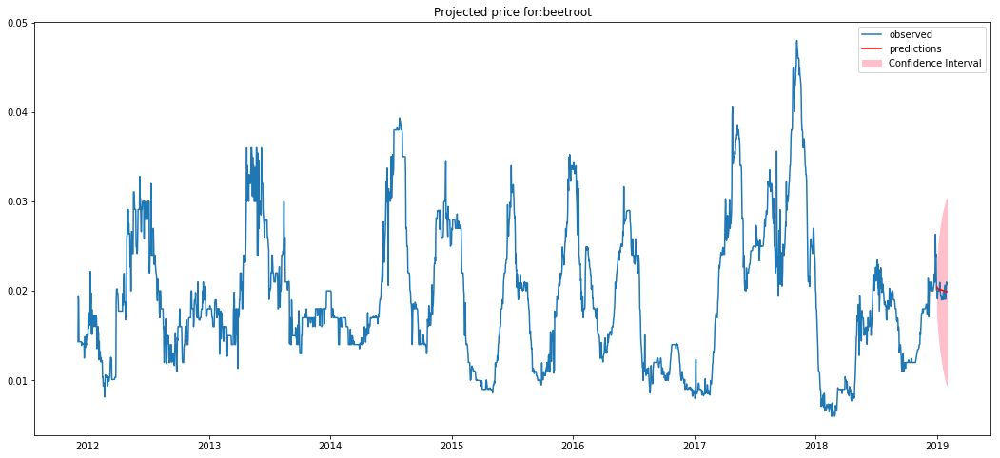

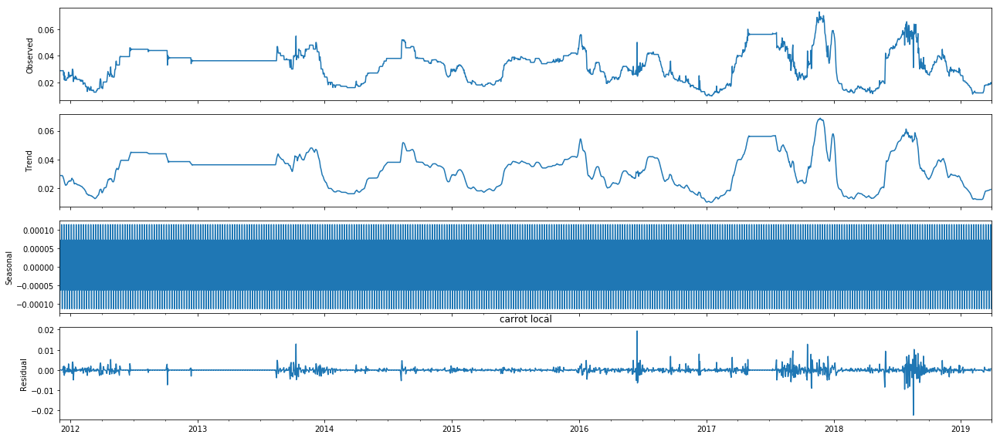



Test Statistic(More -ve, more stationary): -4.685250668627307


P-Value(If less than 0.05, reject null) 8.968862767295612e-05
Reject Null Hypothesis(Series is non-stationary): True
RMSE: 63.42916565471533
MAE: 7.079767385107799






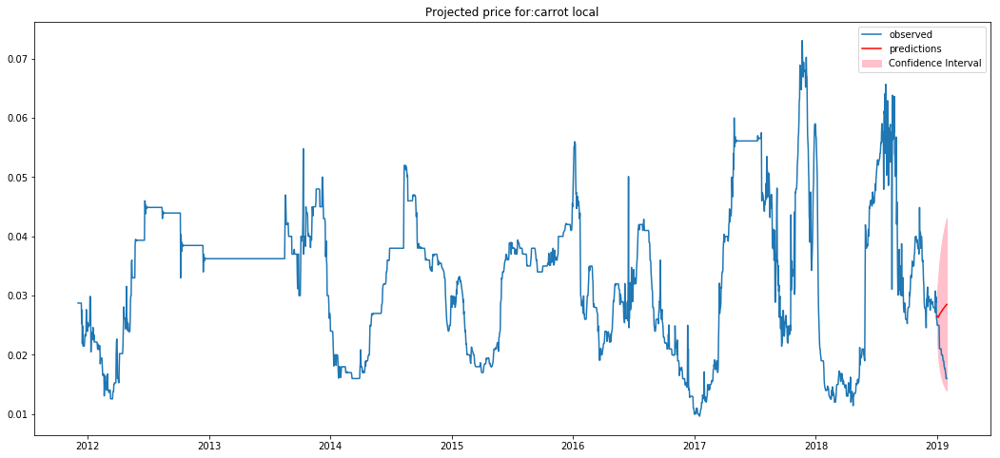

In [598]:
#List to store SKU names of all SKUs for which model has been built
SKU_list = []
#List to store predicted prices of all SKUs for which model has been built
predicted_prices = []
#List to store actual prices of all SKUs for which model has been built
actual_prices = []
#List to store RMSE scores of all SKUs for which model has been built
RMSE_scores = []
#List to store MAE scores of all SKUs for which model has been built
MAE_scores = []
#List to store last 30 dates of all SKUs for which model has been built
dates_list = []

num_observations = []

avg_prices = []

count = 0
#Iterating over all the SKUs
#Here, I've iterated over the product 'splits', as it makes it easier to obtain normalizing factor
for i,prod in enumerate(unique_products_split):
    #Storing the split priduct in a variable
    selected_sku = prod
    
    #Obtaining the actual name of the SKU
    actual_prod = unique_products[i]
    print("For SKU:",actual_prod)


    #Calling the method to obtain the forecast
    cost_price_predictions,actual_price,dates,number_of_observations,avg_price = get_forecast(selected_sku,actual_prod)
    #print("Cost Price Prediction:",cost_price_predictions)
    #print("Actual Prices:",actual_price)
    #print("Dates:",dates)
    #print("Number of Observations",number_of_observations)
    #print("Average Price",avg_price)


    if len(cost_price_predictions) == 30:
        
        rmse = mean_squared_error(actual_price,cost_price_predictions)
        print("RMSE:",rmse)
        
        mae = mean_absolute_error(actual_price,cost_price_predictions)
        print("MAE:",mae)
        #Storing the last 30 dates of the SKU for which we have obtained the forecast
        dates_list.append(dates)
        #Storing the name of the SKU for which we have obtained the forecast
        SKU_list.append(actual_prod)
        #Storing the predicted prices of the SKU for which we have obtained the forecast
        predicted_prices.append(cost_price_predictions)
        #Storing the RMSE of the SKU for which we have obtained the forecast
        RMSE_scores.append(rmse)
        #Storing the MAE of the SKU for which we have obtained the forecast
        MAE_scores.append(mae)
        #Storing the actual price of the SKU for which we have obtained the forecast
        actual_prices.append(actual_price)
        
        num_observations.append(number_of_observations)
        
        avg_prices.append(avg_price)
    print('\n\n\n')

## Accuracy Metrics obtained for each SKU

### Computing average 30 day SKU price

In [600]:
sku_avg_30_day_price = []
df_required = df_final[(df_final.index.year==2019)&(df_final.index.month==1)]
for sku in SKU_list:
    avg_price_sku = np.average((df_required[df_required['sku_description']==sku]['cp']))
    sku_avg_30_day_price.append(avg_price_sku)

### Calculating MAPE

In [601]:
MAPE = []
for i,prices in enumerate(actual_prices):
    diff = abs((actual_prices[i] - predicted_prices[i])/(actual_prices[i]))
    sum_diff = np.sum(diff)
    MAPE.append(sum_diff/30)

In [602]:
normalized_rmse = (np.array(RMSE_scores)/np.array(sku_avg_30_day_price))
df_summary_metrics = pd.DataFrame({'SKU':SKU_list,'RMSE':RMSE_scores,'Normalized RMSE':normalized_rmse,'Mean Absolute Error':MAE_scores,'Mean Absolute Percentage Error':MAPE,'Observations used':num_observations})
df_summary_metrics.sort_values(by=['Mean Absolute Percentage Error'],ascending=True,inplace=True)
df_summary_metrics.style

,SKU,RMSE,Normalized RMSE,Mean Absolute Error,Mean Absolute Percentage Error,Observations used
1,Fresho banana-yelakki 1 kg,0.133591,0.00364881,0.307815,0.00841236,2676
9,Fresho banana-robusta 1 kg,0.163908,0.00682206,0.319461,0.0134019,2675
13,Fresho beetroot 1 kg,0.450085,0.0227809,0.549805,0.0280894,2676
4,Fresho potato 1 kg,3.02109,0.148407,1.61324,0.078308,2676
0,Fresho onion 1 kg,2.45354,0.196715,1.18778,0.101663,2676
11,Fresho bottle-gourd 1 kg,4.2108,0.32172,1.81874,0.136422,2676
12,Fresho watermelon-small 1 pc 1.7 - 2.5 kg,14.5814,0.71525,3.47354,0.177607,2676
5,Fresho cucumber-english 1 kg,11.3523,0.773625,3.10863,0.212664,2171
7,Fresho ridge-gourd 1 kg,101.733,3.11661,9.17111,0.266157,2676
3,Fresho tomato-hybrid 1 kg,176.325,6.61935,9.35408,0.271633,2676


In [603]:
df_summary_metrics.to_csv("/Users/vegi/Documents/USC_Masters/ML/DemandForecasts/df_summary_standalone_np.csv", sep=",", float_format='%.6f',index=False, line_terminator='\n',encoding='utf-8')

### With CPI and Rainfall!!

### Rainfall Dataset

In [30]:
filename = '/Users/vegi/Documents/USC_Masters/ML/DemandForecasts/india_rain.csv'
df_rain = pd.read_csv(filename,parse_dates=['year_month_ID'],index_col='year_month_ID')
df_rain.head()

,MonthName,Year,Month,Rain_Andaman & Nicobar Islands,Rain_Arunachal Pradesh,Rain_Assam & Meghalaya,Rain_Naga Mani Mizo Tripura,Rain_Sub Himalayan West Bengal & Sikkim,Rain_Gangetic West Bengal,Rain_Orissa,...,Rain_Chhattisgarh,Rain_Coastal Andhra Pradesh,Rain_Telangana,Rain_Rayalseema,Rain_Tamil Nadu,Rain_Coastal Karnataka,Rain_North Interior Karnataka,Rain_South Interior Karnataka,Rain_Kerala,Rain_Lakshadweep
year_month_ID,,,,,,,,,,,,,,,,,,,,,
2012-01-01,JAN,2012,1,119.9,57.8,15.2,24.5,15.3,40.7,50.8,...,36.6,37.6,6.7,2.7,3.0,NaN,28.5,4.6,7.4,19.2
2012-02-01,FEB,2012,2,45.6,35.8,6.9,10.2,13.9,15.3,3.6,...,4.8,0.0,0.0,0.0,0.1,11.4,6.2,5.5,11.0,0.1
2012-03-01,MAR,2012,3,30.9,134.2,28.8,20.3,45.5,4.4,0.9,...,1.1,2.7,0.2,2.5,2.5,5.1,0.4,8.1,21.0,1.6
2012-04-01,APR,2012,4,55.8,403.4,279.1,243.5,159.8,57.7,34.8,...,14.9,24.0,14.0,32.7,35.5,77.0,35.4,99.0,171.1,76.8
2012-05-01,MAY,2012,5,533.9,187.4,185.8,163.5,202.4,44.2,21.3,...,9.4,39.3,8.4,38.8,41.9,22.9,19.5,45.6,95.3,21.2


### CPI Dataset

In [31]:
filename = '/Users/vegi/Documents/USC_Masters/ML/DemandForecasts/india_cpi.csv'
df_cpi = pd.read_csv(filename,parse_dates=['year_month_ID'],index_col='year_month_ID')
df_cpi.head()

,CPI Veg Rural,CPI Veg Urban,CPI Fruit Rural,CPI Fruit Urban,CPI Gen Rural,CPI Gen Urban
year_month_ID,,,,,,
2013-01-01,101.9,102.9,103.9,102.3,105.1,104.0
2013-02-01,102.4,104.9,104.0,103.1,105.8,104.7
2013-03-01,101.4,103.8,105.7,104.9,106.0,105.0
2013-04-01,103.4,109.7,108.3,109.5,106.4,105.7
2013-05-01,107.3,123.7,108.1,110.6,107.2,106.6


### Rainfall Dataset

In [32]:
#Creating another dataframe to store data from all the above three datasetsa(SKUs,Rainfall and CPI) in a single dataframe
df_all = df_final.copy()
cpi_columns = list(df_cpi.columns)
rain_columns = list(df_rain.columns)

#Removing redundant columns, this can be extracted from the index
rain_columns.remove('MonthName')
rain_columns.remove('Year')
rain_columns.remove('Month')

In [33]:
print("Columns in CPI dataframe:\n",cpi_columns)
print("\nColumns in Rainfall dataframe:\n",rain_columns)

columns_add = cpi_columns.copy()
columns_add.extend(rain_columns)

df_add = pd.DataFrame(None,columns=columns_add)

Columns in CPI dataframe:
 ['CPI Veg Rural', 'CPI Veg Urban', 'CPI Fruit Rural', 'CPI Fruit Urban', 'CPI Gen Rural', 'CPI Gen Urban']

Columns in Rainfall dataframe:
 ['Rain_Andaman & Nicobar Islands', 'Rain_Arunachal Pradesh', 'Rain_Assam & Meghalaya', 'Rain_Naga Mani Mizo Tripura', 'Rain_Sub Himalayan West Bengal & Sikkim', 'Rain_Gangetic West Bengal', 'Rain_Orissa', 'Rain_Jharkhand', 'Rain_Bihar', 'Rain_East Uttar Pradesh', 'Rain_West Uttar Pradesh', 'Rain_Uttarakhand', 'Rain_Haryana Delhi & Chandigarh', 'Rain_Punjab', 'Rain_Himachal Pradesh', 'Rain_Jammu & Kashmir', 'Rain_West Rajasthan', 'Rain_East Rajasthan', 'Rain_West Madhya Pradesh', 'Rain_East Madhya Pradesh', 'Rain_Gujarat Region', 'Rain_Saurashtra & Kutch', 'Rain_Konkan & Goa', 'Rain_Madhya Maharashtra', 'Rain_Matathwada', 'Rain_Vidarbha', 'Rain_Chhattisgarh', 'Rain_Coastal Andhra Pradesh', 'Rain_Telangana', 'Rain_Rayalseema', 'Rain_Tamil Nadu', 'Rain_Coastal Karnataka', 'Rain_North Interior Karnataka', 'Rain_South Interior

### Trimming the dataset (Only need values till the end of 2016)

In [310]:
df_all = df_all[(df_all.index.year>=2012)&(df_all.index.year<=2016)]

In [311]:
df_all.tail()

,source_sku_id,sku_description,cp,Normalized Price,PROD_GROUP
2016-12-27,10000070,Fresho carrot-local 1 kg,12.78,0.01278,carrot local
2016-12-28,10000070,Fresho carrot-local 1 kg,11.01,0.01101,carrot local
2016-12-29,10000070,Fresho carrot-local 1 kg,10.97,0.01097,carrot local
2016-12-30,10000070,Fresho carrot-local 1 kg,10.75,0.01075,carrot local
2016-12-31,10000070,Fresho carrot-local 1 kg,9.99,0.00999,carrot local


In [312]:
df_all = pd.concat([df_all,df_add],axis=1)
df_all.head()

,source_sku_id,sku_description,cp,Normalized Price,PROD_GROUP,CPI Veg Rural,CPI Veg Urban,CPI Fruit Rural,CPI Fruit Urban,CPI Gen Rural,...,Rain_Chhattisgarh,Rain_Coastal Andhra Pradesh,Rain_Telangana,Rain_Rayalseema,Rain_Tamil Nadu,Rain_Coastal Karnataka,Rain_North Interior Karnataka,Rain_South Interior Karnataka,Rain_Kerala,Rain_Lakshadweep
2012-01-01,10000148,Fresho onion 1 kg,8.79,0.00879,onion,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2012-01-02,10000148,Fresho onion 1 kg,8.55,0.00855,onion,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2012-01-03,10000148,Fresho onion 1 kg,8.55,0.00855,onion,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2012-01-04,10000148,Fresho onion 1 kg,8.55,0.00855,onion,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2012-01-05,10000148,Fresho onion 1 kg,8.55,0.00855,onion,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [313]:
for i,observation in df_cpi.iterrows():
    #Obtaining year and month of the index in CPI dataframe
    year = i.year
    month = i.month
    df_all.loc[(df_all.index.year==year)&(df_all.index.month==month),cpi_columns] = df_cpi.loc[(df_cpi.index.year==year)&(df_cpi.index.month==month),cpi_columns]

In [314]:
for i,observation in df_rain.iterrows():      
    #Obtaining year and month of the index in Rainfall dataframe
    year = i.year
    month = i.month
    df_all.loc[(df_all.index.year==year)&(df_all.index.month==month),rain_columns] = df_rain.loc[(df_rain.index.year==year)&(df_rain.index.month==month),rain_columns]

### Data Imputation
For data imputation I've made use of the SimpleImputer library under sklearn. I've replaced the missing values with the mean of the same feature.

In [315]:
df_all_columns = df_all.columns
columns_for_imputation = columns_add.copy()
columns_non_imputed = list(set(df_all_columns)-set(columns_for_imputation))
df_cpi_rainfall = df_all[columns_non_imputed].copy()

In [316]:
#Data imputation cannot be done when multiple observations have the same index
index = df_cpi_rainfall.index
print(index)

DatetimeIndex(['2012-01-01', '2012-01-02', '2012-01-03', '2012-01-04',
               '2012-01-05', '2012-01-06', '2012-01-07', '2012-01-08',
               '2012-01-09', '2012-01-10',
               ...
               '2016-12-22', '2016-12-23', '2016-12-24', '2016-12-25',
               '2016-12-26', '2016-12-27', '2016-12-28', '2016-12-29',
               '2016-12-30', '2016-12-31'],
              dtype='datetime64[ns]', length=26929, freq=None)


In [317]:
imp_mean = SimpleImputer(missing_values=np.NaN, strategy='mean')

values = df_all[columns_for_imputation].values

values = imp_mean.fit_transform(values)

df_all = pd.DataFrame(values,columns=columns_for_imputation,index=index)

print("Dataframe after data imputation:")
df_all.head()

Dataframe after data imputation:


,CPI Veg Rural,CPI Veg Urban,CPI Fruit Rural,CPI Fruit Urban,CPI Gen Rural,CPI Gen Urban,Rain_Andaman & Nicobar Islands,Rain_Arunachal Pradesh,Rain_Assam & Meghalaya,Rain_Naga Mani Mizo Tripura,...,Rain_Chhattisgarh,Rain_Coastal Andhra Pradesh,Rain_Telangana,Rain_Rayalseema,Rain_Tamil Nadu,Rain_Coastal Karnataka,Rain_North Interior Karnataka,Rain_South Interior Karnataka,Rain_Kerala,Rain_Lakshadweep
2012-01-01,137.673743,145.703492,126.06648,122.053352,121.053352,118.794134,119.900000,57.800000,15.200000,24.500000,...,36.600000,37.600000,6.700000,2.700000,3.000000,285.263563,28.500000,4.600000,7.400000,19.200000
2012-01-02,137.673743,145.703492,126.06648,122.053352,121.053352,118.794134,261.110181,222.423416,189.785181,149.739932,...,108.816063,87.227262,83.710294,60.742308,67.583371,285.263563,54.290158,83.319118,216.716742,115.975226
2012-01-03,137.673743,145.703492,126.06648,122.053352,121.053352,118.794134,261.110181,222.423416,189.785181,149.739932,...,108.816063,87.227262,83.710294,60.742308,67.583371,285.263563,54.290158,83.319118,216.716742,115.975226
2012-01-04,137.673743,145.703492,126.06648,122.053352,121.053352,118.794134,261.110181,222.423416,189.785181,149.739932,...,108.816063,87.227262,83.710294,60.742308,67.583371,285.263563,54.290158,83.319118,216.716742,115.975226
2012-01-05,137.673743,145.703492,126.06648,122.053352,121.053352,118.794134,261.110181,222.423416,189.785181,149.739932,...,108.816063,87.227262,83.710294,60.742308,67.583371,285.263563,54.290158,83.319118,216.716742,115.975226


In [318]:
df_cpi_rainfall = pd.concat([df_cpi_rainfall,df_all],axis=1)
print("Final Dataframe(after appending the columns for which imputations was not required)")
df_cpi_rainfall.head()

Final Dataframe(after appending the columns for which imputations was not required)


,Normalized Price,PROD_GROUP,source_sku_id,cp,sku_description,CPI Veg Rural,CPI Veg Urban,CPI Fruit Rural,CPI Fruit Urban,CPI Gen Rural,...,Rain_Chhattisgarh,Rain_Coastal Andhra Pradesh,Rain_Telangana,Rain_Rayalseema,Rain_Tamil Nadu,Rain_Coastal Karnataka,Rain_North Interior Karnataka,Rain_South Interior Karnataka,Rain_Kerala,Rain_Lakshadweep
2012-01-01,0.00879,onion,10000148,8.79,Fresho onion 1 kg,137.673743,145.703492,126.06648,122.053352,121.053352,...,36.600000,37.600000,6.700000,2.700000,3.000000,285.263563,28.500000,4.600000,7.400000,19.200000
2012-01-02,0.00855,onion,10000148,8.55,Fresho onion 1 kg,137.673743,145.703492,126.06648,122.053352,121.053352,...,108.816063,87.227262,83.710294,60.742308,67.583371,285.263563,54.290158,83.319118,216.716742,115.975226
2012-01-03,0.00855,onion,10000148,8.55,Fresho onion 1 kg,137.673743,145.703492,126.06648,122.053352,121.053352,...,108.816063,87.227262,83.710294,60.742308,67.583371,285.263563,54.290158,83.319118,216.716742,115.975226
2012-01-04,0.00855,onion,10000148,8.55,Fresho onion 1 kg,137.673743,145.703492,126.06648,122.053352,121.053352,...,108.816063,87.227262,83.710294,60.742308,67.583371,285.263563,54.290158,83.319118,216.716742,115.975226
2012-01-05,0.00855,onion,10000148,8.55,Fresho onion 1 kg,137.673743,145.703492,126.06648,122.053352,121.053352,...,108.816063,87.227262,83.710294,60.742308,67.583371,285.263563,54.290158,83.319118,216.716742,115.975226


### Testing for missing values in each product group

In [228]:
df_copy = df_cpi_rainfall.copy()
#col = modified_df.columns
#df_final = pd.DataFrame({},columns=col)

sum = 0
count = 0
for prod in prod_groups:
        print("Product:",prod)
        
        #Obtaining observataions of a particular product
        df_temp = df_copy[df_copy['PROD_GROUP']== prod]
        
        #Resampling Data
        df_temp = df_temp.resample('D').mean()
        
        #print(df_temp.head())
        #Printing number of missing values
        if (pd.isna(df_temp['Normalized Price']).any()):
            print("Missing values are present")
        else:
            print("No missing values")

Product: onion
No missing values
Product: banana yelakki
No missing values
Product: capsicum green
No missing values
Product: tomato hybrid
No missing values
Product: potato
No missing values
Product: cucumber english
No missing values
Product: cucumber
No missing values
Product: ridge gourd
No missing values
Product: ladies finger
No missing values
Product: banana robusta
No missing values
Product: tomato local
No missing values
Product: bottle gourd
No missing values
Product: watermelon small
No missing values
Product: beetroot
No missing values
Product: carrot local
No missing values


### Testing for one product

In [282]:
columns_exog = ['Normalized Price','CPI Veg Rural', 'CPI Veg Urban', 'CPI Fruit Rural', 'CPI Fruit Urban', 'CPI Gen Rural', 'CPI Gen Urban','Rain_Andaman & Nicobar Islands', 'Rain_Arunachal Pradesh', 'Rain_Assam & Meghalaya', 'Rain_Naga Mani Mizo Tripura', 
           'Rain_Sub Himalayan West Bengal & Sikkim', 'Rain_Gangetic West Bengal', 'Rain_Orissa', 'Rain_Jharkhand', 'Rain_Bihar', 'Rain_East Uttar Pradesh', 'Rain_West Uttar Pradesh', 'Rain_Uttarakhand', 'Rain_Haryana Delhi & Chandigarh',
           'Rain_Punjab', 'Rain_Himachal Pradesh', 'Rain_Jammu & Kashmir', 'Rain_West Rajasthan', 'Rain_East Rajasthan', 'Rain_West Madhya Pradesh', 'Rain_East Madhya Pradesh', 'Rain_Gujarat Region', 'Rain_Saurashtra & Kutch', 
           'Rain_Konkan & Goa', 'Rain_Madhya Maharashtra', 'Rain_Matathwada', 'Rain_Vidarbha', 'Rain_Chhattisgarh', 'Rain_Coastal Andhra Pradesh', 'Rain_Telangana', 'Rain_Rayalseema', 'Rain_Tamil Nadu', 'Rain_Coastal Karnataka',
           'Rain_North Interior Karnataka', 'Rain_South Interior Karnataka', 'Rain_Kerala', 'Rain_Lakshadweep']

columns_needed = ['cp','Normalized Price','CPI Veg Rural', 'CPI Veg Urban', 'CPI Fruit Rural', 'CPI Fruit Urban', 'CPI Gen Rural', 'CPI Gen Urban','Rain_Andaman & Nicobar Islands', 'Rain_Arunachal Pradesh', 'Rain_Assam & Meghalaya', 'Rain_Naga Mani Mizo Tripura', 
           'Rain_Sub Himalayan West Bengal & Sikkim', 'Rain_Gangetic West Bengal', 'Rain_Orissa', 'Rain_Jharkhand', 'Rain_Bihar', 'Rain_East Uttar Pradesh', 'Rain_West Uttar Pradesh', 'Rain_Uttarakhand', 'Rain_Haryana Delhi & Chandigarh',
           'Rain_Punjab', 'Rain_Himachal Pradesh', 'Rain_Jammu & Kashmir', 'Rain_West Rajasthan', 'Rain_East Rajasthan', 'Rain_West Madhya Pradesh', 'Rain_East Madhya Pradesh', 'Rain_Gujarat Region', 'Rain_Saurashtra & Kutch', 
           'Rain_Konkan & Goa', 'Rain_Madhya Maharashtra', 'Rain_Matathwada', 'Rain_Vidarbha', 'Rain_Chhattisgarh', 'Rain_Coastal Andhra Pradesh', 'Rain_Telangana', 'Rain_Rayalseema', 'Rain_Tamil Nadu', 'Rain_Coastal Karnataka',
           'Rain_North Interior Karnataka', 'Rain_South Interior Karnataka', 'Rain_Kerala', 'Rain_Lakshadweep']

temp_df_exog = df_cpi_rainfall[df_cpi_rainfall['PROD_GROUP']=='onion'].loc[:,columns_needed].copy()
temp_df_exog.head()

,cp,Normalized Price,CPI Veg Rural,CPI Veg Urban,CPI Fruit Rural,CPI Fruit Urban,CPI Gen Rural,CPI Gen Urban,Rain_Andaman & Nicobar Islands,Rain_Arunachal Pradesh,...,Rain_Chhattisgarh,Rain_Coastal Andhra Pradesh,Rain_Telangana,Rain_Rayalseema,Rain_Tamil Nadu,Rain_Coastal Karnataka,Rain_North Interior Karnataka,Rain_South Interior Karnataka,Rain_Kerala,Rain_Lakshadweep
2012-01-01,8.79,0.00879,137.673743,145.703492,126.06648,122.053352,121.053352,118.794134,119.900000,57.800000,...,36.600000,37.600000,6.700000,2.700000,3.000000,285.263563,28.500000,4.600000,7.400000,19.200000
2012-01-02,8.55,0.00855,137.673743,145.703492,126.06648,122.053352,121.053352,118.794134,261.110181,222.423416,...,108.816063,87.227262,83.710294,60.742308,67.583371,285.263563,54.290158,83.319118,216.716742,115.975226
2012-01-03,8.55,0.00855,137.673743,145.703492,126.06648,122.053352,121.053352,118.794134,261.110181,222.423416,...,108.816063,87.227262,83.710294,60.742308,67.583371,285.263563,54.290158,83.319118,216.716742,115.975226
2012-01-04,8.55,0.00855,137.673743,145.703492,126.06648,122.053352,121.053352,118.794134,261.110181,222.423416,...,108.816063,87.227262,83.710294,60.742308,67.583371,285.263563,54.290158,83.319118,216.716742,115.975226
2012-01-05,8.55,0.00855,137.673743,145.703492,126.06648,122.053352,121.053352,118.794134,261.110181,222.423416,...,108.816063,87.227262,83.710294,60.742308,67.583371,285.263563,54.290158,83.319118,216.716742,115.975226


In [283]:
from statsmodels.tsa.stattools import adfuller

result = adfuller(temp_df_exog['Normalized Price'])
print("Augmented Dickyfuller Test Result:",result)

# Print test statistic
print("\n\nTest Statistic(More -ve, more stationary):",result[0])

# Print p-value
print("\n\nP-Value(If less than 0.05, reject null)",result[1])
print("Reject Null Hypothesis(Series is non-stationary):",result[1]<=0.05)

# Print critical values
print("\n\nCritical Values:",result[4]) 

Augmented Dickyfuller Test Result: (-2.712112405585478, 0.07196564402881468, 6, 1820, {'1%': -3.4339481027788024, '5%': -2.8631293617920544, '10%': -2.5676161227508754}, -19403.395400803485)


Test Statistic(More -ve, more stationary): -2.712112405585478


P-Value(If less than 0.05, reject null) 0.07196564402881468
Reject Null Hypothesis(Series is non-stationary): False


Critical Values: {'1%': -3.4339481027788024, '5%': -2.8631293617920544, '10%': -2.5676161227508754}


### Iterating over different values of p,d,q to find out which model best fits the data

In [239]:
columns = ['CPI Veg Rural', 'CPI Veg Urban', 'CPI Fruit Rural', 'CPI Fruit Urban', 'CPI Gen Rural', 'CPI Gen Urban','Rain_Andaman & Nicobar Islands', 'Rain_Arunachal Pradesh', 'Rain_Assam & Meghalaya', 'Rain_Naga Mani Mizo Tripura', 
           'Rain_Sub Himalayan West Bengal & Sikkim', 'Rain_Gangetic West Bengal', 'Rain_Orissa', 'Rain_Jharkhand', 'Rain_Bihar', 'Rain_East Uttar Pradesh', 'Rain_West Uttar Pradesh', 'Rain_Uttarakhand', 'Rain_Haryana Delhi & Chandigarh',
           'Rain_Punjab', 'Rain_Himachal Pradesh', 'Rain_Jammu & Kashmir', 'Rain_West Rajasthan', 'Rain_East Rajasthan', 'Rain_West Madhya Pradesh', 'Rain_East Madhya Pradesh', 'Rain_Gujarat Region', 'Rain_Saurashtra & Kutch', 
           'Rain_Konkan & Goa', 'Rain_Madhya Maharashtra', 'Rain_Matathwada', 'Rain_Vidarbha', 'Rain_Chhattisgarh', 'Rain_Coastal Andhra Pradesh', 'Rain_Telangana', 'Rain_Rayalseema', 'Rain_Tamil Nadu', 'Rain_Coastal Karnataka',
           'Rain_North Interior Karnataka', 'Rain_South Interior Karnataka', 'Rain_Kerala', 'Rain_Lakshadweep']

order_scores = []
trend_list = ['n','c','t','ct']
for p in range(4):
    for q in range(4):
        for d in range(3):
            for t in trend_list:
                try:
                    # Instantiate the model
                    #model = SARIMAX(y, order=(p,d,q))
                    model = SARIMAX(temp_df_exog[:-30]['Normalized Price'].values, order=(p,d,q),trend=t,exog=temp_df_exog[:-30][columns])

                    # Fit the model
                    results = model.fit()
                
                    #Prints results
                    order_scores.append((p,d,q,t,results.aic,results.bic))
        
                except:
                    print("In except")
                    continue
            
order_scores = pd.DataFrame(order_scores,columns=['p','d','q','trend','aic','bic'])

In [240]:
order_scores.sort_values(by='aic').head()

,p,d,q,trend,aic,bic
184,3,1,3,n,-19261.684137,-18992.511592
185,3,1,3,c,-19259.678665,-18985.012803
186,3,1,3,t,-19259.661371,-18984.995509
187,3,1,3,ct,-19257.496678,-18977.337498
76,1,1,2,n,-19257.357956,-19004.665362


### One step forecast

In [284]:
# Instantiate the best model
model = SARIMAX(temp_df_exog[:-30]['Normalized Price'].values, order=(3,1,3),trend='n',exog=temp_df_exog[:-30][columns])
# Fit the model
results = model.fit()

# Print summary
print(results.summary())

# Generate predictions
one_step_forecast = results.get_prediction(start=-30)

# Extract prediction mean
mean_forecast = one_step_forecast.predicted_mean

# Get confidence intervals of predictions
confidence_intervals = one_step_forecast.conf_int()
#print(confidence_intervals)
# Select lower and upper confidence limits
lower_limits = confidence_intervals.loc[:,'lower y']
upper_limits = confidence_intervals.loc[:,'upper y']

                           Statespace Model Results                           
Dep. Variable:                      y   No. Observations:                 1797
Model:               SARIMAX(3, 1, 3)   Log Likelihood                9679.842
Date:                Mon, 07 Oct 2019   AIC                         -19261.684
Time:                        19:58:04   BIC                         -18992.512
Sample:                    01-01-2012   HQIC                        -19162.311
                         - 12-01-2016                                         
Covariance Type:                  opg                                         
                                              coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------------------------
CPI Veg Rural                            2.971e-05      0.000      0.148      0.882      -0.000       0.000
CPI Veg Urban                           -2.9

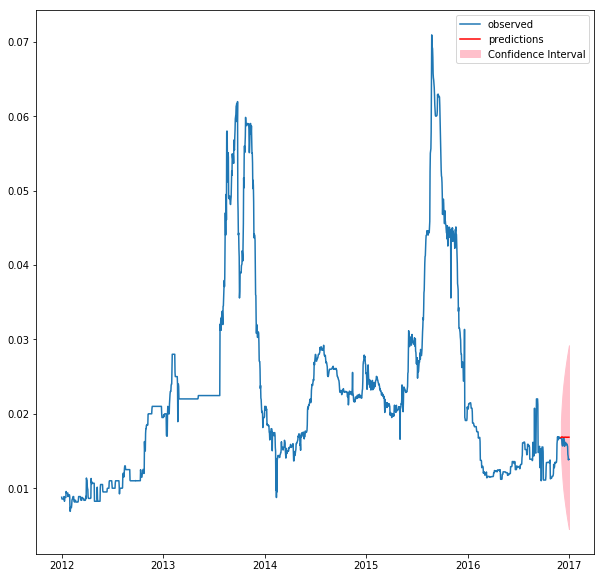

In [295]:
dynamic_forecast_30_days = results.get_forecast(30, alpha=0.05,exog =temp_df_exog[-30:][columns])  # 95% conf
#Mean of forecast
mean_forecast_30_days = dynamic_forecast_30_days.predicted_mean


#Confidence intervals
confidence_intervals_30_days = dynamic_forecast_30_days.conf_int()

# Select lower and upper confidence limits
lower_limits = confidence_intervals_30_days.loc[:,'lower y']
upper_limits = confidence_intervals_30_days.loc[:,'upper y']


#Plot the graph
dates = temp_df_exog.index
dates_2 = mean_forecast_30_days.index

plt.figure(figsize=(10,10))
plt.plot(dates,temp_df_exog['Normalized Price'].values, label='observed')
plt.plot(dates_2,mean_forecast_30_days.values,color='red', label='predictions')
plt.fill_between(dates_2,lower_limits,upper_limits,color='pink',label='Confidence Interval')
plt.legend(loc='best')

In [299]:
temp_df_tail = temp_df_exog.tail(30)
rmse = mean_squared_error(temp_df_tail['Normalized Price'],mean_forecast_30_days)
print("RMSE:",rmse)

print("RMSE on Actual Price:",rmse*1000)

RMSE: 1.837951419311076e-06
RMSE on Actual Price: 0.0018379514193110759


In [301]:
cost_price_predictions = mean_forecast_30_days*1000
mae = mean_absolute_error(temp_df_tail['cp'],cost_price_predictions)
print("MAE:",mae)

MAPE_diff = diff_csv_mape(temp_df_tail['cp'],cost_price_predictions)
#print(MAPE_diff)
mape_sum = np.sum(MAPE_diff)
MAPE = mape_sum/30
print("MAPE:",MAPE)

MAE: 1.0437691370596598
MAPE: 0.0694177222152787


### Automating for all products

### Function for augmented Dicky Fuller Test

In [302]:
def adf(y):
    result = adfuller(y)

    # Print test statistic
    print("\n\nTest Statistic(More -ve, more stationary):",result[0])

    # Print p-value
    print("\n\nP-Value(If less than 0.05, reject null)",result[1])
    p_value_bool = result[1]<=0.05
    print("Reject Null Hypothesis(Series is non-stationary):",result[1]<=0.05)

    return p_value_bool

### Function to plot decomposition plot¶
Decomposition plots provide a useful abstract model for thinking about time series generally and for better understanding problems during time series analysis and forecasting. It gives a clear picture of the tends, seasonality and the noise in the time series.

In [303]:
def plot_decomposition(y,name):
    rcParams['figure.figsize'] = 18, 8
    decomposition = sm.tsa.seasonal_decompose(y, model='additive')
    fig = decomposition.plot()
    plt.title(name)
    plt.show()

### Function to find the best model for a given time series

In [323]:
def find_best_model(df):
    order_scores = []
    for p in range(4):
        for q in range(4):
            for d in range(3):
                for t in trend_list:
                    try:
                        # Instantiate the model
                        #model = SARIMAX(y, order=(p,d,q))
                        model = SARIMAX(df['Normalized Price'].values, order=(p,d,q),trend=t,exog=df[columns])
                        # Fit the model
                        results = model.fit()
                        #Obtain results
                        order_scores.append((p,d,q,t,results.aic,results.bic))
        
                    except:
                        continue
            
    order_scores = pd.DataFrame(order_scores,columns=['p','d','q','trend','aic','bic'])
    order_scores.sort_values('aic',inplace = True)
    
    p,d,q,trend,aic,bic = order_scores.iloc[0,0],order_scores.iloc[0,1],order_scores.iloc[0,2],order_scores.iloc[0,3],order_scores.iloc[0,4],order_scores.iloc[0,5]
    return p,d,q,trend,aic,bic

### Function to build a model after obtaining suitable parameters

In [335]:
def SARIMAX_model(df,p,d,q,trend,name):
    # Instantiate the best model
    model = SARIMAX(df[:-30]['Normalized Price'].values, order=(p,d,q),trend=trend,exog=df[:-30][columns])

    # Fit the model
    results = model.fit()

    # Generate predictions
    dynamic_forecast_30_days = results.get_forecast(30, alpha=0.05,exog =temp_df_exog[-30:][columns])  # 95% conf
    
    #Mean of forecast
    mean_forecast_30_days = dynamic_forecast_30_days.predicted_mean
    
    # Get confidence intervals of predictions
    confidence_intervals_30_days = dynamic_forecast_30_days.conf_int()
    # Select lower and upper confidence limits
    lower_limits = confidence_intervals_30_days.loc[:,'lower y']
    upper_limits = confidence_intervals_30_days.loc[:,'upper y']
    
    #Plot the graph
    dates = temp_df_exog.index
    dates_2 = mean_forecast_30_days.index

    plt.figure(figsize=(10,10))
    plt.plot(dates,temp_df_exog['Normalized Price'].values, label='observed')
    plt.plot(dates_2,mean_forecast_30_days.values,color='red', label='predictions')
    plt.fill_between(dates_2,lower_limits,upper_limits,color='pink',label='Confidence Interval')
    plt.legend(loc='best')
    plt.title("Projected price for:"+name)

### Iterating over all product groups and making calls to the aforementioned functions

Product: onion


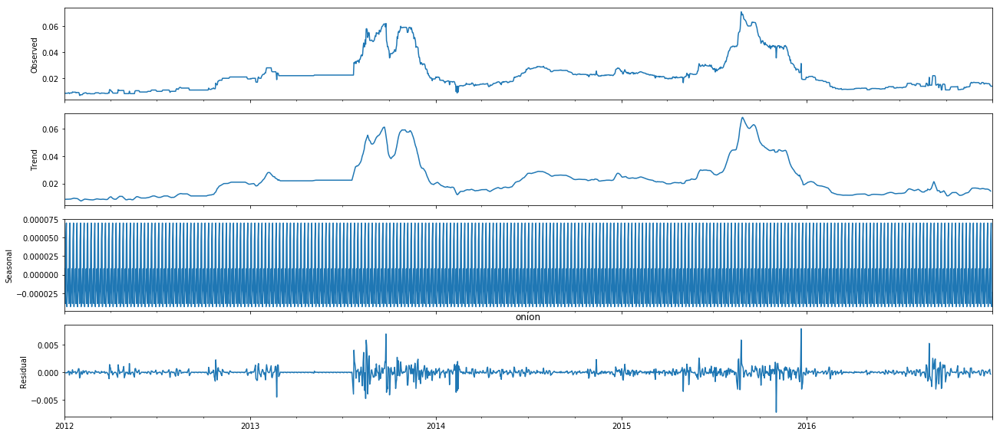



Test Statistic(More -ve, more stationary): -2.712112405585478


P-Value(If less than 0.05, reject null) 0.07196564402881468
Reject Null Hypothesis(Series is non-stationary): False
Best Model:
p: 3
q: 3
d: 1
trend: n
Number of Products left: 4
Product: banana yelakki


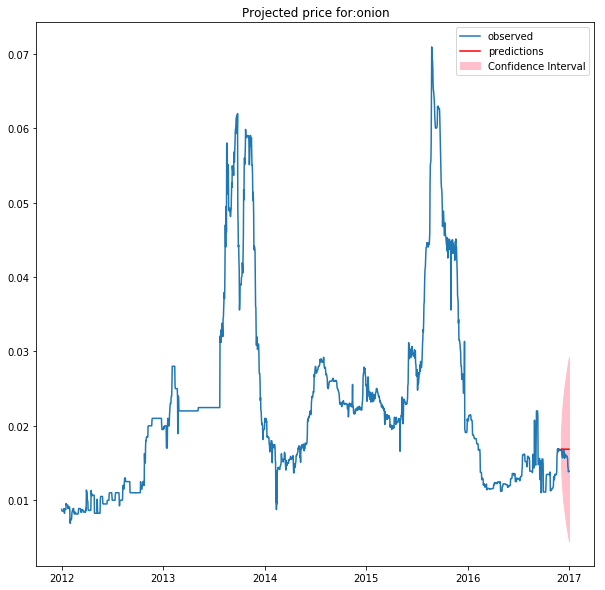

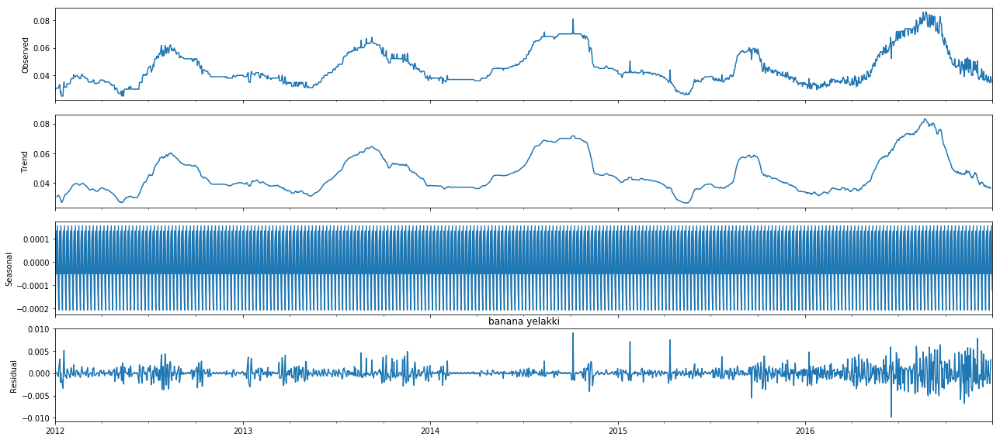



Test Statistic(More -ve, more stationary): -3.597271490150522


P-Value(If less than 0.05, reject null) 0.00581340576485223
Reject Null Hypothesis(Series is non-stationary): True
Best Model:
p: 0
q: 2
d: 1
trend: n
Number of Products left: 3
Product: capsicum green


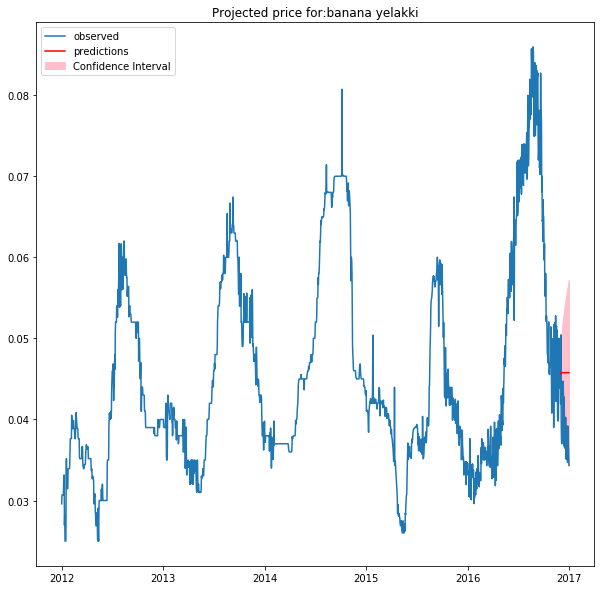

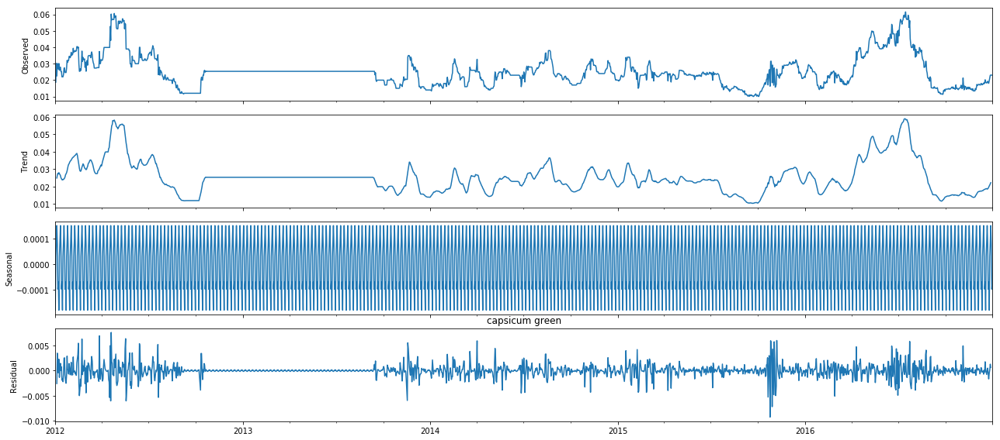



Test Statistic(More -ve, more stationary): -4.295091518301888


P-Value(If less than 0.05, reject null) 0.0004529872143710647
Reject Null Hypothesis(Series is non-stationary): True
Best Model:
p: 3
q: 0
d: 1
trend: n
Number of Products left: 2
Product: tomato hybrid


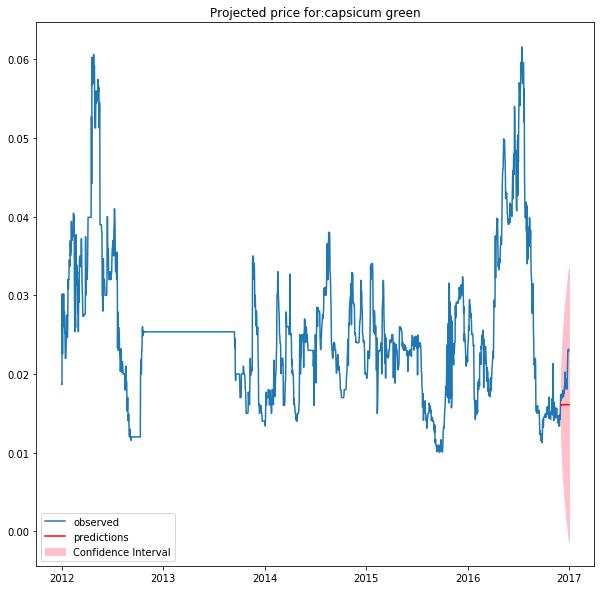

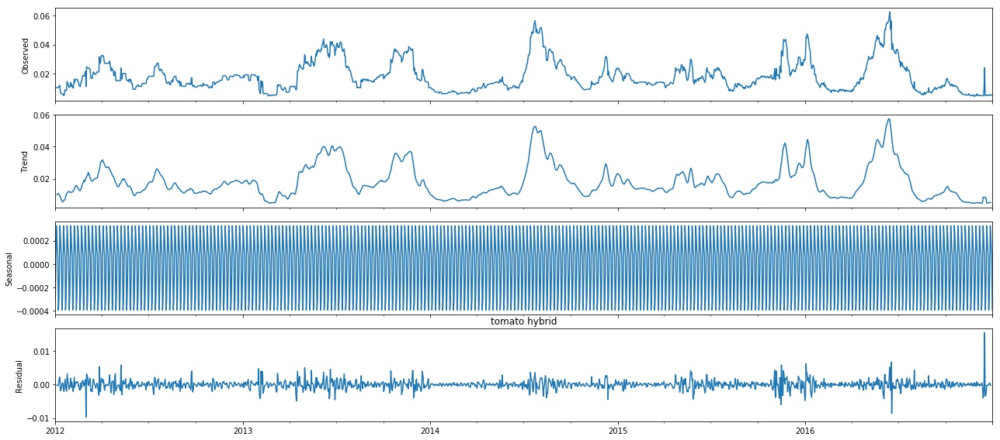



Test Statistic(More -ve, more stationary): -4.594099374985087


P-Value(If less than 0.05, reject null) 0.00013244331744529254
Reject Null Hypothesis(Series is non-stationary): True
Best Model:
p: 2
q: 3
d: 1
trend: n
Number of Products left: 1
Product: potato


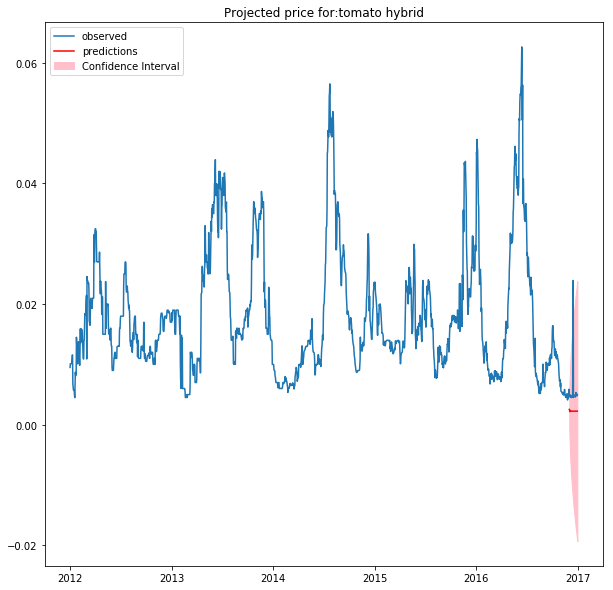

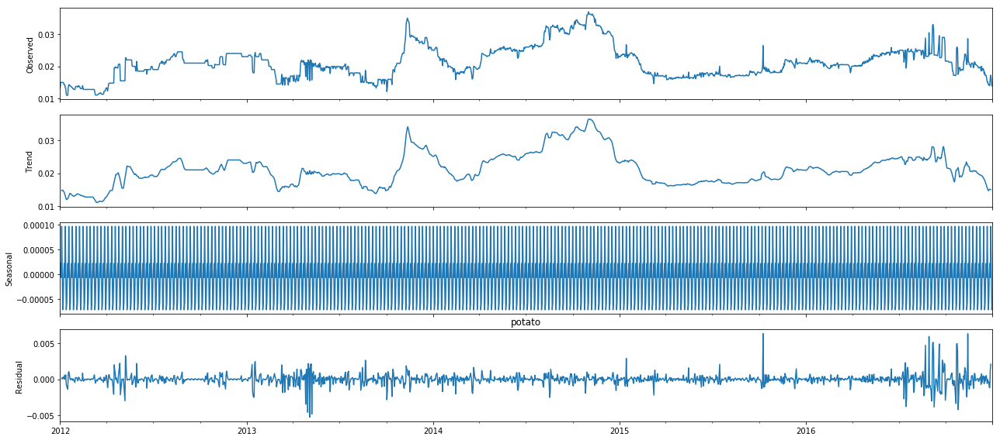



Test Statistic(More -ve, more stationary): -2.9357493693111754


P-Value(If less than 0.05, reject null) 0.04134597810768459
Reject Null Hypothesis(Series is non-stationary): True
Best Model:
p: 2
q: 3
d: 1
trend: n
Number of Products left: 0
Product: cucumber english


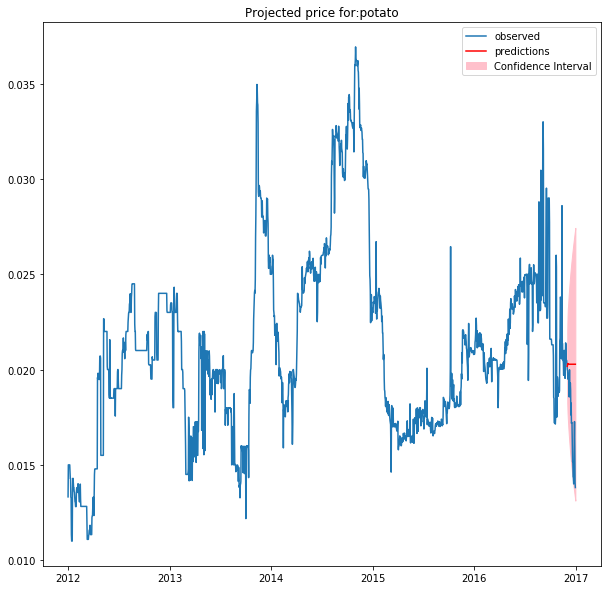

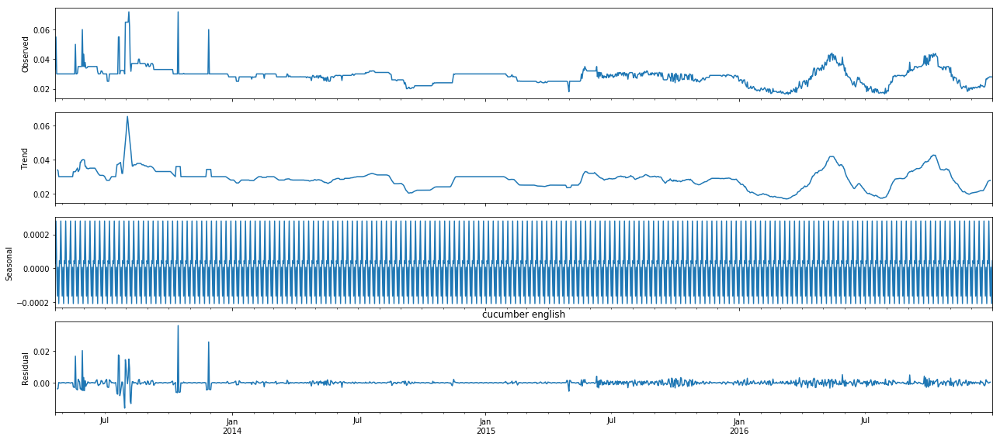



Test Statistic(More -ve, more stationary): -3.5609557548808723


P-Value(If less than 0.05, reject null) 0.006552869502595608
Reject Null Hypothesis(Series is non-stationary): True
Best Model:
p: 1
q: 1
d: 1
trend: n
Number of Products left: -1
Product: cucumber


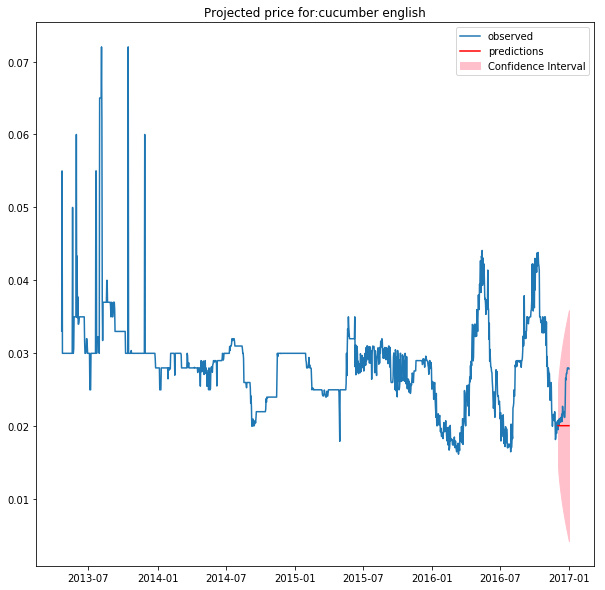

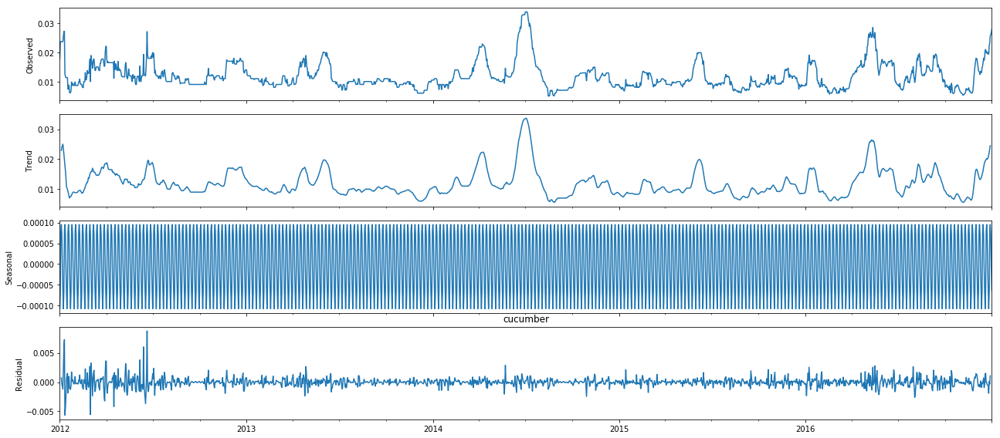



Test Statistic(More -ve, more stationary): -6.12735192781086


P-Value(If less than 0.05, reject null) 8.565296402015373e-08
Reject Null Hypothesis(Series is non-stationary): True
Best Model:
p: 1
q: 0
d: 1
trend: n
Number of Products left: -2
Product: ridge gourd


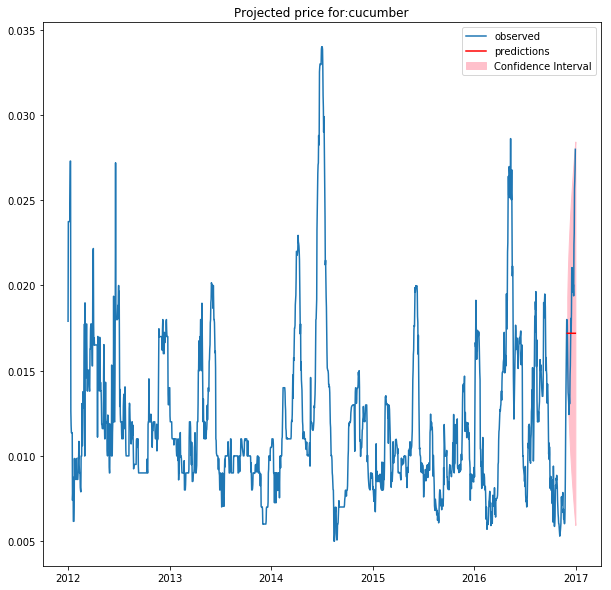

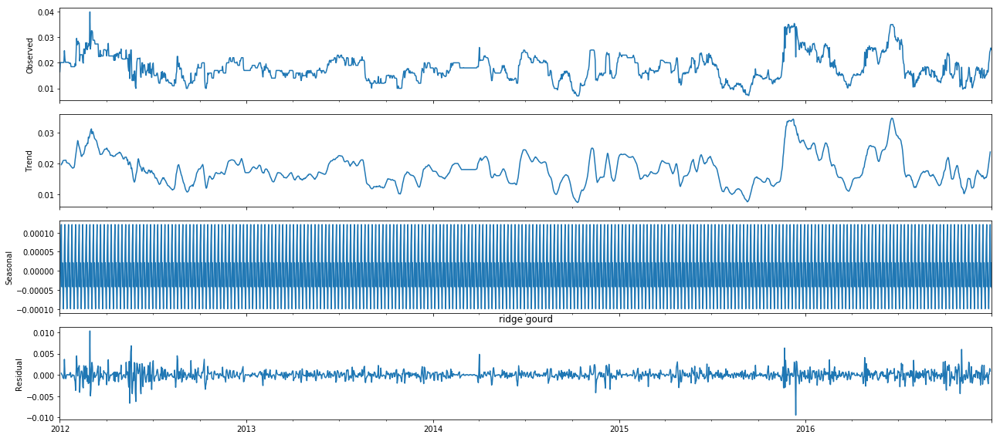



Test Statistic(More -ve, more stationary): -5.34587328645112


P-Value(If less than 0.05, reject null) 4.396489163943042e-06
Reject Null Hypothesis(Series is non-stationary): True
Best Model:
p: 1
q: 3
d: 1
trend: n
Number of Products left: -3
Product: ladies finger


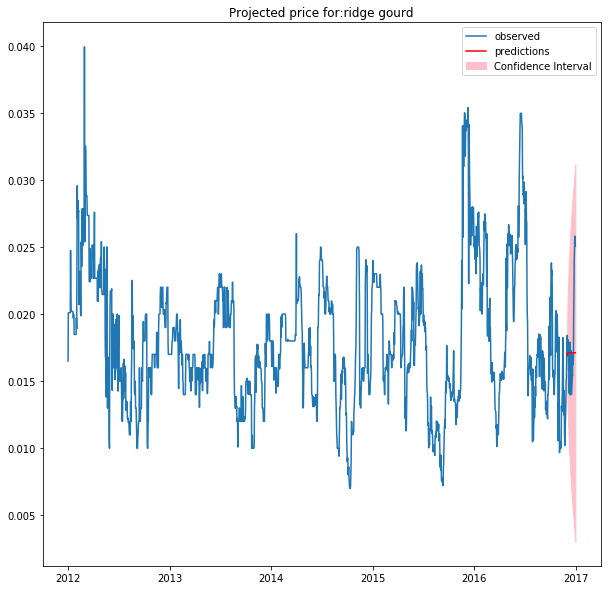

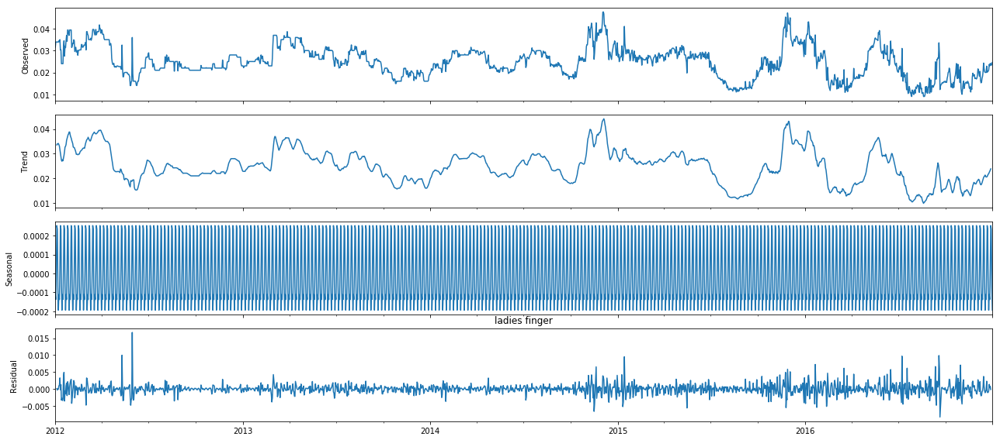



Test Statistic(More -ve, more stationary): -4.599583147018059


P-Value(If less than 0.05, reject null) 0.00012939835280503453
Reject Null Hypothesis(Series is non-stationary): True
Best Model:
p: 0
q: 2
d: 1
trend: n
Number of Products left: -4
Product: banana robusta


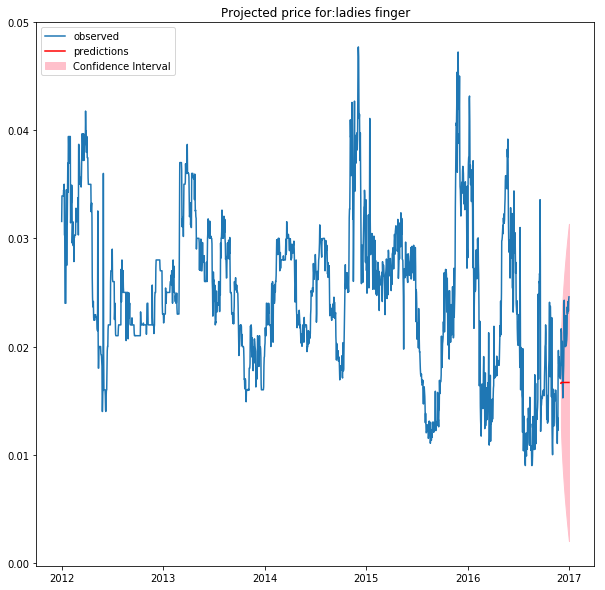

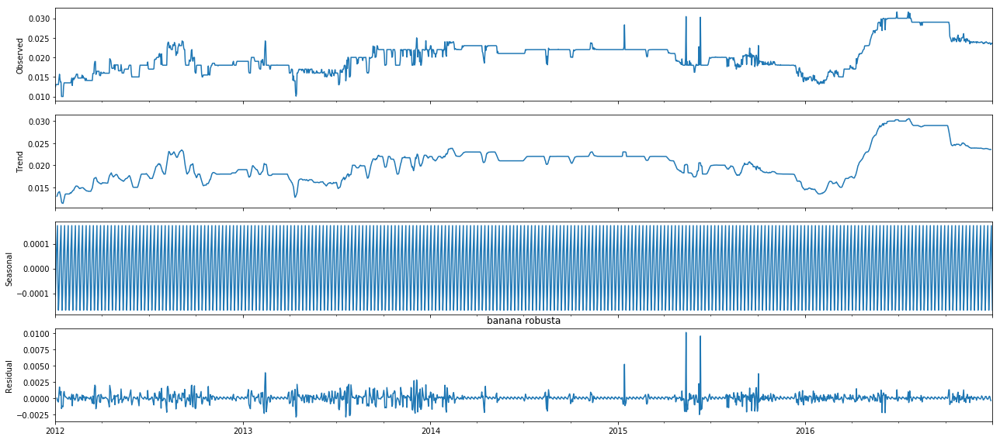



Test Statistic(More -ve, more stationary): -2.4905645583831504


P-Value(If less than 0.05, reject null) 0.1177869810289916
Reject Null Hypothesis(Series is non-stationary): False
Best Model:
p: 3
q: 3
d: 1
trend: n
Number of Products left: -5
Product: tomato local


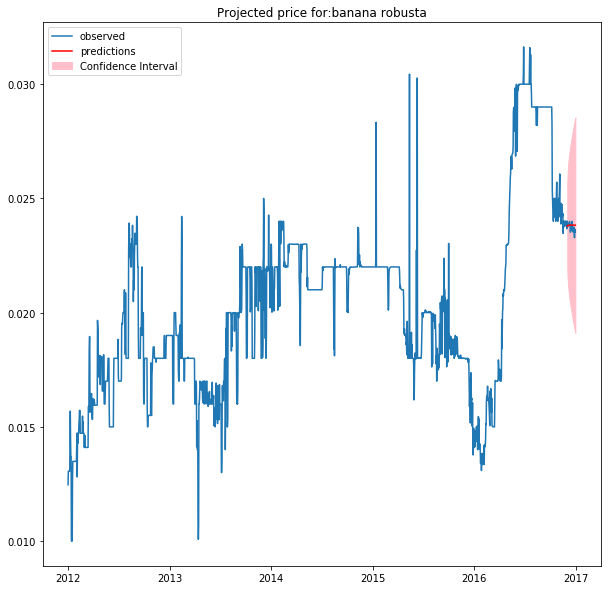

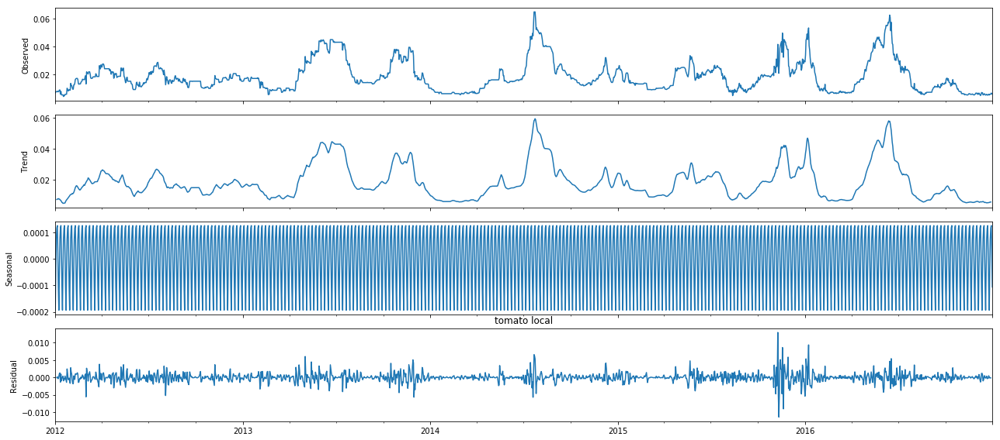



Test Statistic(More -ve, more stationary): -4.4059057757894795


P-Value(If less than 0.05, reject null) 0.0002897699608777612
Reject Null Hypothesis(Series is non-stationary): True
Best Model:
p: 3
q: 0
d: 1
trend: n
Number of Products left: -6
Product: bottle gourd


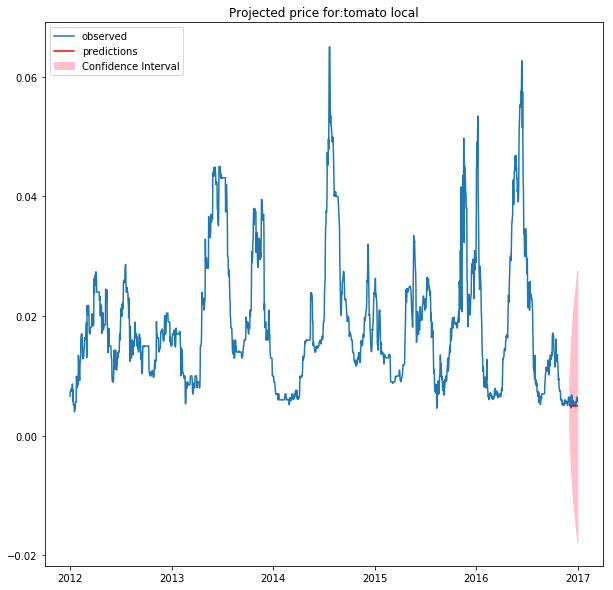

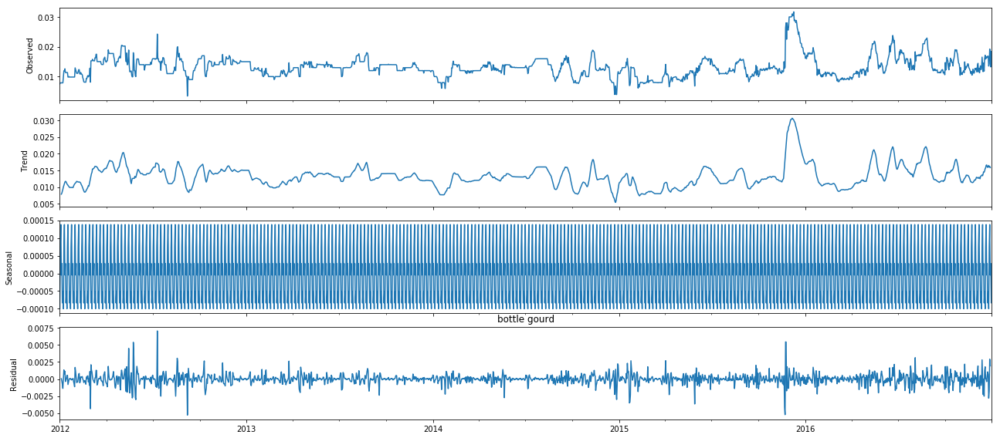



Test Statistic(More -ve, more stationary): -6.921027292076115


P-Value(If less than 0.05, reject null) 1.1463948268737745e-09
Reject Null Hypothesis(Series is non-stationary): True
Best Model:
p: 2
q: 0
d: 1
trend: n
Number of Products left: -7
Product: watermelon small


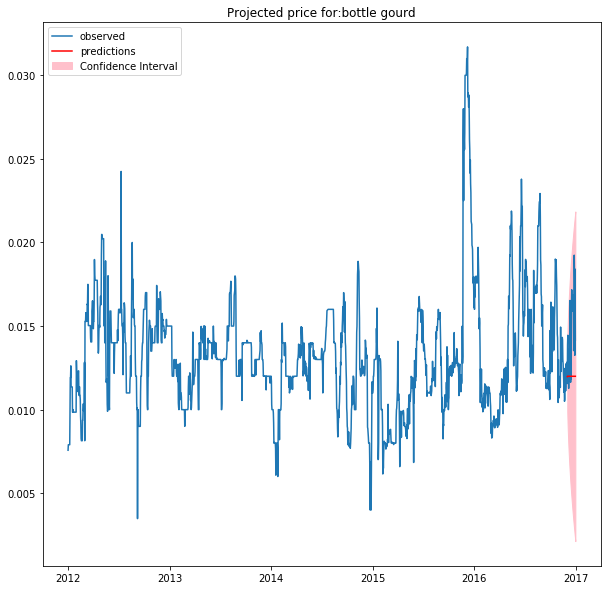

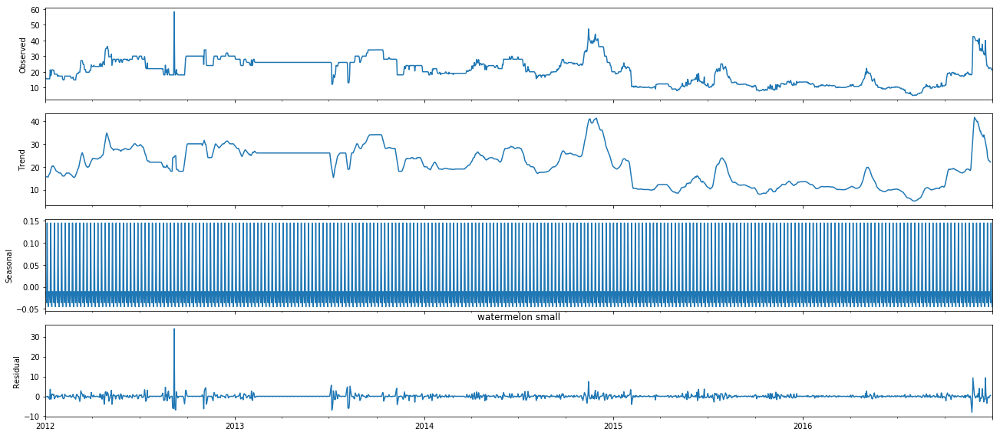



Test Statistic(More -ve, more stationary): -3.501240237206456


P-Value(If less than 0.05, reject null) 0.007955299214083295
Reject Null Hypothesis(Series is non-stationary): True
Best Model:
p: 1
q: 1
d: 1
trend: n
Number of Products left: -8
Product: beetroot


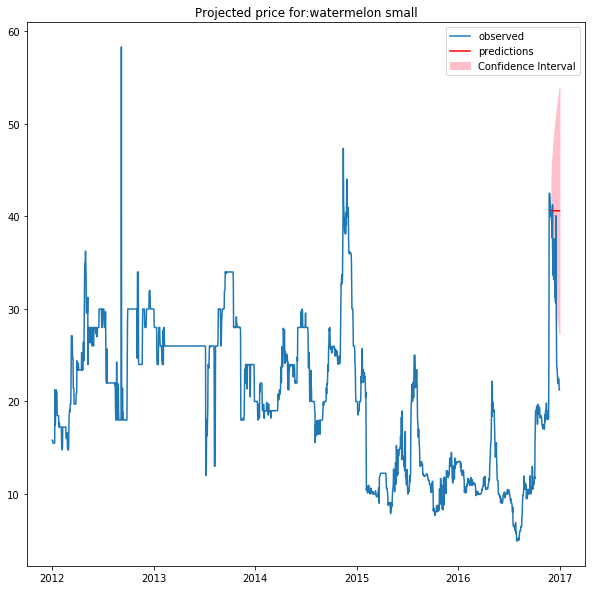

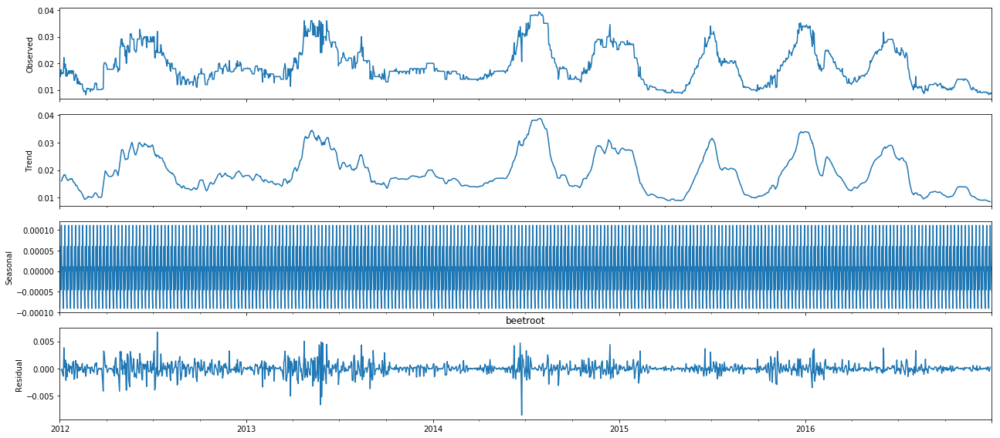



Test Statistic(More -ve, more stationary): -4.822522250706026


P-Value(If less than 0.05, reject null) 4.923980650710832e-05
Reject Null Hypothesis(Series is non-stationary): True
Best Model:
p: 2
q: 0
d: 1
trend: n
Number of Products left: -9
Product: carrot local


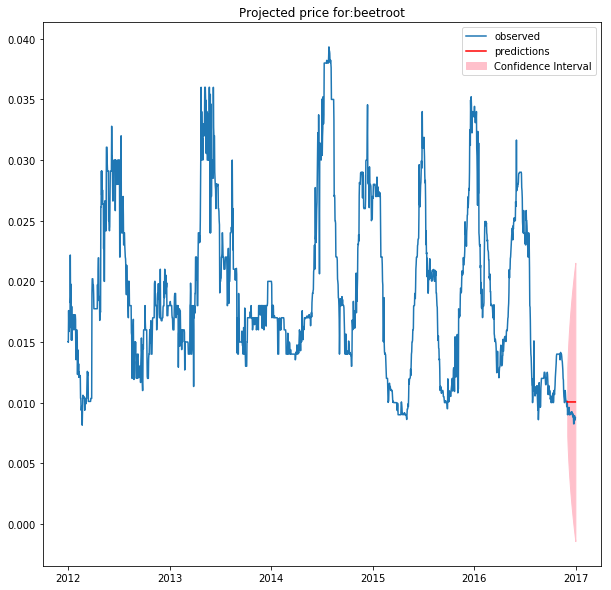

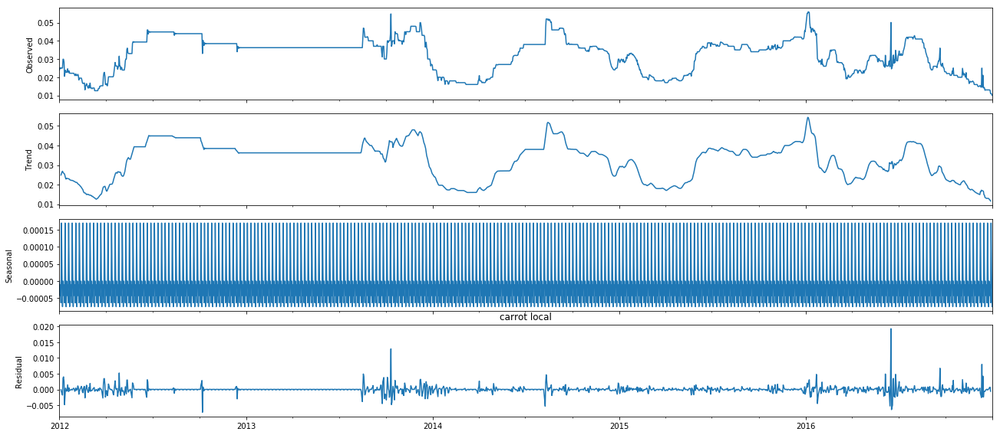



Test Statistic(More -ve, more stationary): -2.9491577613843964


P-Value(If less than 0.05, reject null) 0.03992299841994512
Reject Null Hypothesis(Series is non-stationary): True
Best Model:
p: 2
q: 0
d: 1
trend: n
Number of Products left: -10


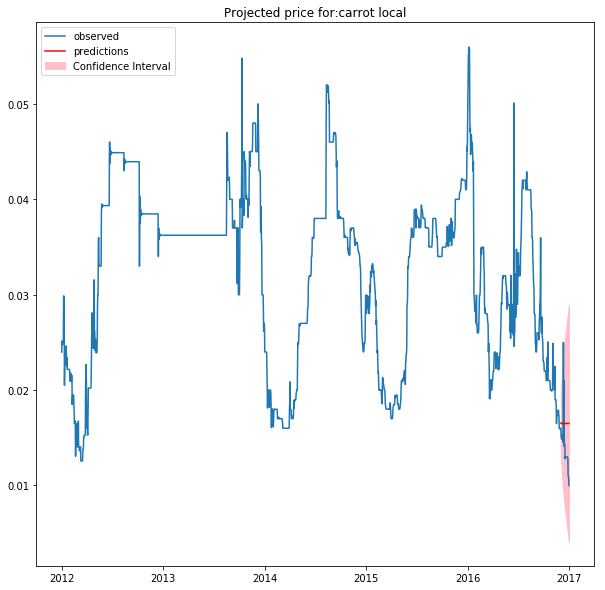

In [337]:
import warnings
warnings.filterwarnings('ignore')

list_summary = []

columns_needed = ['cp','Normalized Price','CPI Veg Rural', 'CPI Veg Urban', 'CPI Fruit Rural', 'CPI Fruit Urban', 'CPI Gen Rural', 'CPI Gen Urban','Rain_Andaman & Nicobar Islands', 'Rain_Arunachal Pradesh', 'Rain_Assam & Meghalaya', 'Rain_Naga Mani Mizo Tripura', 
           'Rain_Sub Himalayan West Bengal & Sikkim', 'Rain_Gangetic West Bengal', 'Rain_Orissa', 'Rain_Jharkhand', 'Rain_Bihar', 'Rain_East Uttar Pradesh', 'Rain_West Uttar Pradesh', 'Rain_Uttarakhand', 'Rain_Haryana Delhi & Chandigarh',
           'Rain_Punjab', 'Rain_Himachal Pradesh', 'Rain_Jammu & Kashmir', 'Rain_West Rajasthan', 'Rain_East Rajasthan', 'Rain_West Madhya Pradesh', 'Rain_East Madhya Pradesh', 'Rain_Gujarat Region', 'Rain_Saurashtra & Kutch', 
           'Rain_Konkan & Goa', 'Rain_Madhya Maharashtra', 'Rain_Matathwada', 'Rain_Vidarbha', 'Rain_Chhattisgarh', 'Rain_Coastal Andhra Pradesh', 'Rain_Telangana', 'Rain_Rayalseema', 'Rain_Tamil Nadu', 'Rain_Coastal Karnataka',
           'Rain_North Interior Karnataka', 'Rain_South Interior Karnataka', 'Rain_Kerala', 'Rain_Lakshadweep']

count = len(prod)
for prod in prod_groups:
    print("Product:",prod)

    temp_df_exog = df_cpi_rainfall[df_cpi_rainfall['PROD_GROUP']==prod].loc[:,columns_needed].copy()
    
    plot_decomposition(temp_df_exog['Normalized Price'],prod)
    
    #Obtaining ADF Results
    adf(temp_df_exog['Normalized Price'])
    
    p,d,q,trend,aic,bic = find_best_model(temp_df_exog.iloc[:-30])
    
    list_summary.append([prod,p,d,q,trend])
    print("Best Model:")
    print("p:",p)
    print("q:",q)
    print("d:",d)
    print("trend:",trend)
    
    SARIMAX_model(temp_df_exog,p,d,q,trend,prod)
    
    count = count-1
    print("Number of Products left:",count)

In [341]:
df_summary_cpi_rainfall = pd.DataFrame(list_summary,columns=['product','p','d','q','trend'])

df_summary_cpi_rainfall.style

,product,p,d,q,trend
0,onion,3,1,3,n
1,banana yelakki,0,1,2,n
2,capsicum green,3,1,0,n
3,tomato hybrid,2,1,3,n
4,potato,2,1,3,n
5,cucumber english,1,1,1,n
6,cucumber,1,1,0,n
7,ridge gourd,1,1,3,n
8,ladies finger,0,1,2,n
9,banana robusta,3,1,3,n


In [342]:
df_summary_cpi_rainfall.to_csv("/Users/vegi/Documents/USC_Masters/ML/DemandForecasts/df_summary_cpi_rainfall.csv", sep=",", float_format='%.2f',index=False, line_terminator='\n',encoding='utf-8')

## Forecasting values for all products

### Function to get model parameters

In [364]:
#This function picks up the p,d and q parameters from the df_summary dataframe
def get_pdq_cpi_rainfall(prod_group):
    if prod_group in list(df_summary_cpi_rainfall['product']):
        return df_summary_cpi_rainfall[df_summary_cpi_rainfall['product']==prod_group]['p'].item(),df_summary_cpi_rainfall[df_summary_cpi_rainfall['product']==prod_group]['d'].item(),df_summary_cpi_rainfall[df_summary_cpi_rainfall['product']==prod_group]['q'].item(),df_summary_cpi_rainfall[df_summary_cpi_rainfall['product']==prod_group]['trend'].item()

### Function to build the best model for a given SKU

In [412]:
def forecast_model_cpi_rainfall(df,p,d,q,trend,name):
    # Instantiate the best model

    model = SARIMAX(df[:-30]['Normalized Price'].values, order=(p,d,q),trend=trend,exog=df[:-30][columns])

    # Fit the model
    results = model.fit()

    # Generate predictions
    dynamic_forecast_30_days = results.get_forecast(30, alpha=0.05,exog =temp_df_exog[-30:][columns])  # 95% conf
    
    #Mean of forecast
    mean_forecast_30_days = dynamic_forecast_30_days.predicted_mean
    
    # Get confidence intervals of predictions
    confidence_intervals_30_days = dynamic_forecast_30_days.conf_int()
    # Select lower and upper confidence limits
    lower_limits = confidence_intervals_30_days.loc[:,'lower y']
    upper_limits = confidence_intervals_30_days.loc[:,'upper y']
    
    #Plot the graph
    dates = df.index
    dates_2 = mean_forecast_30_days.index
    plt.plot(dates,df['Normalized Price'].values, label='observed')
    plt.plot(dates_2,mean_forecast_30_days,color='red', label='predictions')
    plt.fill_between(dates_2,lower_limits,upper_limits,color='pink',label='Confidence Interval')
    plt.legend(loc='best')
    plt.title("Projected price for:"+name)

    return mean_forecast_30_days,dates_2

### Function to get the forecast

In [413]:
def get_forecast_cpi_rainfall(selected_sku,actual_prod):
    #Obtaining the normalizing factor for the SKU
    normalizing_factor_sku = dict_prod_factor[actual_prod]
    print("Normalizing factor:",normalizing_factor_sku)
    
    #Obtaining the product group
    sku_prod_group = get_prod_group(selected_sku)
    print("Product Group:",sku_prod_group)
    
    #Obtaining the model parameters
    p,d,q,trend = get_pdq_cpi_rainfall(sku_prod_group)
        
    #Printing Model parameters
    print("Model Parameters:")
    print("p:",p)
    print("d:",d)
    print("q:",q)
    print("trend:",trend)
    
    #Creating a dataframe with observations from a certain prodcut
    temp_df_exog = df_cpi_rainfall[df_cpi_rainfall['PROD_GROUP']==sku_prod_group].loc[:,columns_needed].copy()
    
    number_of_observations = len(temp_df_exog)
    
    avg_price = np.average(temp_df_exog['cp'])
    
    print("Average Cost Price:",avg_price)
    #Calling function to plot the decomposition plot
    plot_decomposition(temp_df_exog['Normalized Price'],sku_prod_group)
    
    #Obtaining ADF Results
    adf(temp_df_exog['Normalized Price'])
    
    
    #print(temp_df_exog.tail())

    predictions,dates = forecast_model_cpi_rainfall(temp_df_exog,p,d,q,trend,sku_prod_group)
    
    #print("Predicted Normalized Price:",list(predictions))
    cost_price_predictions = np.array(predictions)/normalizing_factor_sku
    
    #print(predictions.values)
    #print(cost_price_predictions)

    
    actual_price = (temp_df_exog['Normalized Price'].iloc[-30:].values)/normalizing_factor_sku

    #print(number_of_observations)
    #print(avg_price)
    return cost_price_predictions,actual_price,dates,number_of_observations,avg_price

For SKU: Fresho onion 1 kg
Normalizing factor: 0.001
Product Group: onion
Model Parameters:
p: 3
d: 1
q: 3
trend: n
Average Cost Price: 22.464679802955665


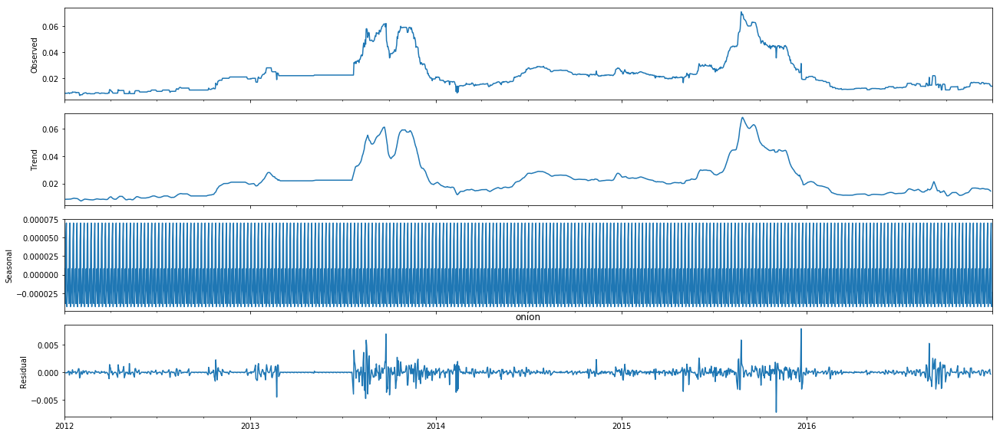



Test Statistic(More -ve, more stationary): -2.712112405585478


P-Value(If less than 0.05, reject null) 0.07196564402881468
Reject Null Hypothesis(Series is non-stationary): False
RMSE: 1.8379514193110764
MAE: 1.0437691370596596




For SKU: Fresho banana-yelakki 1 kg
Normalizing factor: 0.001
Product Group: banana yelakki
Model Parameters:
p: 0
d: 1
q: 2
trend: n
Average Cost Price: 45.60303776683087


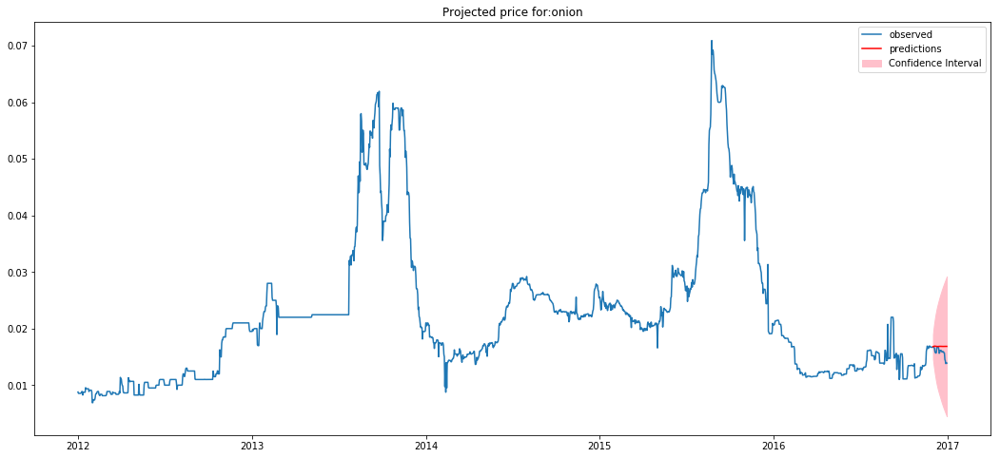

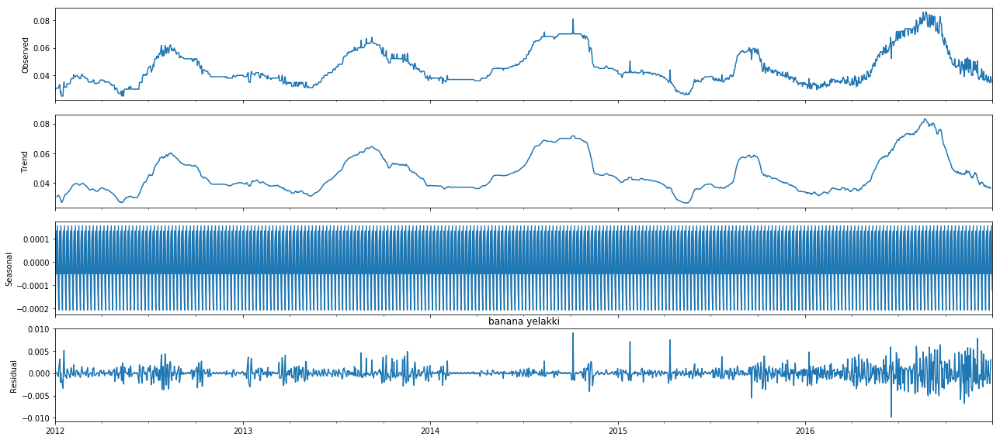



Test Statistic(More -ve, more stationary): -3.597271490150522


P-Value(If less than 0.05, reject null) 0.00581340576485223
Reject Null Hypothesis(Series is non-stationary): True
RMSE: 65.45542382649862
MAE: 7.70880948008093




For SKU: Fresho capsicum-green 1 kg
Normalizing factor: 0.001
Product Group: capsicum green
Model Parameters:
p: 3
d: 1
q: 0
trend: n
Average Cost Price: 25.161995511849497


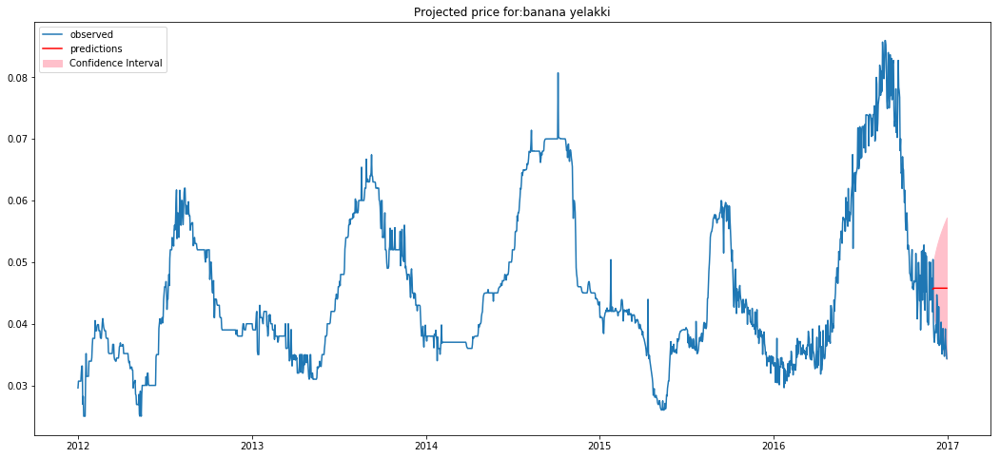

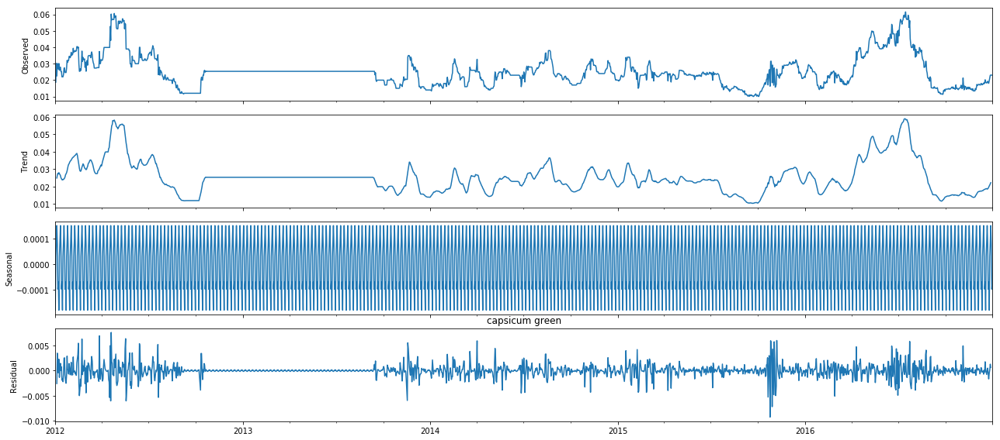



Test Statistic(More -ve, more stationary): -4.295091518301888


P-Value(If less than 0.05, reject null) 0.0004529872143710647
Reject Null Hypothesis(Series is non-stationary): True
RMSE: 12.364759928885702
MAE: 2.854056557677813




For SKU: Fresho tomato-hybrid 1 kg
Normalizing factor: 0.001
Product Group: tomato hybrid
Model Parameters:
p: 2
d: 1
q: 3
trend: n
Average Cost Price: 17.822523262178436


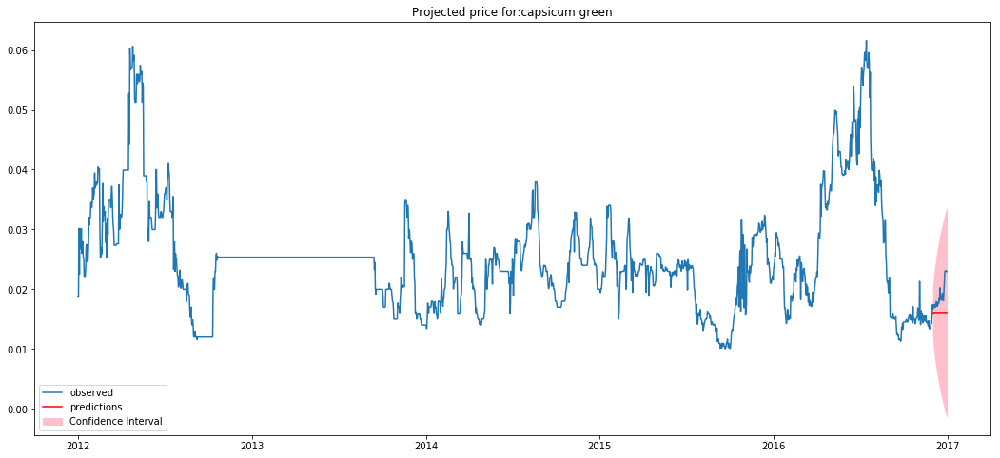

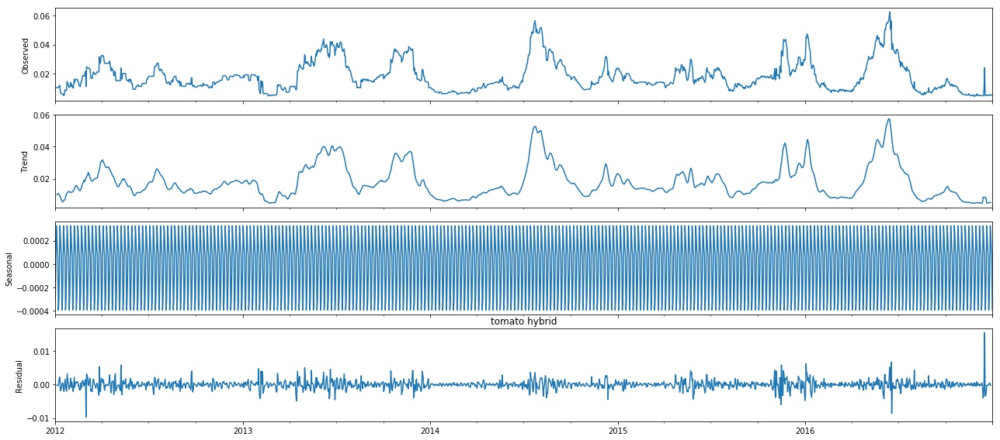



Test Statistic(More -ve, more stationary): -4.594099374985087


P-Value(If less than 0.05, reject null) 0.00013244331744529254
Reject Null Hypothesis(Series is non-stationary): True
RMSE: 23.834283302709547
MAE: 3.335731885943744




For SKU: Fresho potato 1 kg
Normalizing factor: 0.001
Product Group: potato
Model Parameters:
p: 2
d: 1
q: 3
trend: n
Average Cost Price: 21.1768144499179


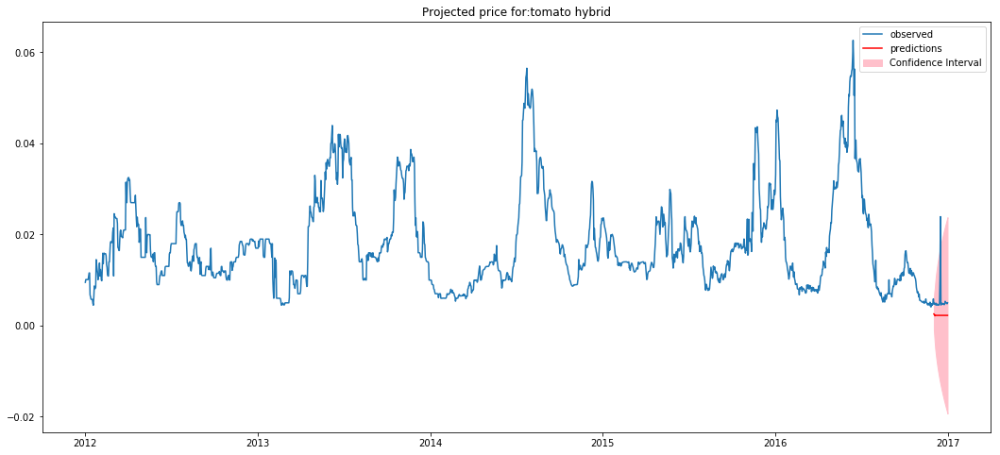

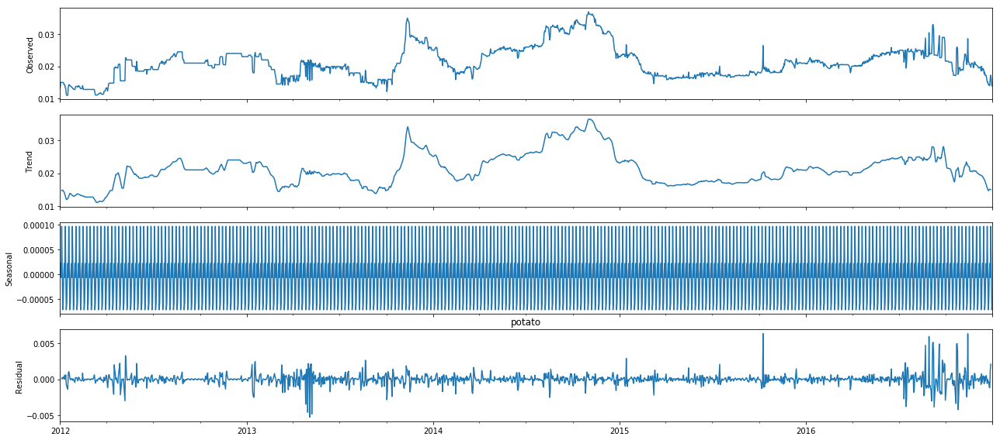



Test Statistic(More -ve, more stationary): -2.9357493693111754


P-Value(If less than 0.05, reject null) 0.04134597810768459
Reject Null Hypothesis(Series is non-stationary): True
RMSE: 13.114582220089115
MAE: 2.9203717807147425




For SKU: Fresho cucumber-english 1 kg
Normalizing factor: 0.001
Product Group: cucumber english
Model Parameters:
p: 1
d: 1
q: 1
trend: n
Average Cost Price: 28.538710420264824


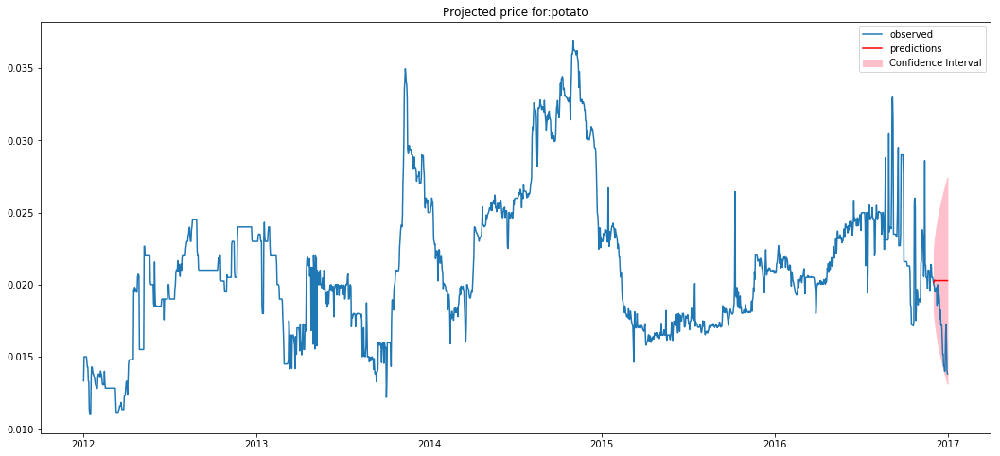

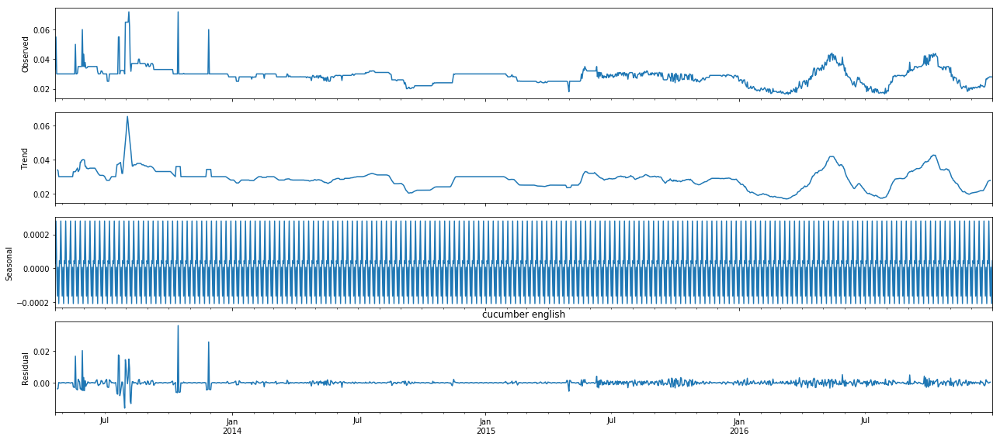



Test Statistic(More -ve, more stationary): -3.5609557548808723


P-Value(If less than 0.05, reject null) 0.006552869502595608
Reject Null Hypothesis(Series is non-stationary): True
RMSE: 19.66301054511224
MAE: 3.274034782216894




For SKU: Fresho cucumber 1 kg
Normalizing factor: 0.001
Product Group: cucumber
Model Parameters:
p: 1
d: 1
q: 0
trend: n
Average Cost Price: 11.931476008027733


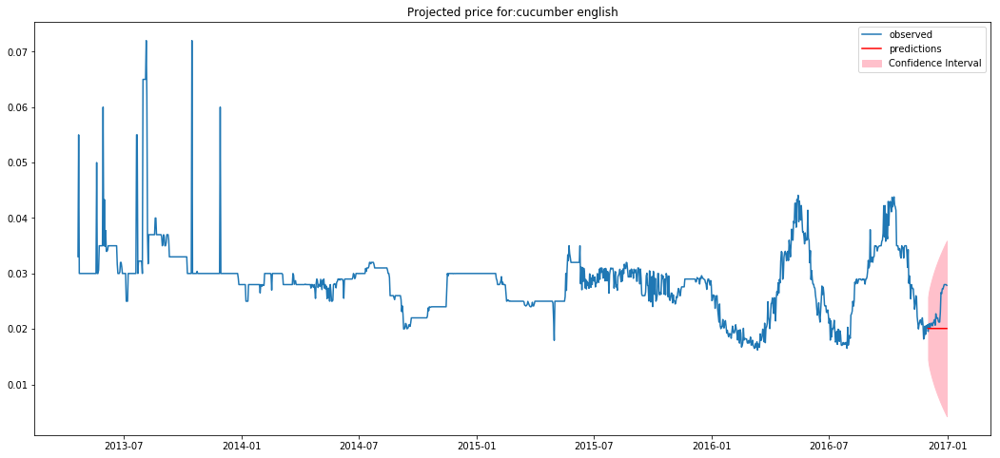

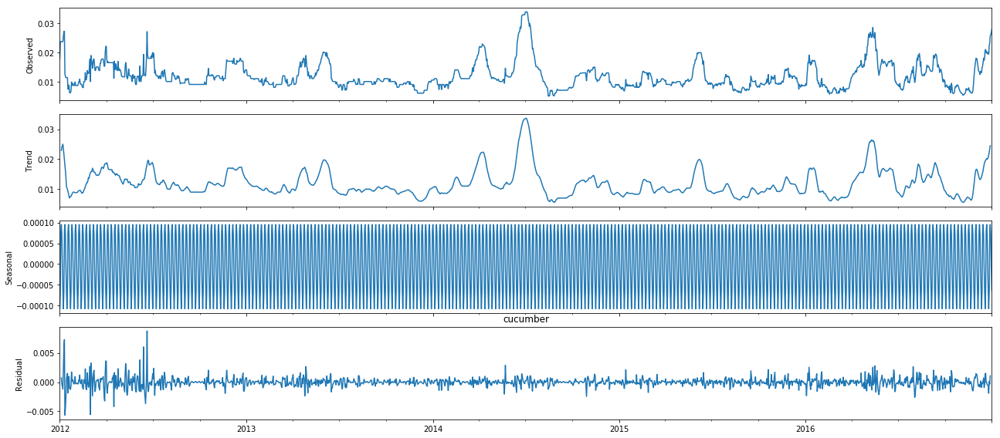



Test Statistic(More -ve, more stationary): -6.12735192781086


P-Value(If less than 0.05, reject null) 8.565296402015373e-08
Reject Null Hypothesis(Series is non-stationary): True
RMSE: 20.778359069437112
MAE: 3.6939616227593546




For SKU: Fresho ridge-gourd 1 kg
Normalizing factor: 0.001
Product Group: ridge gourd
Model Parameters:
p: 1
d: 1
q: 3
trend: n
Average Cost Price: 17.99210058991668


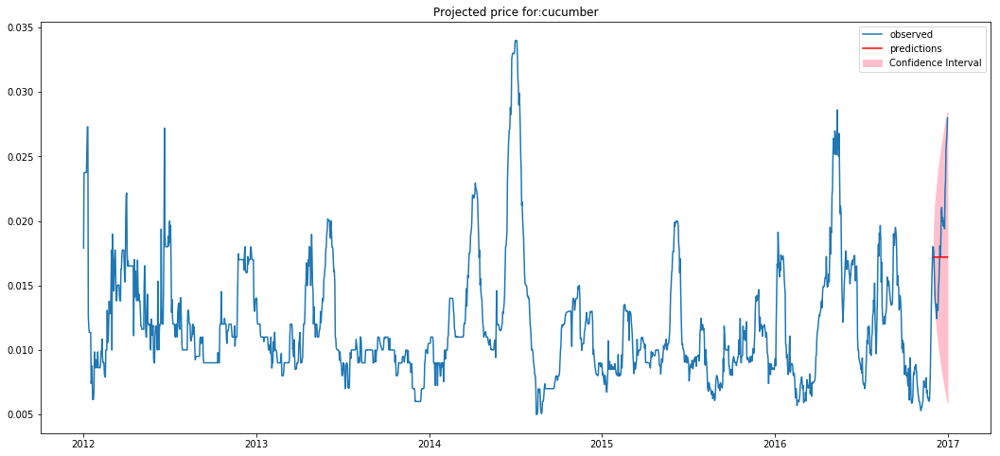

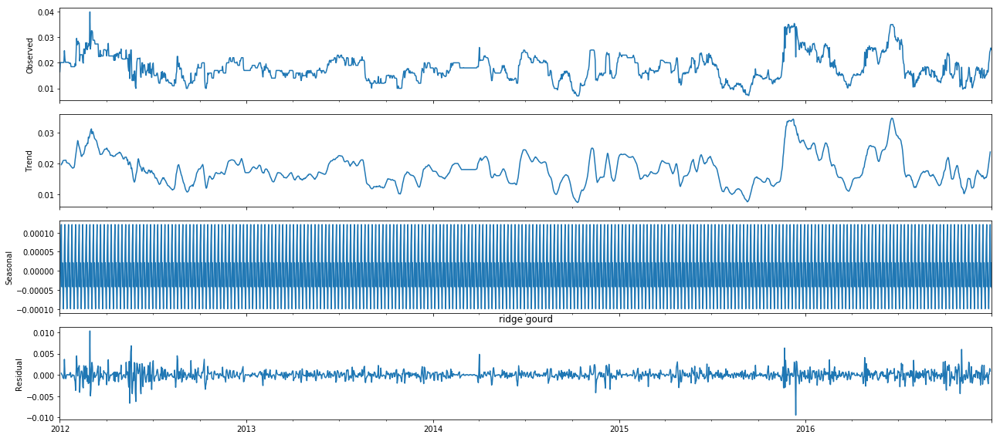



Test Statistic(More -ve, more stationary): -5.34587328645112


P-Value(If less than 0.05, reject null) 4.396489163943042e-06
Reject Null Hypothesis(Series is non-stationary): True
RMSE: 13.347426954799884
MAE: 2.586125993621126




For SKU: Fresho ladies-finger 1 kg
Normalizing factor: 0.001
Product Group: ladies finger
Model Parameters:
p: 0
d: 1
q: 2
trend: n
Average Cost Price: 24.829748626568552


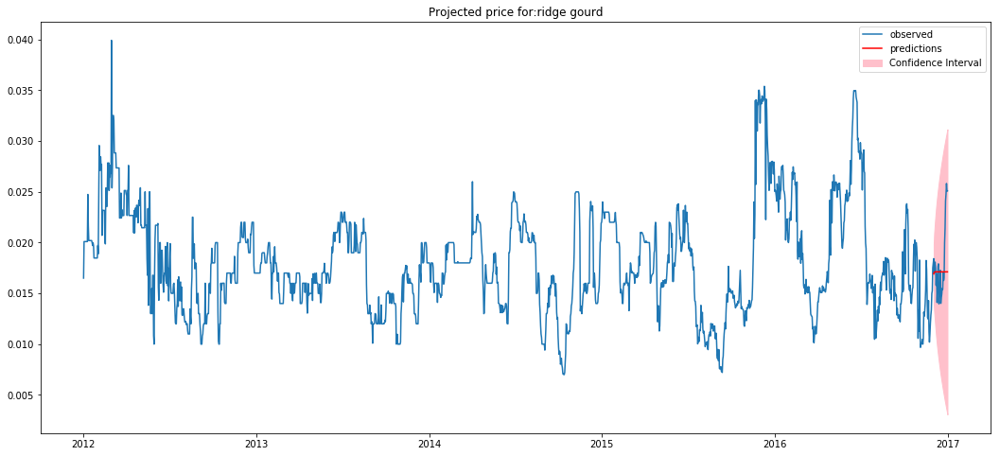

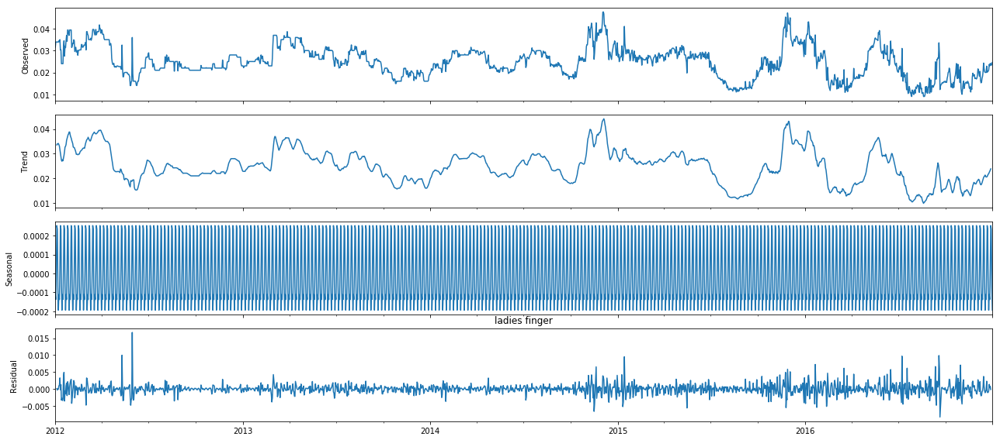



Test Statistic(More -ve, more stationary): -4.599583147018059


P-Value(If less than 0.05, reject null) 0.00012939835280503453
Reject Null Hypothesis(Series is non-stationary): True
RMSE: 22.870160593676246
MAE: 4.229330855273691




For SKU: Fresho banana-robusta 1 kg
Normalizing factor: 0.001
Product Group: banana robusta
Model Parameters:
p: 3
d: 1
q: 3
trend: n
Average Cost Price: 20.24772471005336


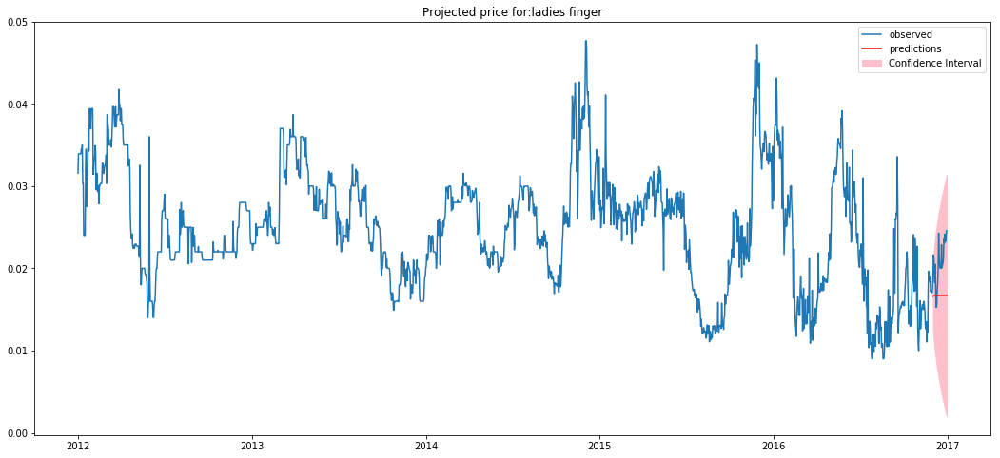

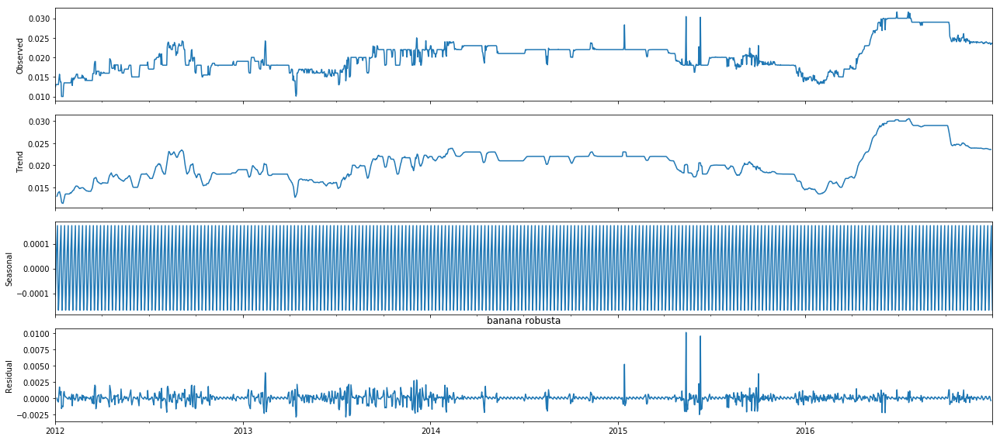



Test Statistic(More -ve, more stationary): -2.4905645583831504


P-Value(If less than 0.05, reject null) 0.1177869810289916
Reject Null Hypothesis(Series is non-stationary): False
RMSE: 0.038306799006631885
MAE: 0.14906020765481617




For SKU: Fresho tomato-local 1 kg
Normalizing factor: 0.001
Product Group: tomato local
Model Parameters:
p: 3
d: 1
q: 0
trend: n
Average Cost Price: 18.50603551014445


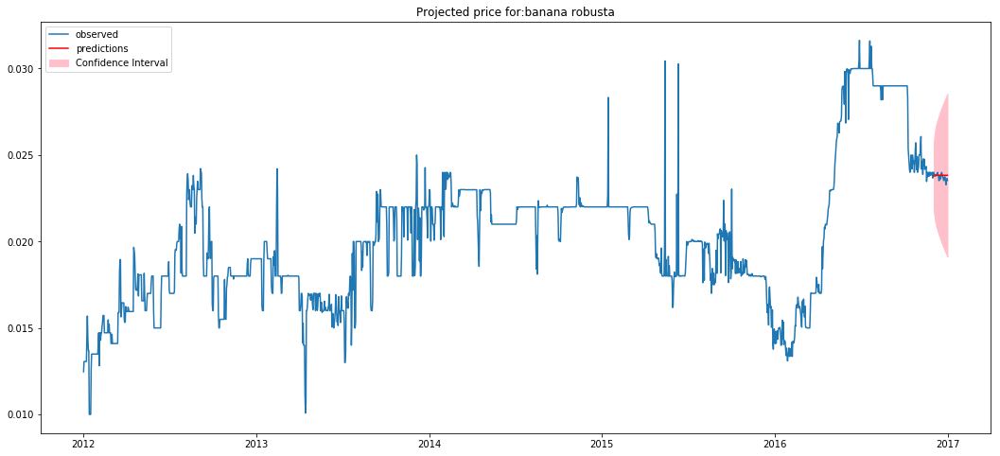

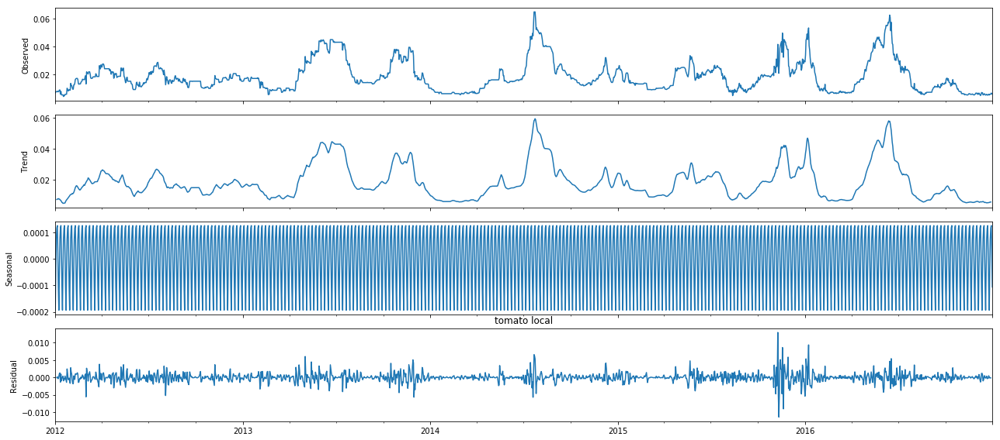



Test Statistic(More -ve, more stationary): -4.4059057757894795


P-Value(If less than 0.05, reject null) 0.0002897699608777612
Reject Null Hypothesis(Series is non-stationary): True
RMSE: 0.723805133292018
MAE: 0.6608562654632874




For SKU: Fresho bottle-gourd 1 kg
Normalizing factor: 0.001
Product Group: bottle gourd
Model Parameters:
p: 2
d: 1
q: 0
trend: n
Average Cost Price: 13.215932900734995


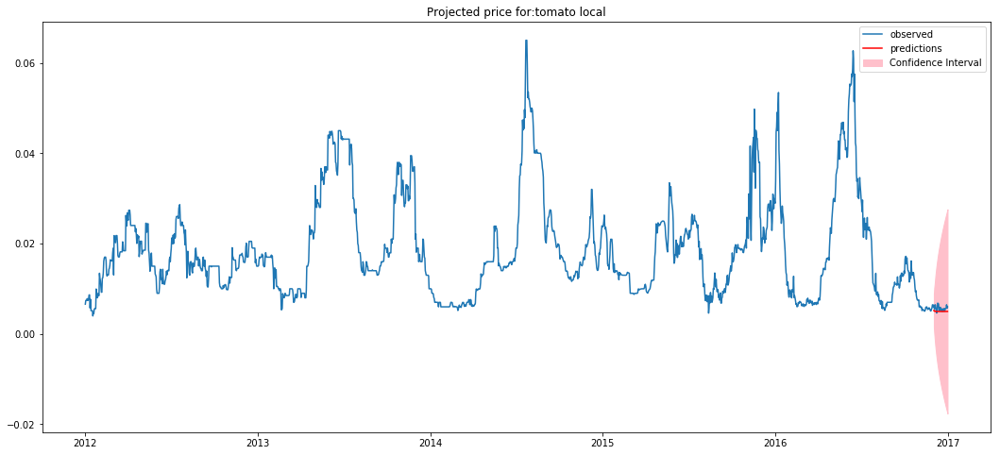

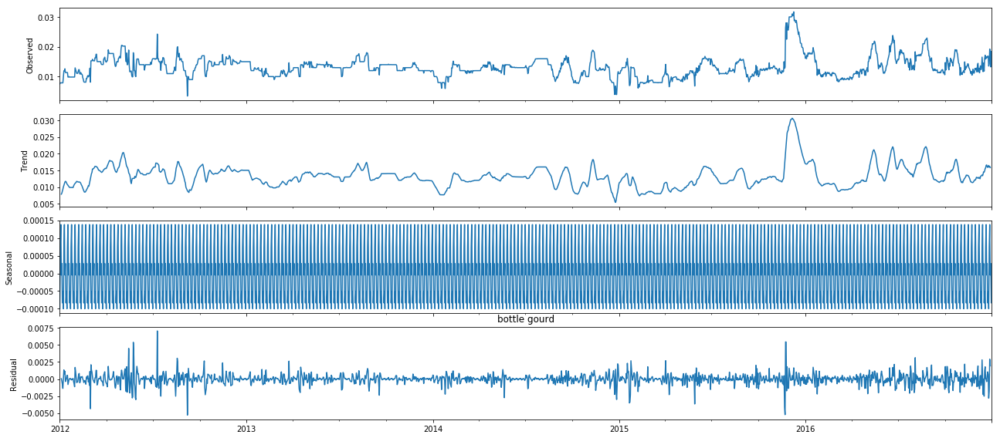



Test Statistic(More -ve, more stationary): -6.921027292076115


P-Value(If less than 0.05, reject null) 1.1463948268737745e-09
Reject Null Hypothesis(Series is non-stationary): True
RMSE: 11.745985293786955
MAE: 2.7543337007080995




For SKU: Fresho watermelon-small 1 pc  1.7 - 2.5 kg
Normalizing factor: 1.0
Product Group: watermelon small
Model Parameters:
p: 1
d: 1
q: 1
trend: n
Average Cost Price: 20.37181437608759


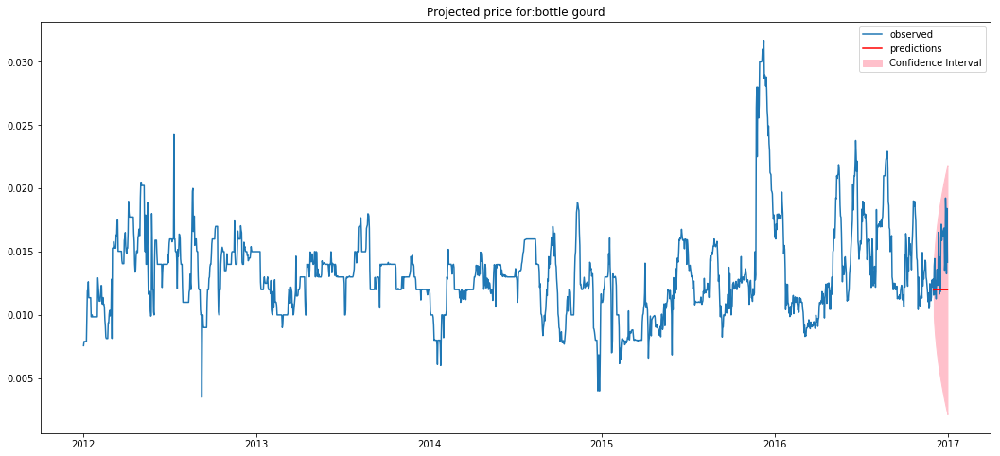

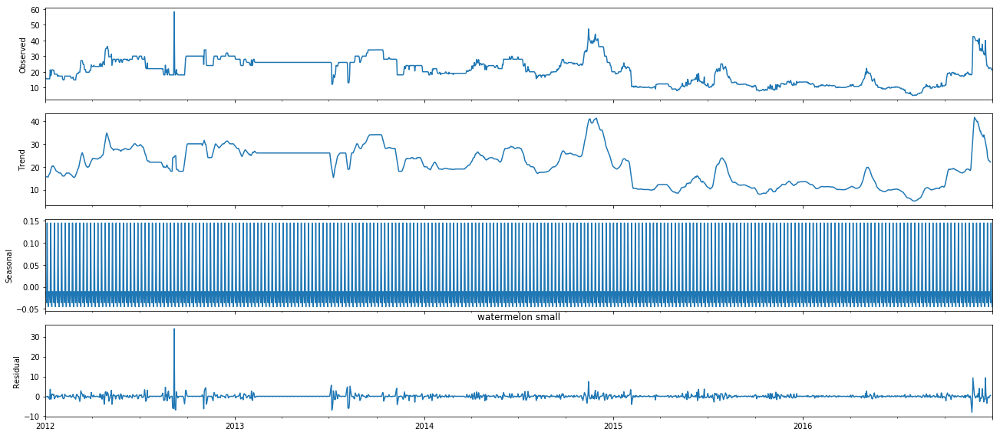



Test Statistic(More -ve, more stationary): -3.501240237206456


P-Value(If less than 0.05, reject null) 0.007955299214083295
Reject Null Hypothesis(Series is non-stationary): True
RMSE: 150.92980853801328
MAE: 10.306162414876098




For SKU: Fresho beetroot 1 kg
Normalizing factor: 0.001
Product Group: beetroot
Model Parameters:
p: 2
d: 1
q: 0
trend: n
Average Cost Price: 18.977353858908323


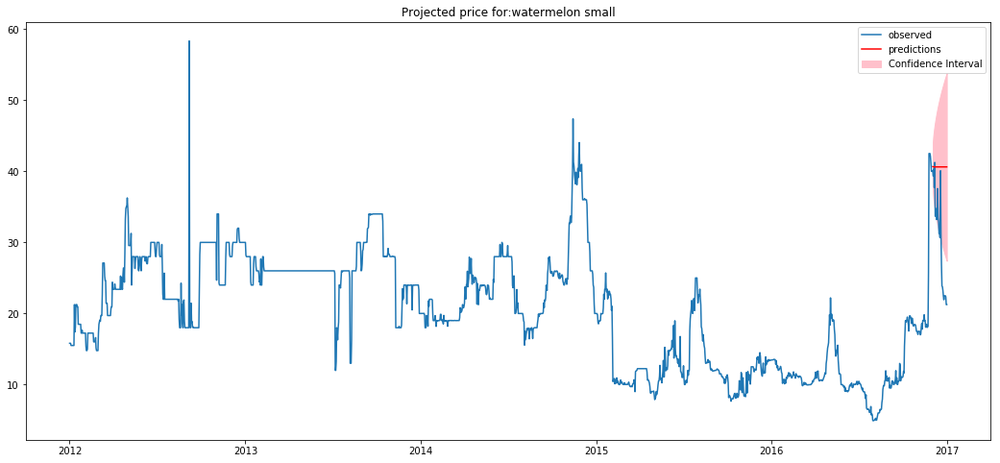

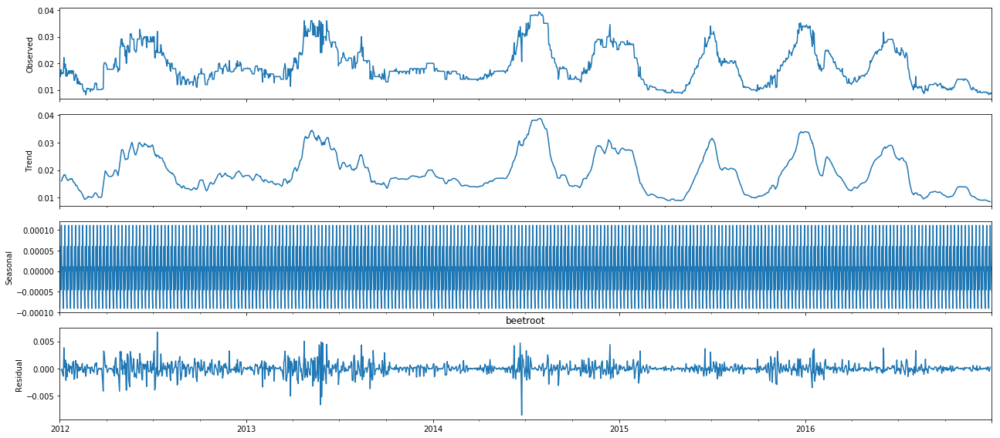



Test Statistic(More -ve, more stationary): -4.822522250706026


P-Value(If less than 0.05, reject null) 4.923980650710832e-05
Reject Null Hypothesis(Series is non-stationary): True
RMSE: 1.2086829823251442
MAE: 1.0436072682773052




For SKU: Fresho carrot-local 1 kg
Normalizing factor: 0.001
Product Group: carrot local
Model Parameters:
p: 2
d: 1
q: 0
trend: n
Average Cost Price: 32.15800528151182


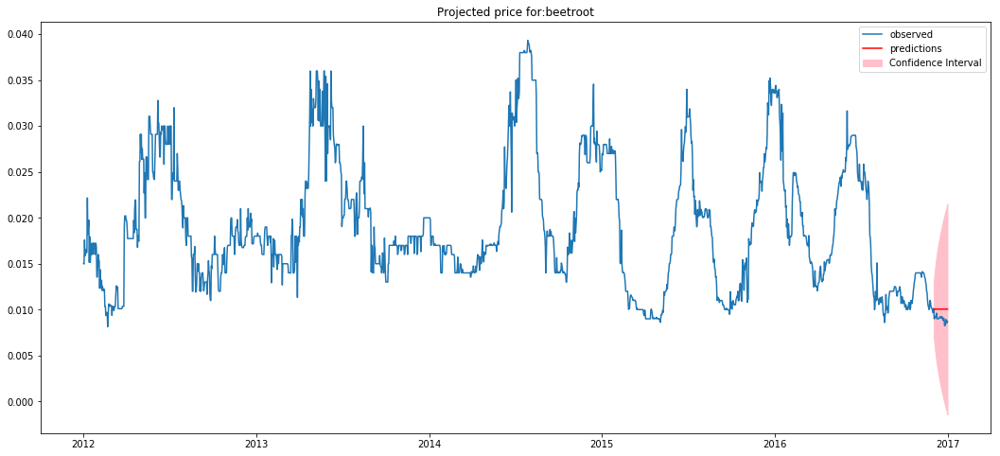

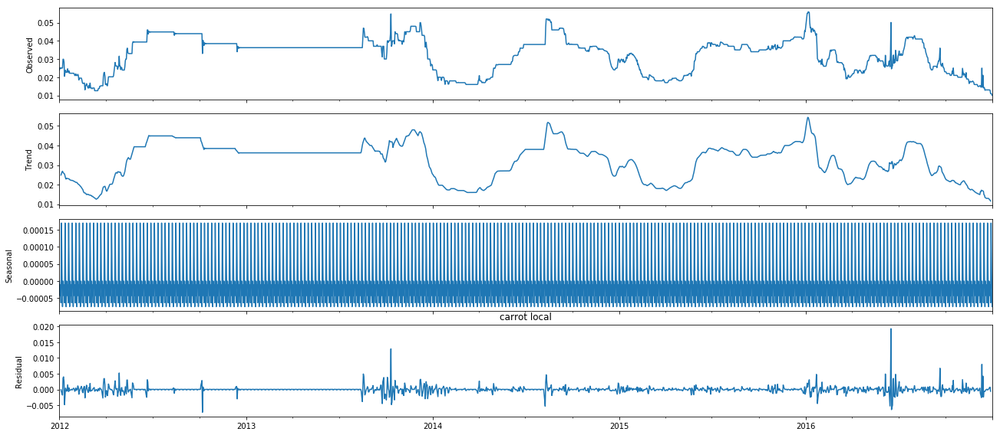



Test Statistic(More -ve, more stationary): -2.9491577613843964


P-Value(If less than 0.05, reject null) 0.03992299841994512
Reject Null Hypothesis(Series is non-stationary): True
RMSE: 13.564891625712365
MAE: 3.2374489981983046






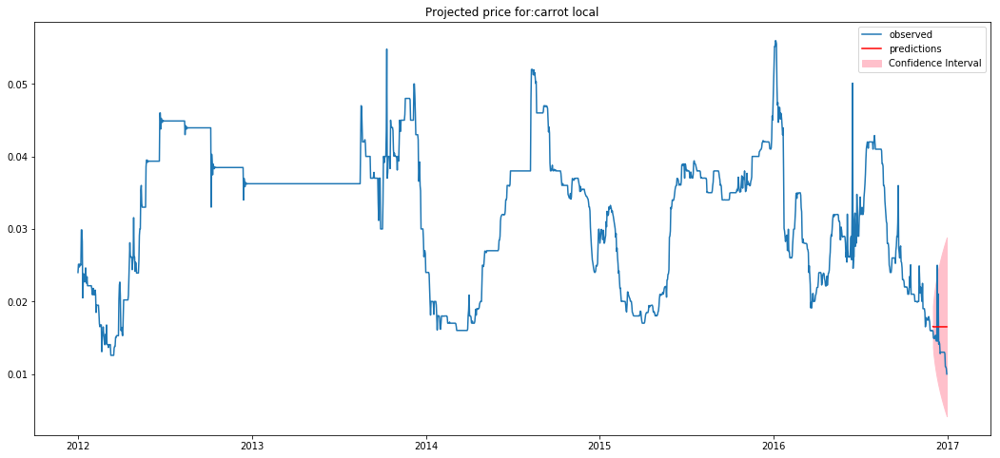

In [417]:
#List to store SKU names of all SKUs for which model has been built
SKU_list = []
#List to store predicted prices of all SKUs for which model has been built
predicted_prices = []
#List to store actual prices of all SKUs for which model has been built
actual_prices = []
#List to store RMSE scores of all SKUs for which model has been built
RMSE_scores = []
#List to store MAE scores of all SKUs for which model has been built
MAE_scores = []
#List to store last 30 dates of all SKUs for which model has been built
dates_list = []

num_observations = []

avg_prices = []

count = 0
#Iterating over all the SKUs
#Here, I've iterated over the product 'splits', as it makes it easier to obtain normalizing factor
for i,prod in enumerate(unique_products_split):
    #Storing the split priduct in a variable
    selected_sku = prod
    
    #Obtaining the actual name of the SKU
    actual_prod = unique_products[i]
    print("For SKU:",actual_prod)

    #Calling the method to obtain the forecast
    cost_price_predictions,actual_price,dates,number_of_observations,avg_price = get_forecast_cpi_rainfall(selected_sku,actual_prod)
    #print("Cost Price Prediction:",cost_price_predictions)
    #print("Actual Prices:",actual_price)
    #print("Dates:",dates)
    #print("Number of Observations",number_of_observations)
    #print("Average Price",avg_price)
    
    if len(cost_price_predictions) == 30:
        
        rmse = mean_squared_error(actual_price,cost_price_predictions)
        print("RMSE:",rmse)
        
        mae = mean_absolute_error(actual_price,cost_price_predictions)
        print("MAE:",mae)
        #Storing the last 30 dates of the SKU for which we have obtained the forecast
        dates_list.append(dates)
        #Storing the name of the SKU for which we have obtained the forecast
        SKU_list.append(actual_prod)
        #Storing the predicted prices of the SKU for which we have obtained the forecast
        predicted_prices.append(cost_price_predictions)
        #Storing the RMSE of the SKU for which we have obtained the forecast
        RMSE_scores.append(rmse)
        #Storing the MAE of the SKU for which we have obtained the forecast
        MAE_scores.append(mae)
        #Storing the actual price of the SKU for which we have obtained the forecast
        actual_prices.append(actual_price)
        
        num_observations.append(number_of_observations)
        
        avg_prices.append(avg_price)
    
    print('\n\n\n')

### Computing average 30 day SKU price

In [428]:
sku_avg_30_day_price = []
df_required = df_cpi_rainfall[(df_cpi_rainfall.index.year ==2016)&(df_cpi_rainfall.index.month ==12) &(df_cpi_rainfall.index.day >=2)]
for sku in SKU_list:
    avg_price_sku = np.average((df_required[df_required['sku_description']==sku]['cp']))
    sku_avg_30_day_price.append(avg_price_sku)

### Calculating MAPE

In [430]:
MAPE = []
for i,prices in enumerate(actual_prices):
    diff = abs((actual_prices[i] - predicted_prices[i])/(actual_prices[i]))
    sum_diff = np.sum(diff)
    MAPE.append(sum_diff/30)

In [431]:
normalized_rmse = (np.array(RMSE_scores)/np.array(sku_avg_30_day_price))
df_summary_cpi_rainfall_metrics = pd.DataFrame({'SKU':SKU_list,'RMSE':RMSE_scores,'Normalized RMSE':normalized_rmse,'Mean Absolute Error':MAE_scores,'Mean Absolute Percentage Error':MAPE,'Observations used':num_observations})
df_summary_cpi_rainfall_metrics.sort_values(by=['Mean Absolute Percentage Error'],ascending=True,inplace=True)
df_summary_cpi_rainfall_metrics.style

,SKU,RMSE,Normalized RMSE,Mean Absolute Error,Mean Absolute Percentage Error,Observations used
9,Fresho banana-robusta 1 kg,0.0383068,0.00161394,0.14906,0.00631055,1827
0,Fresho onion 1 kg,1.83795,0.116245,1.04377,0.0694177,1827
10,Fresho tomato-local 1 kg,0.723805,0.128311,0.660856,0.109432,1827
13,Fresho beetroot 1 kg,1.20868,0.13407,1.04361,0.117448,1827
5,Fresho cucumber-english 1 kg,19.663,0.843206,3.27403,0.126958,1351
7,Fresho ridge-gourd 1 kg,13.3474,0.743024,2.58613,0.131823,1827
2,Fresho capsicum-green 1 kg,12.3648,0.652459,2.85406,0.141524,1827
11,Fresho bottle-gourd 1 kg,11.746,0.803566,2.75433,0.172059,1827
4,Fresho potato 1 kg,13.1146,0.755637,2.92037,0.187261,1827
8,Fresho ladies-finger 1 kg,22.8702,1.10384,4.22933,0.193901,1827


In [455]:
df_summary_cpi_rainfall_metrics.to_csv("/Users/vegi/Documents/USC_Masters/ML/DemandForecasts/df_summary_cpi_rainfall_metrics.csv", sep=",", float_format='%.6f',index=False, line_terminator='\n',encoding='utf-8')

### Time series analysis from 2012-2016

In [432]:
df_cpi_rainfall.columns

Index(['Normalized Price', 'PROD_GROUP', 'source_sku_id', 'cp',
       'sku_description', 'CPI Veg Rural', 'CPI Veg Urban', 'CPI Fruit Rural',
       'CPI Fruit Urban', 'CPI Gen Rural', 'CPI Gen Urban',
       'Rain_Andaman & Nicobar Islands', 'Rain_Arunachal Pradesh',
       'Rain_Assam & Meghalaya', 'Rain_Naga Mani Mizo Tripura',
       'Rain_Sub Himalayan West Bengal & Sikkim', 'Rain_Gangetic West Bengal',
       'Rain_Orissa', 'Rain_Jharkhand', 'Rain_Bihar',
       'Rain_East Uttar Pradesh', 'Rain_West Uttar Pradesh',
       'Rain_Uttarakhand', 'Rain_Haryana Delhi & Chandigarh', 'Rain_Punjab',
       'Rain_Himachal Pradesh', 'Rain_Jammu & Kashmir', 'Rain_West Rajasthan',
       'Rain_East Rajasthan', 'Rain_West Madhya Pradesh',
       'Rain_East Madhya Pradesh', 'Rain_Gujarat Region',
       'Rain_Saurashtra & Kutch', 'Rain_Konkan & Goa',
       'Rain_Madhya Maharashtra', 'Rain_Matathwada', 'Rain_Vidarbha',
       'Rain_Chhattisgarh', 'Rain_Coastal Andhra Pradesh', 'Rain_Telangana'

In [435]:
cols_2012_2016 = ['Normalized Price', 'PROD_GROUP', 'source_sku_id', 'cp',
       'sku_description']
df_2012_2016 = df_cpi_rainfall[cols_2012_2016]
df_2012_2016.head()

,Normalized Price,PROD_GROUP,source_sku_id,cp,sku_description
2012-01-01,0.00879,onion,10000148,8.79,Fresho onion 1 kg
2012-01-02,0.00855,onion,10000148,8.55,Fresho onion 1 kg
2012-01-03,0.00855,onion,10000148,8.55,Fresho onion 1 kg
2012-01-04,0.00855,onion,10000148,8.55,Fresho onion 1 kg
2012-01-05,0.00855,onion,10000148,8.55,Fresho onion 1 kg


### Function to find the best model for a given time series

In [436]:
def find_best_model_no_exog(df):
    order_scores = []
    for p in range(4):
        for q in range(4):
            for d in range(3):
                for t in trend_list:
                    try:
                        # Instantiate the model
                        #model = SARIMAX(y, order=(p,d,q))
                        model = SARIMAX(df['Normalized Price'].values, order=(p,d,q),trend=t)
                        # Fit the model
                        results = model.fit()
                        #Obtain results
                        order_scores.append((p,d,q,t,results.aic,results.bic))
        
                    except:
                        continue
            
    order_scores = pd.DataFrame(order_scores,columns=['p','d','q','trend','aic','bic'])
    order_scores.sort_values('aic',inplace = True)
    
    p,d,q,trend,aic,bic = order_scores.iloc[0,0],order_scores.iloc[0,1],order_scores.iloc[0,2],order_scores.iloc[0,3],order_scores.iloc[0,4],order_scores.iloc[0,5]
    return p,d,q,trend,aic,bic

### Function to build a model after obtaining suitable parameters

In [486]:
def SARIMAX_model_no_exog(df,p,d,q,trend,name):
    # Instantiate the best model
    model = SARIMAX(df[:-30]['Normalized Price'].values, order=(p,d,q),trend=trend)

    # Fit the model
    results = model.fit()

    # Generate predictions
    dynamic_forecast_30_days = results.get_forecast(30, alpha=0.05)  # 95% conf
    
    #Mean of forecast
    mean_forecast_30_days = dynamic_forecast_30_days.predicted_mean
    
    # Get confidence intervals of predictions
    confidence_intervals_30_days = dynamic_forecast_30_days.conf_int()
    # Select lower and upper confidence limits
    lower_limits = [i[0] for i in confidence_intervals_30_days]
    upper_limits = [i[1] for i in confidence_intervals_30_days]

    dates = df.index
    dates_2 = dates[-30:]
    
    #Plot the graph
    plt.figure(figsize=(10,10))
    plt.plot(dates,df['Normalized Price'].values, label='observed')
    plt.plot(dates_2,mean_forecast_30_days,color='red', label='predictions')
    plt.fill_between(dates_2,lower_limits,upper_limits,color='pink',label='Confidence Interval')
    plt.legend(loc='best')
    plt.title("Projected price for:"+name)

Product: onion


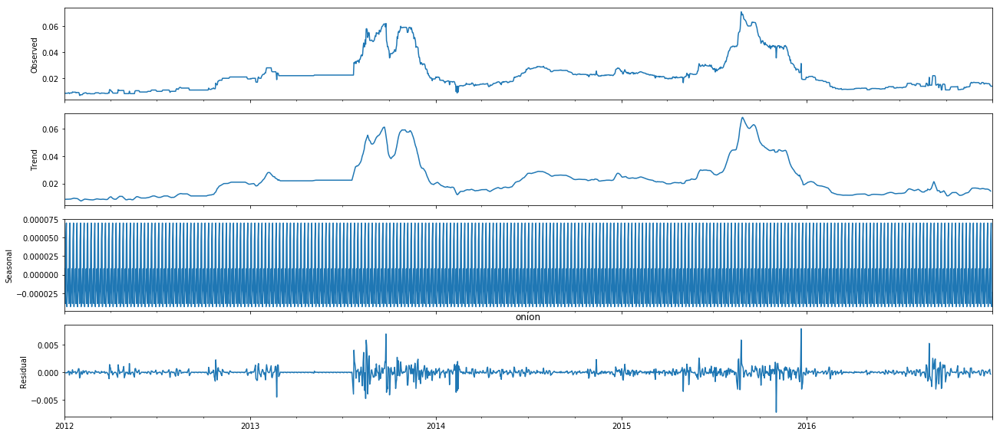



Test Statistic(More -ve, more stationary): -2.712112405585478


P-Value(If less than 0.05, reject null) 0.07196564402881468
Reject Null Hypothesis(Series is non-stationary): False
Best Model:
p: 3
q: 3
d: 1
trend: n
Number of Products left: 14
Product: banana yelakki


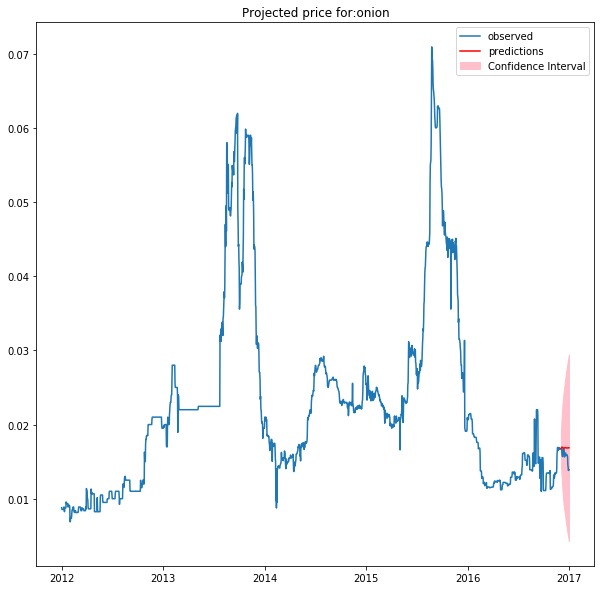

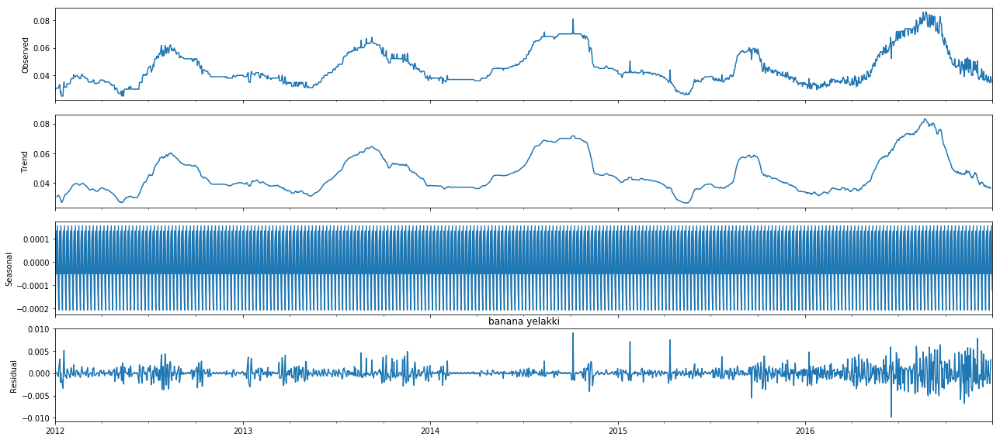



Test Statistic(More -ve, more stationary): -3.597271490150522


P-Value(If less than 0.05, reject null) 0.00581340576485223
Reject Null Hypothesis(Series is non-stationary): True
Best Model:
p: 1
q: 3
d: 0
trend: c
Number of Products left: 13
Product: capsicum green


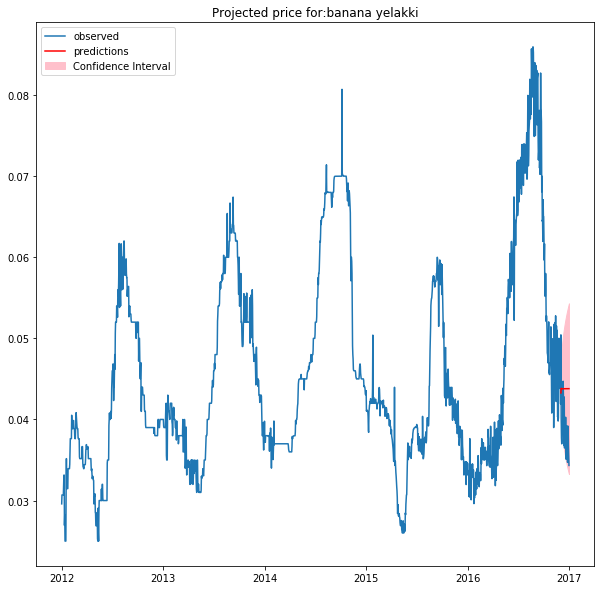

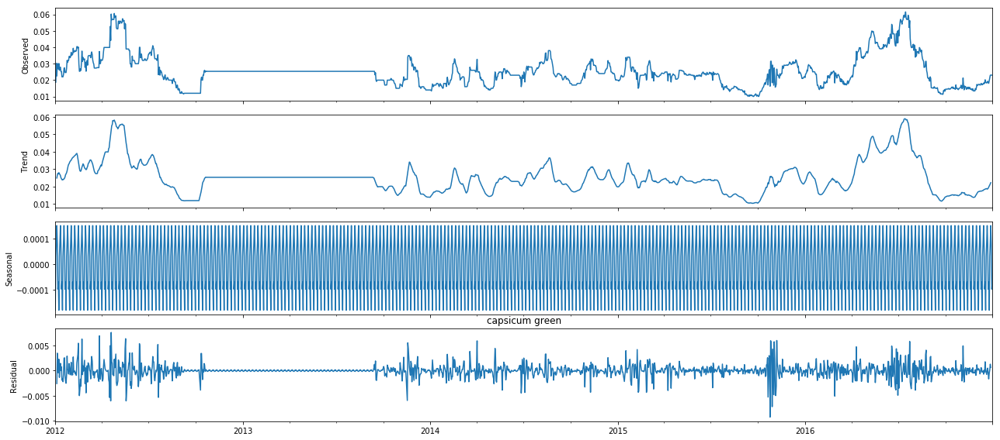



Test Statistic(More -ve, more stationary): -4.295091518301888


P-Value(If less than 0.05, reject null) 0.0004529872143710647
Reject Null Hypothesis(Series is non-stationary): True
Best Model:
p: 3
q: 2
d: 0
trend: c
Number of Products left: 12
Product: tomato hybrid


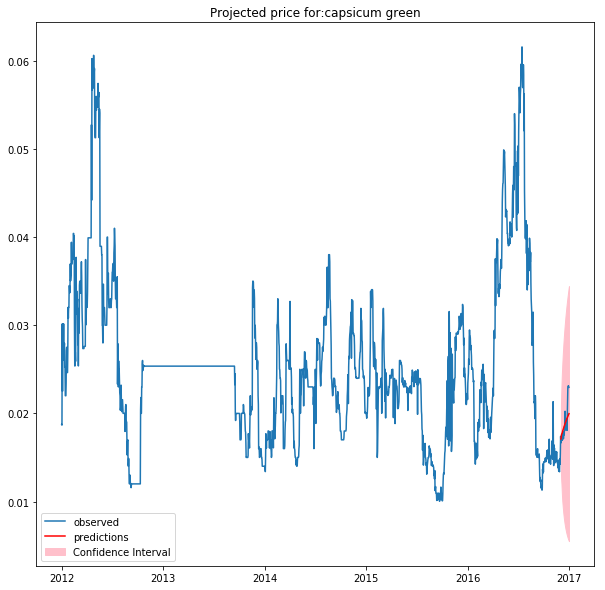

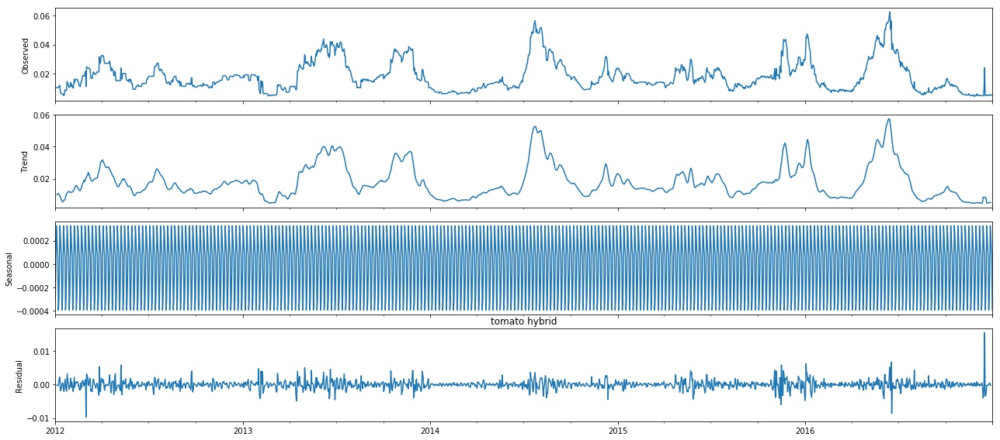



Test Statistic(More -ve, more stationary): -4.594099374985087


P-Value(If less than 0.05, reject null) 0.00013244331744529254
Reject Null Hypothesis(Series is non-stationary): True
Best Model:
p: 1
q: 3
d: 0
trend: c
Number of Products left: 11
Product: potato


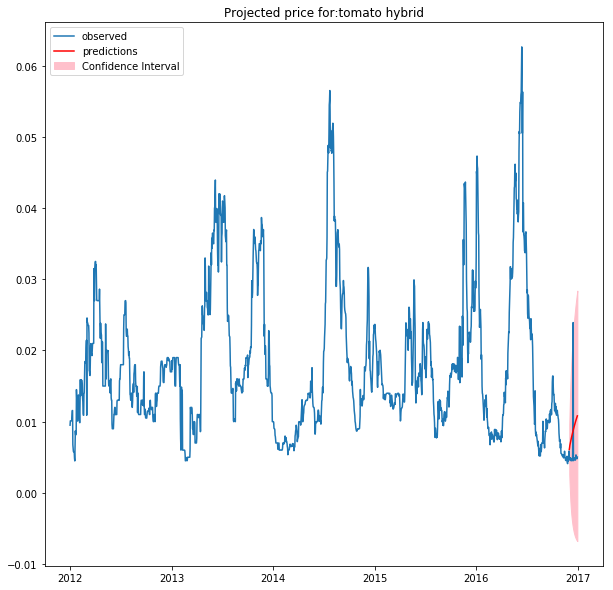

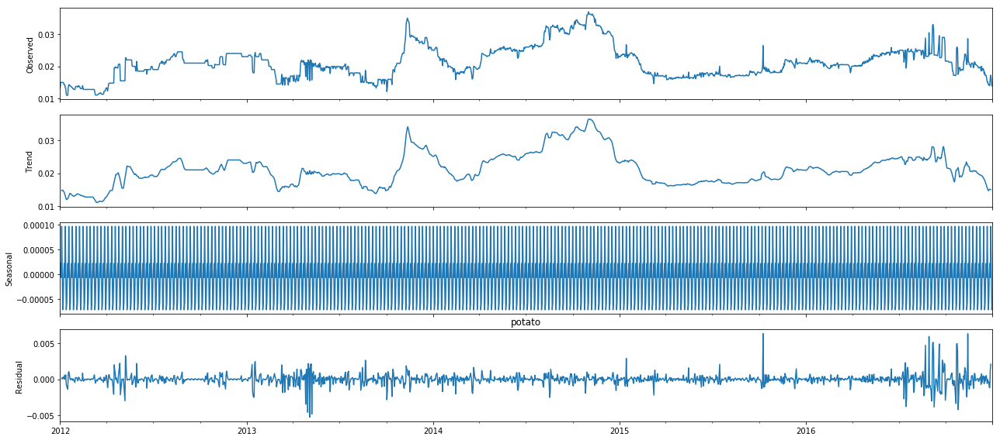



Test Statistic(More -ve, more stationary): -2.9357493693111754


P-Value(If less than 0.05, reject null) 0.04134597810768459
Reject Null Hypothesis(Series is non-stationary): True
Best Model:
p: 2
q: 3
d: 0
trend: c
Number of Products left: 10
Product: cucumber english


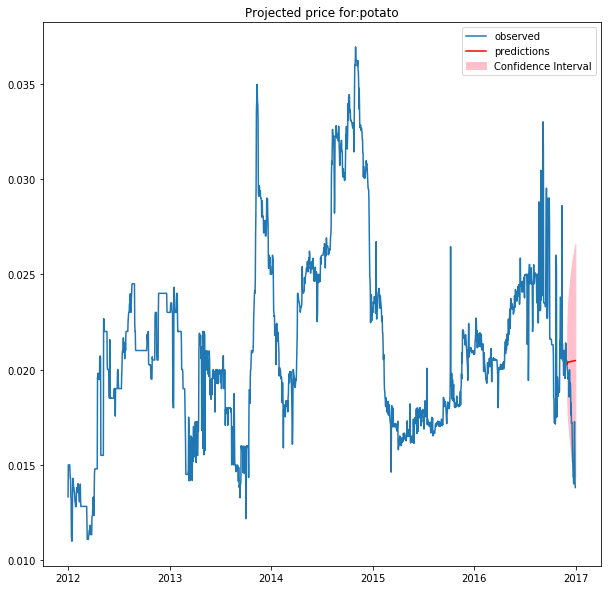

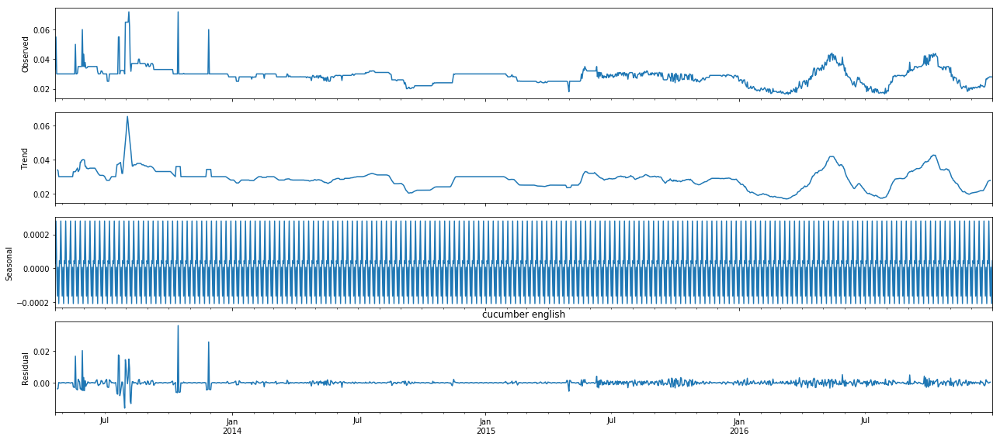



Test Statistic(More -ve, more stationary): -3.5609557548808723


P-Value(If less than 0.05, reject null) 0.006552869502595608
Reject Null Hypothesis(Series is non-stationary): True
Best Model:
p: 2
q: 3
d: 0
trend: c
Number of Products left: 9
Product: cucumber


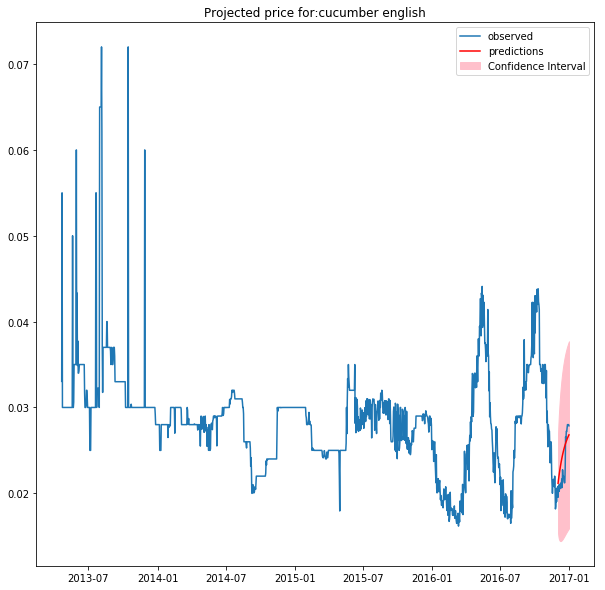

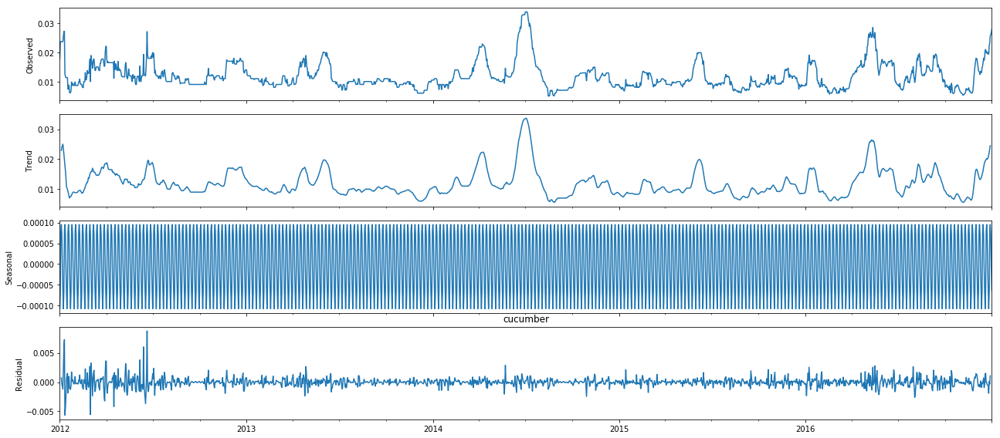



Test Statistic(More -ve, more stationary): -6.12735192781086


P-Value(If less than 0.05, reject null) 8.565296402015373e-08
Reject Null Hypothesis(Series is non-stationary): True
Best Model:
p: 1
q: 0
d: 0
trend: c
Number of Products left: 8
Product: ridge gourd


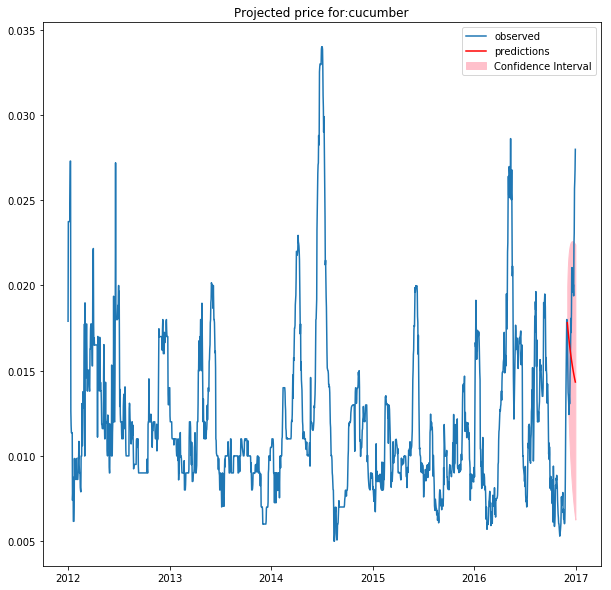

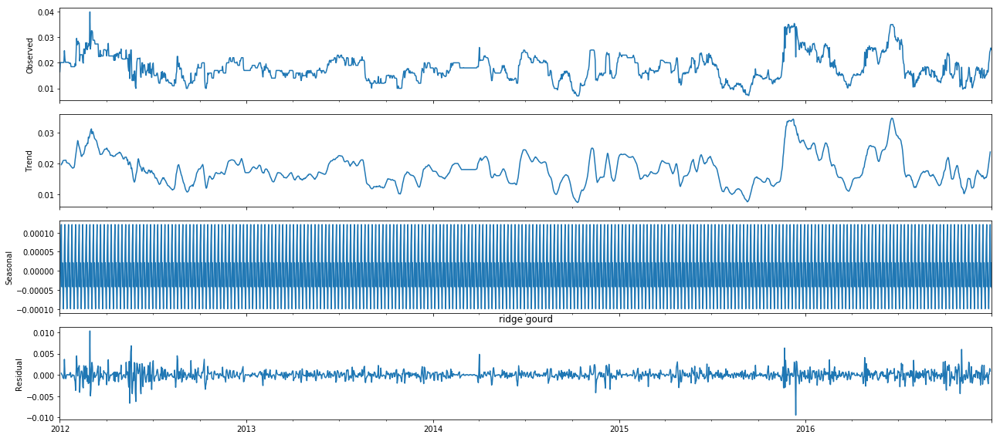



Test Statistic(More -ve, more stationary): -5.34587328645112


P-Value(If less than 0.05, reject null) 4.396489163943042e-06
Reject Null Hypothesis(Series is non-stationary): True
Best Model:
p: 1
q: 3
d: 0
trend: c
Number of Products left: 7
Product: ladies finger


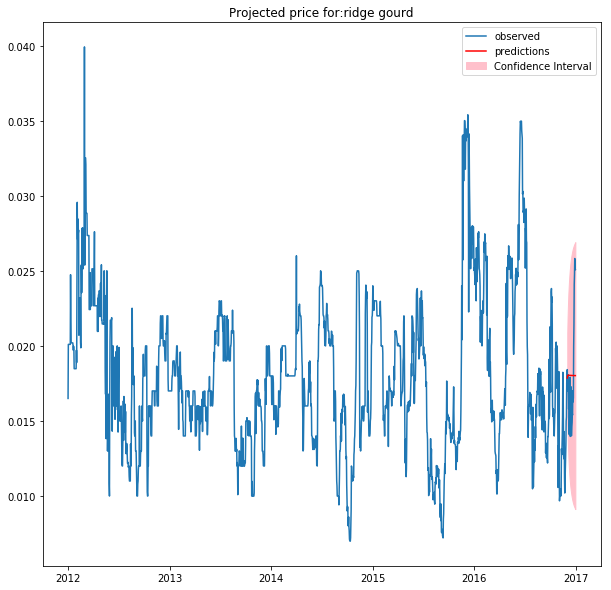

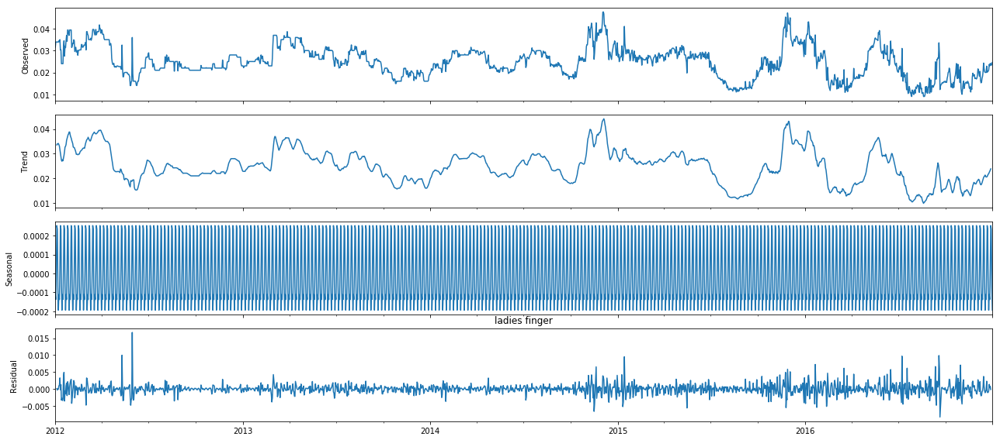



Test Statistic(More -ve, more stationary): -4.599583147018059


P-Value(If less than 0.05, reject null) 0.00012939835280503453
Reject Null Hypothesis(Series is non-stationary): True
Best Model:
p: 3
q: 0
d: 0
trend: ct
Number of Products left: 6
Product: banana robusta


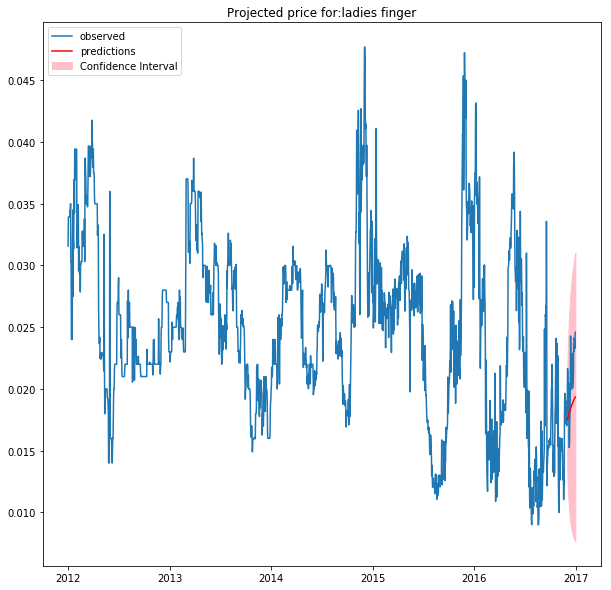

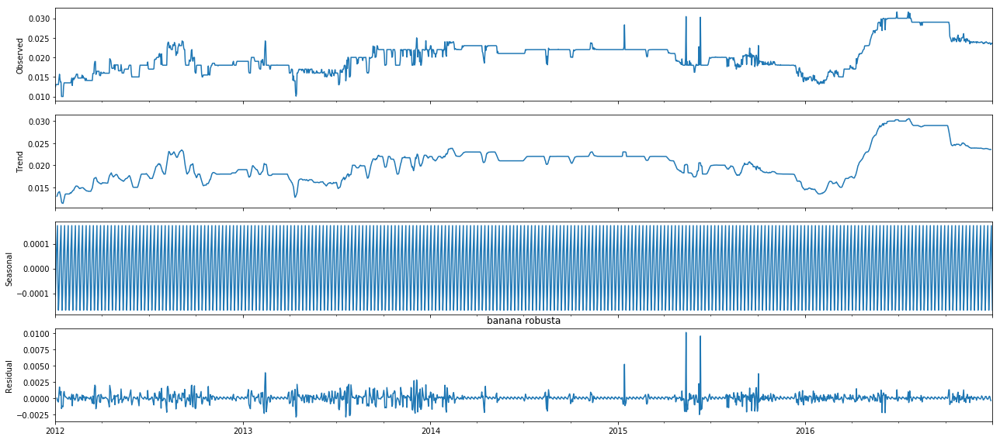



Test Statistic(More -ve, more stationary): -2.4905645583831504


P-Value(If less than 0.05, reject null) 0.1177869810289916
Reject Null Hypothesis(Series is non-stationary): False
Best Model:
p: 3
q: 3
d: 0
trend: n
Number of Products left: 5
Product: tomato local


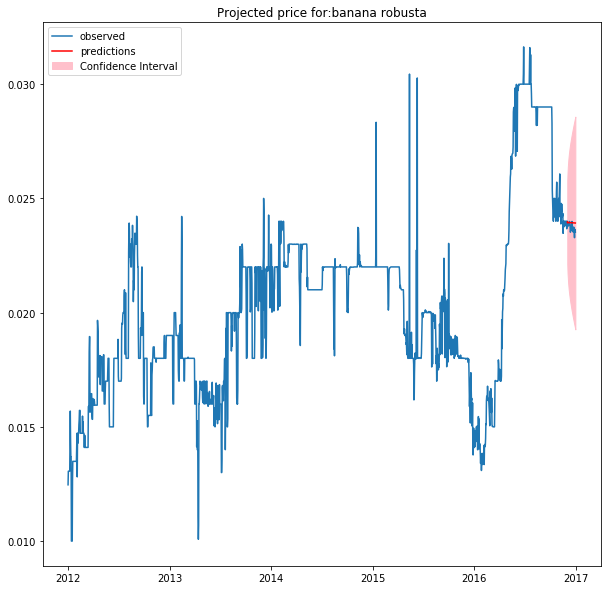

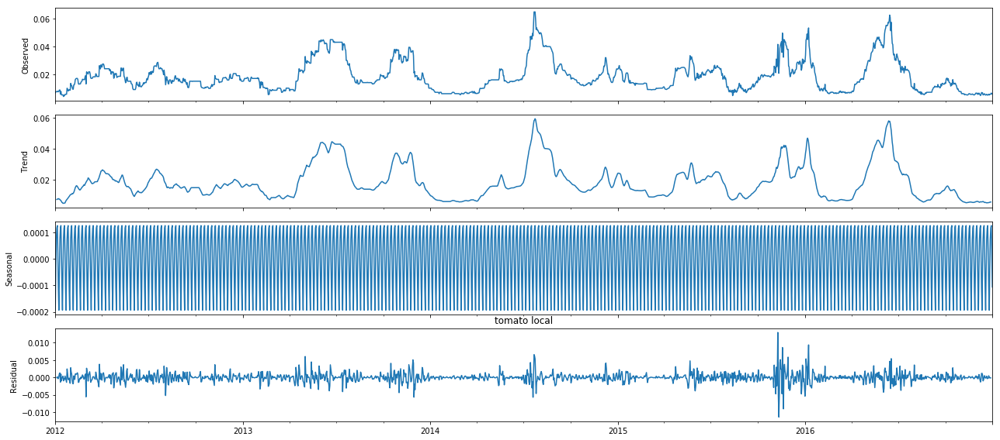



Test Statistic(More -ve, more stationary): -4.4059057757894795


P-Value(If less than 0.05, reject null) 0.0002897699608777612
Reject Null Hypothesis(Series is non-stationary): True
Best Model:
p: 1
q: 3
d: 0
trend: c
Number of Products left: 4
Product: bottle gourd


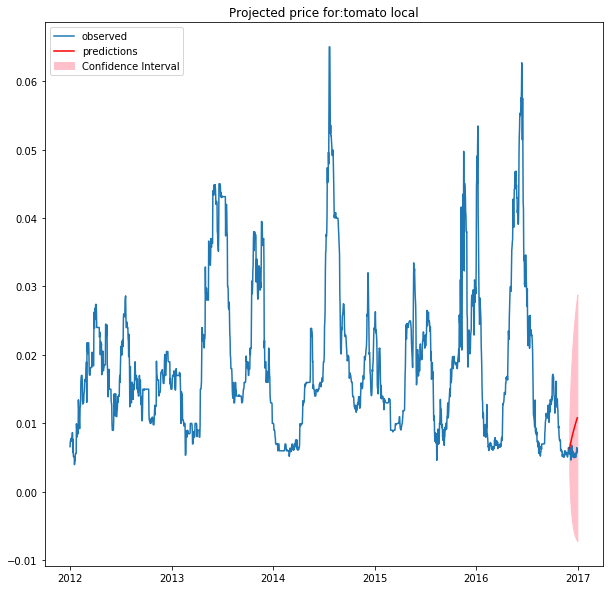

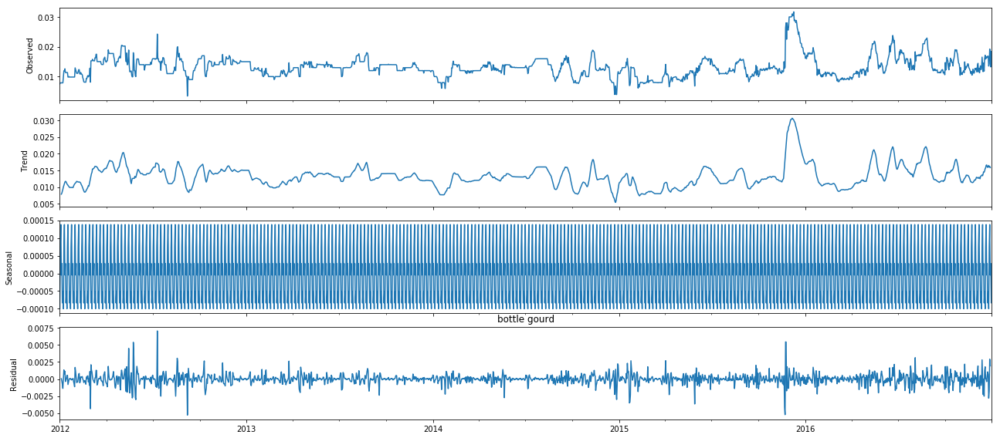



Test Statistic(More -ve, more stationary): -6.921027292076115


P-Value(If less than 0.05, reject null) 1.1463948268737745e-09
Reject Null Hypothesis(Series is non-stationary): True
Best Model:
p: 1
q: 3
d: 0
trend: c
Number of Products left: 3
Product: watermelon small


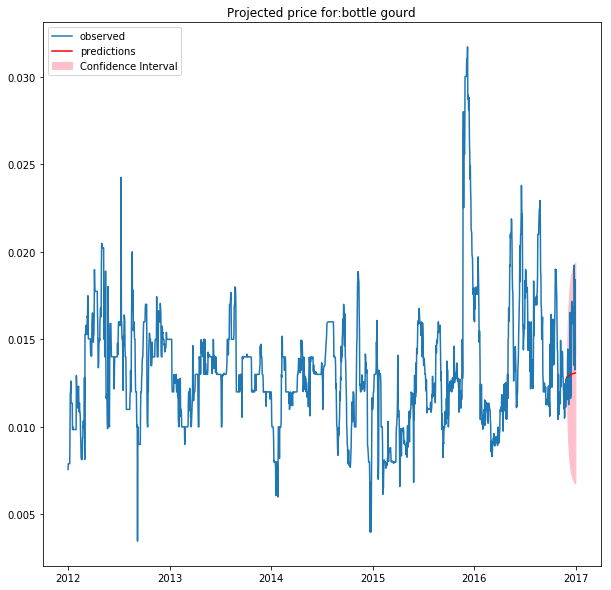

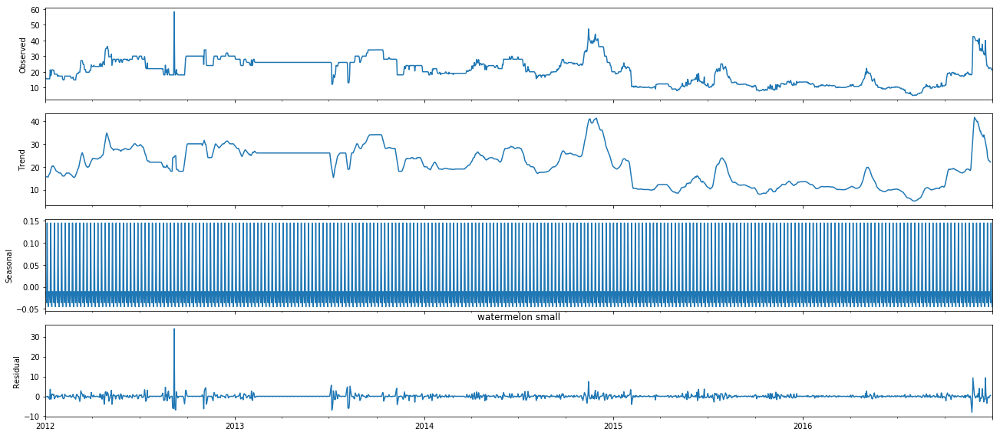



Test Statistic(More -ve, more stationary): -3.501240237206456


P-Value(If less than 0.05, reject null) 0.007955299214083295
Reject Null Hypothesis(Series is non-stationary): True
Best Model:
p: 1
q: 1
d: 1
trend: n
Number of Products left: 2
Product: beetroot


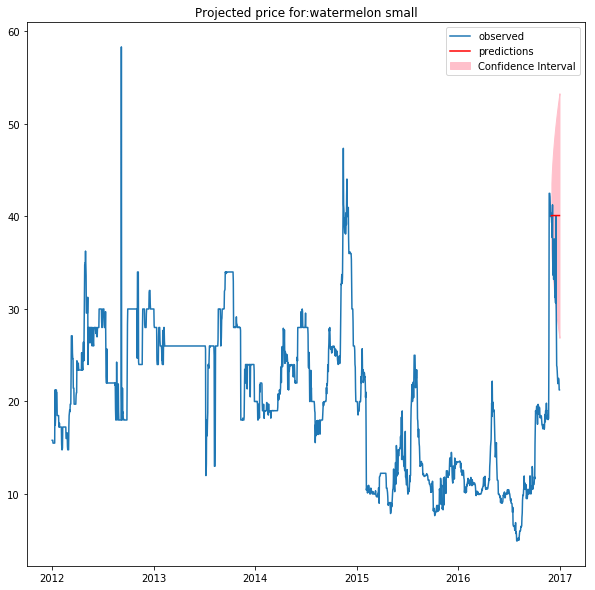

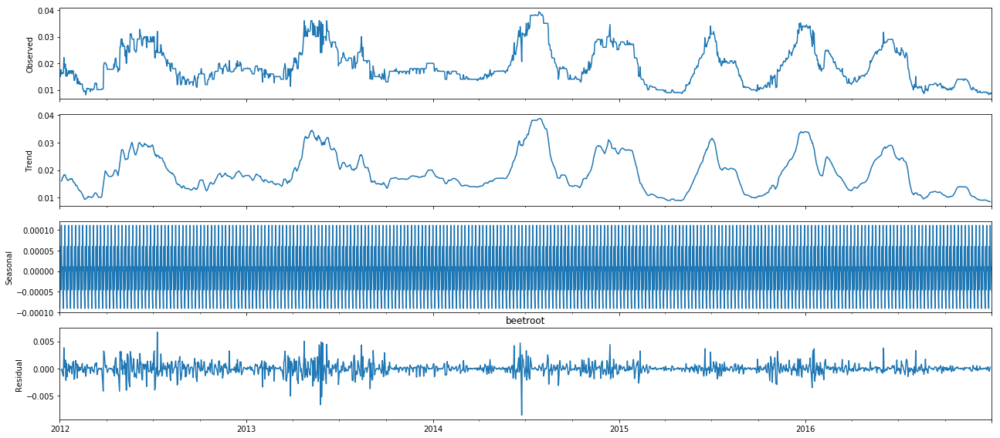



Test Statistic(More -ve, more stationary): -4.822522250706026


P-Value(If less than 0.05, reject null) 4.923980650710832e-05
Reject Null Hypothesis(Series is non-stationary): True
Best Model:
p: 3
q: 0
d: 0
trend: c
Number of Products left: 1
Product: carrot local


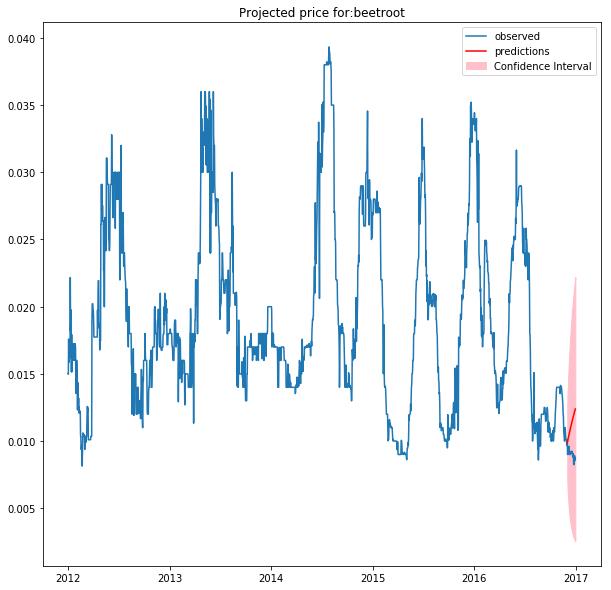

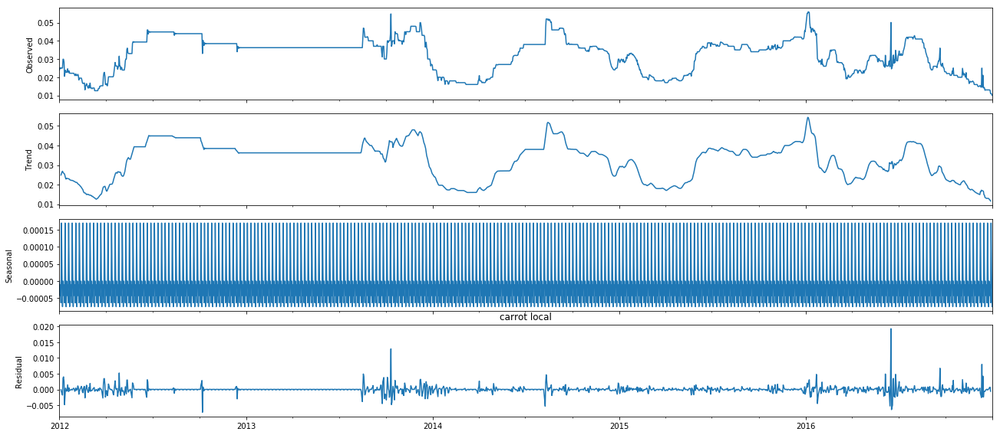



Test Statistic(More -ve, more stationary): -2.9491577613843964


P-Value(If less than 0.05, reject null) 0.03992299841994512
Reject Null Hypothesis(Series is non-stationary): True
Best Model:
p: 3
q: 0
d: 0
trend: c
Number of Products left: 0


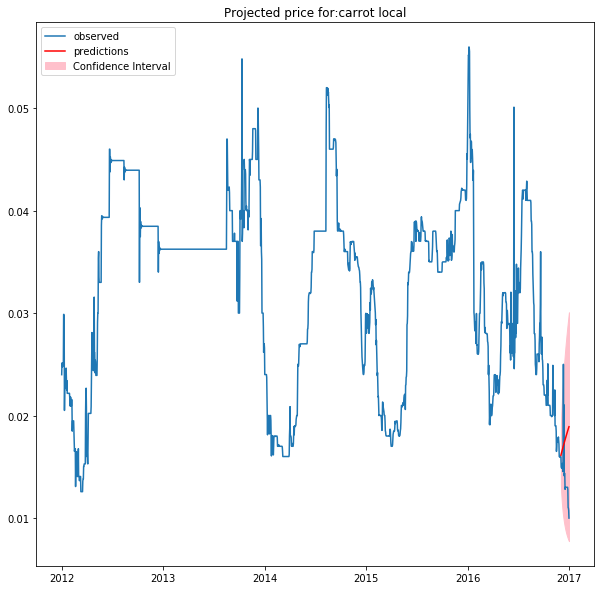

In [487]:
import warnings
warnings.filterwarnings('ignore')

list_summary = []
count = len(prod_groups)
for prod in prod_groups:
    print("Product:",prod)

    temp_df_exog = df_2012_2016[df_2012_2016['PROD_GROUP']==prod].copy()
    
    plot_decomposition(temp_df_exog['Normalized Price'],prod)
    
    #Obtaining ADF Results
    adf(temp_df_exog['Normalized Price'])
    
    p,d,q,trend,aic,bic = find_best_model_no_exog(temp_df_exog.iloc[:-30])
    
    list_summary.append([prod,p,d,q,trend])
    print("Best Model:")
    print("p:",p)
    print("q:",q)
    print("d:",d)
    print("trend:",trend)
    
    SARIMAX_model_no_exog(temp_df_exog,p,d,q,trend,prod)
    
    count = count-1
    print("Number of Products left:",count)

In [489]:
df_summary_no_cpi_no_rainfall = pd.DataFrame(list_summary,columns=['product','p','d','q','trend'])

df_summary_no_cpi_no_rainfall.style

,product,p,d,q,trend
0,onion,3,1,3,n
1,banana yelakki,1,0,3,c
2,capsicum green,3,0,2,c
3,tomato hybrid,1,0,3,c
4,potato,2,0,3,c
5,cucumber english,2,0,3,c
6,cucumber,1,0,0,c
7,ridge gourd,1,0,3,c
8,ladies finger,3,0,0,ct
9,banana robusta,3,0,3,n


## Forecasting values for all products

### Function to get model parameters

In [490]:
#This function picks up the p,d and q parameters from the df_summary dataframe
def get_pdq_no_cpi_rainfall(prod_group):
    if prod_group in list(df_summary_no_cpi_no_rainfall['product']):
        return df_summary_no_cpi_no_rainfall[df_summary_no_cpi_no_rainfall['product']==prod_group]['p'].item(),df_summary_no_cpi_no_rainfall[df_summary_no_cpi_no_rainfall['product']==prod_group]['d'].item(),df_summary_no_cpi_no_rainfall[df_summary_no_cpi_no_rainfall['product']==prod_group]['q'].item(),df_summary_no_cpi_no_rainfall[df_summary_no_cpi_no_rainfall['product']==prod_group]['trend'].item()    

### Function to build the best model for a given SKU

In [494]:
def forecast_model_no_cpi_rainfall(df,p,d,q,trend,name):
    # Instantiate the best model

    model = SARIMAX(df[:-30]['Normalized Price'].values, order=(p,d,q),trend=trend)

    # Fit the model
    results = model.fit()

    # Generate predictions
    dynamic_forecast_30_days = results.get_forecast(30, alpha=0.05)  # 95% conf
    
    #Mean of forecast
    mean_forecast_30_days = dynamic_forecast_30_days.predicted_mean
    
    # Get confidence intervals of predictions
    confidence_intervals_30_days = dynamic_forecast_30_days.conf_int()
    # Select lower and upper confidence limits
    lower_limits = [i[0] for i in confidence_intervals_30_days]
    upper_limits = [i[1] for i in confidence_intervals_30_days]

    dates = df.index
    dates_2 = dates[-30:]
    
    #Plot the graph
    plt.figure(figsize=(10,10))
    plt.plot(dates,df['Normalized Price'].values, label='observed')
    plt.plot(dates_2,mean_forecast_30_days,color='red', label='predictions')
    plt.fill_between(dates_2,lower_limits,upper_limits,color='pink',label='Confidence Interval')
    plt.legend(loc='best')
    plt.title("Projected price for:"+name)

    return mean_forecast_30_days,dates_2

### Function to get the forecast

In [495]:
def get_forecast_no_cpi_rainfall(selected_sku,actual_prod):
    #Obtaining the normalizing factor for the SKU
    normalizing_factor_sku = dict_prod_factor[actual_prod]
    print("Normalizing factor:",normalizing_factor_sku)
    
    #Obtaining the product group
    sku_prod_group = get_prod_group(selected_sku)
    print("Product Group:",sku_prod_group)
    
    #Obtaining the model parameters
    p,d,q,trend = get_pdq_no_cpi_rainfall(sku_prod_group)
        
    #Printing Model parameters
    print("Model Parameters:")
    print("p:",p)
    print("d:",d)
    print("q:",q)
    print("trend:",trend)
    
    
    #Creating a dataframe with observations from a certain prodcut
    temp_df_exog = df_2012_2016[df_2012_2016['PROD_GROUP']==sku_prod_group].copy()

    number_of_observations = len(temp_df_exog)
    
    avg_price = np.average(temp_df_exog['cp'])
    
    print("Average Cost Price:",avg_price)
    #Calling function to plot the decomposition plot
    plot_decomposition(temp_df_exog['Normalized Price'],sku_prod_group)
    
    #Obtaining ADF Results
    adf(temp_df_exog['Normalized Price'])
    
    
    #print(temp_df_exog.tail())

    predictions,dates = forecast_model_no_cpi_rainfall(temp_df_exog,p,d,q,trend,sku_prod_group)

    #print("Predicted Normalized Price:",list(predictions))
    cost_price_predictions = np.array(predictions)/normalizing_factor_sku
    
    #print(predictions.values)
    #print(cost_price_predictions)

    
    actual_price = (temp_df_exog['Normalized Price'].iloc[-30:].values)/normalizing_factor_sku

    #print(number_of_observations)
    #print(avg_price)
    return cost_price_predictions,actual_price,dates,number_of_observations,avg_price


For SKU: Fresho onion 1 kg
Normalizing factor: 0.001
Product Group: onion
Model Parameters:
p: 3
d: 1
q: 3
trend: n
Average Cost Price: 22.464679802955665


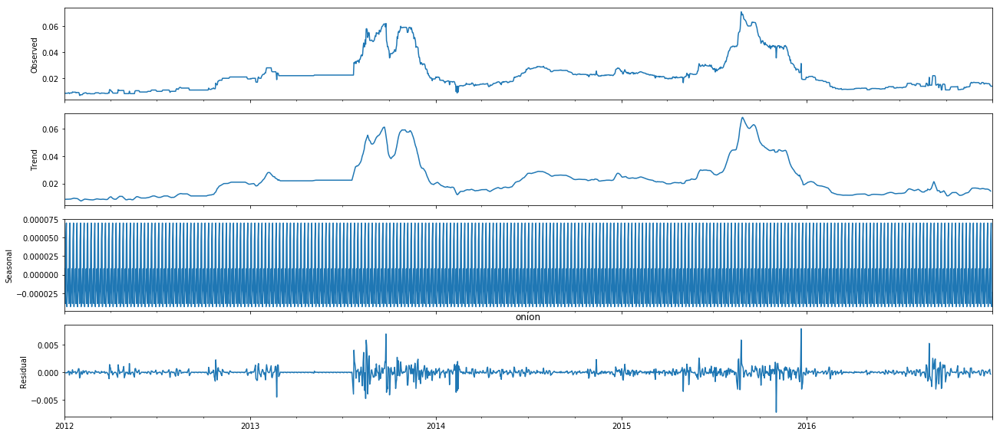



Test Statistic(More -ve, more stationary): -2.712112405585478


P-Value(If less than 0.05, reject null) 0.07196564402881468
Reject Null Hypothesis(Series is non-stationary): False
RMSE: 1.861796031924412
MAE: 1.0476387381526386




For SKU: Fresho banana-yelakki 1 kg
Normalizing factor: 0.001
Product Group: banana yelakki
Model Parameters:
p: 1
d: 0
q: 3
trend: c
Average Cost Price: 45.60303776683087


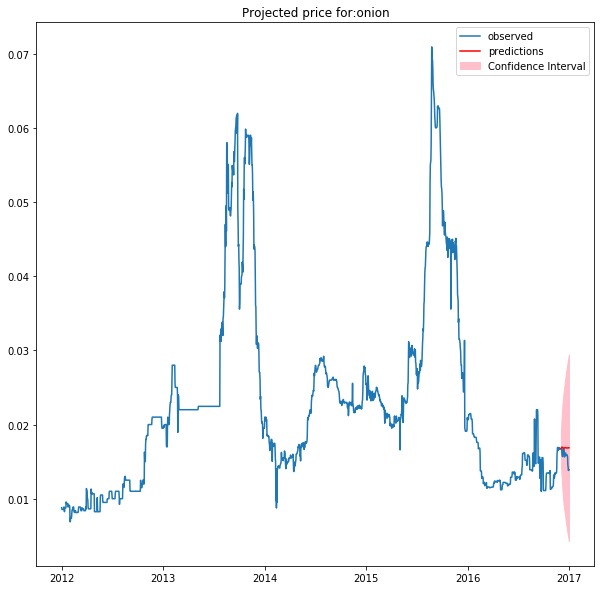

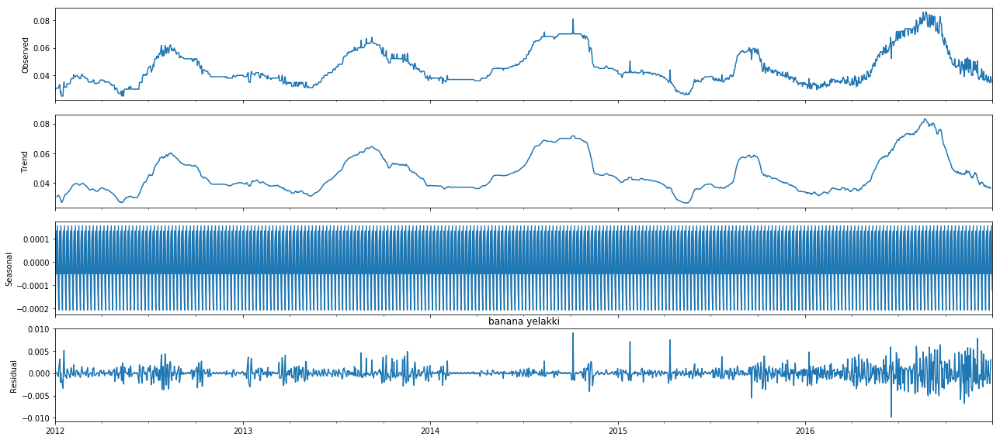



Test Statistic(More -ve, more stationary): -3.597271490150522


P-Value(If less than 0.05, reject null) 0.00581340576485223
Reject Null Hypothesis(Series is non-stationary): True
RMSE: 40.33481519053344
MAE: 5.9388266021260945




For SKU: Fresho capsicum-green 1 kg
Normalizing factor: 0.001
Product Group: capsicum green
Model Parameters:
p: 3
d: 0
q: 2
trend: c
Average Cost Price: 25.161995511849497


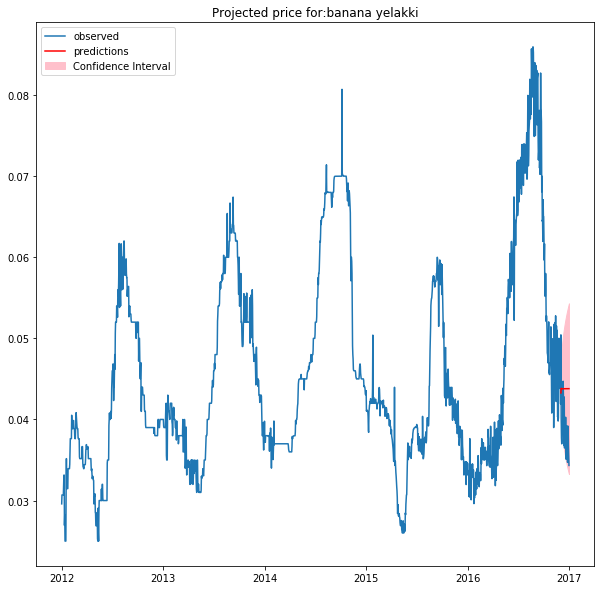

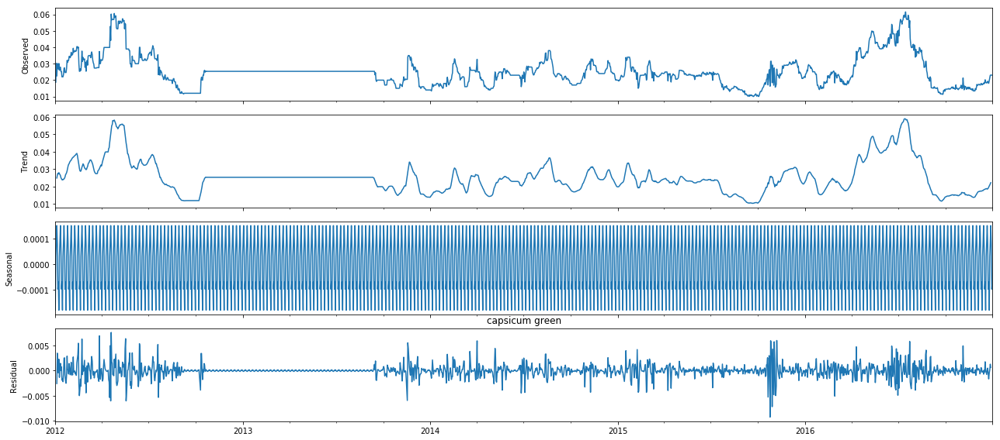



Test Statistic(More -ve, more stationary): -4.295091518301888


P-Value(If less than 0.05, reject null) 0.0004529872143710647
Reject Null Hypothesis(Series is non-stationary): True
RMSE: 2.175941963339781
MAE: 1.0412559005011623




For SKU: Fresho tomato-hybrid 1 kg
Normalizing factor: 0.001
Product Group: tomato hybrid
Model Parameters:
p: 1
d: 0
q: 3
trend: c
Average Cost Price: 17.822523262178436


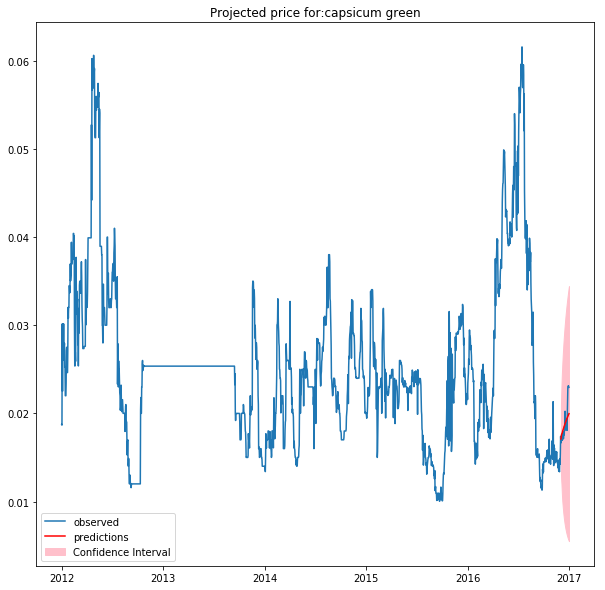

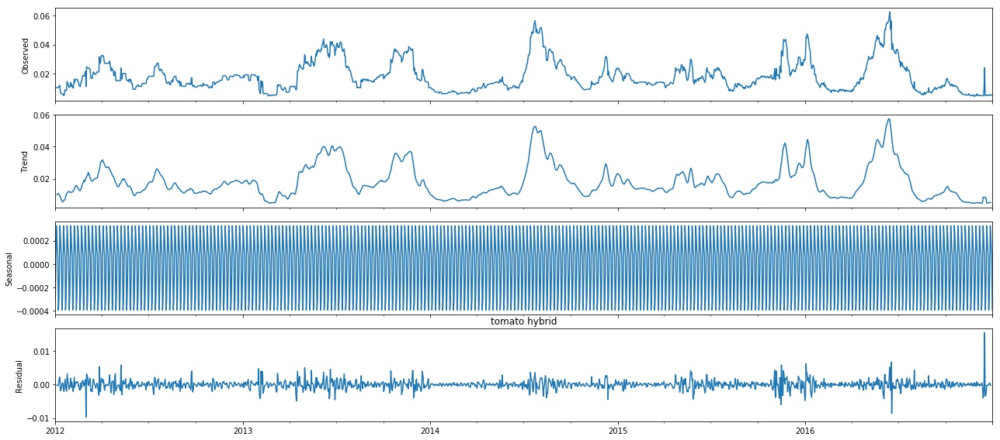



Test Statistic(More -ve, more stationary): -4.594099374985087


P-Value(If less than 0.05, reject null) 0.00013244331744529254
Reject Null Hypothesis(Series is non-stationary): True
RMSE: 24.087919672072307
MAE: 4.262723367148173




For SKU: Fresho potato 1 kg
Normalizing factor: 0.001
Product Group: potato
Model Parameters:
p: 2
d: 0
q: 3
trend: c
Average Cost Price: 21.1768144499179


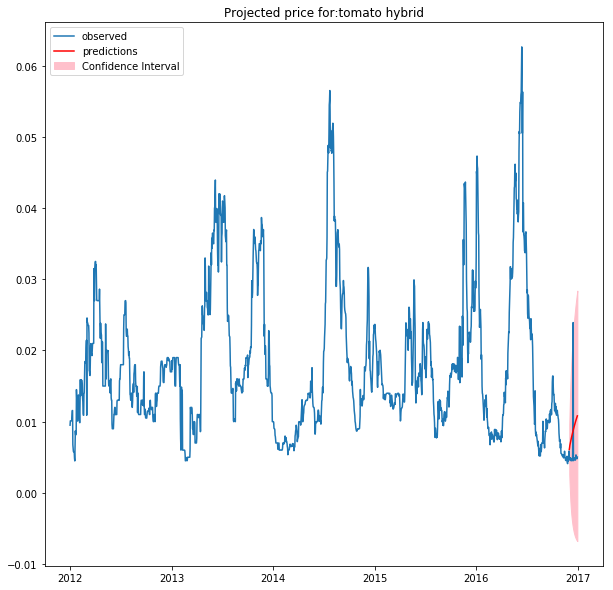

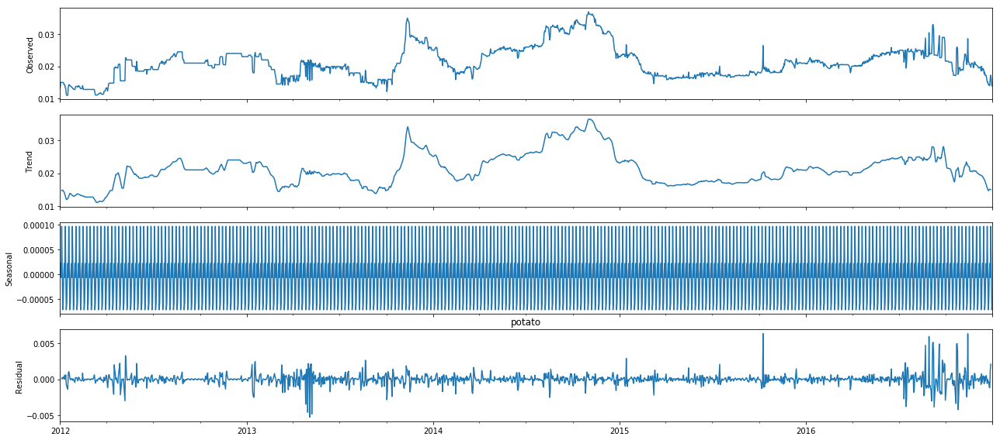



Test Statistic(More -ve, more stationary): -2.9357493693111754


P-Value(If less than 0.05, reject null) 0.04134597810768459
Reject Null Hypothesis(Series is non-stationary): True
RMSE: 14.099358679254207
MAE: 3.0656763605898765




For SKU: Fresho cucumber-english 1 kg
Normalizing factor: 0.001
Product Group: cucumber english
Model Parameters:
p: 2
d: 0
q: 3
trend: c
Average Cost Price: 28.538710420264824


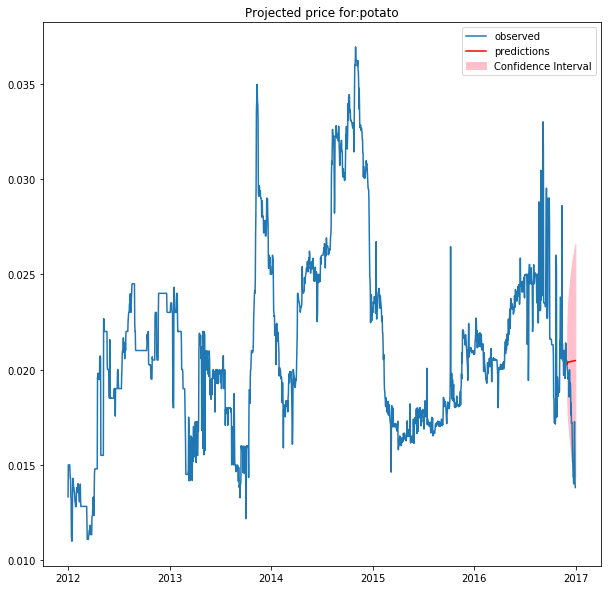

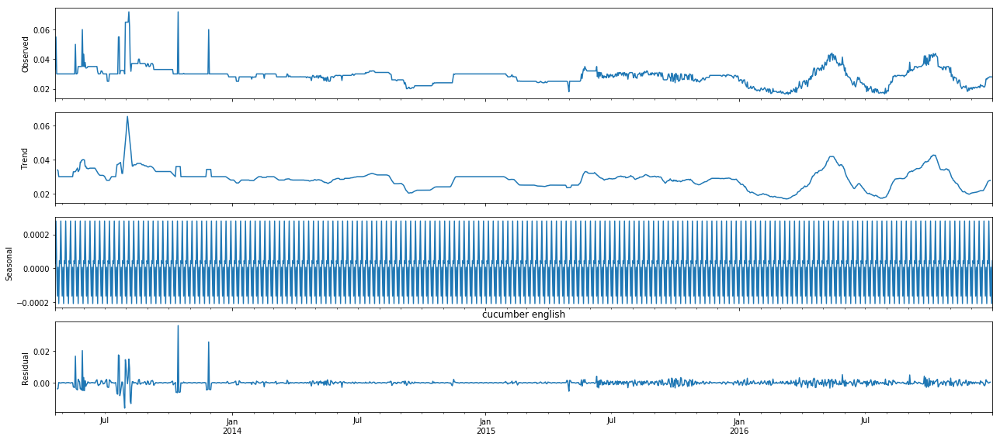



Test Statistic(More -ve, more stationary): -3.5609557548808723


P-Value(If less than 0.05, reject null) 0.006552869502595608
Reject Null Hypothesis(Series is non-stationary): True
RMSE: 5.291857364623951
MAE: 2.054898660985258




For SKU: Fresho cucumber 1 kg
Normalizing factor: 0.001
Product Group: cucumber
Model Parameters:
p: 1
d: 0
q: 0
trend: c
Average Cost Price: 11.931476008027733


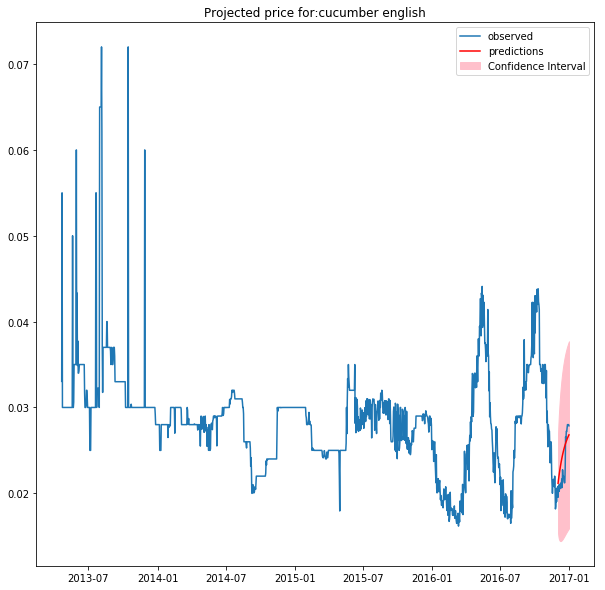

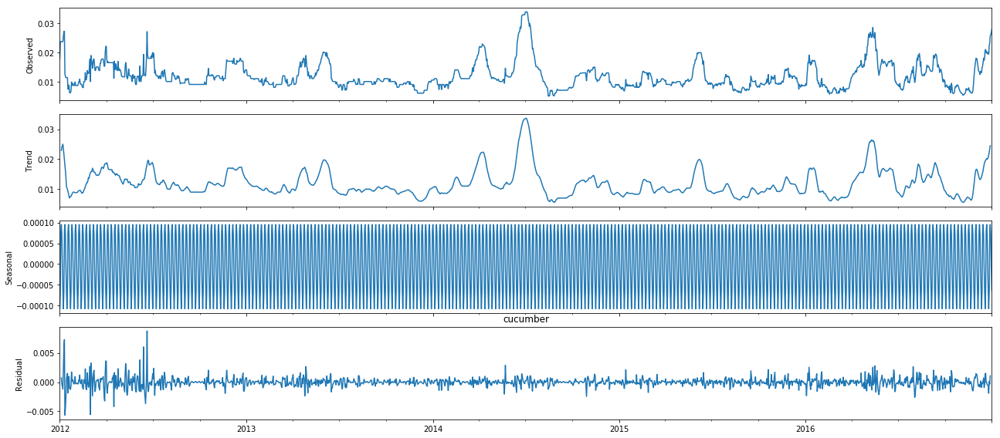



Test Statistic(More -ve, more stationary): -6.12735192781086


P-Value(If less than 0.05, reject null) 8.565296402015373e-08
Reject Null Hypothesis(Series is non-stationary): True
RMSE: 34.78776217748024
MAE: 4.768248361904997




For SKU: Fresho ridge-gourd 1 kg
Normalizing factor: 0.001
Product Group: ridge gourd
Model Parameters:
p: 1
d: 0
q: 3
trend: c
Average Cost Price: 17.99210058991668


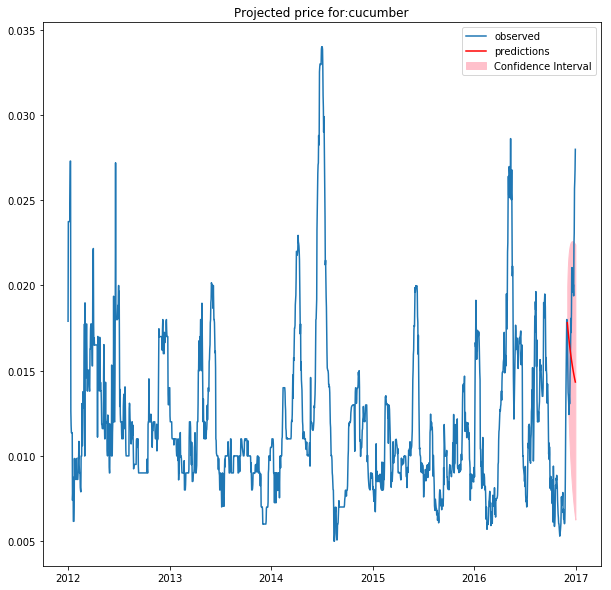

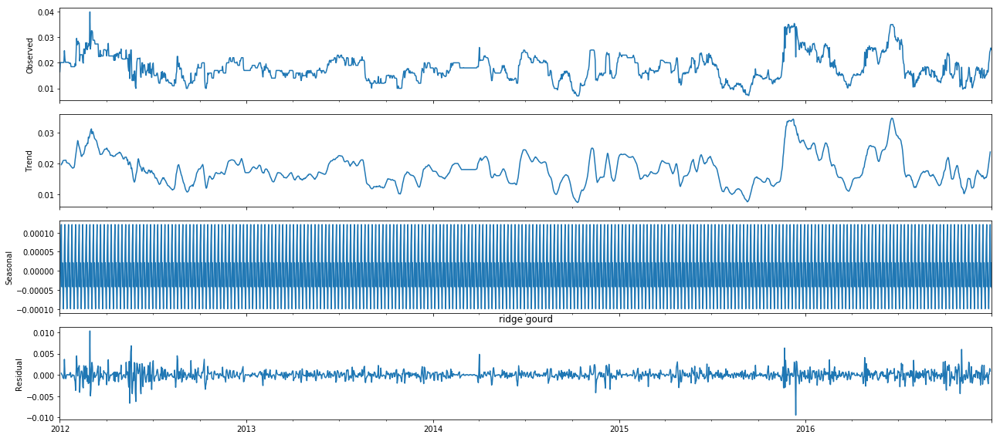



Test Statistic(More -ve, more stationary): -5.34587328645112


P-Value(If less than 0.05, reject null) 4.396489163943042e-06
Reject Null Hypothesis(Series is non-stationary): True
RMSE: 12.648020119778835
MAE: 2.7735082968417903




For SKU: Fresho ladies-finger 1 kg
Normalizing factor: 0.001
Product Group: ladies finger
Model Parameters:
p: 3
d: 0
q: 0
trend: ct
Average Cost Price: 24.829748626568552


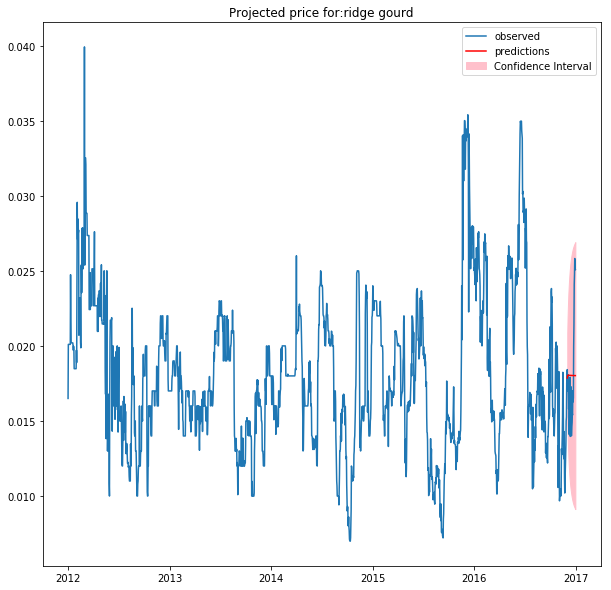

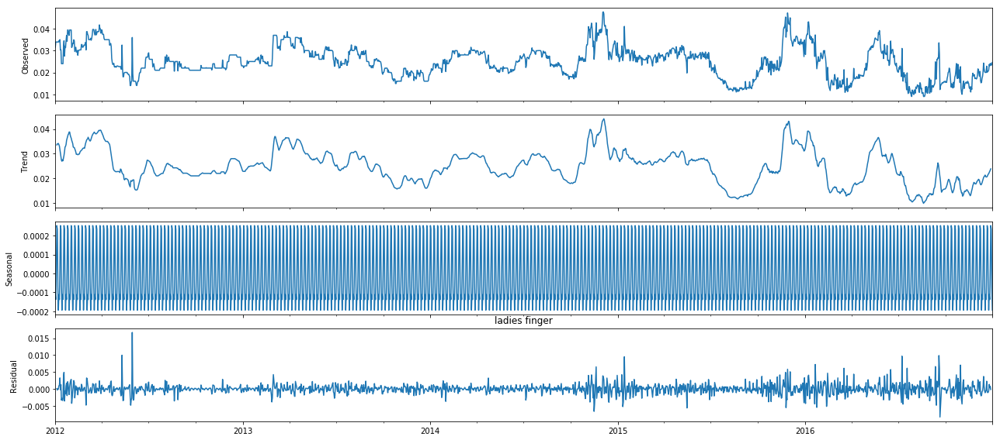



Test Statistic(More -ve, more stationary): -4.599583147018059


P-Value(If less than 0.05, reject null) 0.00012939835280503453
Reject Null Hypothesis(Series is non-stationary): True
RMSE: 9.84640238729415
MAE: 2.7155216428970514




For SKU: Fresho banana-robusta 1 kg
Normalizing factor: 0.001
Product Group: banana robusta
Model Parameters:
p: 3
d: 0
q: 3
trend: n
Average Cost Price: 20.24772471005336


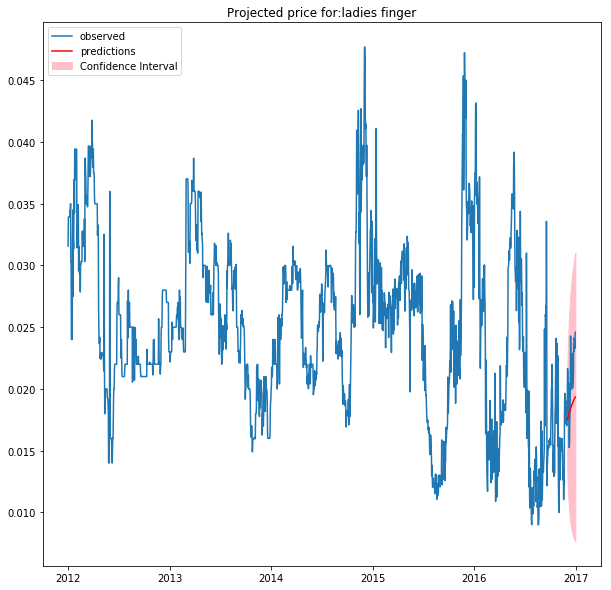

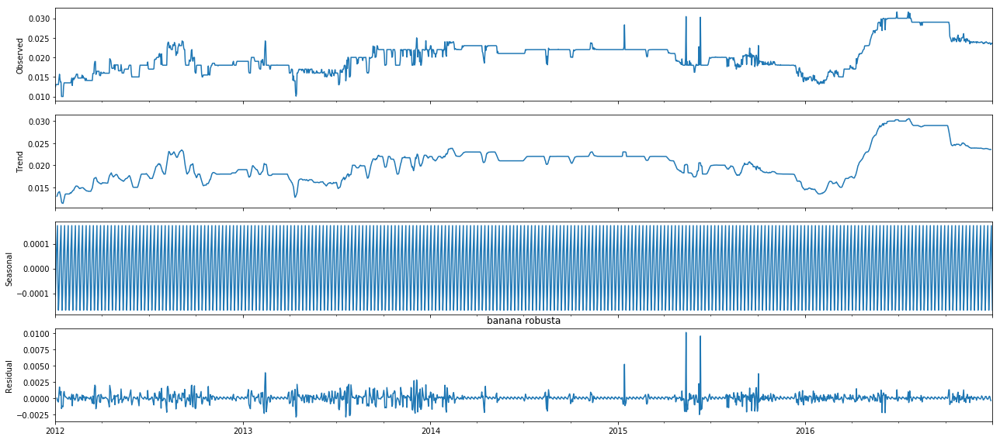



Test Statistic(More -ve, more stationary): -2.4905645583831504


P-Value(If less than 0.05, reject null) 0.1177869810289916
Reject Null Hypothesis(Series is non-stationary): False
RMSE: 0.06711916346661197
MAE: 0.20952505220905013




For SKU: Fresho tomato-local 1 kg
Normalizing factor: 0.001
Product Group: tomato local
Model Parameters:
p: 1
d: 0
q: 3
trend: c
Average Cost Price: 18.50603551014445


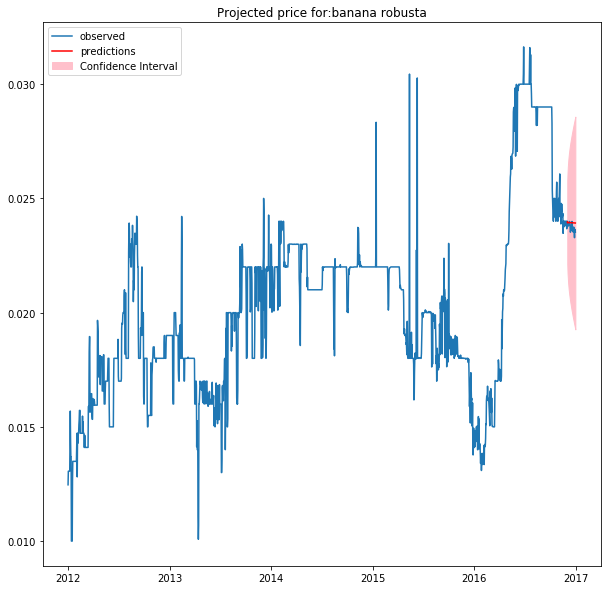

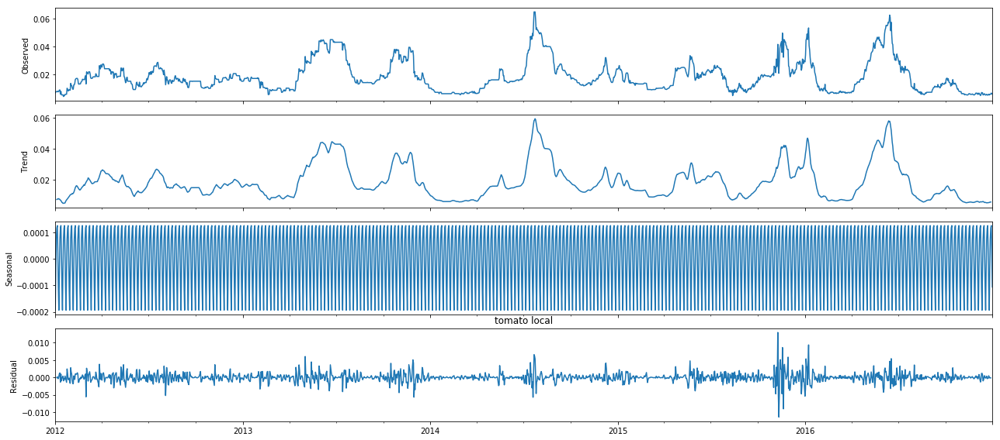



Test Statistic(More -ve, more stationary): -4.4059057757894795


P-Value(If less than 0.05, reject null) 0.0002897699608777612
Reject Null Hypothesis(Series is non-stationary): True
RMSE: 11.768378470743809
MAE: 3.053910899603631




For SKU: Fresho bottle-gourd 1 kg
Normalizing factor: 0.001
Product Group: bottle gourd
Model Parameters:
p: 1
d: 0
q: 3
trend: c
Average Cost Price: 13.215932900734995


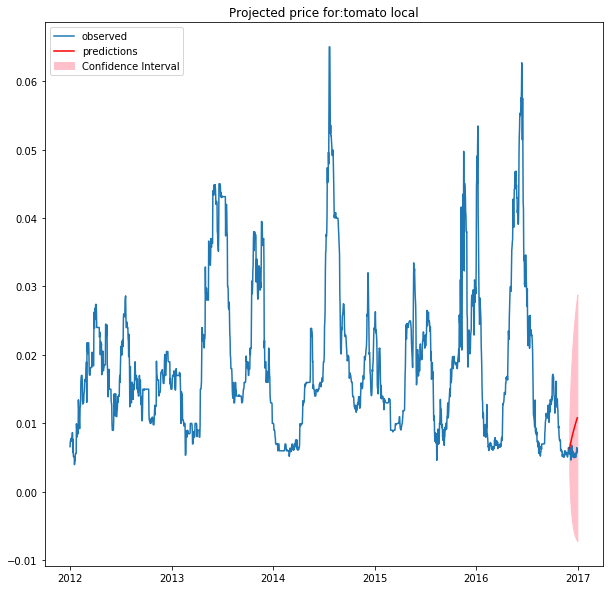

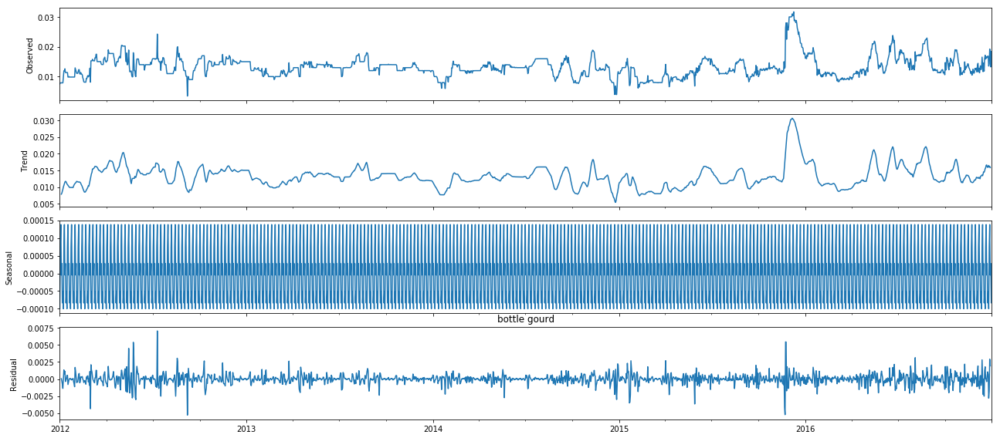



Test Statistic(More -ve, more stationary): -6.921027292076115


P-Value(If less than 0.05, reject null) 1.1463948268737745e-09
Reject Null Hypothesis(Series is non-stationary): True
RMSE: 7.3296787501009115
MAE: 2.1368309228832194




For SKU: Fresho watermelon-small 1 pc  1.7 - 2.5 kg
Normalizing factor: 1.0
Product Group: watermelon small
Model Parameters:
p: 1
d: 1
q: 1
trend: n
Average Cost Price: 20.37181437608759


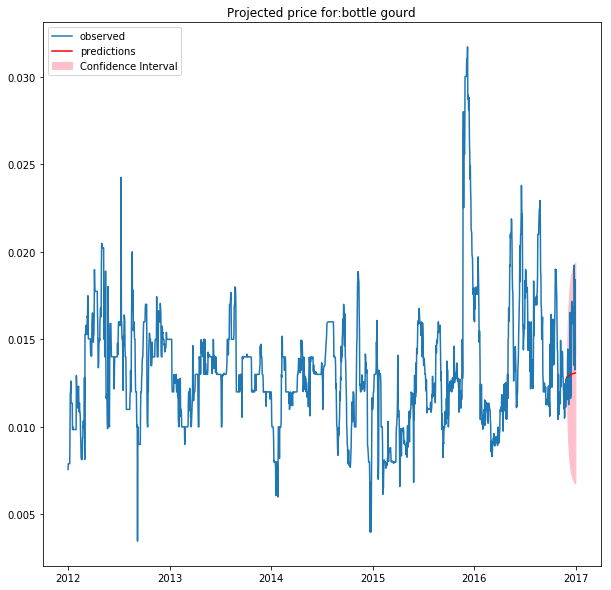

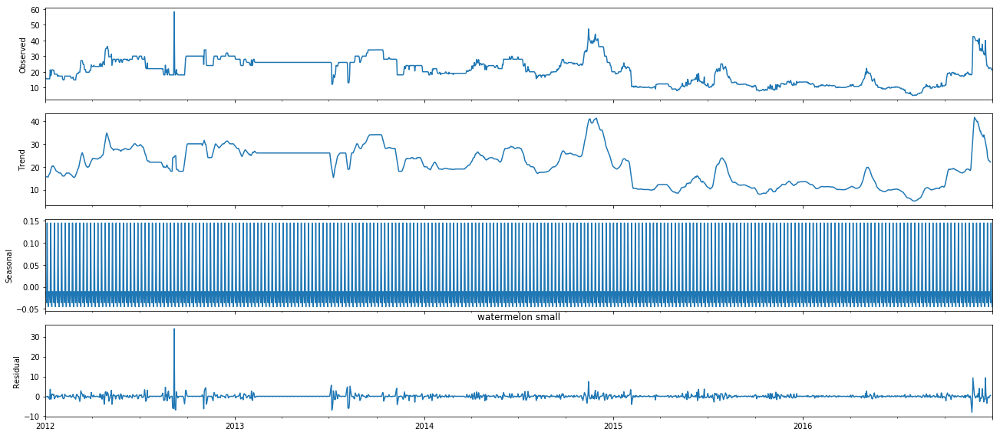



Test Statistic(More -ve, more stationary): -3.501240237206456


P-Value(If less than 0.05, reject null) 0.007955299214083295
Reject Null Hypothesis(Series is non-stationary): True
RMSE: 140.49613579578278
MAE: 9.833681084975607




For SKU: Fresho beetroot 1 kg
Normalizing factor: 0.001
Product Group: beetroot
Model Parameters:
p: 3
d: 0
q: 0
trend: c
Average Cost Price: 18.977353858908323


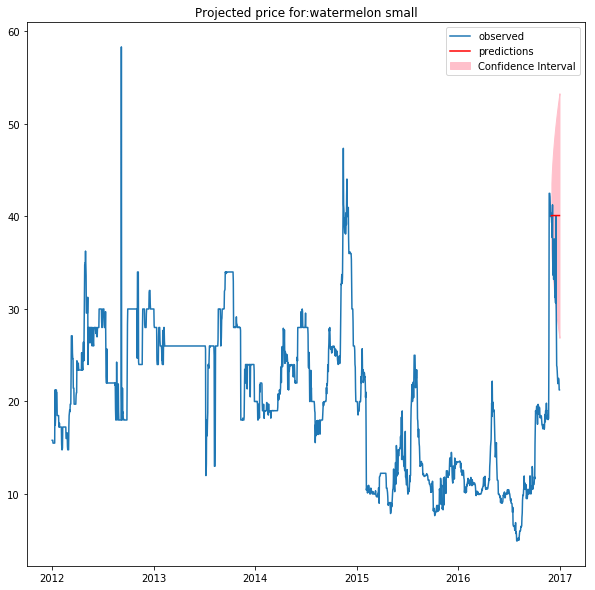

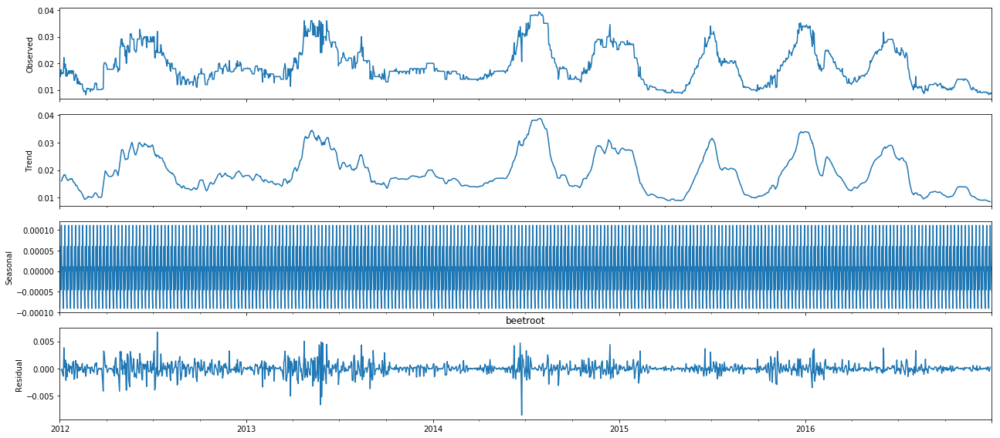



Test Statistic(More -ve, more stationary): -4.822522250706026


P-Value(If less than 0.05, reject null) 4.923980650710832e-05
Reject Null Hypothesis(Series is non-stationary): True
RMSE: 5.791359784198017
MAE: 2.1911812196021008




For SKU: Fresho carrot-local 1 kg
Normalizing factor: 0.001
Product Group: carrot local
Model Parameters:
p: 3
d: 0
q: 0
trend: c
Average Cost Price: 32.15800528151182


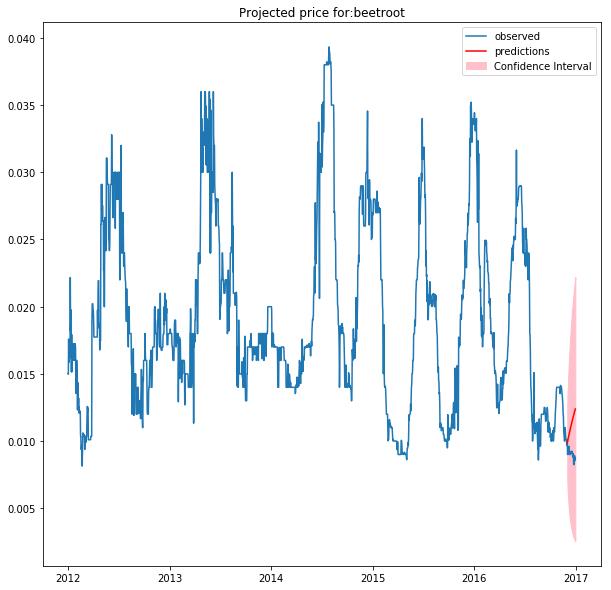

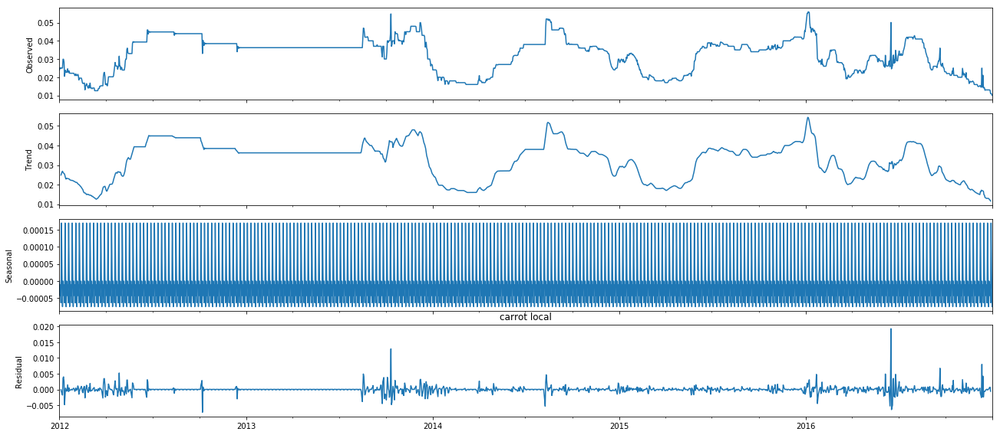



Test Statistic(More -ve, more stationary): -2.9491577613843964


P-Value(If less than 0.05, reject null) 0.03992299841994512
Reject Null Hypothesis(Series is non-stationary): True
RMSE: 23.138156916991775
MAE: 4.2122841751249585






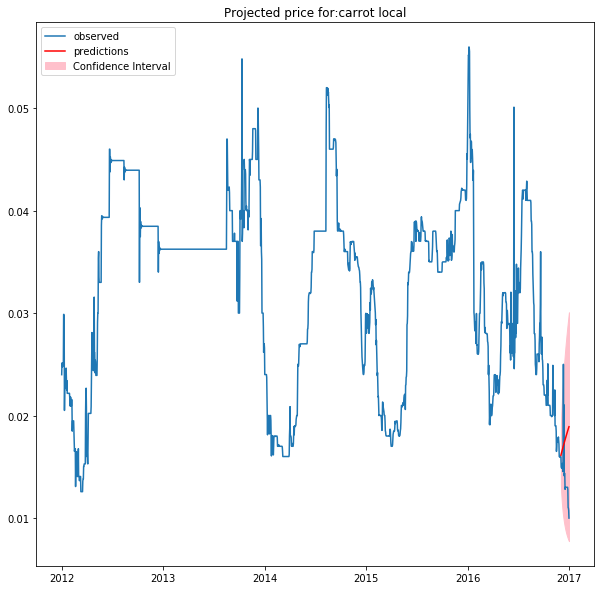

In [497]:
#List to store SKU names of all SKUs for which model has been built
SKU_list = []
#List to store predicted prices of all SKUs for which model has been built
predicted_prices = []
#List to store actual prices of all SKUs for which model has been built
actual_prices = []
#List to store RMSE scores of all SKUs for which model has been built
RMSE_scores = []
#List to store MAE scores of all SKUs for which model has been built
MAE_scores = []
#List to store last 30 dates of all SKUs for which model has been built
dates_list = []

num_observations = []

avg_prices = []

count = 0
#Iterating over all the SKUs
#Here, I've iterated over the product 'splits', as it makes it easier to obtain normalizing factor
for i,prod in enumerate(unique_products_split):
    #Storing the split priduct in a variable
    selected_sku = prod
    
    #Obtaining the actual name of the SKU
    actual_prod = unique_products[i]
    print("For SKU:",actual_prod)
    
    #Calling the method to obtain the forecast
    cost_price_predictions,actual_price,dates,number_of_observations,avg_price = get_forecast_no_cpi_rainfall(selected_sku,actual_prod)
    #print("Cost Price Prediction:",cost_price_predictions)
    #print("Actual Prices:",actual_price)
    #print("Dates:",dates)
    #print("Number of Observations",number_of_observations)
    #print("Average Price",avg_price)

    if len(cost_price_predictions) == 30:
        
        rmse = mean_squared_error(actual_price,cost_price_predictions)
        print("RMSE:",rmse)
        
        mae = mean_absolute_error(actual_price,cost_price_predictions)
        print("MAE:",mae)
        #Storing the last 30 dates of the SKU for which we have obtained the forecast
        dates_list.append(dates)
        #Storing the name of the SKU for which we have obtained the forecast
        SKU_list.append(actual_prod)
        #Storing the predicted prices of the SKU for which we have obtained the forecast
        predicted_prices.append(cost_price_predictions)
        #Storing the RMSE of the SKU for which we have obtained the forecast
        RMSE_scores.append(rmse)
        #Storing the MAE of the SKU for which we have obtained the forecast
        MAE_scores.append(mae)
        #Storing the actual price of the SKU for which we have obtained the forecast
        actual_prices.append(actual_price)
        
        num_observations.append(number_of_observations)
        
        avg_prices.append(avg_price)
    
    print('\n\n\n')

### Computing average 30 day SKU price

In [498]:
sku_avg_30_day_price = []
df_required = df_cpi_rainfall[(df_cpi_rainfall.index.year ==2016)&(df_cpi_rainfall.index.month ==12) &(df_cpi_rainfall.index.day >=2)]
for sku in SKU_list:
    avg_price_sku = np.average((df_required[df_required['sku_description']==sku]['cp']))
    sku_avg_30_day_price.append(avg_price_sku)

### Calculating MAPE

In [499]:
MAPE = []
for i,prices in enumerate(actual_prices):
    diff = abs((actual_prices[i] - predicted_prices[i])/(actual_prices[i]))
    sum_diff = np.sum(diff)
    MAPE.append(sum_diff/30)

In [500]:
normalized_rmse = (np.array(RMSE_scores)/np.array(sku_avg_30_day_price))
df_summary_no_cpi_no_rainfall_metrics = pd.DataFrame({'SKU':SKU_list,'RMSE':RMSE_scores,'Normalized RMSE':normalized_rmse,'Mean Absolute Error':MAE_scores,'Mean Absolute Percentage Error':MAPE,'Observations used':num_observations})
df_summary_no_cpi_no_rainfall_metrics.sort_values(by=['Mean Absolute Percentage Error'],ascending=True,inplace=True)
df_summary_no_cpi_no_rainfall_metrics.style

,SKU,RMSE,Normalized RMSE,Mean Absolute Error,Mean Absolute Percentage Error,Observations used
9,Fresho banana-robusta 1 kg,0.0671192,0.00282786,0.209525,0.00887367,1827
2,Fresho capsicum-green 1 kg,2.17594,0.114819,1.04126,0.0510248,1827
0,Fresho onion 1 kg,1.8618,0.117753,1.04764,0.0696913,1827
5,Fresho cucumber-english 1 kg,5.29186,0.22693,2.0549,0.0925044,1351
8,Fresho ladies-finger 1 kg,9.8464,0.475243,2.71552,0.126348,1827
11,Fresho bottle-gourd 1 kg,7.32968,0.501437,2.13683,0.135041,1827
7,Fresho ridge-gourd 1 kg,12.648,0.704089,2.77351,0.149623,1827
1,Fresho banana-yelakki 1 kg,40.3348,1.0511,5.93883,0.159007,1827
4,Fresho potato 1 kg,14.0994,0.812378,3.06568,0.195967,1827
6,Fresho cucumber 1 kg,34.7878,1.88235,4.76825,0.241122,1827


In [502]:
df_summary_no_cpi_no_rainfall_metrics.to_csv("/Users/vegi/Documents/USC_Masters/ML/DemandForecasts/df_summary_no_cpi_no_rainfall_metrics.csv", sep=",", float_format='%.6f',index=False, line_terminator='\n',encoding='utf-8')

### With Seasonality

In [39]:
df_seasonal = df_final.copy()
df_seasonal.shape

(39632, 5)

In [53]:
def find_best_seasonal_model(df):
    order_scores = []
    for p in range(3):
        for q in range(3):
            for d in range(2):
                for t in trend_list:
                    for ps in range(3):
                        for qs in range(3):
                            for ds in range(2):
                                for s in [0,4,12]:
                                    try:
                                        # Instantiate the model
                                        #model = SARIMAX(y, order=(p,d,q))
                                        model = SARIMAX(df[:-90]['Normalized Price'].values, order=(p,d,q),seasonal_order=(ps,ds,qs,s),trend=t)
                                        # Fit the model
                                        results = model.fit()
                                        #Obtain results
                                        order_scores.append((p,d,q,ps,ds,qs,t,results.aic,results.bic))
        
                                    except:
                                        continue
            
    order_scores = pd.DataFrame(order_scores,columns=['p','d','q','ps','ds','qs','s','trend','aic','bic'])
    order_scores.sort_values('aic',inplace = True)
    
    p,d,q,ps,ds,qs,s,trend,aic,bic = order_scores.iloc[0,0],order_scores.iloc[0,1],order_scores.iloc[0,2],order_scores.iloc[0,3],order_scores.iloc[0,4],order_scores.iloc[0,5],order_scores.iloc[0,6],order_scores.iloc[0,7],order_scores.iloc[0,8],order_scores.iloc[0,9]
    return p,d,q,ps,ds,qs,s,trend,aic,bic

In [49]:
trend_list = ['n','c','t','ct']
for prod in prod_groups:
    df_temp = df_seasonal[df_seasonal['PROD_GROUP']==prod]
    p,d,q,ps,ds,qs,s,trend,aic,bic = find_best_seasonal_model(df_temp)
    print('p:',p)
    print('d:',d)
    print('q:',q)
    print('ps:',ps)
    print('ds:',ds)
    print('qs:',qs)
    print('trend:',trend)
    print('aic:',aic)
    print('bic:',bic)
    print('Season')
    break

/anaconda3/lib/python3.7/site-packages/statsmodels/tsa/statespace/sarimax.py:993: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_ret

/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", Conve

/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", Conve

/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", Conve

/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", Conve

/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", Conve

/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", Conve

/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", Conve

/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", Conve

/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", Conve

/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", Conve

/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", Conve

/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", Conve

/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", Conve

/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", Conve

/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", Conve

/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", Conve

/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", Conve

/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", Conve

/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", Conve

/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", Conve

/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", Conve

/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", Conve

/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", Conve

/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", Conve

/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", Conve

/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", Conve

/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", Conve

/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", Conve

/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", Conve

/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", Conve

/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", Conve

/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", Conve

/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", Conve

/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", Conve

/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", Conve

/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", Conve

/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", Conve

/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", Conve

/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", Conve

/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", Conve

/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", Conve

/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", Conve

/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", Conve

/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", Conve

/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", Conve

/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", Conve

/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", Conve

/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", Conve

/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", Conve

p: 1
d: 0
q: 0
ps: 0
ds: 0
qs: 1
trend: c
aic: -27165.72120227912
bic: -27142.289732041794


In [54]:
# Instantiate the best model
model = SARIMAX(df_temp[:-90]['Normalized Price'].values, order=(1,0,0),seasonal_order=(0,0,1,4),trend='c')
# Fit the model
results = model.fit()

# Print summary
print(results.summary())

# Generate predictions
one_step_forecast = results.get_prediction(start=-30)

# Extract prediction mean
mean_forecast = one_step_forecast.predicted_mean

# Get confidence intervals of predictions
confidence_intervals = one_step_forecast.conf_int()
#print(confidence_intervals)
#print(confidence_intervals[0])
# Select lower and upper confidence limits
lower_limits = [i[0] for i in confidence_intervals]
upper_limits = [i[1] for i in confidence_intervals]
#lower_limits = confidence_intervals.iloc[:,0]
#upper_limits = confidence_intervals.iloc[:,1]

                                 Statespace Model Results                                
Dep. Variable:                                 y   No. Observations:                 2586
Model:             SARIMAX(1, 0, 0)x(0, 0, 1, 4)   Log Likelihood               13586.861
Date:                           Fri, 11 Oct 2019   AIC                         -27165.721
Time:                                   20:37:43   BIC                         -27142.290
Sample:                                        0   HQIC                        -27157.229
                                          - 2586                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.0001   5.61e-05      1.977      0.048    9.53e-07       0.000
ar.L1          0.9943      0.002    584.171

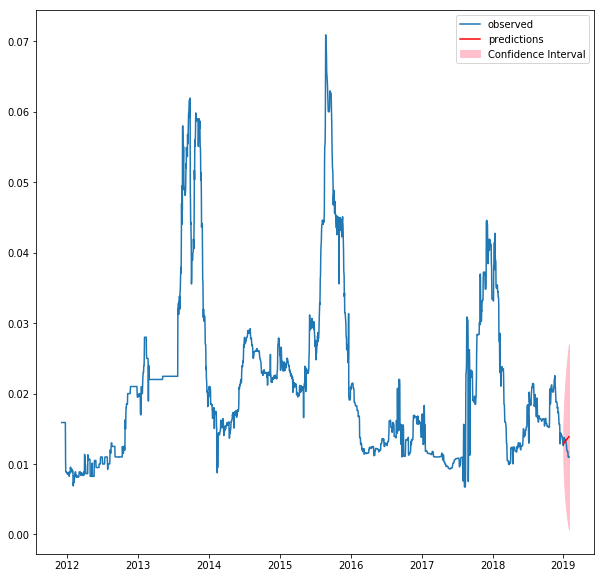

In [55]:
dynamic_forecast_30_days = results.get_forecast(30, alpha=0.05)  # 95% conf

#Mean of forecast
mean_forecast_30_days = dynamic_forecast_30_days.predicted_mean

#Confidence intervals
confidence_intervals_30_days = dynamic_forecast_30_days.conf_int()

lower_limits_30_days = [i[0] for i in confidence_intervals_30_days]
upper_limits_30_days = [i[1] for i in confidence_intervals_30_days]

#Plot the graph
dates = df_temp[:-60].index
dates_2 = dates[-30:]

plt.figure(figsize=(10,10))
plt.plot(dates,df_temp[:-60]['Normalized Price'].values, label='observed')
plt.plot(dates_2,mean_forecast_30_days,color='red', label='predictions')
plt.fill_between(dates_2,lower_limits_30_days,upper_limits_30_days,color='pink',label='Confidence Interval')
plt.legend(loc='best')

In [56]:
cost_price_predictions = mean_forecast_30_days*1000
mae = mean_absolute_error(df_temp[-90:-60]['cp'],cost_price_predictions)
print("MAE:",mae)

MAPE_diff = diff_csv_mape(df_temp[-90:-60]['cp'],cost_price_predictions)
#print(MAPE_diff)
mape_sum = np.sum(MAPE_diff)
MAPE = mape_sum/30
print("MAPE:",MAPE)

MAE: 1.1591208597078841
MAPE: 0.09893900559876254


## With CPI, Rainfall and Temperature

In [34]:
#Reading the dataset
dirpath = '/Users/vegi/Documents/USC_Masters/ML/DemandForecasts'
filename = '/Users/vegi/Documents/USC_Masters/ML/DemandForecasts/df_final.csv'
df = pd.read_csv(filename,parse_dates=['Date'],index_col='Date')

In [35]:
df.head()

,source_sku_id,sku_description,cp,Normalized Price,PROD_GROUP
Date,,,,,
2011-12-03,10000148,Fresho onion 1 kg,15.89,0.01589,onion
2011-12-04,10000148,Fresho onion 1 kg,15.89,0.01589,onion
2011-12-05,10000148,Fresho onion 1 kg,15.89,0.01589,onion
2011-12-06,10000148,Fresho onion 1 kg,15.89,0.01589,onion
2011-12-07,10000148,Fresho onion 1 kg,15.89,0.01589,onion


### Reading CPI

In [36]:
#Reading the CPI dataset
filename = dirpath+'/india_cpi_vegetables.csv'
df_cpi = pd.read_csv(filename,parse_dates=['year_month_ID'],index_col='year_month_ID',usecols=['CPI_FB_Vegetables','year_month_ID'])
df_cpi.head()

,CPI_FB_Vegetables
year_month_ID,
2011-12-01,87.6
2012-01-01,84.9
2012-02-01,86.5
2012-03-01,91.7
2012-04-01,98.7


### Reading Rainfall/Temperature

In [37]:
filename = dirpath+'/blr_rainfall_temp.csv'
df_rainfall = pd.read_csv(filename,parse_dates=['year_month_ID'],index_col='year_month_ID')
df_rainfall.head()

,temp_avg_max,temp_avg_min,rainfall(mm)
year_month_ID,,,
2011-12-01,26.40,13.60,3.000000
2012-01-01,27.80,13.20,0.000000
2012-02-01,30.14,16.05,0.083333
2012-03-01,34.24,20.46,23.120000
2012-04-01,34.04,20.92,18.670000


In [38]:
#Creating another dataframe to store data from all the above three datasetsa(SKUs,Rainfall and CPI) in a single dataframe
df_all = df.copy()
cpi_columns = list(df_cpi.columns)
rain_columns = list(df_rainfall.columns)

In [39]:
print("Columns in CPI dataframe:\n",cpi_columns)
print("\nColumns in Rainfall dataframe:\n",rain_columns)

columns_add = cpi_columns.copy()
columns_add.extend(rain_columns)

df_add = pd.DataFrame(None,columns=columns_add)
#df_add.head()

Columns in CPI dataframe:
 ['CPI_FB_Vegetables']

Columns in Rainfall dataframe:
 ['temp_avg_max', 'temp_avg_min', 'rainfall(mm)']


In [40]:
df_all = pd.concat([df_all,df_add],axis=1)
df_all.head(5)

,source_sku_id,sku_description,cp,Normalized Price,PROD_GROUP,CPI_FB_Vegetables,temp_avg_max,temp_avg_min,rainfall(mm)
2011-12-03,10000148,Fresho onion 1 kg,15.89,0.01589,onion,NaN,NaN,NaN,NaN
2011-12-04,10000148,Fresho onion 1 kg,15.89,0.01589,onion,NaN,NaN,NaN,NaN
2011-12-05,10000148,Fresho onion 1 kg,15.89,0.01589,onion,NaN,NaN,NaN,NaN
2011-12-06,10000148,Fresho onion 1 kg,15.89,0.01589,onion,NaN,NaN,NaN,NaN
2011-12-07,10000148,Fresho onion 1 kg,15.89,0.01589,onion,NaN,NaN,NaN,NaN


In [41]:
for i,observation in df_cpi.iterrows():
    #Obtaining year and month of the index in CPI dataframe
    year = i.year
    month = i.month
    if year==2019 and month ==4:
        break
    #Obtaining the value to copy
    value_copy = df_cpi.loc[(df_cpi.index.year==year)&(df_cpi.index.month==month),cpi_columns].values[0]
    #Obtaining number of observations
    number_of_observations = len(df_all.loc[(df_all.index.year==year)&(df_all.index.month==month),cpi_columns])
    #Creating a list to copy
    values = list(value_copy)*number_of_observations
    #Copying values
    df_all.loc[(df_all.index.year==year)&(df_all.index.month==month),cpi_columns] = values

In [42]:
df_all.head()

,source_sku_id,sku_description,cp,Normalized Price,PROD_GROUP,CPI_FB_Vegetables,temp_avg_max,temp_avg_min,rainfall(mm)
2011-12-03,10000148,Fresho onion 1 kg,15.89,0.01589,onion,87.6,NaN,NaN,NaN
2011-12-04,10000148,Fresho onion 1 kg,15.89,0.01589,onion,87.6,NaN,NaN,NaN
2011-12-05,10000148,Fresho onion 1 kg,15.89,0.01589,onion,87.6,NaN,NaN,NaN
2011-12-06,10000148,Fresho onion 1 kg,15.89,0.01589,onion,87.6,NaN,NaN,NaN
2011-12-07,10000148,Fresho onion 1 kg,15.89,0.01589,onion,87.6,NaN,NaN,NaN


In [43]:
for i,observation in df_rainfall.iterrows():      
    #Obtaining year and month of the index in Rainfall dataframe
    year = i.year
    month = i.month
    if year==2019 and month ==4:
        break
    #Obtaining the value to copy
    value_copy = df_rainfall.loc[(df_rainfall.index.year==year)&(df_rainfall.index.month==month),rain_columns].values[0]
    #Obtaining number of observations
    number_of_observations = len(df_all.loc[(df_all.index.year==year)&(df_all.index.month==month),rain_columns])
    #Creating a list to copy
    values = [list(value_copy) for i in range(number_of_observations)]
    df_all.loc[(df_all.index.year==year)&(df_all.index.month==month),rain_columns] = values

In [44]:
df_all.head()

,source_sku_id,sku_description,cp,Normalized Price,PROD_GROUP,CPI_FB_Vegetables,temp_avg_max,temp_avg_min,rainfall(mm)
2011-12-03,10000148,Fresho onion 1 kg,15.89,0.01589,onion,87.6,26.4,13.6,3
2011-12-04,10000148,Fresho onion 1 kg,15.89,0.01589,onion,87.6,26.4,13.6,3
2011-12-05,10000148,Fresho onion 1 kg,15.89,0.01589,onion,87.6,26.4,13.6,3
2011-12-06,10000148,Fresho onion 1 kg,15.89,0.01589,onion,87.6,26.4,13.6,3
2011-12-07,10000148,Fresho onion 1 kg,15.89,0.01589,onion,87.6,26.4,13.6,3


In [45]:
df_all = df_all.astype({'CPI_FB_Vegetables': 'float64','temp_avg_max': 'float64','temp_avg_min': 'float64','rainfall(mm)': 'float64'})
df_all.dtypes

source_sku_id          int64
sku_description       object
cp                   float64
Normalized Price     float64
PROD_GROUP            object
CPI_FB_Vegetables    float64
temp_avg_max         float64
temp_avg_min         float64
rainfall(mm)         float64
dtype: object

### Testing on a single product

In [46]:
columns_needed = ['cp','Normalized Price','PROD_GROUP', 'CPI_FB_Vegetables', 'temp_avg_max', 'temp_avg_min','rainfall(mm)']

temp_df_exog = df_all[df_all['PROD_GROUP']=='potato'].loc[:,columns_needed].copy()
temp_df_exog.head()

,cp,Normalized Price,PROD_GROUP,CPI_FB_Vegetables,temp_avg_max,temp_avg_min,rainfall(mm)
2011-12-03,11.48,0.01148,potato,87.6,26.4,13.6,3.0
2011-12-04,11.48,0.01148,potato,87.6,26.4,13.6,3.0
2011-12-05,11.48,0.01148,potato,87.6,26.4,13.6,3.0
2011-12-06,11.48,0.01148,potato,87.6,26.4,13.6,3.0
2011-12-07,11.48,0.01148,potato,87.6,26.4,13.6,3.0


### Augmented Dicky Fuller Test (Test for stationarity)

In [47]:
from statsmodels.tsa.stattools import adfuller

result = adfuller(temp_df_exog['Normalized Price'])
print("Augmented Dickyfuller Test Result:",result)

# Print test statistic
print("\n\nTest Statistic(More -ve, more stationary):",result[0])

# Print p-value
print("\n\nP-Value(If less than 0.05, reject null)",result[1])
print("Reject Null Hypothesis(Series is non-stationary):",result[1]<=0.05)

# Print critical values
print("\n\nCritical Values:",result[4]) 

Augmented Dickyfuller Test Result: (-3.1360593021866316, 0.023997194575536767, 22, 2653, {'1%': -3.432817259126433, '5%': -2.8626300496109773, '10%': -2.5673502709390714}, -29514.688547463247)


Test Statistic(More -ve, more stationary): -3.1360593021866316


P-Value(If less than 0.05, reject null) 0.023997194575536767
Reject Null Hypothesis(Series is non-stationary): True


Critical Values: {'1%': -3.432817259126433, '5%': -2.8626300496109773, '10%': -2.5673502709390714}


### Iterating over different values of p,d,q to find out which model best fits the data

In [ ]:
columns = ['CPI_FB_Vegetables', 'temp_avg_max', 'temp_avg_min','rainfall(mm)']
order_scores = []
trend_list = ['n','c','t','ct']
for p in range(4):
    for q in range(4):
        for d in range(3):
            for t in trend_list:
                try:
                    # Instantiate the model
                    #model = SARIMAX(y, order=(p,d,q))
                    model = SARIMAX(temp_df_exog[:-90]['Normalized Price'].values, order=(p,d,q),trend=t,exog=temp_df_exog[:-90][columns])

                    # Fit the model
                    results = model.fit()
                
                    #Prints results
                    order_scores.append((p,d,q,t,results.aic,results.bic))
        
                except:
                    print("In except")
                    continue
            
order_scores = pd.DataFrame(order_scores,columns=['p','d','q','trend','aic','bic'])

In [ ]:
order_scores.sort_values(by='aic').head()

In [46]:
# Instantiate the best model
model = SARIMAX(temp_df_exog[:-90]['Normalized Price'].values, order=(1,1,3),trend='n',exog=temp_df_exog[:-90][columns])
# Fit the model
results = model.fit()

# Print summary
print(results.summary())

# Generate predictions
one_step_forecast = results.get_prediction(start=-30)

# Extract prediction mean
mean_forecast = one_step_forecast.predicted_mean

# Get confidence intervals of predictions
confidence_intervals = one_step_forecast.conf_int()
#print(confidence_intervals)
# Select lower and upper confidence limits
lower_limits = confidence_intervals.loc[:,'lower y']
upper_limits = confidence_intervals.loc[:,'upper y']

/anaconda3/lib/python3.7/site-packages/statsmodels/tsa/base/tsa_model.py:165: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  % freq, ValueWarning)


                           Statespace Model Results                           
Dep. Variable:                      y   No. Observations:                 2586
Model:               SARIMAX(1, 1, 3)   Log Likelihood               14372.758
Date:                Mon, 21 Oct 2019   AIC                         -28727.517
Time:                        01:09:58   BIC                         -28674.799
Sample:                    12-03-2011   HQIC                        -28708.410
                         - 12-31-2018                                         
Covariance Type:                  opg                                         
                        coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------
CPI_FB_Vegetables -4.763e-08   1.59e-05     -0.003      0.998   -3.12e-05    3.12e-05
temp_avg_max      -4.799e-05   8.82e-05     -0.544      0.586      -0.000       0.000
temp_avg_min       -1.63

/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


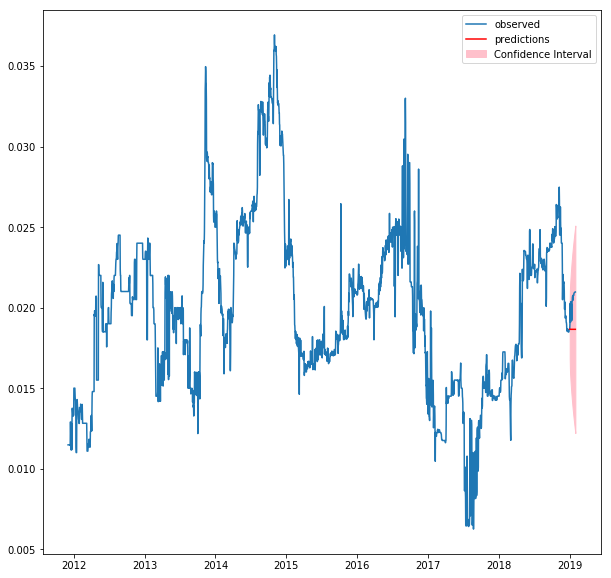

In [47]:
dynamic_forecast_30_days = results.get_forecast(30, alpha=0.05,exog =temp_df_exog[-90:-60][columns])  # 95% conf
#Mean of forecast
mean_forecast_30_days = dynamic_forecast_30_days.predicted_mean


#Confidence intervals
confidence_intervals_30_days = dynamic_forecast_30_days.conf_int()

# Select lower and upper confidence limits
lower_limits = confidence_intervals_30_days.loc[:,'lower y']
upper_limits = confidence_intervals_30_days.loc[:,'upper y']


#Plot the graph
dates = temp_df_exog[:-60].index
dates_2 = mean_forecast_30_days.index
plt.figure(figsize=(10,10))
plt.plot(dates,temp_df_exog[:-60]['Normalized Price'].values, label='observed')
plt.plot(dates_2,mean_forecast_30_days.values,color='red', label='predictions')
plt.fill_between(dates_2,lower_limits,upper_limits,color='pink',label='Confidence Interval')
plt.legend(loc='best')

In [48]:
temp_df_tail = temp_df_exog[-90:-60]
rmse = mean_squared_error(temp_df_tail['Normalized Price'],mean_forecast_30_days)
print("RMSE:",rmse)

print("RMSE on Actual Price:",rmse*1000)

RMSE: 3.3009477342140115e-06
RMSE on Actual Price: 0.0033009477342140115


In [49]:
cost_price_predictions = mean_forecast_30_days*1000
MAPE_diff = diff_csv_mape(temp_df_tail['cp'],cost_price_predictions)
#print(MAPE_diff)
mape_sum = np.sum(MAPE_diff)
MAPE = mape_sum/30
print("MAPE:",MAPE)

MAPE: 0.08168750172631581


### Extending to all products

In [50]:
def adf(y):
    result = adfuller(y)

    # Print test statistic
    print("\n\nTest Statistic(More -ve, more stationary):",result[0])

    # Print p-value
    print("\n\nP-Value(If less than 0.05, reject null)",result[1])
    p_value_bool = result[1]<=0.05
    print("Reject Null Hypothesis(Series is non-stationary):",result[1]<=0.05)

    return p_value_bool

### Function to plot decomposition plot
Decomposition plots provide a useful abstract model for thinking about time series generally and for better understanding problems during time series analysis and forecasting. It gives a clear picture of the tends, seasonality and the noise in the time series.

In [51]:
def plot_decomposition(y,name):
    rcParams['figure.figsize'] = 18, 8
    decomposition = sm.tsa.seasonal_decompose(y, model='additive')
    fig = decomposition.plot()
    plt.title(name)
    plt.show()

### Function to find the best model for a given time series

In [52]:
def find_best_model(df):
    order_scores = []
    for p in range(4):
        for q in range(4):
            for d in range(3):
                for t in trend_list:
                    try:
                        # Instantiate the model
                        #model = SARIMAX(y, order=(p,d,q))
                        model = SARIMAX(df[:-90]['Normalized Price'].values, order=(p,d,q),trend=t,exog =df[:-90][columns])
                        # Fit the model
                        results = model.fit()
                        #Obtain results
                        order_scores.append((p,d,q,t,results.aic,results.bic))
        
                    except:
                        print("CHECK")
                        continue
            
    order_scores = pd.DataFrame(order_scores,columns=['p','d','q','trend','aic','bic'])
    order_scores.sort_values('aic',inplace = True)
    
    p,d,q,trend,aic,bic = order_scores.iloc[0,0],order_scores.iloc[0,1],order_scores.iloc[0,2],order_scores.iloc[0,3],order_scores.iloc[0,4],order_scores.iloc[0,5]
    return p,d,q,trend,aic,bic

In [53]:
def SARIMAX_model(df,p,d,q,trend,name):
    # Instantiate the best model
    model = SARIMAX(df[:-90]['Normalized Price'].values, order=(p,d,q),trend=trend,exog =df[:-90][columns])

    # Fit the model
    results = model.fit()

    # Generate predictions
    dynamic_forecast_30_days = results.get_forecast(30, alpha=0.05,exog =df[-90:-60][columns])  # 95% conf

    # Extract prediction mean
    mean_forecast_30_days = dynamic_forecast_30_days.predicted_mean
    
    #print(mean_forecast)
    # Get confidence intervals of predictions
    confidence_intervals_30_days = dynamic_forecast_30_days.conf_int()
    # Select lower and upper confidence limits
    lower_limits_30_days = confidence_intervals_30_days.loc[:,'lower y']
    upper_limits_30_days = confidence_intervals_30_days.loc[:,'upper y']
    
    #Plot the graph
    dates = df[:-60].index
    dates_2 = mean_forecast_30_days.index
    plt.plot(dates,df[:-60]['Normalized Price'].values, label='observed')
    plt.plot(dates_2,mean_forecast_30_days,color='red', label='predictions')
    plt.fill_between(dates_2,lower_limits_30_days,upper_limits_30_days,color='pink',label='Confidence Interval')
    plt.legend(loc='best')
    plt.title("Projected price for:"+name)

### Iterating over all product groups and making calls to the aforementioned functions

In [ ]:
import warnings
warnings.filterwarnings('ignore')

list_summary = []

columns_needed = ['cp','Normalized Price','CPI_FB_Vegetables', 'temp_avg_max', 'temp_avg_min','rainfall(mm)']

columns = ['CPI_FB_Vegetables', 'temp_avg_max', 'temp_avg_min','rainfall(mm)']
count = len(prod_groups)
for prod in prod_groups:
    print("Product:",prod)
    
    temp_df_exog = df_all[df_all['PROD_GROUP']==prod].loc[:,columns_needed].copy()
    #Calling function to plot the decomposition plot
    plot_decomposition(temp_df_exog['Normalized Price'],prod)
        
    #Obtaining ADF Results
    adf(temp_df_exog['Normalized Price'])
    
    #Obtain best model
    
    p,d,q,trend,aic,bic = find_best_model(temp_df_exog)
    
    list_summary.append([prod,p,d,q,trend])
    print("Best Model:")
    print("p:",p)
    print("q:",q)
    print("d:",d)
    print("trend:",trend)
    
    SARIMAX_model(temp_df_exog,p,d,q,trend,prod)
    
    count = count-1
    print("Number of products left:",count)

In [ ]:
df_summary = pd.DataFrame(list_summary,columns=['product','p','d','q','trend'])

df_summary.style

In [ ]:
df_summary.to_csv("/Users/vegi/Documents/USC_Masters/ML/DemandForecasts/df_summary_rainfall_cpi_temperature.csv", sep=",", float_format='%.2f',index=False, line_terminator='\n',encoding='utf-8')

In [55]:
filename = '/Users/vegi/Documents/USC_Masters/ML/DemandForecasts/df_summary_rainfall_cpi_temperature.csv'
df_summary_cpi_rainfall_temperature = pd.read_csv(filename)

df_summary_cpi_rainfall_temperature

,product,p,d,q,trend
0,onion,2,1,2,n
1,banana yelakki,3,1,2,n
2,capsicum green,2,0,0,c
3,tomato hybrid,1,0,3,c
4,potato,1,1,3,n
5,cucumber english,2,1,1,n
6,cucumber,2,0,3,c
7,ridge gourd,0,1,3,n
8,ladies finger,1,0,2,c
9,banana robusta,3,1,3,n


## Forecasting values for all products

### Function to get model parameters

In [60]:
#This function picks up the p,d and q parameters from the df_summary dataframe
def get_pdq_cpi_rainfall_temperature(prod_group):
    if prod_group in list(df_summary_cpi_rainfall_temperature['product']):
        return df_summary_cpi_rainfall_temperature[df_summary_cpi_rainfall_temperature['product']==prod_group]['p'].item(),df_summary_cpi_rainfall_temperature[df_summary_cpi_rainfall_temperature['product']==prod_group]['d'].item(),df_summary_cpi_rainfall_temperature[df_summary_cpi_rainfall_temperature['product']==prod_group]['q'].item(),df_summary_cpi_rainfall_temperature[df_summary_cpi_rainfall_temperature['product']==prod_group]['trend'].item()        

### Function to build the best model for a given SKU

In [68]:
def forecast_model_cpi_rainfall_temperature(df,p,d,q,trend,name):
    # Instantiate the best model
    model = SARIMAX(df[:-90]['Normalized Price'].values, order=(p,d,q),trend=trend,exog =df[:-90][columns])

    # Fit the model
    results = model.fit()

    # Generate predictions
    dynamic_forecast_30_days = results.get_forecast(30, alpha=0.05,exog =df[-90:-60][columns])  # 95% conf

    # Extract prediction mean
    mean_forecast_30_days = dynamic_forecast_30_days.predicted_mean
    
    #print(mean_forecast)
    # Get confidence intervals of predictions
    confidence_intervals_30_days = dynamic_forecast_30_days.conf_int()
    # Select lower and upper confidence limits
    lower_limits_30_days = confidence_intervals_30_days.loc[:,'lower y']
    upper_limits_30_days = confidence_intervals_30_days.loc[:,'upper y']
    
    #Plot the graph
    dates = df[:-60].index
    dates_2 = mean_forecast_30_days.index
    plt.plot(dates,df[:-60]['Normalized Price'].values, label='observed')
    plt.plot(dates_2,mean_forecast_30_days,color='red', label='predictions')
    plt.fill_between(dates_2,lower_limits_30_days,upper_limits_30_days,color='pink',label='Confidence Interval')
    plt.legend(loc='best')
    plt.title("Projected price for:"+name)

    return mean_forecast_30_days,dates_2

### Function to get the forecast

In [69]:
def get_forecast_cpi_rainfall_temperature(selected_sku,actual_prod):
    #Obtaining the normalizing factor for the SKU
    normalizing_factor_sku = dict_prod_factor[actual_prod]
    print("Normalizing factor:",normalizing_factor_sku)
    
    #Obtaining the product group
    sku_prod_group = get_prod_group(selected_sku)
    print("Product Group:",sku_prod_group)
    
    #Obtaining the model parameters
    p,d,q,trend = get_pdq_cpi_rainfall_temperature(sku_prod_group)
        
    #Printing Model parameters
    print("Model Parameters:")
    print("p:",p)
    print("d:",d)
    print("q:",q)
    print("trend:",trend)
    
    
    #Creating a dataframe with observations from a certain prodcut
    temp_df_exog = df_all[df_all['PROD_GROUP']==sku_prod_group].copy()

    number_of_observations = len(temp_df_exog)
    
    avg_price = np.average(temp_df_exog['cp'])
    
    print("Average Cost Price:",avg_price)
    #Calling function to plot the decomposition plot
    plot_decomposition(temp_df_exog['Normalized Price'],sku_prod_group)
    
    #Obtaining ADF Results
    adf(temp_df_exog['Normalized Price'])
    
    
    #print(temp_df_exog.tail())

    predictions,dates = forecast_model_cpi_rainfall_temperature(temp_df_exog,p,d,q,trend,sku_prod_group)

    #print("Predicted Normalized Price:",list(predictions))
    cost_price_predictions = np.array(predictions)/normalizing_factor_sku
    
    #print(predictions.values)
    #print(cost_price_predictions)

    
    actual_price = (temp_df_exog['Normalized Price'].iloc[-30:].values)/normalizing_factor_sku

    #print(number_of_observations)
    #print(avg_price)
    return cost_price_predictions,actual_price,dates,number_of_observations,avg_price

For SKU: Fresho onion 1 kg
Normalizing factor: 0.001
Product Group: onion
Model Parameters:
p: 2
d: 1
q: 2
trend: n
Average Cost Price: 20.82280269058296


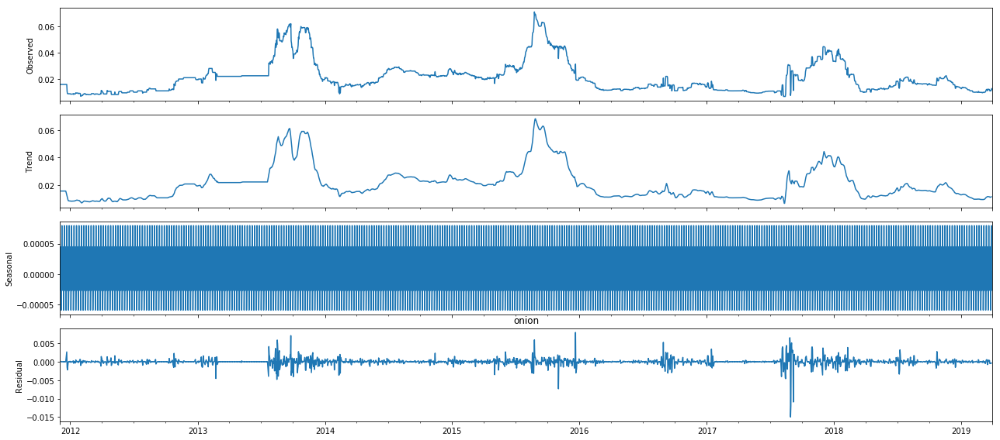



Test Statistic(More -ve, more stationary): -3.3018466841858274


P-Value(If less than 0.05, reject null) 0.014796129188200065
Reject Null Hypothesis(Series is non-stationary): True


/anaconda3/lib/python3.7/site-packages/statsmodels/tsa/base/tsa_model.py:165: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  % freq, ValueWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


RMSE: 3.9518796555148743
MAE: 1.7018060334709237




For SKU: Fresho banana-yelakki 1 kg
Normalizing factor: 0.001
Product Group: banana yelakki
Model Parameters:
p: 3
d: 1
q: 2
trend: n
Average Cost Price: 47.89713378176383


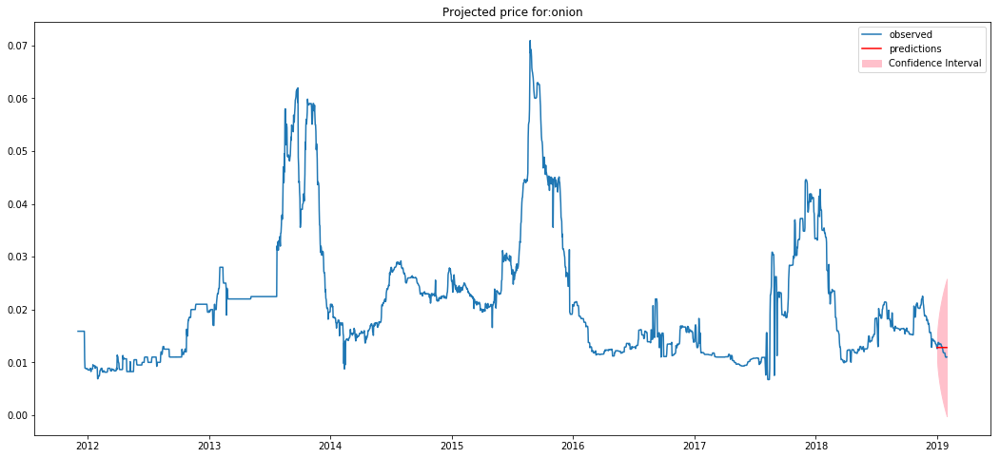

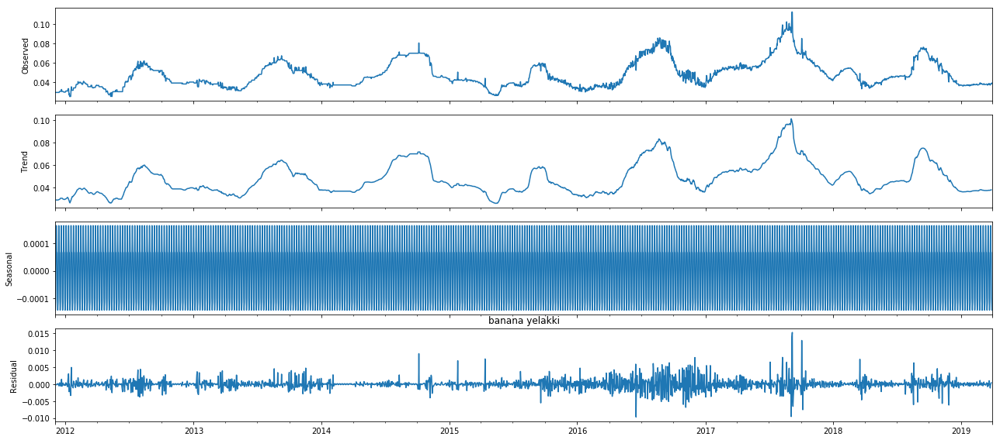



Test Statistic(More -ve, more stationary): -4.295456764777356


P-Value(If less than 0.05, reject null) 0.00045232867073604044
Reject Null Hypothesis(Series is non-stationary): True


/anaconda3/lib/python3.7/site-packages/statsmodels/tsa/base/tsa_model.py:165: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  % freq, ValueWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


RMSE: 1.6818717283138382
MAE: 1.1922221575583007




For SKU: Fresho capsicum-green 1 kg
Normalizing factor: 0.001
Product Group: capsicum green
Model Parameters:
p: 2
d: 0
q: 0
trend: c
Average Cost Price: 26.594613656822432


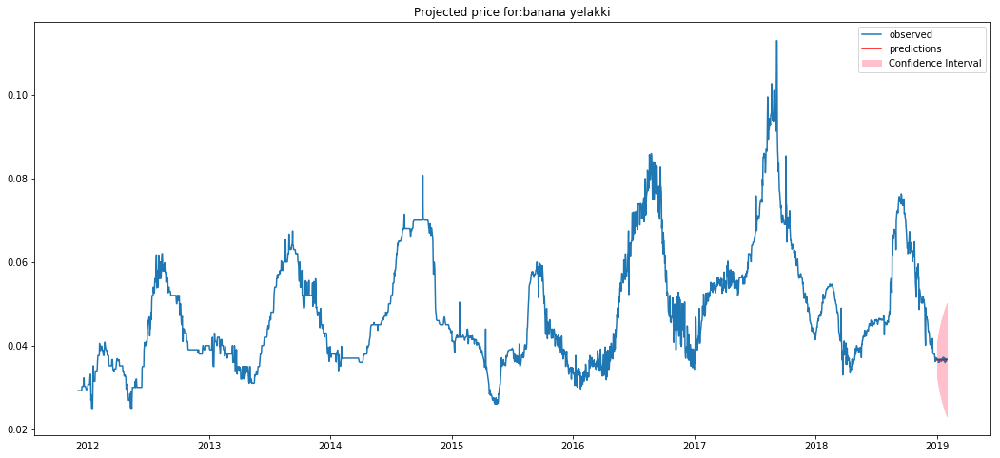

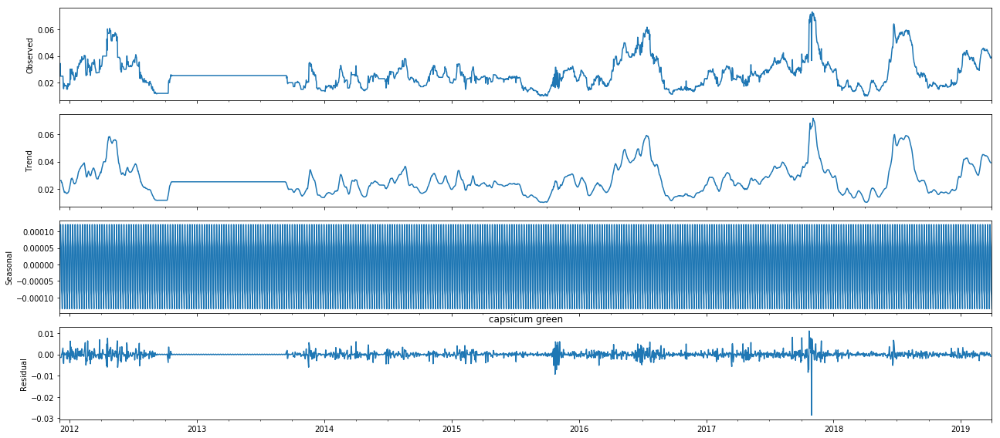



Test Statistic(More -ve, more stationary): -4.402134053525805


P-Value(If less than 0.05, reject null) 0.0002942619064309108
Reject Null Hypothesis(Series is non-stationary): True


/anaconda3/lib/python3.7/site-packages/statsmodels/tsa/base/tsa_model.py:165: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  % freq, ValueWarning)


RMSE: 270.42405647009286
MAE: 16.327592570437368




For SKU: Fresho tomato-hybrid 1 kg
Normalizing factor: 0.001
Product Group: tomato hybrid
Model Parameters:
p: 1
d: 0
q: 3
trend: c
Average Cost Price: 17.397107623318387


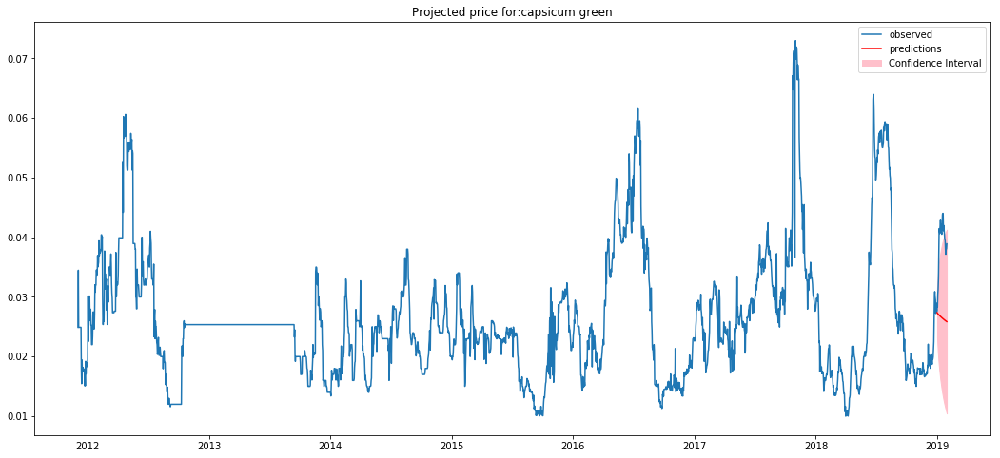

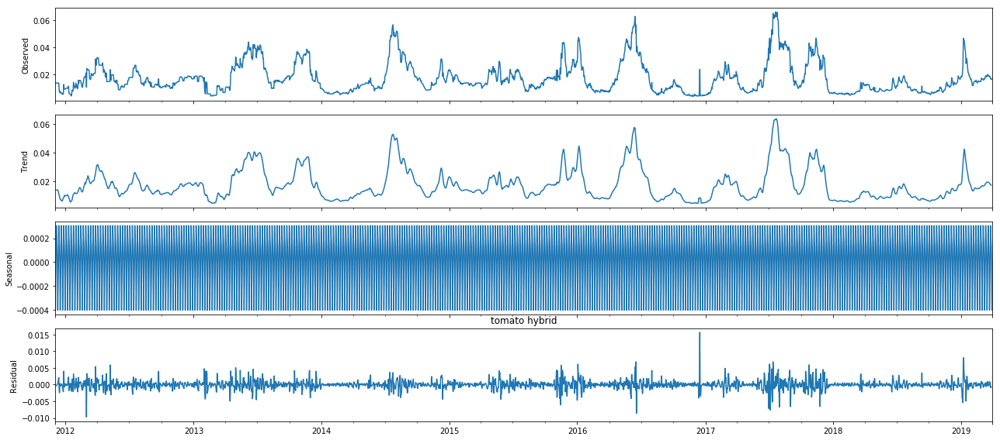



Test Statistic(More -ve, more stationary): -5.866996051572194


P-Value(If less than 0.05, reject null) 3.3075997435953514e-07
Reject Null Hypothesis(Series is non-stationary): True


/anaconda3/lib/python3.7/site-packages/statsmodels/tsa/base/tsa_model.py:165: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  % freq, ValueWarning)


RMSE: 1.5136277200558186
MAE: 1.100044341532784




For SKU: Fresho potato 1 kg
Normalizing factor: 0.001
Product Group: potato
Model Parameters:
p: 1
d: 1
q: 3
trend: n
Average Cost Price: 19.79313527653214


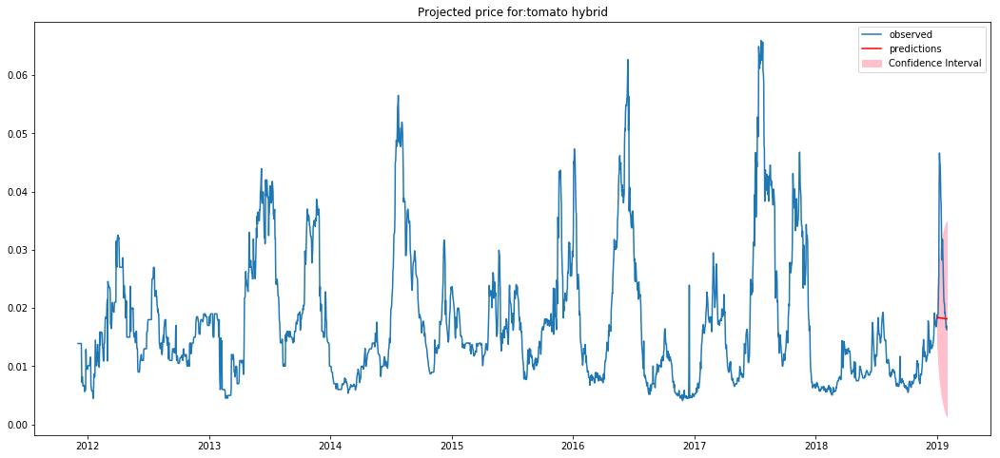

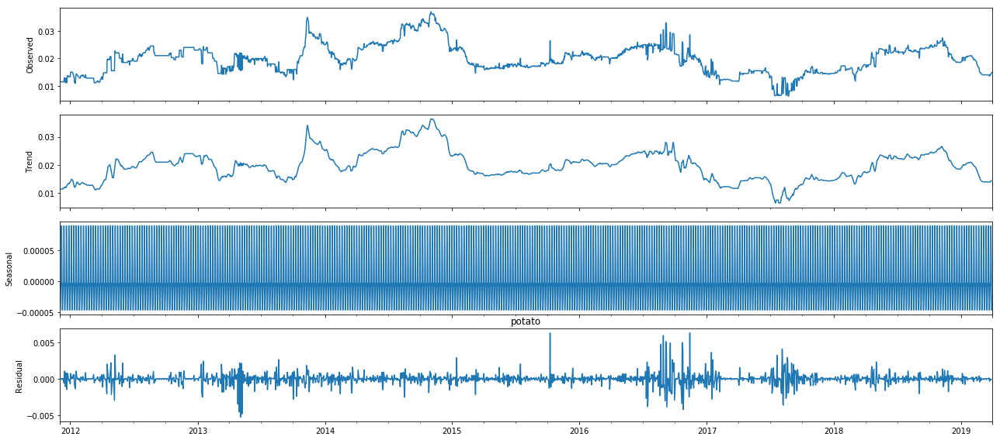



Test Statistic(More -ve, more stationary): -3.1360593021866316


P-Value(If less than 0.05, reject null) 0.023997194575536767
Reject Null Hypothesis(Series is non-stationary): True


/anaconda3/lib/python3.7/site-packages/statsmodels/tsa/base/tsa_model.py:165: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  % freq, ValueWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


RMSE: 20.83021813262702
MAE: 4.55415229100164




For SKU: Fresho cucumber-english 1 kg
Normalizing factor: 0.001
Product Group: cucumber english
Model Parameters:
p: 2
d: 1
q: 1
trend: n
Average Cost Price: 26.788165720405342


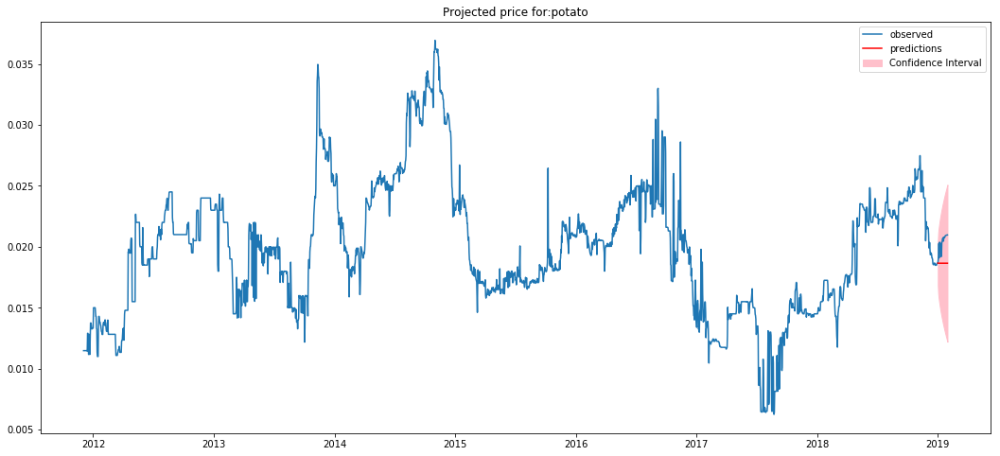

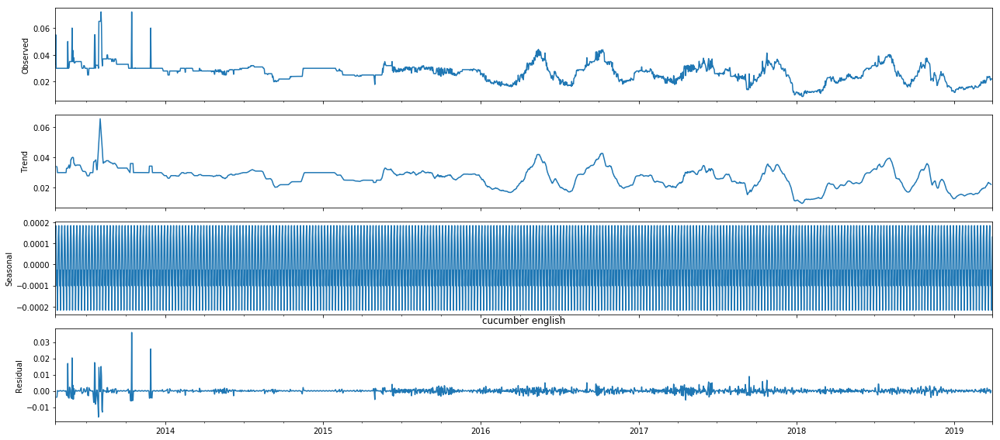



Test Statistic(More -ve, more stationary): -5.314505912662669


P-Value(If less than 0.05, reject null) 5.109253114512109e-06
Reject Null Hypothesis(Series is non-stationary): True


/anaconda3/lib/python3.7/site-packages/statsmodels/tsa/base/tsa_model.py:165: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  % freq, ValueWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


RMSE: 63.29001727681123
MAE: 7.710777059532506




For SKU: Fresho cucumber 1 kg
Normalizing factor: 0.001
Product Group: cucumber
Model Parameters:
p: 2
d: 0
q: 3
trend: c
Average Cost Price: 12.502497093796713


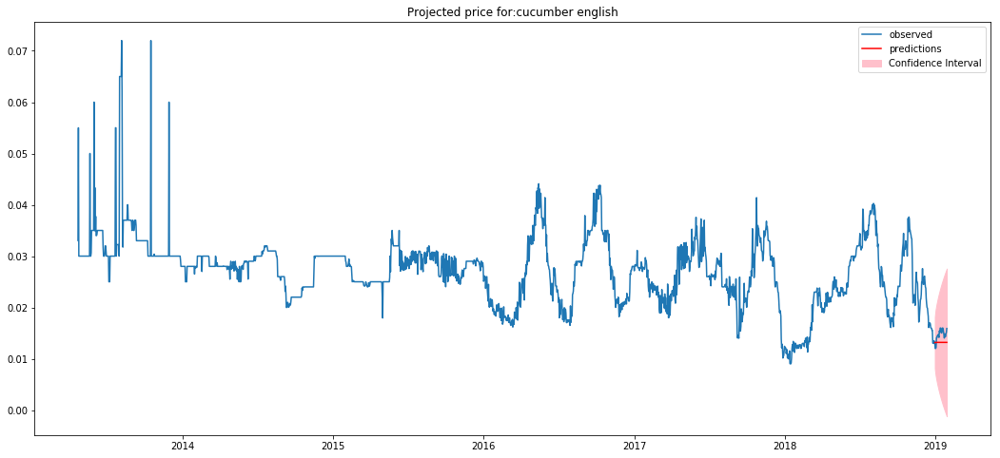

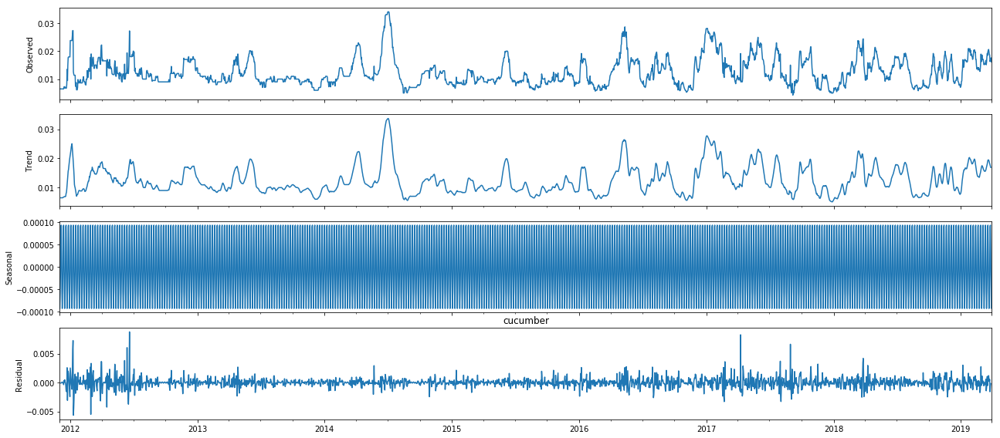



Test Statistic(More -ve, more stationary): -7.459873991172547


P-Value(If less than 0.05, reject null) 5.389147875862422e-11
Reject Null Hypothesis(Series is non-stationary): True


/anaconda3/lib/python3.7/site-packages/statsmodels/tsa/base/tsa_model.py:165: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  % freq, ValueWarning)


RMSE: 72.57864275940577
MAE: 8.364636700205075




For SKU: Fresho ridge-gourd 1 kg
Normalizing factor: 0.001
Product Group: ridge gourd
Model Parameters:
p: 0
d: 1
q: 3
trend: n
Average Cost Price: 20.224641533632287


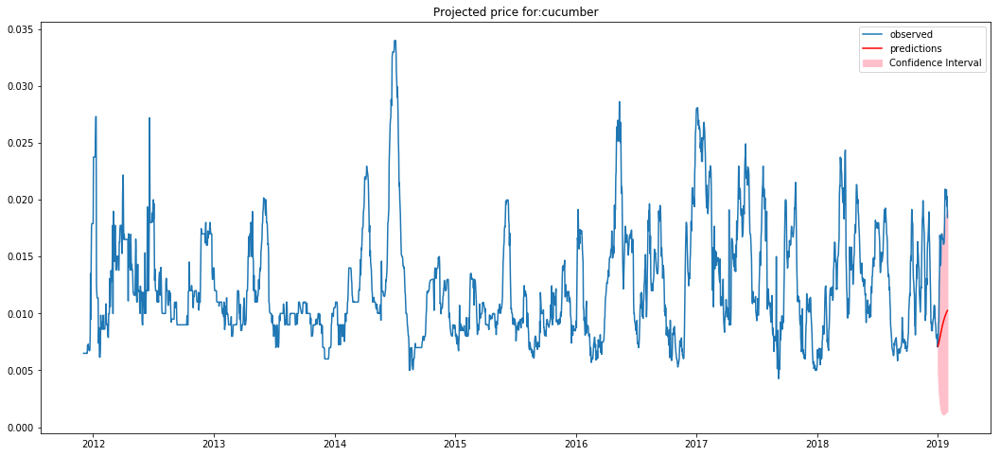

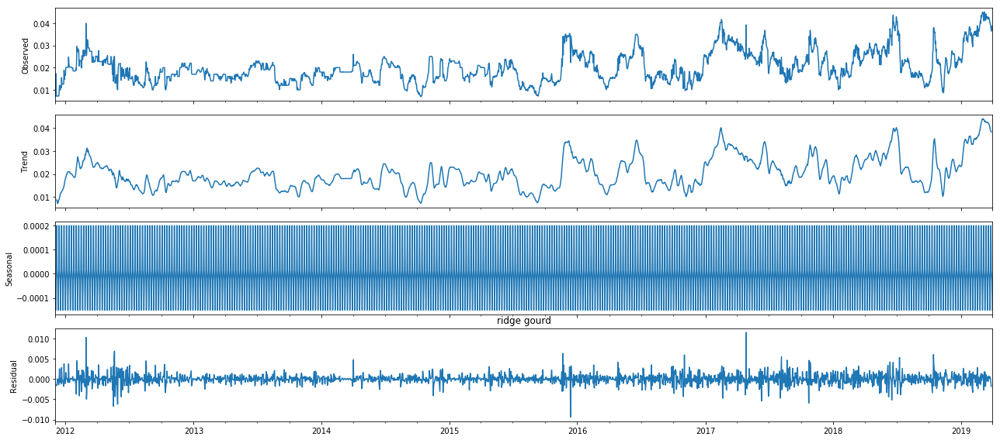



Test Statistic(More -ve, more stationary): -3.942627422861216


P-Value(If less than 0.05, reject null) 0.0017425936088421507
Reject Null Hypothesis(Series is non-stationary): True


/anaconda3/lib/python3.7/site-packages/statsmodels/tsa/base/tsa_model.py:165: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  % freq, ValueWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


RMSE: 322.19620771731894
MAE: 17.796977105160696




For SKU: Fresho ladies-finger 1 kg
Normalizing factor: 0.001
Product Group: ladies finger
Model Parameters:
p: 1
d: 0
q: 2
trend: c
Average Cost Price: 24.198768371214953


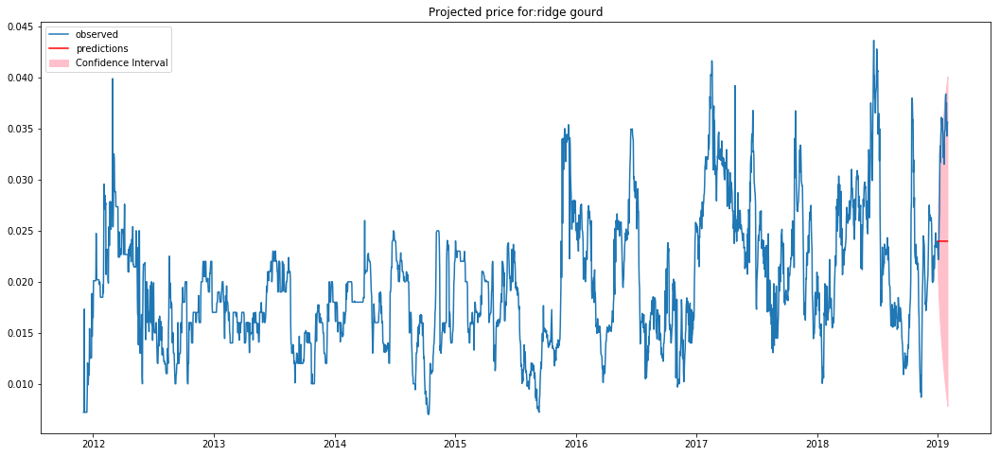

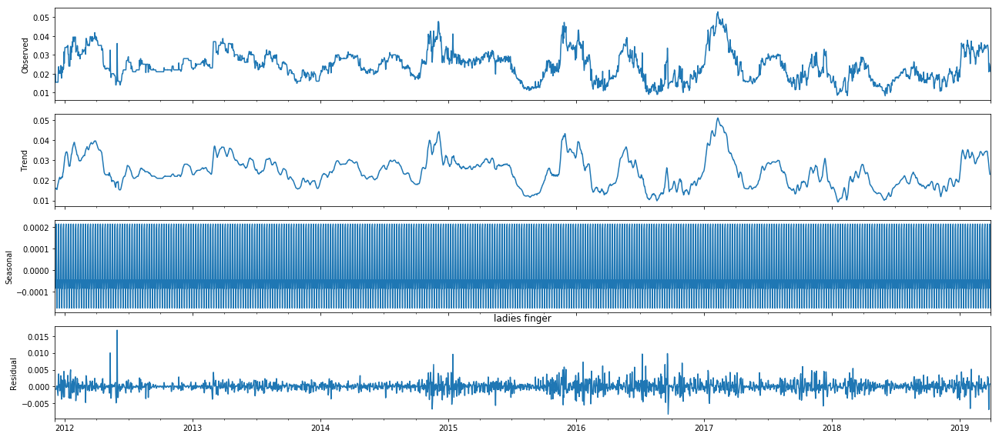



Test Statistic(More -ve, more stationary): -5.389884640255018


P-Value(If less than 0.05, reject null) 3.5569059145509054e-06
Reject Null Hypothesis(Series is non-stationary): True


/anaconda3/lib/python3.7/site-packages/statsmodels/tsa/base/tsa_model.py:165: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  % freq, ValueWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


RMSE: 106.98491944188633
MAE: 9.34472184393865




For SKU: Fresho banana-robusta 1 kg
Normalizing factor: 0.001
Product Group: banana robusta
Model Parameters:
p: 3
d: 1
q: 3
trend: n
Average Cost Price: 21.828481673644863


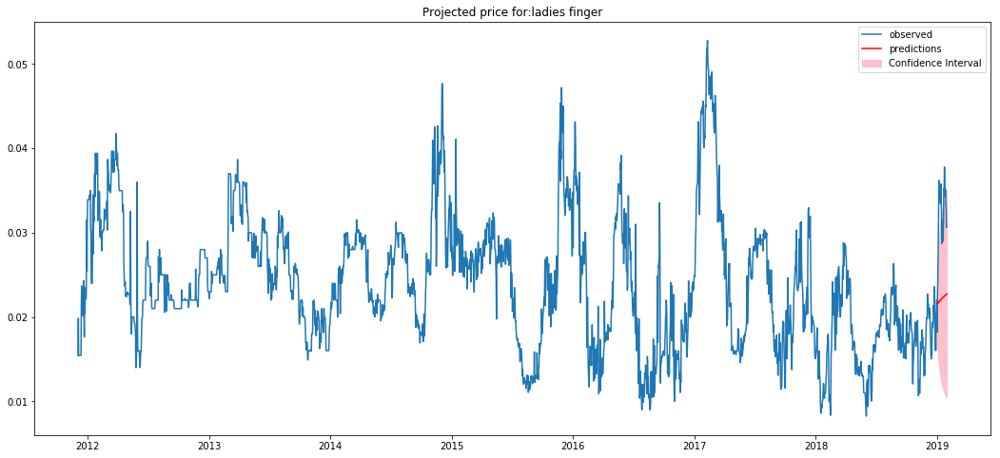

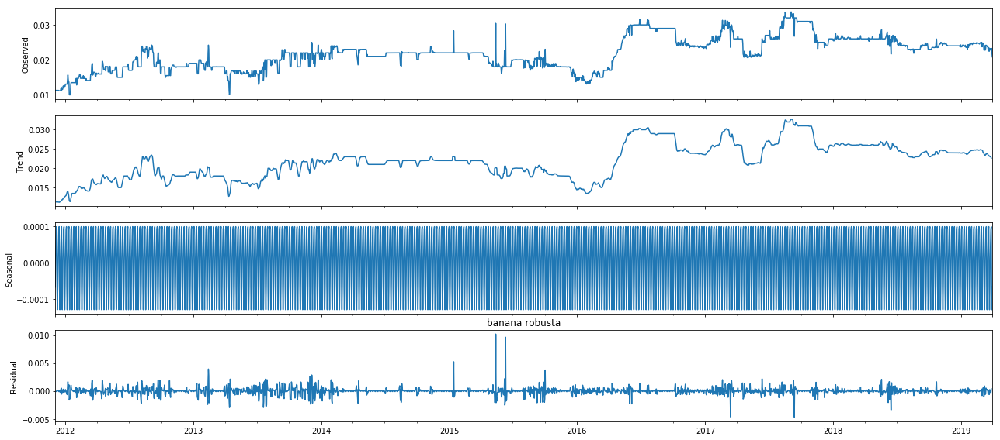



Test Statistic(More -ve, more stationary): -2.892951827629298


P-Value(If less than 0.05, reject null) 0.04617376439790287
Reject Null Hypothesis(Series is non-stationary): True


/anaconda3/lib/python3.7/site-packages/statsmodels/tsa/base/tsa_model.py:165: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  % freq, ValueWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


RMSE: 1.228767927927282
MAE: 0.8789645472852788




For SKU: Fresho tomato-local 1 kg
Normalizing factor: 0.001
Product Group: tomato local
Model Parameters:
p: 3
d: 1
q: 2
trend: n
Average Cost Price: 17.92701054147982


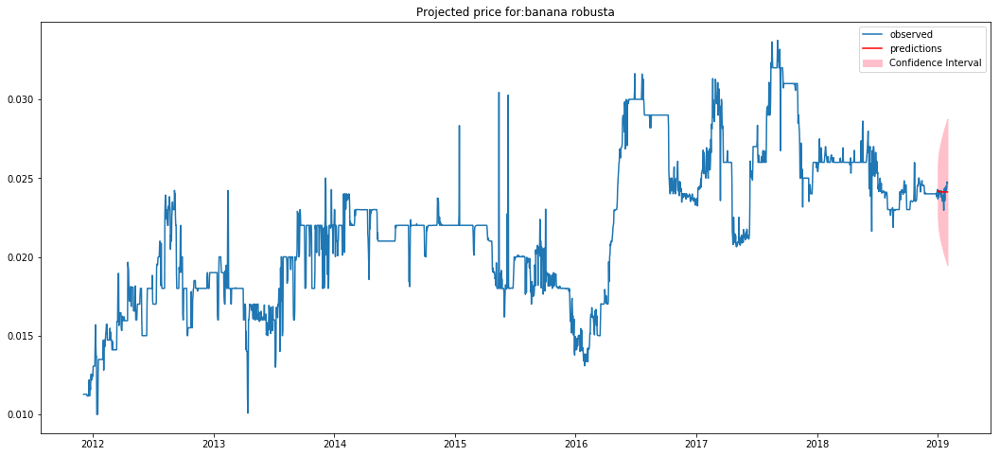

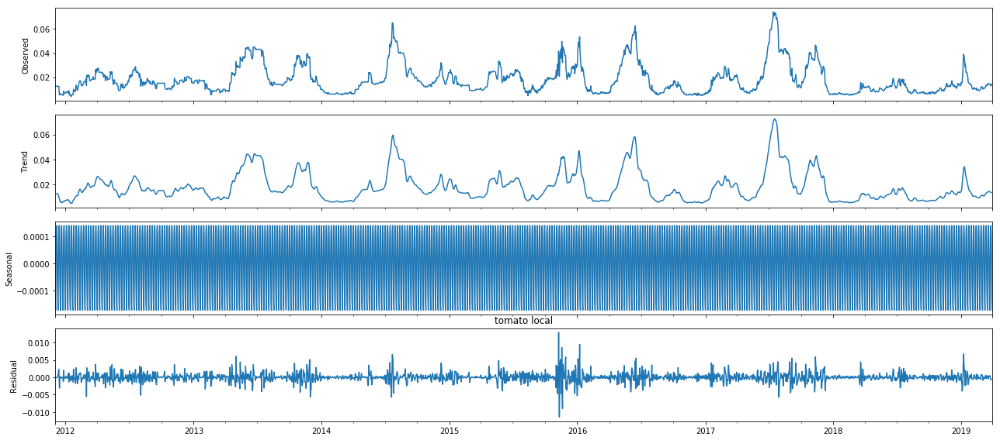



Test Statistic(More -ve, more stationary): -5.480300431288646


P-Value(If less than 0.05, reject null) 2.2923129533752914e-06
Reject Null Hypothesis(Series is non-stationary): True


/anaconda3/lib/python3.7/site-packages/statsmodels/tsa/base/tsa_model.py:165: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  % freq, ValueWarning)


RMSE: 2.1348767513639815
MAE: 1.1850075630841939




For SKU: Fresho bottle-gourd 1 kg
Normalizing factor: 0.001
Product Group: bottle gourd
Model Parameters:
p: 1
d: 0
q: 3
trend: n
Average Cost Price: 13.242073770553066


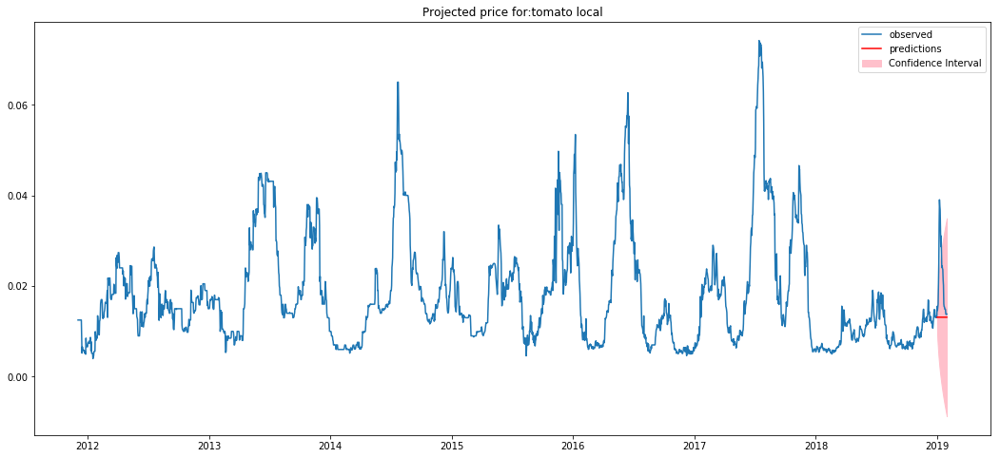

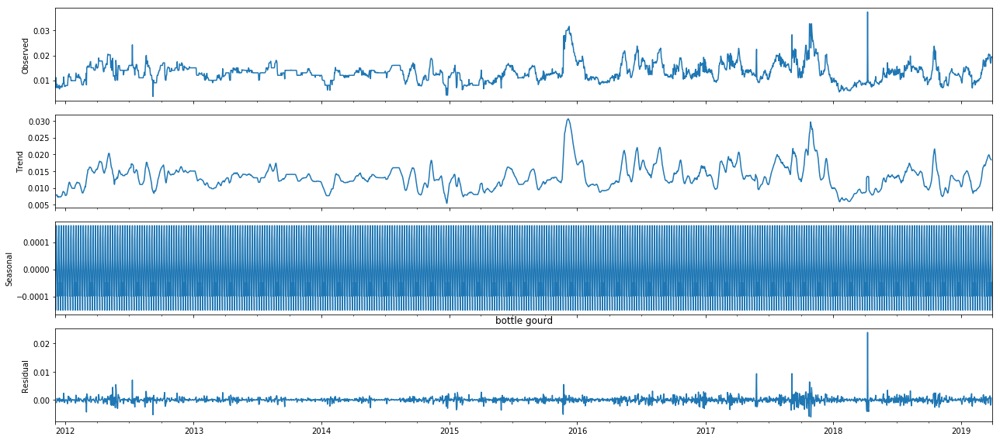



Test Statistic(More -ve, more stationary): -7.585925326878383


P-Value(If less than 0.05, reject null) 2.6069274206656233e-11
Reject Null Hypothesis(Series is non-stationary): True


/anaconda3/lib/python3.7/site-packages/statsmodels/tsa/base/tsa_model.py:165: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  % freq, ValueWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


RMSE: 44.21647441104025
MAE: 6.4418279978188515




For SKU: Fresho watermelon-small 1 pc  1.7 - 2.5 kg
Normalizing factor: 1.0
Product Group: watermelon small
Model Parameters:
p: 2
d: 0
q: 3
trend: c
Average Cost Price: 22.972105731315395


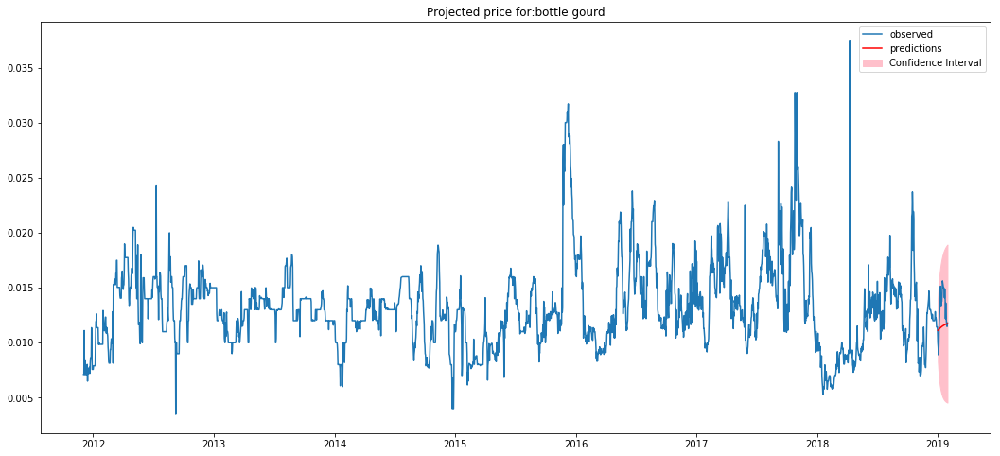

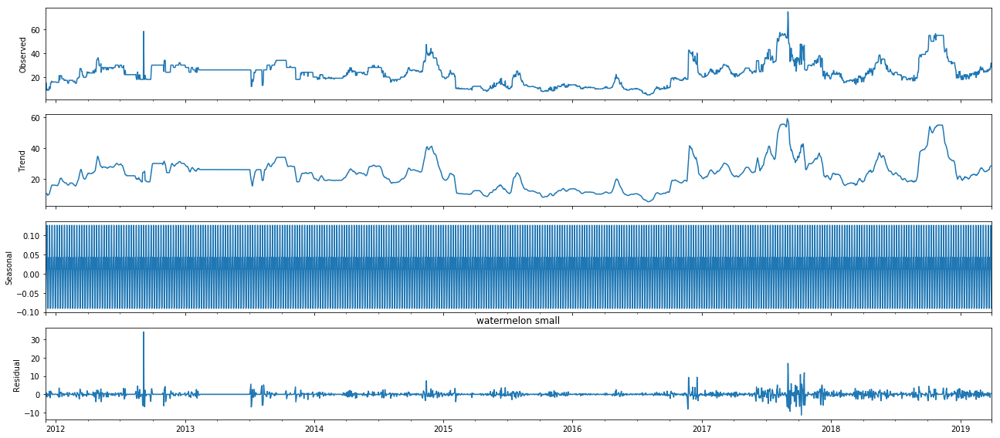



Test Statistic(More -ve, more stationary): -3.932587648800317


P-Value(If less than 0.05, reject null) 0.001807688326800827
Reject Null Hypothesis(Series is non-stationary): True


/anaconda3/lib/python3.7/site-packages/statsmodels/tsa/base/tsa_model.py:165: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  % freq, ValueWarning)


RMSE: 8.5964307672583
MAE: 2.3015904168559453




For SKU: Fresho beetroot 1 kg
Normalizing factor: 0.001
Product Group: beetroot
Model Parameters:
p: 2
d: 1
q: 1
trend: n
Average Cost Price: 19.203162278400598


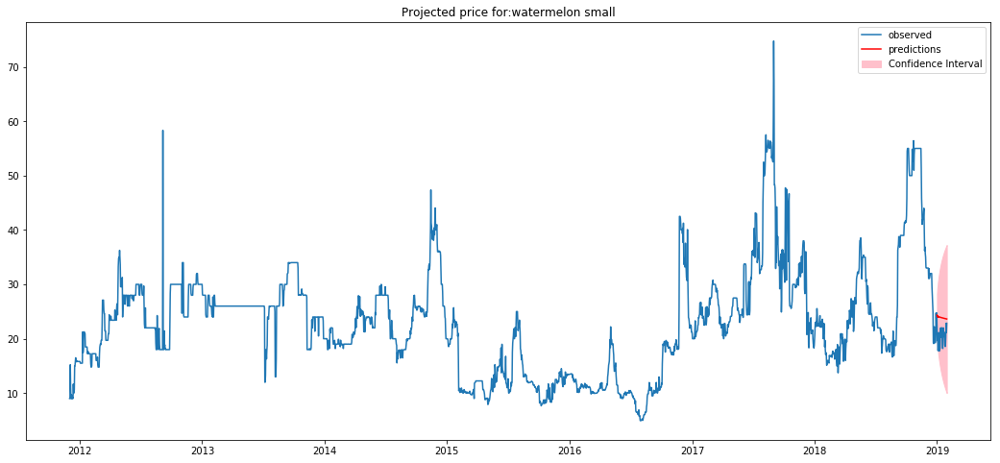

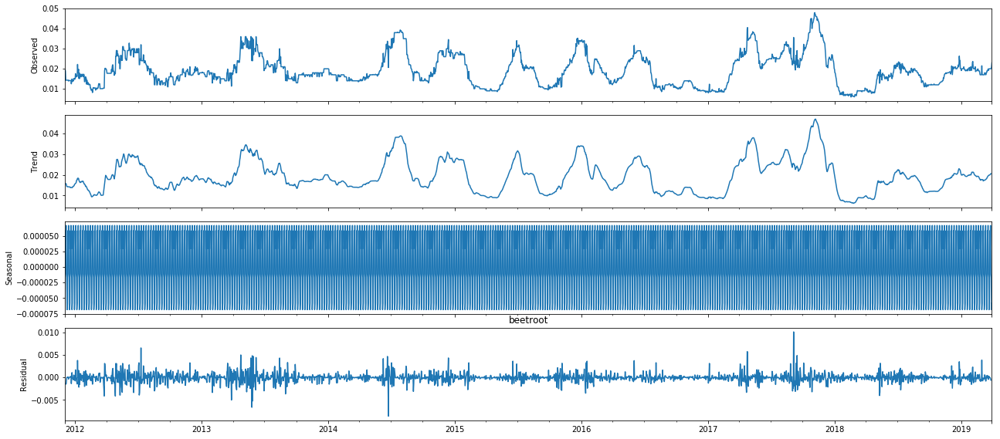



Test Statistic(More -ve, more stationary): -5.546773918182153


P-Value(If less than 0.05, reject null) 1.654053728045891e-06
Reject Null Hypothesis(Series is non-stationary): True


/anaconda3/lib/python3.7/site-packages/statsmodels/tsa/base/tsa_model.py:165: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  % freq, ValueWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


RMSE: 4.897253524417618
MAE: 1.8467196245239523




For SKU: Fresho carrot-local 1 kg
Normalizing factor: 0.001
Product Group: carrot local
Model Parameters:
p: 3
d: 0
q: 2
trend: c
Average Cost Price: 32.49028351569507


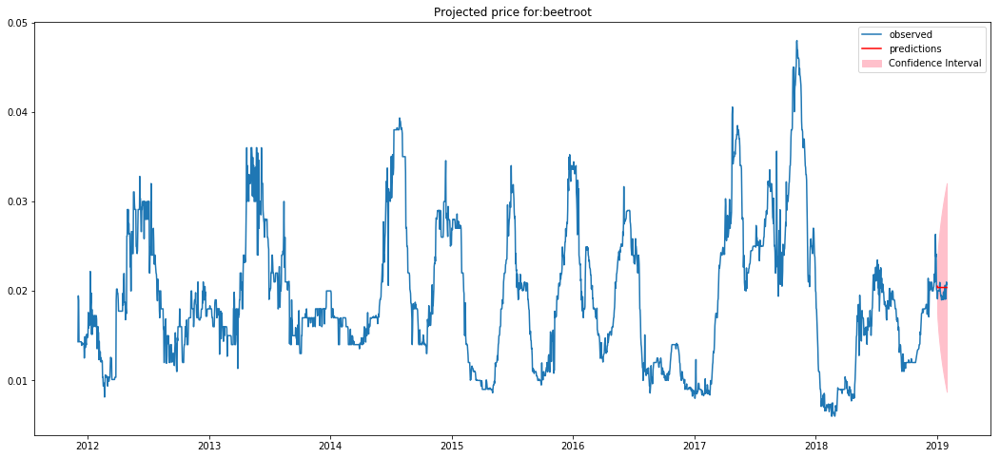

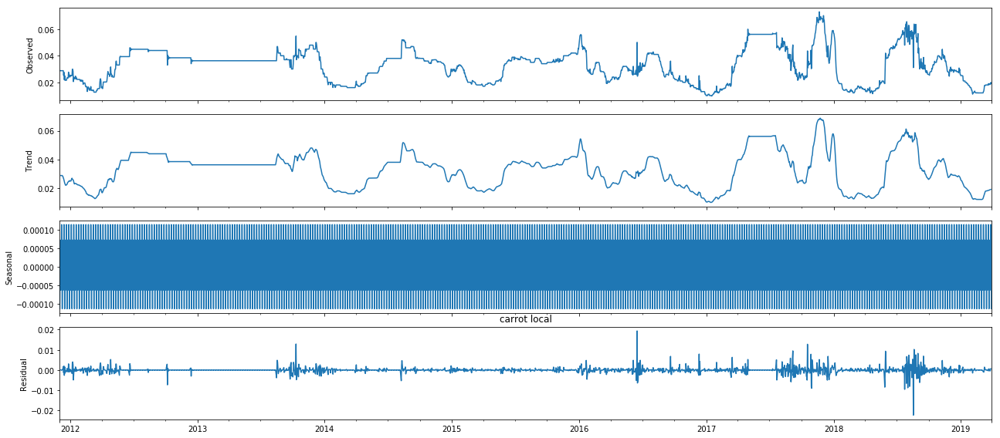



Test Statistic(More -ve, more stationary): -4.685255269390687


P-Value(If less than 0.05, reject null) 8.968684775088775e-05
Reject Null Hypothesis(Series is non-stationary): True


/anaconda3/lib/python3.7/site-packages/statsmodels/tsa/base/tsa_model.py:165: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  % freq, ValueWarning)


RMSE: 113.09653077865082
MAE: 10.395074282263826






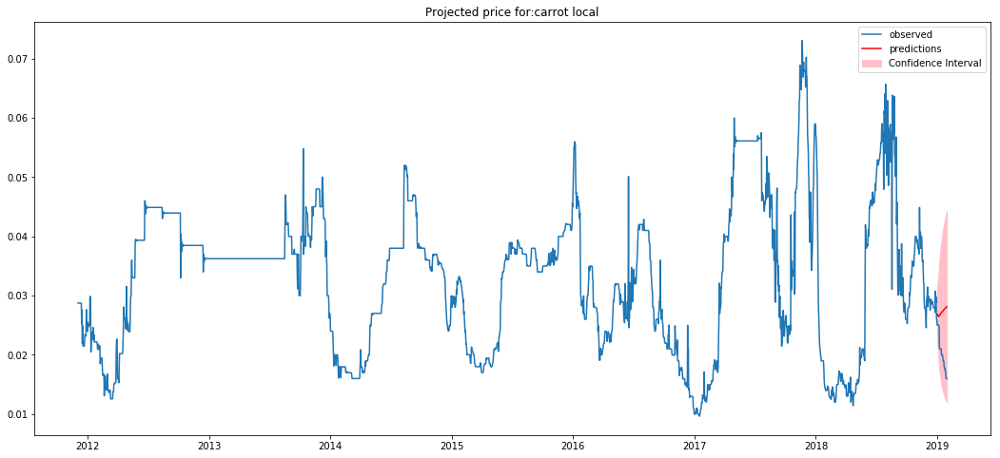

In [70]:
#List to store SKU names of all SKUs for which model has been built
SKU_list = []
#List to store predicted prices of all SKUs for which model has been built
predicted_prices = []
#List to store actual prices of all SKUs for which model has been built
actual_prices = []
#List to store RMSE scores of all SKUs for which model has been built
RMSE_scores = []
#List to store MAE scores of all SKUs for which model has been built
MAE_scores = []
#List to store last 30 dates of all SKUs for which model has been built
dates_list = []

num_observations = []

avg_prices = []

count = 0
#Iterating over all the SKUs
#Here, I've iterated over the product 'splits', as it makes it easier to obtain normalizing factor
for i,prod in enumerate(unique_products_split):
    #Storing the split priduct in a variable
    selected_sku = prod
    
    #Obtaining the actual name of the SKU
    actual_prod = unique_products[i]
    print("For SKU:",actual_prod)
    
    #Calling the method to obtain the forecast
    cost_price_predictions,actual_price,dates,number_of_observations,avg_price = get_forecast_cpi_rainfall_temperature(selected_sku,actual_prod)

    if len(cost_price_predictions) == 30:
        
        rmse = mean_squared_error(actual_price,cost_price_predictions)
        print("RMSE:",rmse)
        
        mae = mean_absolute_error(actual_price,cost_price_predictions)
        print("MAE:",mae)
        #Storing the last 30 dates of the SKU for which we have obtained the forecast
        dates_list.append(dates)
        #Storing the name of the SKU for which we have obtained the forecast
        SKU_list.append(actual_prod)
        #Storing the predicted prices of the SKU for which we have obtained the forecast
        predicted_prices.append(cost_price_predictions)
        #Storing the RMSE of the SKU for which we have obtained the forecast
        RMSE_scores.append(rmse)
        #Storing the MAE of the SKU for which we have obtained the forecast
        MAE_scores.append(mae)
        #Storing the actual price of the SKU for which we have obtained the forecast
        actual_prices.append(actual_price)
        
        num_observations.append(number_of_observations)
        
        avg_prices.append(avg_price)
    
    print('\n\n\n')

### Computing average 30 day SKU price

In [77]:
sku_avg_30_day_price = []
for sku in SKU_list:
    avg_price_sku = np.average((df_all[df_all['sku_description']==sku]['cp'][-90:-60]))
    sku_avg_30_day_price.append(avg_price_sku)

### Calculating MAPE

In [78]:
MAPE = []
for i,prices in enumerate(actual_prices):
    diff = abs((actual_prices[i] - predicted_prices[i])/(actual_prices[i]))
    sum_diff = np.sum(diff)
    MAPE.append(sum_diff/30)

In [81]:
normalized_rmse = (np.array(RMSE_scores)/np.array(sku_avg_30_day_price))
df_summary_cpi_rainfall_temperature_metrics = pd.DataFrame({'SKU':SKU_list,'RMSE':RMSE_scores,'Normalized RMSE':normalized_rmse,'Mean Absolute Error':MAE_scores,'Mean Absolute Percentage Error':MAPE,'Observations used':num_observations})
df_summary_cpi_rainfall_temperature_metrics.sort_values(by=['Mean Absolute Percentage Error'],ascending=True,inplace=True)
df_summary_cpi_rainfall_temperature_metrics.style

,SKU,RMSE,Normalized RMSE,Mean Absolute Error,Mean Absolute Percentage Error,Observations used
1,Fresho banana-yelakki 1 kg,1.68187,0.0459695,1.19222,0.0313585,2676
9,Fresho banana-robusta 1 kg,1.22877,0.051198,0.878965,0.0385711,2675
3,Fresho tomato-hybrid 1 kg,1.51363,0.0560105,1.10004,0.0625492,2676
12,Fresho watermelon-small 1 pc 1.7 - 2.5 kg,8.59643,0.422014,2.30159,0.0840083,2676
10,Fresho tomato-local 1 kg,2.13488,0.0972742,1.18501,0.0989044,2676
13,Fresho beetroot 1 kg,4.89725,0.247628,1.84672,0.103081,2676
0,Fresho onion 1 kg,3.95188,0.315645,1.70181,0.163288,2676
8,Fresho ladies-finger 1 kg,106.985,3.35264,9.34472,0.281344,2675
4,Fresho potato 1 kg,20.8302,1.02429,4.55415,0.323591,2676
11,Fresho bottle-gourd 1 kg,44.2165,3.37016,6.44183,0.353441,2676


In [82]:
df_summary_cpi_rainfall_temperature_metrics.to_csv("/Users/vegi/Documents/USC_Masters/ML/DemandForecasts/df_summary_cpi_rainfall_temperature_metrics.csv", sep=",", float_format='%.6f',index=False, line_terminator='\n',encoding='utf-8')

### Reading estimated parameters with seasonality

In [73]:
filename = '/Users/vegi/Documents/USC_Masters/ML/DemandForecasts/df_summary_seasonality.csv'
df_summary_seasonality = pd.read_csv(filename)

df_summary_seasonality

,product,p,d,q,ps,ds,qs,trend
0,onion,2,1,2,0,0,0,n
1,banana yelakki,2,1,2,0,0,0,n
2,capsicum green,0,0,0,1,0,1,c
3,tomato hybrid,1,0,0,0,0,0,c
4,potato,1,1,2,0,0,0,n
5,cucumber english,2,1,1,0,0,0,n
6,cucumber,2,0,1,1,0,0,c
7,ridge gourd,0,0,0,1,0,1,c
8,ladies finger,1,0,2,0,0,0,c
9,banana robusta,2,1,2,0,0,0,n


In [74]:
#This function picks up the p,d and q parameters from the df_summary dataframe
def get_pdq_seasonality(prod_group):
    if prod_group in list(df_summary_seasonality['product']):
        return df_summary_seasonality[df_summary_seasonality['product']==prod_group]['p'].item(),df_summary_seasonality[df_summary_seasonality['product']==prod_group]['d'].item(),df_summary_seasonality[df_summary_seasonality['product']==prod_group]['q'].item(),df_summary_seasonality[df_summary_seasonality['product']==prod_group]['ps'].item(),df_summary_seasonality[df_summary_seasonality['product']==prod_group]['ds'].item(),df_summary_seasonality[df_summary_seasonality['product']==prod_group]['qs'].item(),df_summary_seasonality[df_summary_seasonality['product']==prod_group]['trend'].item()

In [75]:
def forecast_model_seasonality(df,p,d,q,ps,ds,qs,trend,name):
    # Instantiate the best model
    model = SARIMAX(df[:-90]['Normalized Price'].values, order=(p,d,q),seasonal_order=(ps,ds,qs,0),trend=trend,exog =df[:-90][columns])

    # Fit the model
    results = model.fit()

    # Generate predictions
    dynamic_forecast_30_days = results.get_forecast(30, alpha=0.05,exog =df[-90:-60][columns])  # 95% conf

    # Extract prediction mean
    mean_forecast_30_days = dynamic_forecast_30_days.predicted_mean
    
    #print(mean_forecast)
    # Get confidence intervals of predictions
    confidence_intervals_30_days = dynamic_forecast_30_days.conf_int()
    # Select lower and upper confidence limits
    lower_limits_30_days = confidence_intervals_30_days.loc[:,'lower y']
    upper_limits_30_days = confidence_intervals_30_days.loc[:,'upper y']
    
    #Plot the graph
    dates = df[:-60].index
    dates_2 = mean_forecast_30_days.index
    plt.plot(dates,df[:-60]['Normalized Price'].values, label='observed')
    plt.plot(dates_2,mean_forecast_30_days,color='red', label='predictions')
    plt.fill_between(dates_2,lower_limits_30_days,upper_limits_30_days,color='pink',label='Confidence Interval')
    plt.legend(loc='best')
    plt.title("Projected price for:"+name)

    return mean_forecast_30_days,dates_2

In [76]:
def get_forecast_seasonality(selected_sku,actual_prod):
    #Obtaining the normalizing factor for the SKU
    normalizing_factor_sku = dict_prod_factor[actual_prod]
    print("Normalizing factor:",normalizing_factor_sku)
    
    #Obtaining the product group
    sku_prod_group = get_prod_group(selected_sku)
    print("Product Group:",sku_prod_group)
    
    #Obtaining the model parameters
    p,d,q,ps,ds,qs,trend = get_pdq_seasonality(sku_prod_group)
        
    #Printing Model parameters
    print("Model Parameters:")
    print("p:",p)
    print("d:",d)
    print("q:",q)
    print("ps:",ps)
    print("ds:",ds)
    print("qs:",qs)
    print("trend:",trend)
    
    
    #Creating a dataframe with observations from a certain prodcut
    temp_df_exog = df_all[df_all['PROD_GROUP']==sku_prod_group].copy()

    number_of_observations = len(temp_df_exog)
    
    avg_price = np.average(temp_df_exog['cp'])
    
    print("Average Cost Price:",avg_price)
    #Calling function to plot the decomposition plot
    plot_decomposition(temp_df_exog['Normalized Price'],sku_prod_group)
    
    #Obtaining ADF Results
    adf(temp_df_exog['Normalized Price'])
    
    
    #print(temp_df_exog.tail())

    predictions,dates = forecast_model_seasonality(temp_df_exog,p,d,q,ps,ds,qs,trend,sku_prod_group)

    #print("Predicted Normalized Price:",list(predictions))
    cost_price_predictions = np.array(predictions)/normalizing_factor_sku
    
    #print(predictions.values)
    #print(cost_price_predictions)

    
    actual_price = (temp_df_exog['Normalized Price'].iloc[-30:].values)/normalizing_factor_sku

    #print(number_of_observations)
    #print(avg_price)
    return cost_price_predictions,actual_price,dates,number_of_observations,avg_price

For SKU: Fresho onion 1 kg
Normalizing factor: 0.001
Product Group: onion
Model Parameters:
p: 2
d: 1
q: 2
ps: 0
ds: 0
qs: 0
trend: n
Average Cost Price: 20.82280269058296


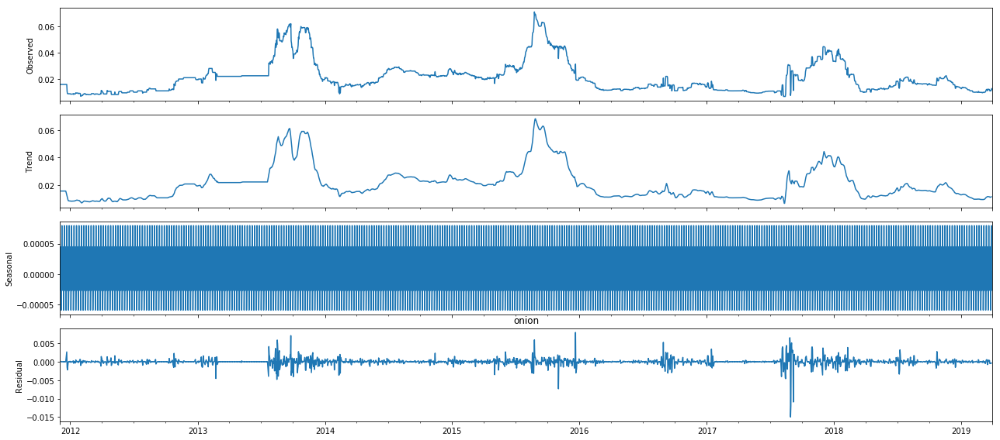



Test Statistic(More -ve, more stationary): -3.3018466841858274


P-Value(If less than 0.05, reject null) 0.014796129188200065
Reject Null Hypothesis(Series is non-stationary): True


/anaconda3/lib/python3.7/site-packages/statsmodels/tsa/base/tsa_model.py:165: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  % freq, ValueWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


RMSE: 3.9518796555148743
MAE: 1.7018060334709237




For SKU: Fresho banana-yelakki 1 kg
Normalizing factor: 0.001
Product Group: banana yelakki
Model Parameters:
p: 2
d: 1
q: 2
ps: 0
ds: 0
qs: 0
trend: n
Average Cost Price: 47.89713378176383


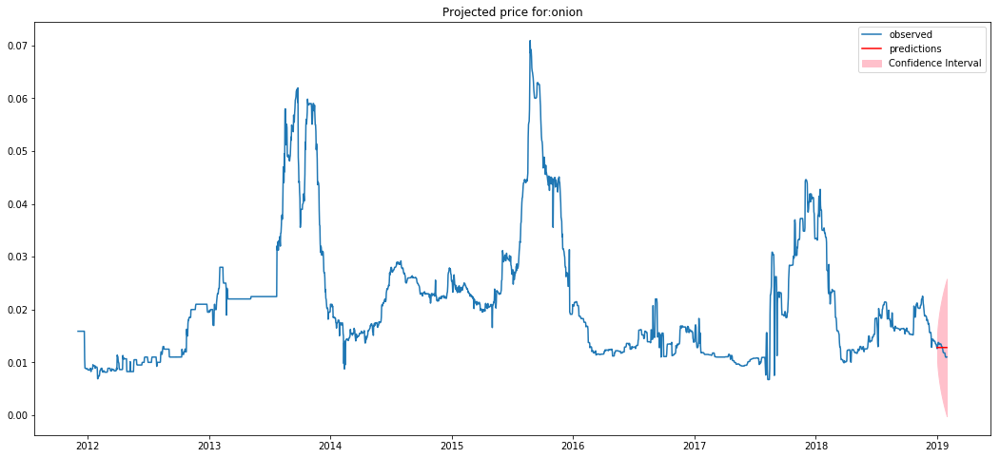

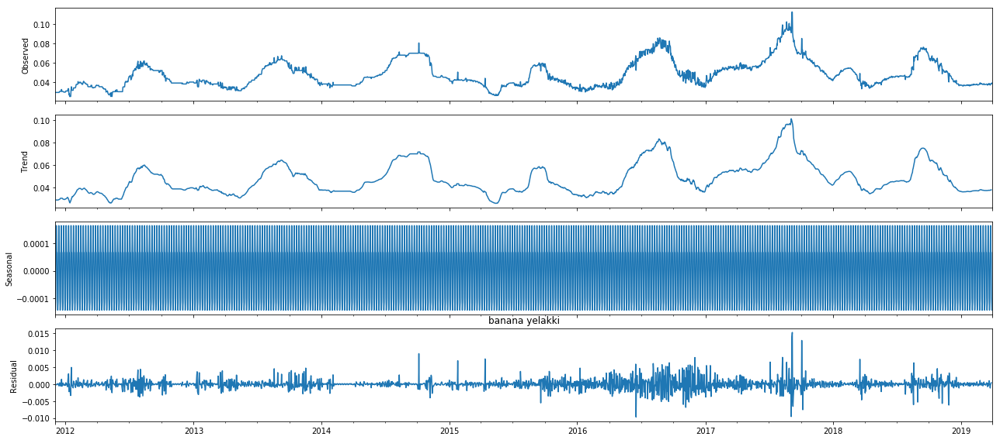



Test Statistic(More -ve, more stationary): -4.295456764777356


P-Value(If less than 0.05, reject null) 0.00045232867073604044
Reject Null Hypothesis(Series is non-stationary): True


/anaconda3/lib/python3.7/site-packages/statsmodels/tsa/base/tsa_model.py:165: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  % freq, ValueWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


RMSE: 1.6586768889363734
MAE: 1.1824257380513818




For SKU: Fresho capsicum-green 1 kg
Normalizing factor: 0.001
Product Group: capsicum green
Model Parameters:
p: 0
d: 0
q: 0
ps: 1
ds: 0
qs: 1
trend: c
Average Cost Price: 26.594613656822432


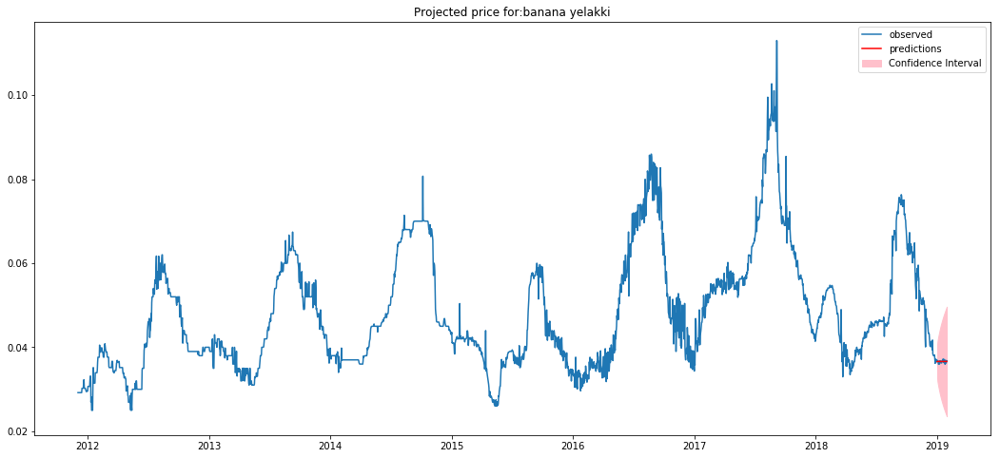

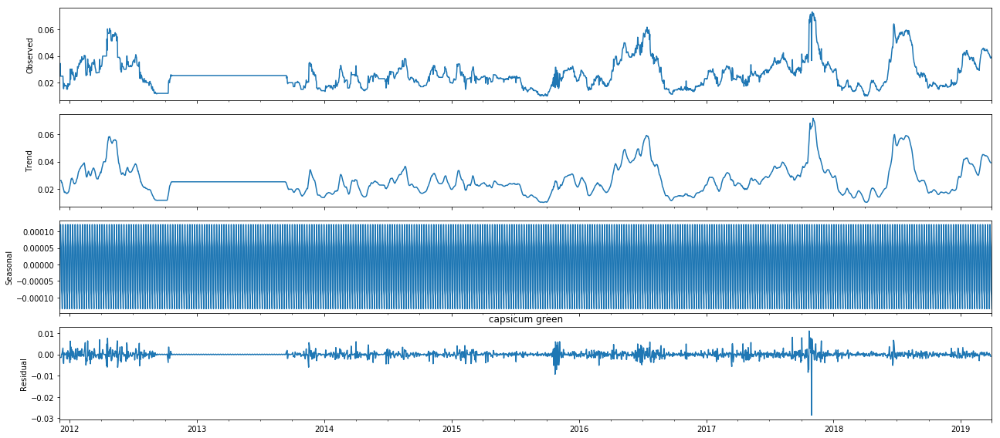



Test Statistic(More -ve, more stationary): -4.402134053525805


P-Value(If less than 0.05, reject null) 0.0002942619064309108
Reject Null Hypothesis(Series is non-stationary): True


/anaconda3/lib/python3.7/site-packages/statsmodels/tsa/base/tsa_model.py:165: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  % freq, ValueWarning)


RMSE: 242.76515377480982
MAE: 15.426478955224953




For SKU: Fresho tomato-hybrid 1 kg
Normalizing factor: 0.001
Product Group: tomato hybrid
Model Parameters:
p: 1
d: 0
q: 0
ps: 0
ds: 0
qs: 0
trend: c
Average Cost Price: 17.397107623318387


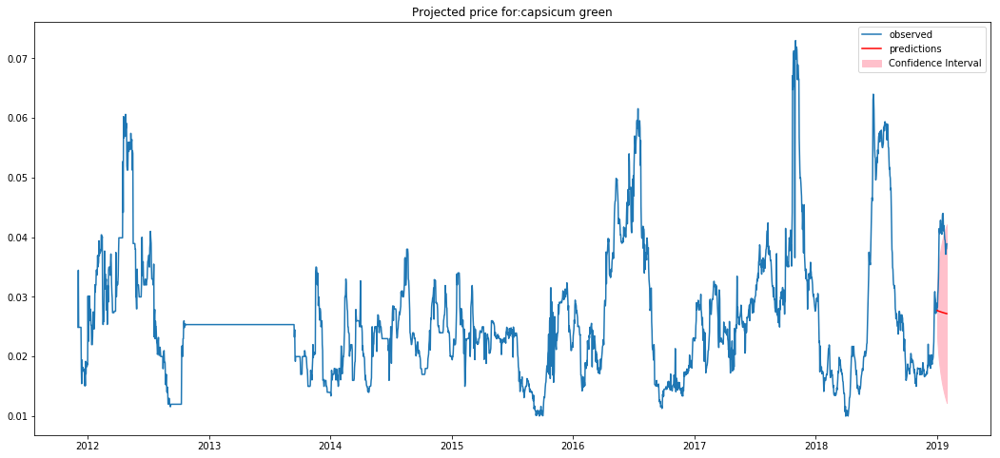

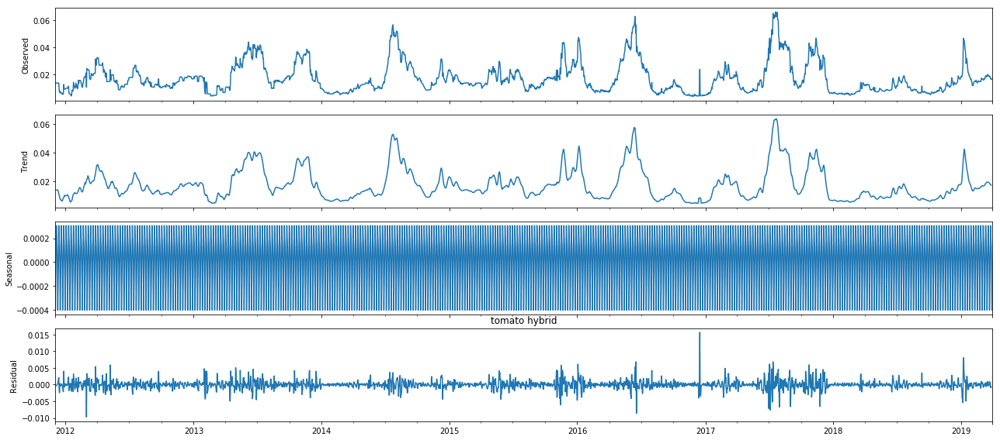



Test Statistic(More -ve, more stationary): -5.866996051572194


P-Value(If less than 0.05, reject null) 3.3075997435953514e-07
Reject Null Hypothesis(Series is non-stationary): True


/anaconda3/lib/python3.7/site-packages/statsmodels/tsa/base/tsa_model.py:165: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  % freq, ValueWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


RMSE: 1.476815196439561
MAE: 1.101109684163382




For SKU: Fresho potato 1 kg
Normalizing factor: 0.001
Product Group: potato
Model Parameters:
p: 1
d: 1
q: 2
ps: 0
ds: 0
qs: 0
trend: n
Average Cost Price: 19.79313527653214


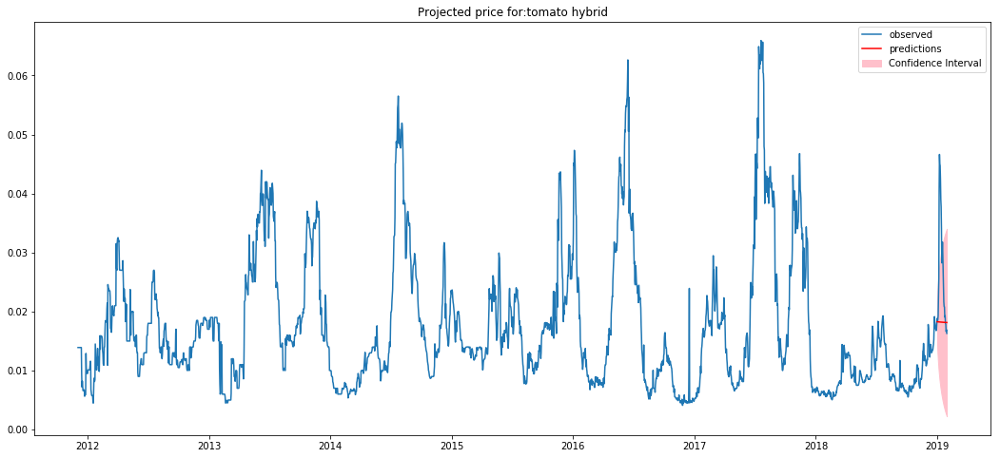

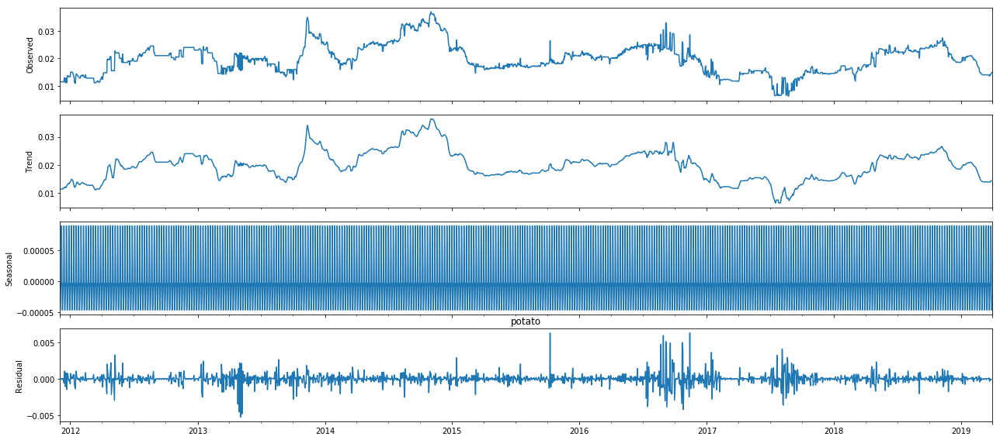



Test Statistic(More -ve, more stationary): -3.1360593021866316


P-Value(If less than 0.05, reject null) 0.023997194575536767
Reject Null Hypothesis(Series is non-stationary): True


/anaconda3/lib/python3.7/site-packages/statsmodels/tsa/base/tsa_model.py:165: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  % freq, ValueWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


RMSE: 20.968920190167587
MAE: 4.569356440366735




For SKU: Fresho cucumber-english 1 kg
Normalizing factor: 0.001
Product Group: cucumber english
Model Parameters:
p: 2
d: 1
q: 1
ps: 0
ds: 0
qs: 0
trend: n
Average Cost Price: 26.788165720405342


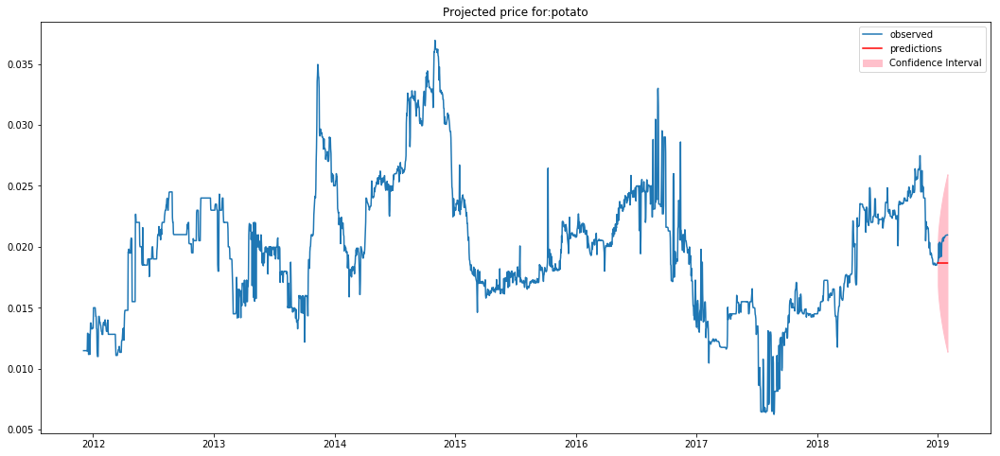

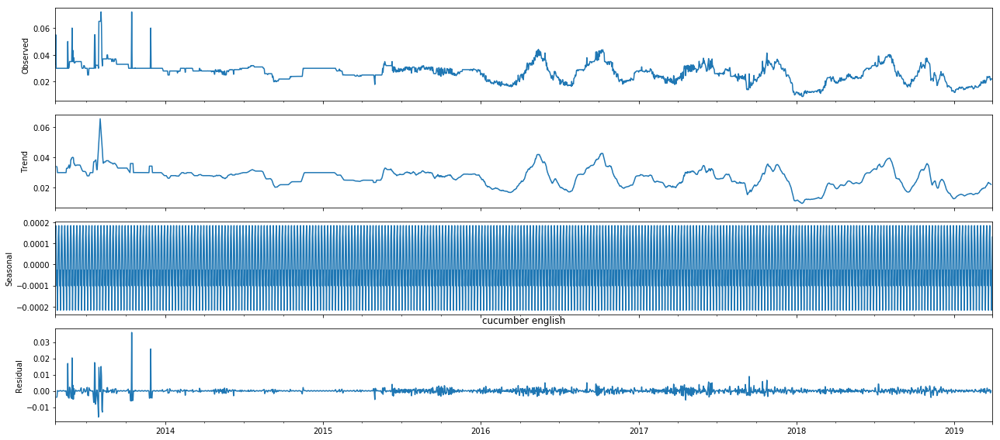



Test Statistic(More -ve, more stationary): -5.314505912662669


P-Value(If less than 0.05, reject null) 5.109253114512109e-06
Reject Null Hypothesis(Series is non-stationary): True


/anaconda3/lib/python3.7/site-packages/statsmodels/tsa/base/tsa_model.py:165: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  % freq, ValueWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


RMSE: 63.29001727681123
MAE: 7.710777059532506




For SKU: Fresho cucumber 1 kg
Normalizing factor: 0.001
Product Group: cucumber
Model Parameters:
p: 2
d: 0
q: 1
ps: 1
ds: 0
qs: 0
trend: c
Average Cost Price: 12.502497093796713


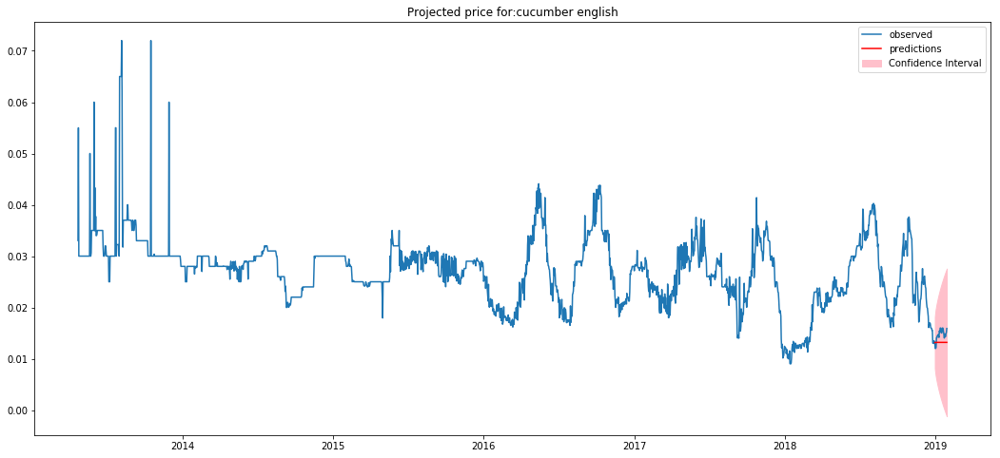

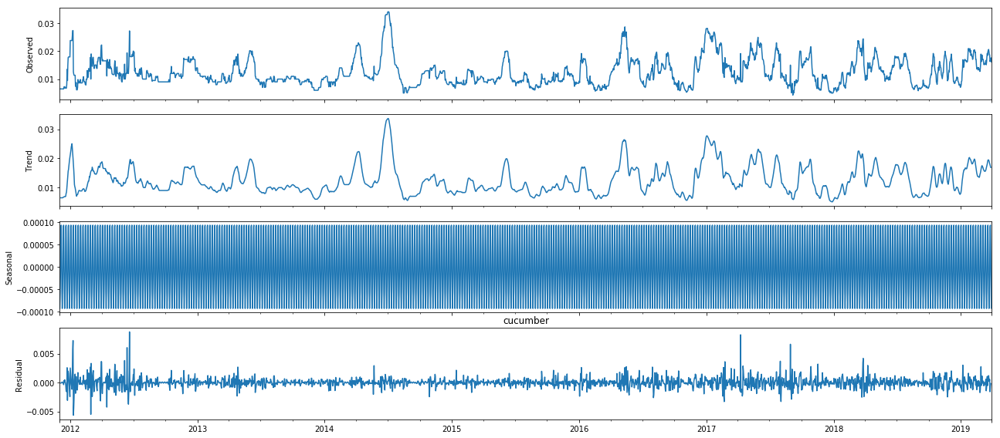



Test Statistic(More -ve, more stationary): -7.459873991172547


P-Value(If less than 0.05, reject null) 5.389147875862422e-11
Reject Null Hypothesis(Series is non-stationary): True


/anaconda3/lib/python3.7/site-packages/statsmodels/tsa/base/tsa_model.py:165: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  % freq, ValueWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/tsa/statespace/sarimax.py:949: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/lib/python3.7/site-packages/statsmodels/tsa/statespace/sarimax.py:961: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'


RMSE: 66.81556349381776
MAE: 8.006716813293805




For SKU: Fresho ridge-gourd 1 kg
Normalizing factor: 0.001
Product Group: ridge gourd
Model Parameters:
p: 0
d: 0
q: 0
ps: 1
ds: 0
qs: 1
trend: c
Average Cost Price: 20.224641533632287


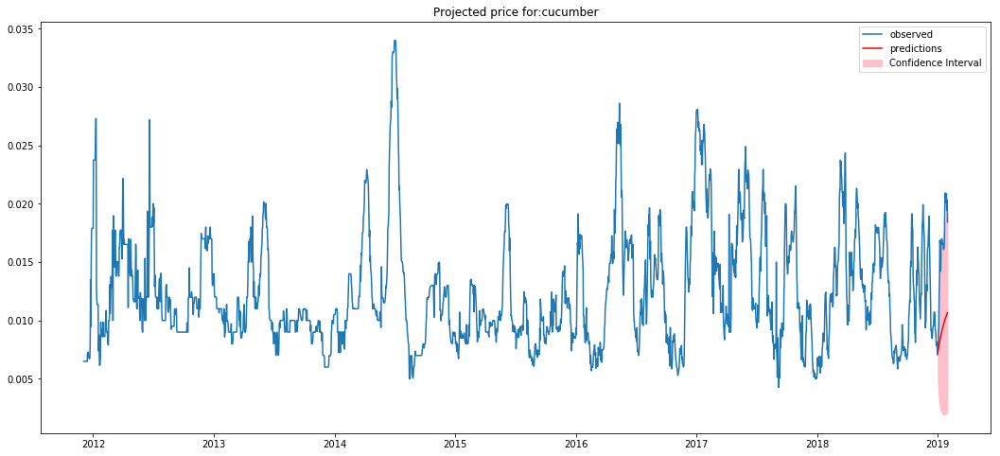

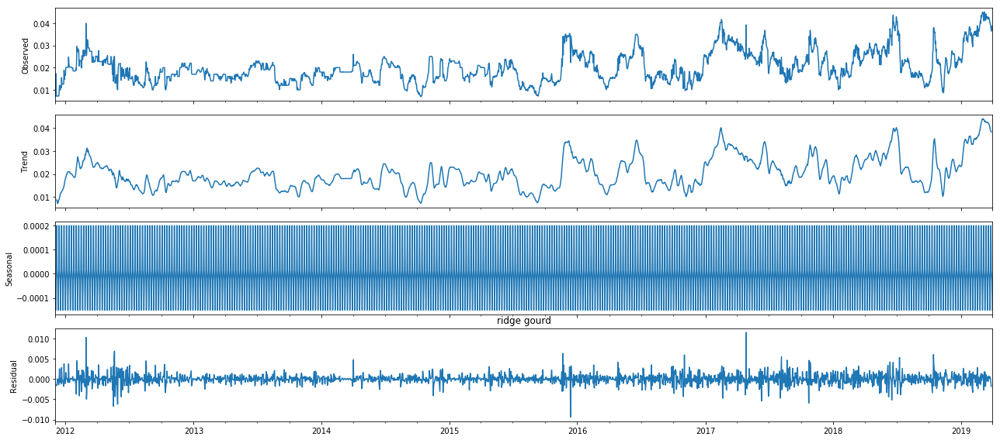



Test Statistic(More -ve, more stationary): -3.942627422861216


P-Value(If less than 0.05, reject null) 0.0017425936088421507
Reject Null Hypothesis(Series is non-stationary): True


/anaconda3/lib/python3.7/site-packages/statsmodels/tsa/base/tsa_model.py:165: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  % freq, ValueWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


RMSE: 363.15637755748503
MAE: 18.946189303144177




For SKU: Fresho ladies-finger 1 kg
Normalizing factor: 0.001
Product Group: ladies finger
Model Parameters:
p: 1
d: 0
q: 2
ps: 0
ds: 0
qs: 0
trend: c
Average Cost Price: 24.198768371214953


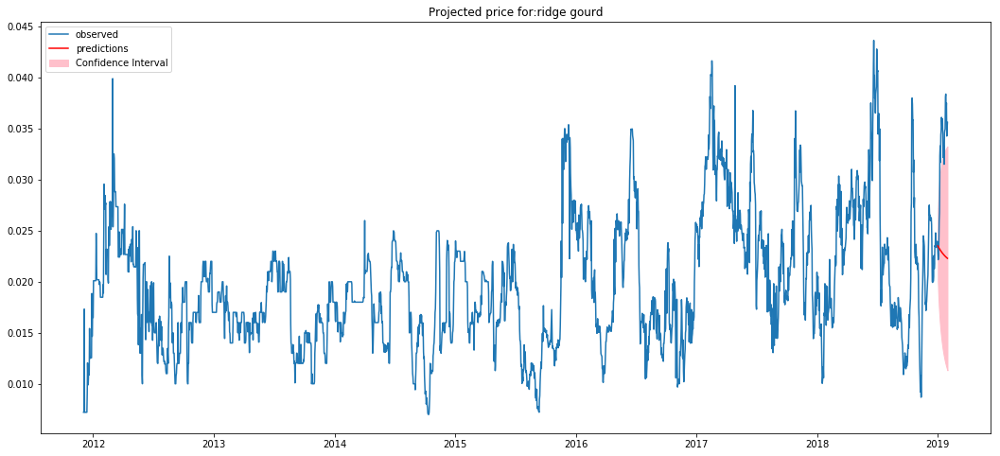

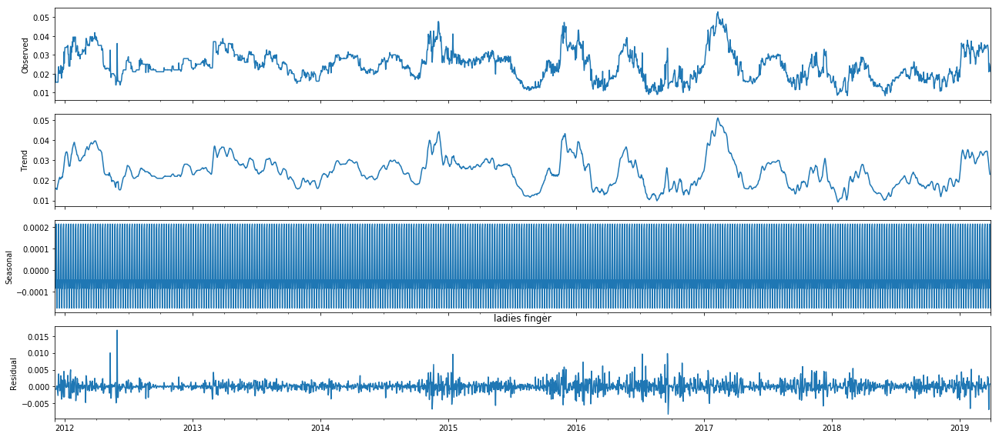



Test Statistic(More -ve, more stationary): -5.389884640255018


P-Value(If less than 0.05, reject null) 3.5569059145509054e-06
Reject Null Hypothesis(Series is non-stationary): True


/anaconda3/lib/python3.7/site-packages/statsmodels/tsa/base/tsa_model.py:165: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  % freq, ValueWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


RMSE: 106.98491944188633
MAE: 9.34472184393865




For SKU: Fresho banana-robusta 1 kg
Normalizing factor: 0.001
Product Group: banana robusta
Model Parameters:
p: 2
d: 1
q: 2
ps: 0
ds: 0
qs: 0
trend: n
Average Cost Price: 21.828481673644863


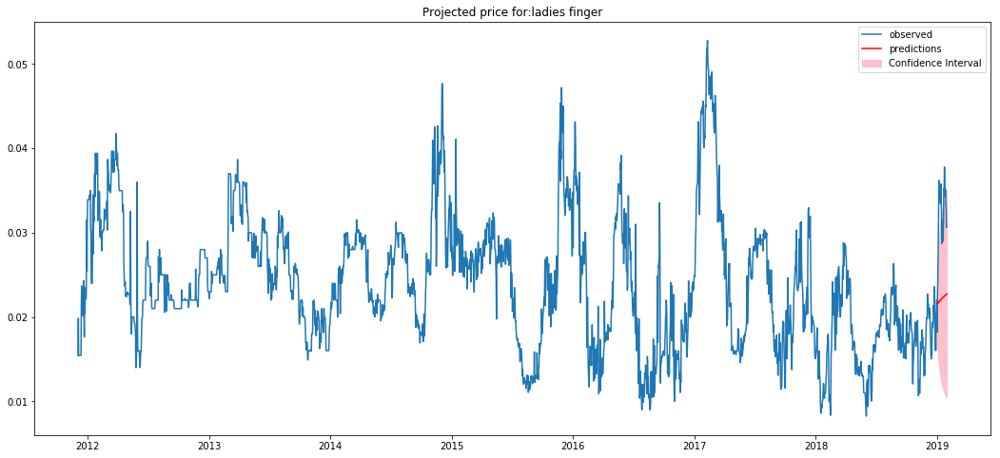

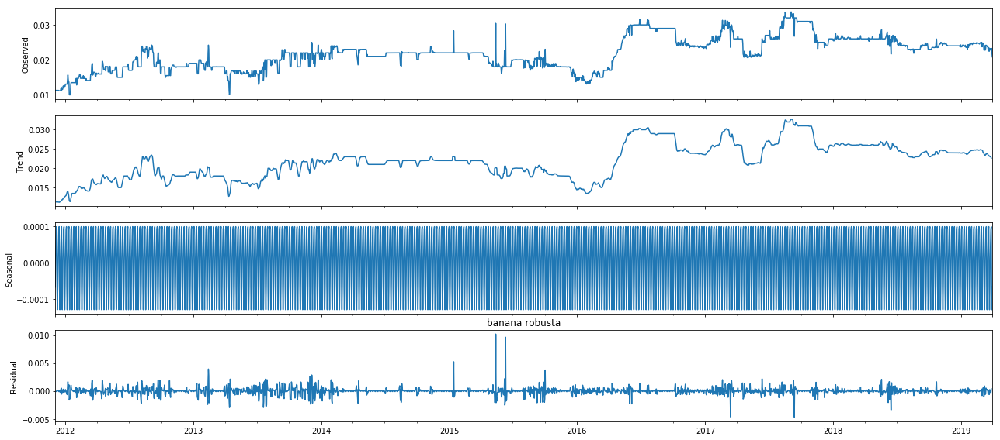



Test Statistic(More -ve, more stationary): -2.892951827629298


P-Value(If less than 0.05, reject null) 0.04617376439790287
Reject Null Hypothesis(Series is non-stationary): True


/anaconda3/lib/python3.7/site-packages/statsmodels/tsa/base/tsa_model.py:165: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  % freq, ValueWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


RMSE: 1.2628405386264303
MAE: 0.8951209449987527




For SKU: Fresho tomato-local 1 kg
Normalizing factor: 0.001
Product Group: tomato local
Model Parameters:
p: 2
d: 0
q: 1
ps: 0
ds: 0
qs: 0
trend: c
Average Cost Price: 17.92701054147982


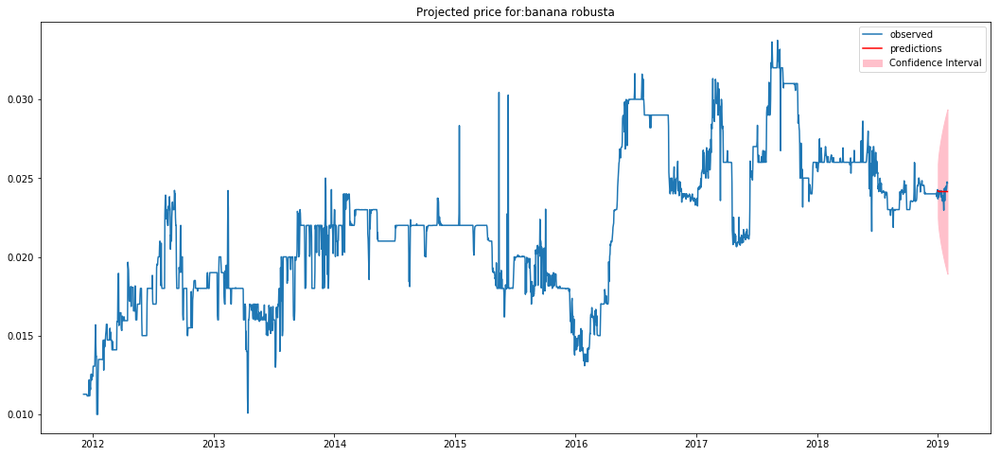

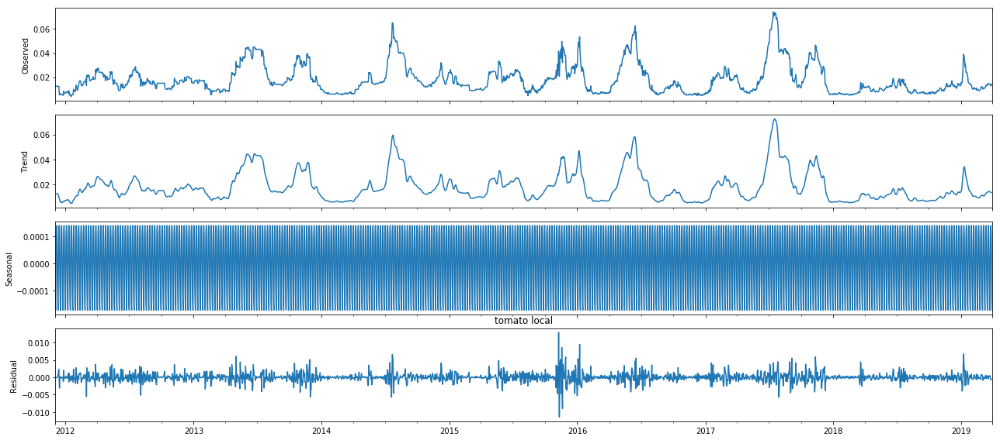



Test Statistic(More -ve, more stationary): -5.480300431288646


P-Value(If less than 0.05, reject null) 2.2923129533752914e-06
Reject Null Hypothesis(Series is non-stationary): True


/anaconda3/lib/python3.7/site-packages/statsmodels/tsa/base/tsa_model.py:165: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  % freq, ValueWarning)


RMSE: 2.5405072044159374
MAE: 1.2559375117194056




For SKU: Fresho bottle-gourd 1 kg
Normalizing factor: 0.001
Product Group: bottle gourd
Model Parameters:
p: 0
d: 0
q: 0
ps: 1
ds: 0
qs: 1
trend: n
Average Cost Price: 13.242073770553066


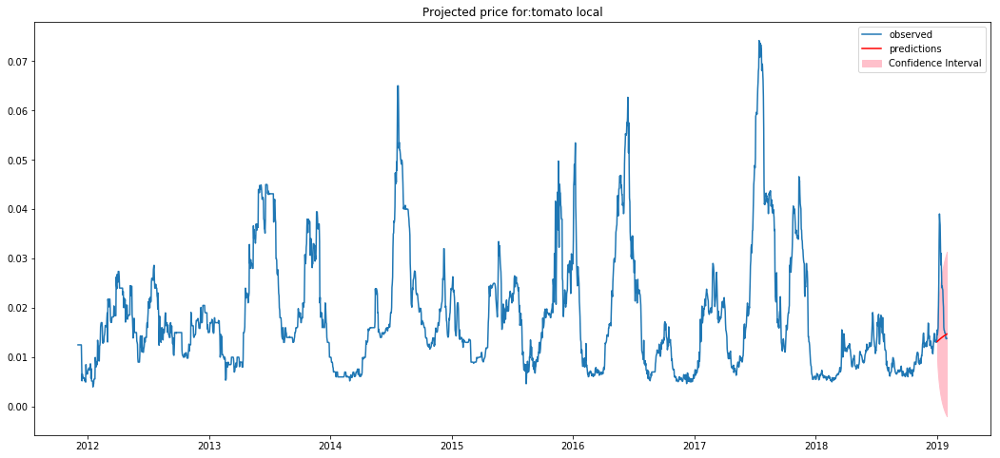

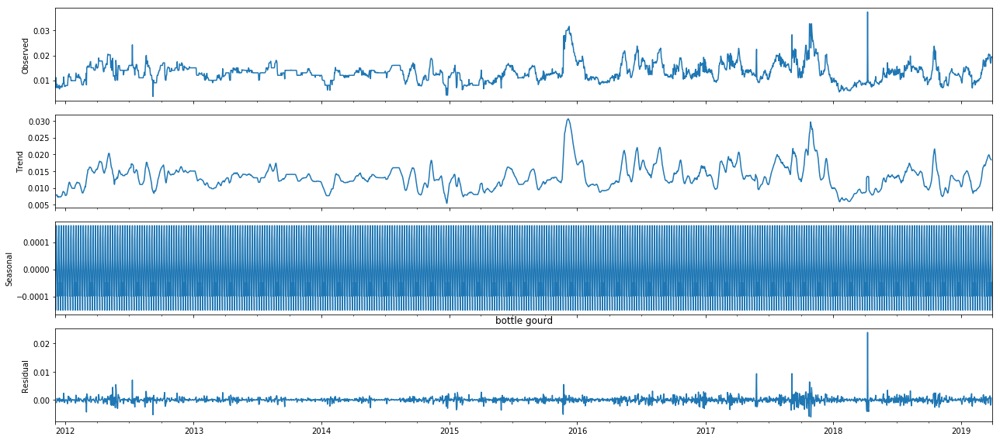



Test Statistic(More -ve, more stationary): -7.585925326878383


P-Value(If less than 0.05, reject null) 2.6069274206656233e-11
Reject Null Hypothesis(Series is non-stationary): True


/anaconda3/lib/python3.7/site-packages/statsmodels/tsa/base/tsa_model.py:165: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  % freq, ValueWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


RMSE: 44.285892323760386
MAE: 6.444530767640698




For SKU: Fresho watermelon-small 1 pc  1.7 - 2.5 kg
Normalizing factor: 1.0
Product Group: watermelon small
Model Parameters:
p: 2
d: 1
q: 0
ps: 1
ds: 0
qs: 0
trend: n
Average Cost Price: 22.972105731315395


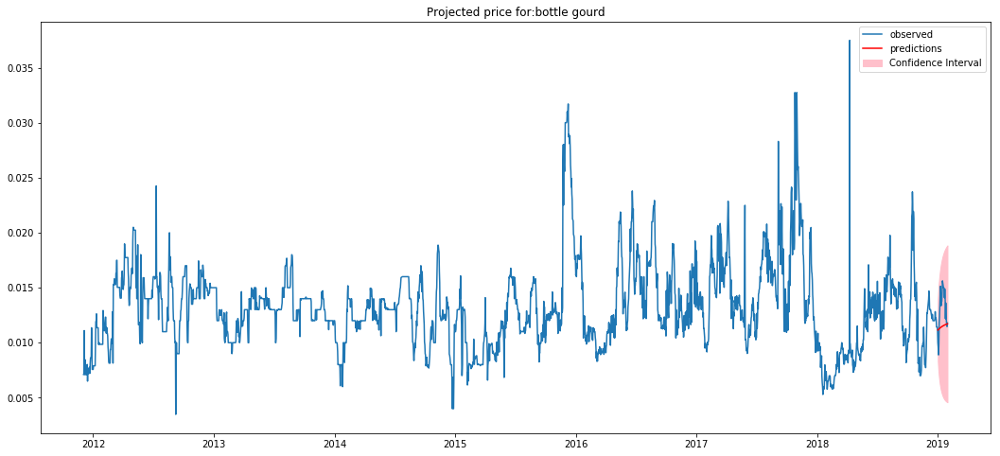

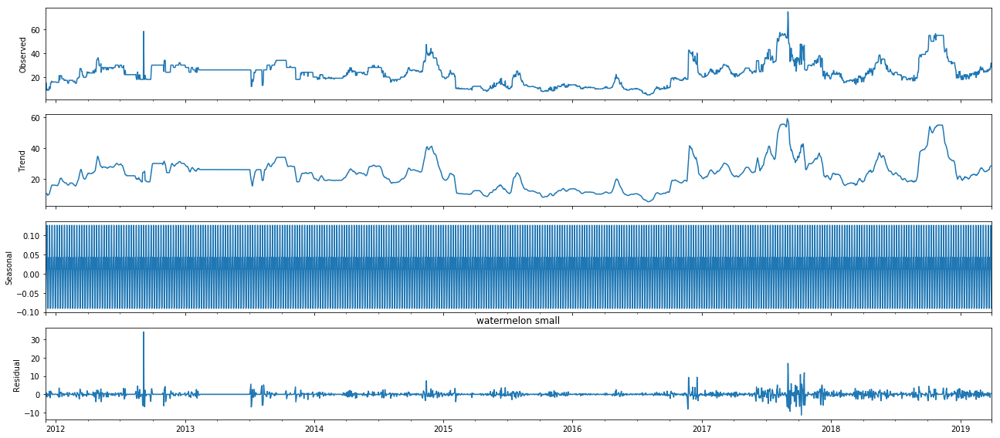



Test Statistic(More -ve, more stationary): -3.932587648800317


P-Value(If less than 0.05, reject null) 0.001807688326800827
Reject Null Hypothesis(Series is non-stationary): True


/anaconda3/lib/python3.7/site-packages/statsmodels/tsa/base/tsa_model.py:165: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  % freq, ValueWarning)


RMSE: 6.843723250951126
MAE: 1.9609331254505549




For SKU: Fresho beetroot 1 kg
Normalizing factor: 0.001
Product Group: beetroot
Model Parameters:
p: 2
d: 1
q: 1
ps: 0
ds: 0
qs: 0
trend: n
Average Cost Price: 19.203162278400598


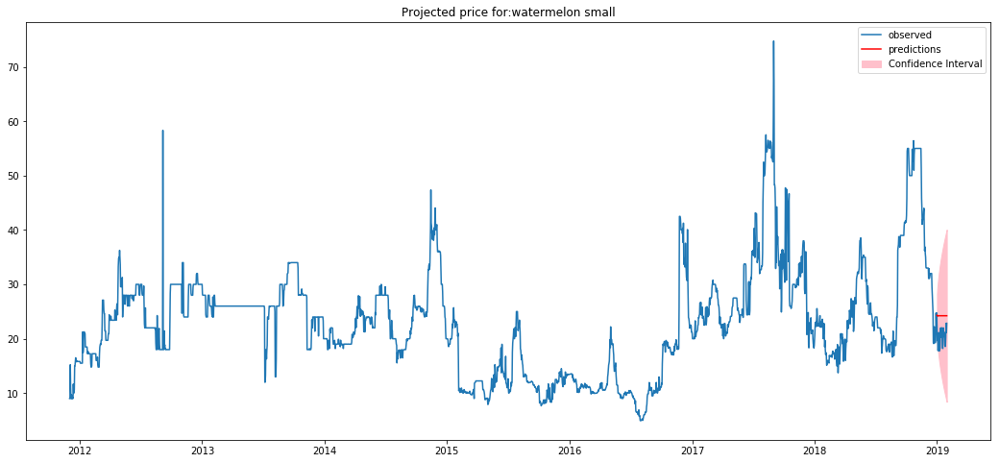

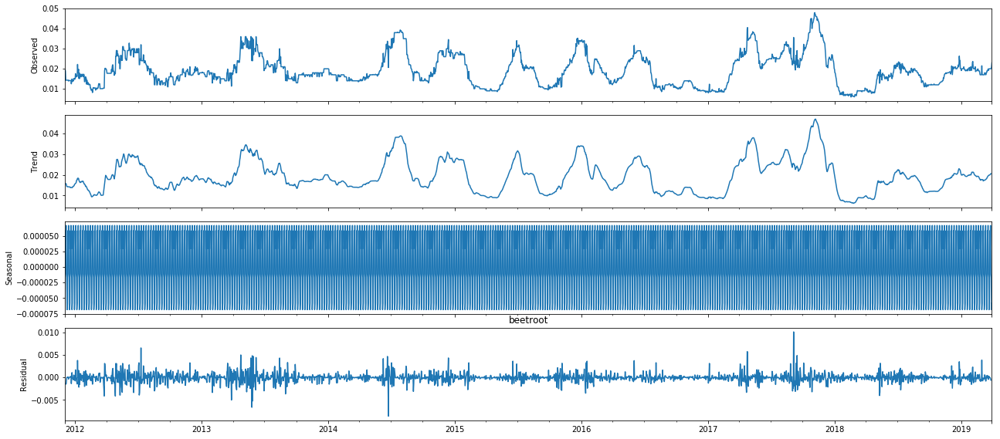



Test Statistic(More -ve, more stationary): -5.546773918182153


P-Value(If less than 0.05, reject null) 1.654053728045891e-06
Reject Null Hypothesis(Series is non-stationary): True


/anaconda3/lib/python3.7/site-packages/statsmodels/tsa/base/tsa_model.py:165: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  % freq, ValueWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


RMSE: 4.897253524417618
MAE: 1.8467196245239523




For SKU: Fresho carrot-local 1 kg
Normalizing factor: 0.001
Product Group: carrot local
Model Parameters:
p: 2
d: 1
q: 2
ps: 0
ds: 0
qs: 0
trend: n
Average Cost Price: 32.49028351569507


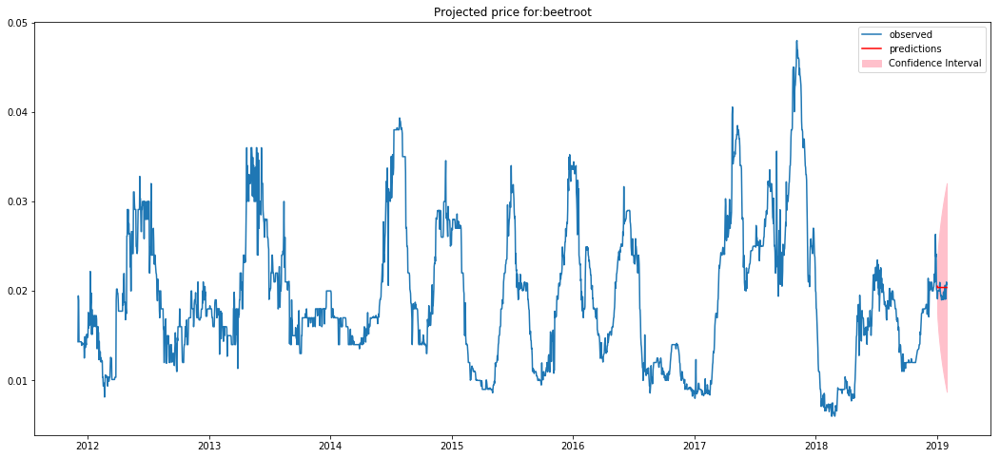

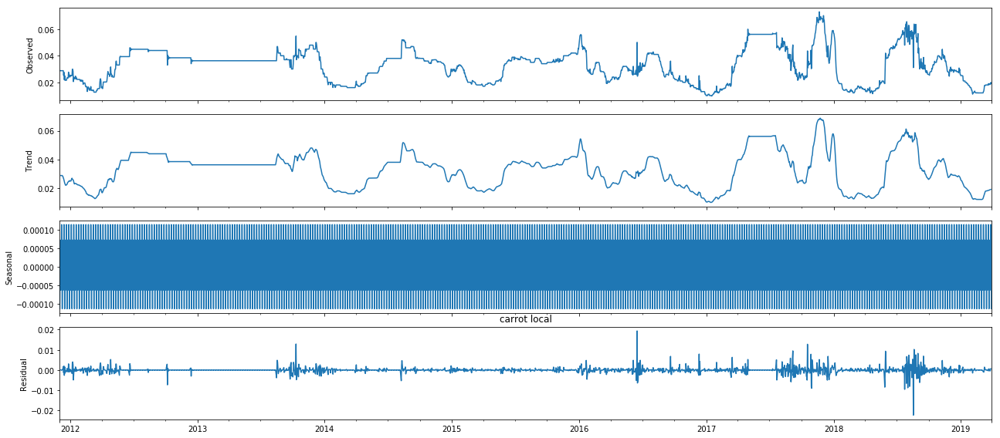



Test Statistic(More -ve, more stationary): -4.685255269390687


P-Value(If less than 0.05, reject null) 8.968684775088775e-05
Reject Null Hypothesis(Series is non-stationary): True


/anaconda3/lib/python3.7/site-packages/statsmodels/tsa/base/tsa_model.py:165: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  % freq, ValueWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


RMSE: 90.80443915234396
MAE: 9.140516957532125






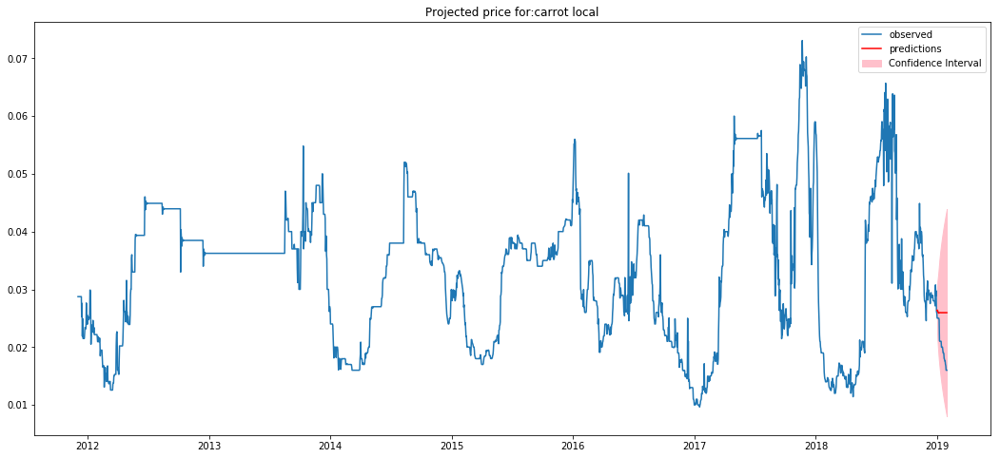

In [77]:
#List to store SKU names of all SKUs for which model has been built
SKU_list = []
#List to store predicted prices of all SKUs for which model has been built
predicted_prices = []
#List to store actual prices of all SKUs for which model has been built
actual_prices = []
#List to store RMSE scores of all SKUs for which model has been built
RMSE_scores = []
#List to store MAE scores of all SKUs for which model has been built
MAE_scores = []
#List to store last 30 dates of all SKUs for which model has been built
dates_list = []

num_observations = []

avg_prices = []

count = 0
#Iterating over all the SKUs
#Here, I've iterated over the product 'splits', as it makes it easier to obtain normalizing factor
for i,prod in enumerate(unique_products_split):
    #Storing the split priduct in a variable
    selected_sku = prod
    
    #Obtaining the actual name of the SKU
    actual_prod = unique_products[i]
    print("For SKU:",actual_prod)
    
    #Calling the method to obtain the forecast
    cost_price_predictions,actual_price,dates,number_of_observations,avg_price = get_forecast_seasonality(selected_sku,actual_prod)

    if len(cost_price_predictions) == 30:
        
        rmse = mean_squared_error(actual_price,cost_price_predictions)
        print("RMSE:",rmse)
        
        mae = mean_absolute_error(actual_price,cost_price_predictions)
        print("MAE:",mae)
        #Storing the last 30 dates of the SKU for which we have obtained the forecast
        dates_list.append(dates)
        #Storing the name of the SKU for which we have obtained the forecast
        SKU_list.append(actual_prod)
        #Storing the predicted prices of the SKU for which we have obtained the forecast
        predicted_prices.append(cost_price_predictions)
        #Storing the RMSE of the SKU for which we have obtained the forecast
        RMSE_scores.append(rmse)
        #Storing the MAE of the SKU for which we have obtained the forecast
        MAE_scores.append(mae)
        #Storing the actual price of the SKU for which we have obtained the forecast
        actual_prices.append(actual_price)
        
        num_observations.append(number_of_observations)
        
        avg_prices.append(avg_price)
    
    print('\n\n\n')

### Computing average 30 day SKU price

In [78]:
sku_avg_30_day_price = []
for sku in SKU_list:
    avg_price_sku = np.average((df_all[df_all['sku_description']==sku]['cp'][-90:-60]))
    sku_avg_30_day_price.append(avg_price_sku)

### Calculating MAPE

In [79]:
MAPE = []
for i,prices in enumerate(actual_prices):
    diff = abs((actual_prices[i] - predicted_prices[i])/(actual_prices[i]))
    sum_diff = np.sum(diff)
    MAPE.append(sum_diff/30)

### 30 days Metrics

In [80]:
normalized_rmse = (np.array(RMSE_scores)/np.array(sku_avg_30_day_price))
df_summary_seasonality_metrics = pd.DataFrame({'SKU':SKU_list,'RMSE':RMSE_scores,'Normalized RMSE':normalized_rmse,'Mean Absolute Error':MAE_scores,'Mean Absolute Percentage Error':MAPE,'Observations used':num_observations})
df_summary_seasonality_metrics.sort_values(by=['Mean Absolute Percentage Error'],ascending=True,inplace=True)
df_summary_seasonality_metrics.style

,SKU,RMSE,Normalized RMSE,Mean Absolute Error,Mean Absolute Percentage Error,Observations used
1,Fresho banana-yelakki 1 kg,1.65868,0.0453356,1.18243,0.0310993,2676
9,Fresho banana-robusta 1 kg,1.26284,0.0526176,0.895121,0.0392734,2675
3,Fresho tomato-hybrid 1 kg,1.47682,0.0546483,1.10111,0.0624178,2676
12,Fresho watermelon-small 1 pc 1.7 - 2.5 kg,6.84372,0.335971,1.96093,0.0711313,2676
13,Fresho beetroot 1 kg,4.89725,0.247628,1.84672,0.103081,2676
10,Fresho tomato-local 1 kg,2.54051,0.115756,1.25594,0.108066,2676
0,Fresho onion 1 kg,3.95188,0.315645,1.70181,0.163288,2676
8,Fresho ladies-finger 1 kg,106.985,3.35264,9.34472,0.281344,2675
4,Fresho potato 1 kg,20.9689,1.03111,4.56936,0.324669,2676
11,Fresho bottle-gourd 1 kg,44.2859,3.37545,6.44453,0.353526,2676


In [83]:
df_summary_seasonality_metrics.to_csv("/Users/vegi/Documents/USC_Masters/ML/DemandForecasts/df_summary_seasonality_metrics.csv", sep=",", float_format='%.6f',index=False, line_terminator='\n',encoding='utf-8')

Product Group: onion


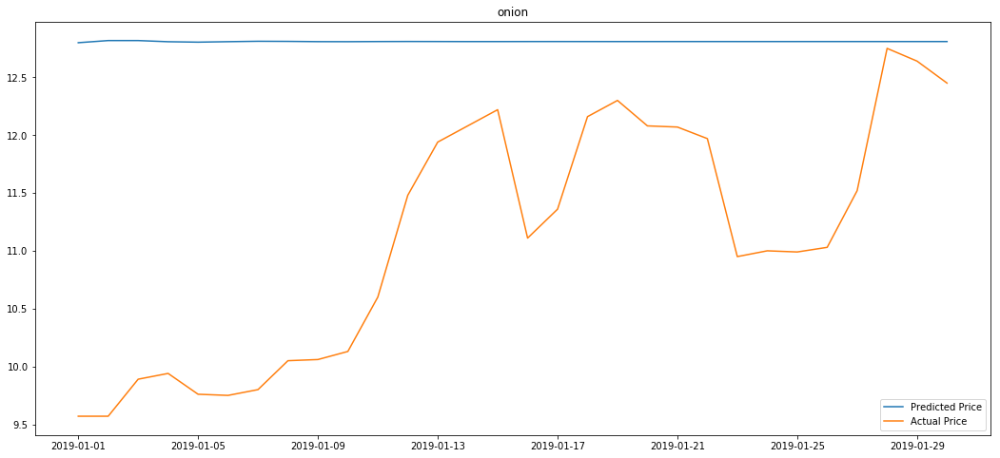

Product Group: banana yelakki


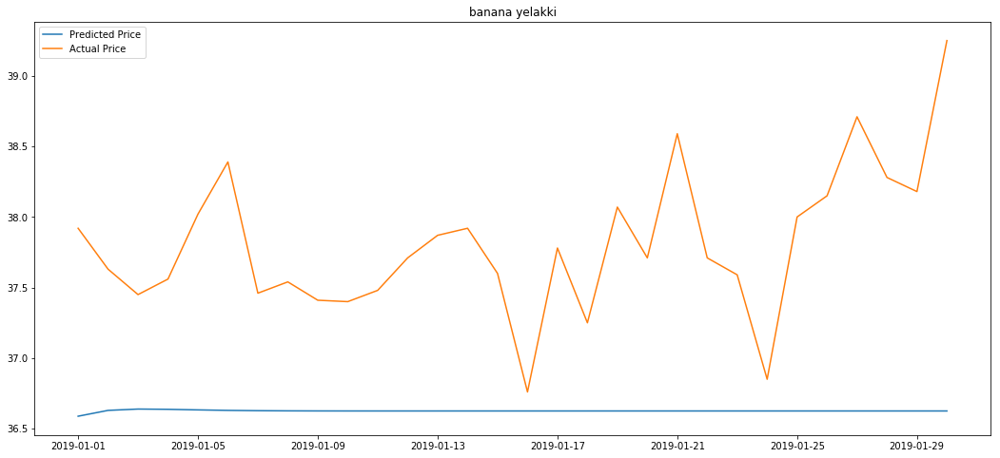

Product Group: capsicum green


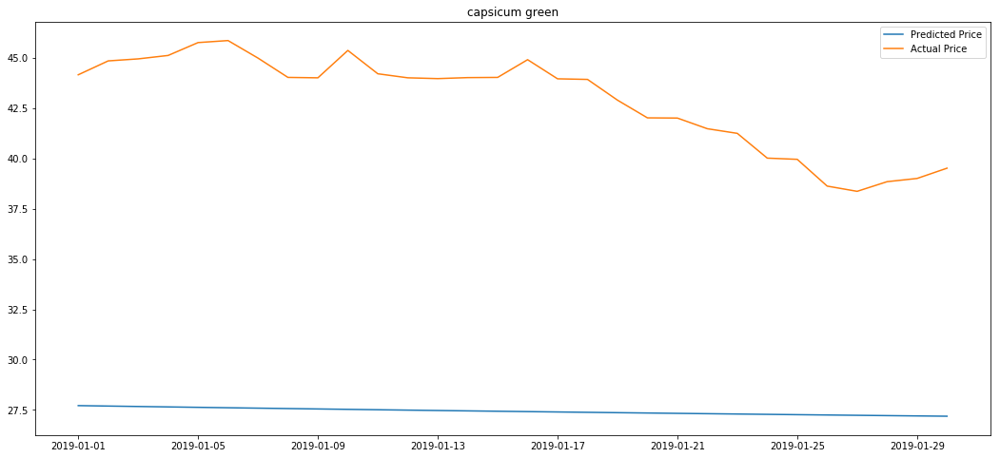

Product Group: tomato hybrid


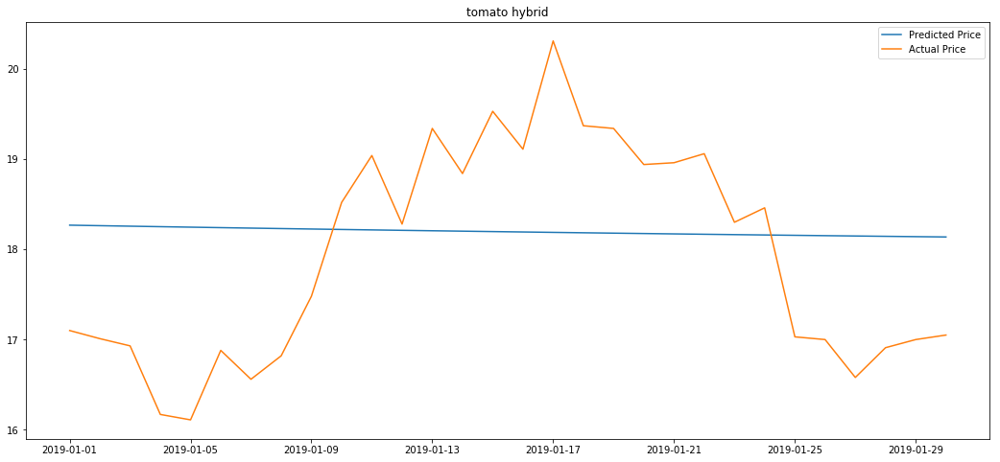

Product Group: potato


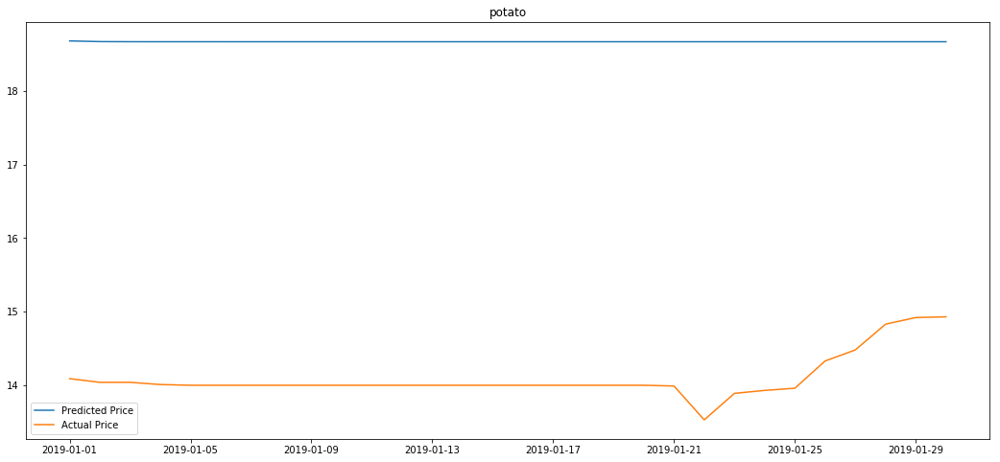

Product Group: cucumber english


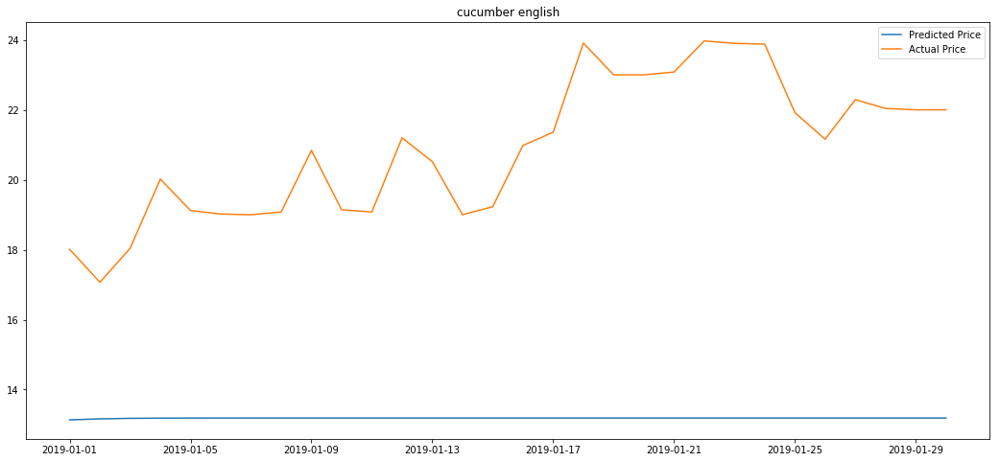

Product Group: cucumber


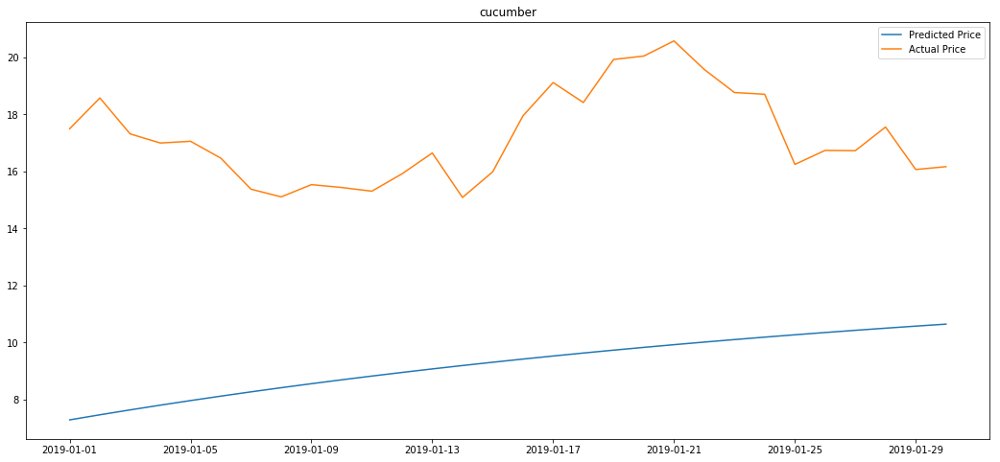

Product Group: ridge gourd


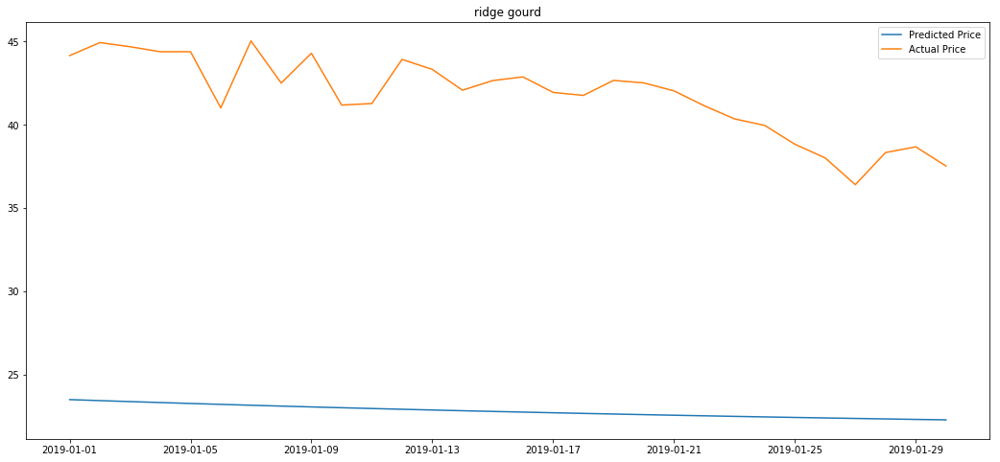

Product Group: ladies finger


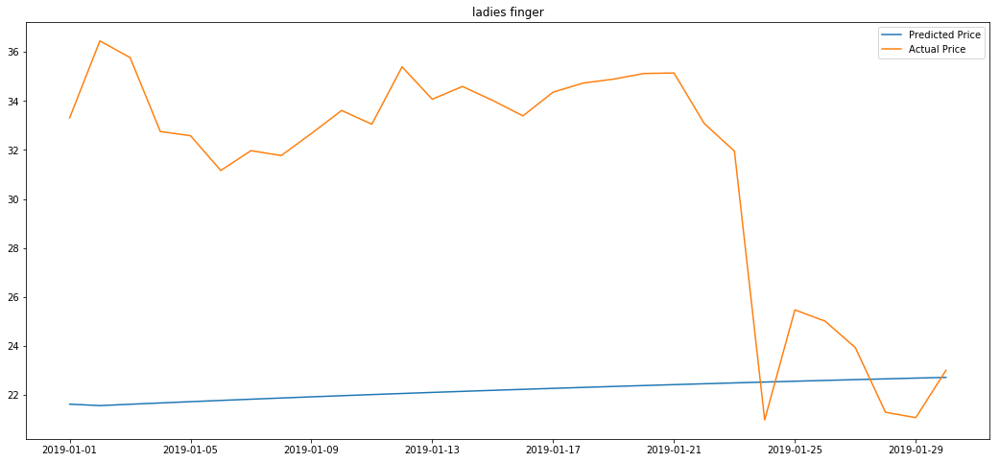

Product Group: banana robusta


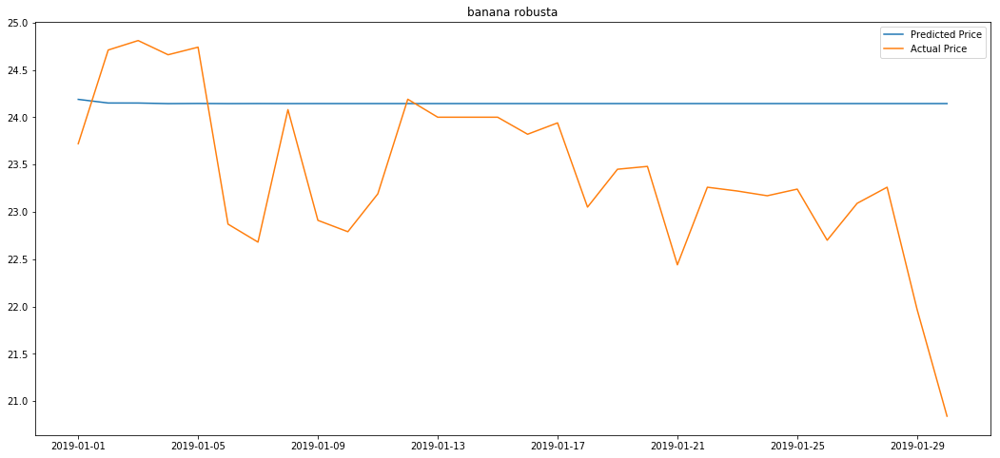

Product Group: tomato local


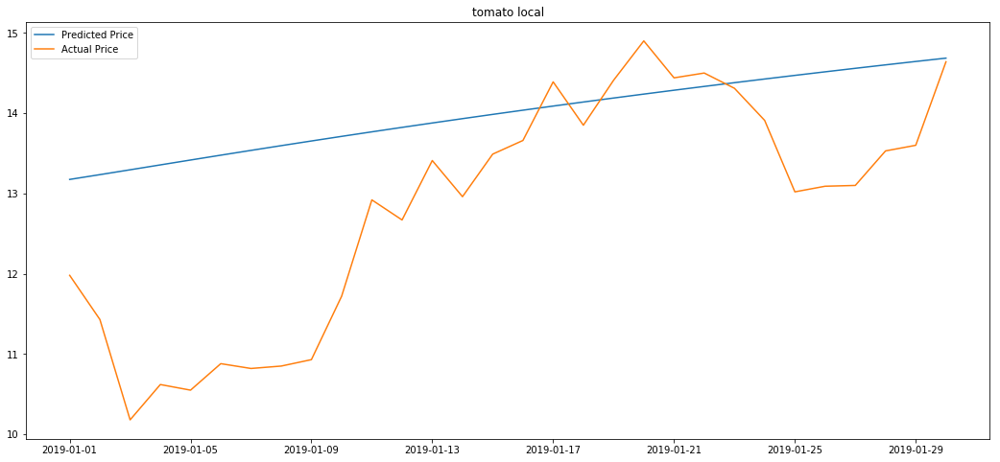

Product Group: bottle gourd


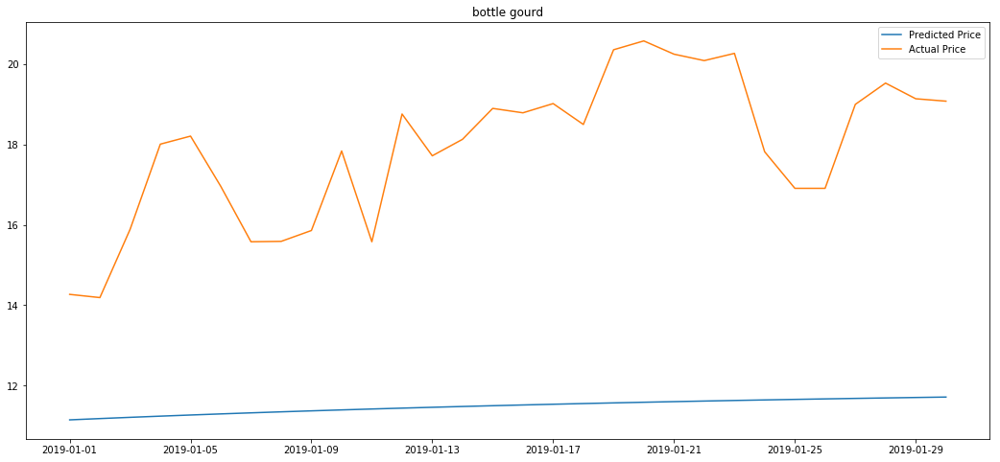

Product Group: watermelon small


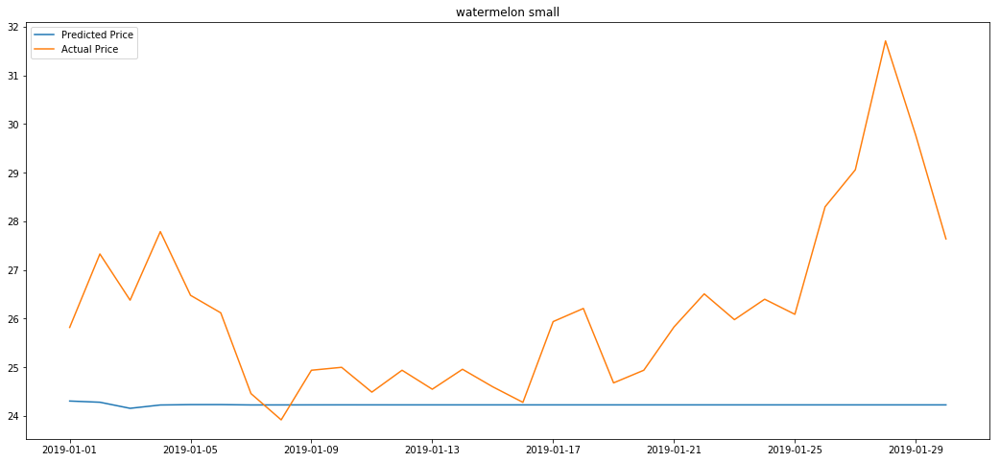

Product Group: beetroot


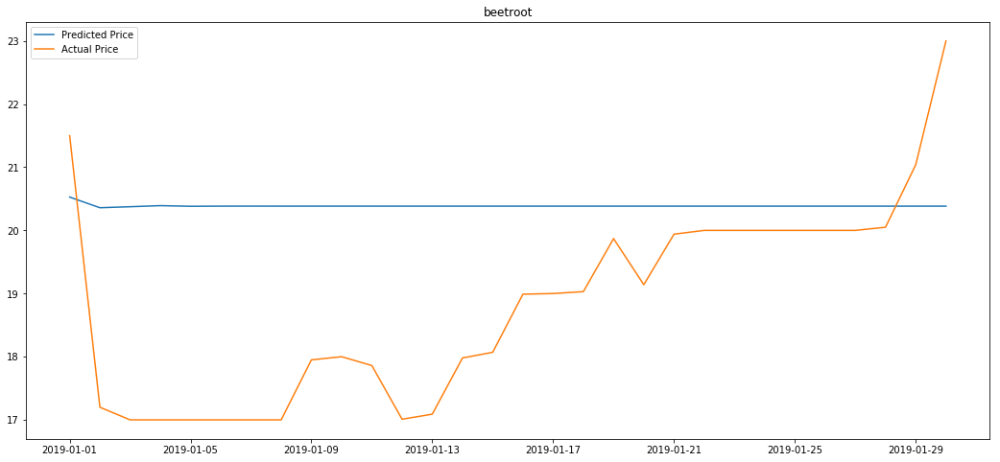

Product Group: carrot local


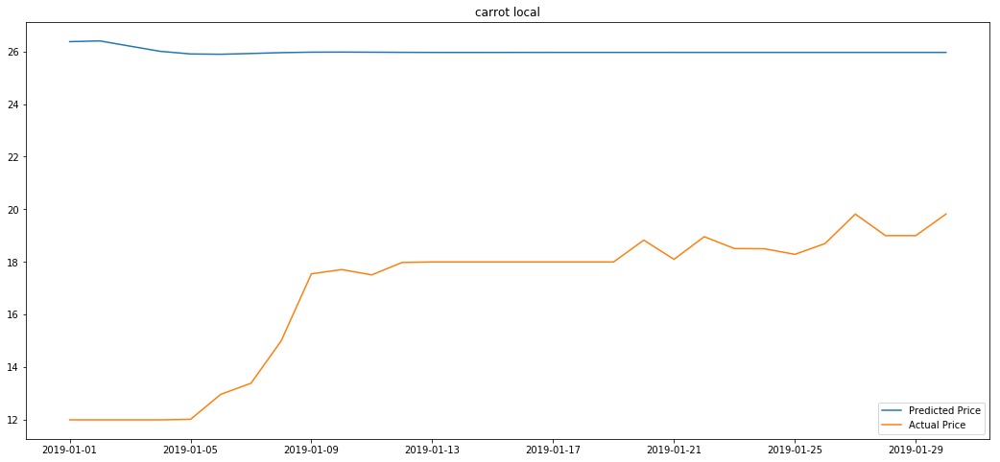

In [117]:
for i,prod in enumerate(unique_products_split):
    #Storing the split priduct in a variable
    selected_sku = prod
    
    #Obtaining the product group
    sku_prod_group = get_prod_group(selected_sku)
    print("Product Group:",sku_prod_group)
    
    plt.plot(dates,predicted_prices[i],label='Predicted Price')
    plt.plot(dates,actual_prices[i],label='Actual Price')
    plt.legend(loc='best')
    plt.title(sku_prod_group)
    plt.savefig('/Users/vegi/Documents/USC_Masters/ML/DemandForecasts/Graphs_Actual_Predicted_Prices/'+sku_prod_group+'.jpg')
    plt.show()

### With Log

In [48]:
filename = '/Users/vegi/Documents/USC_Masters/ML/DemandForecasts/df_summary_seasonality_log.csv'
df_summary_seasonality_log = pd.read_csv(filename)

df_summary_seasonality_log

,product,p,d,q,ps,ds,qs,trend
0,onion,1,1,2,0,0,0,n
1,banana yelakki,1,0,2,1,0,1,c
2,capsicum green,2,0,2,0,0,0,c
3,tomato hybrid,2,0,2,0,0,0,c
4,potato,2,1,2,0,0,0,n
5,cucumber english,2,0,1,0,0,1,c
6,cucumber,2,0,2,0,0,0,c
7,ridge gourd,1,0,0,0,0,1,c
8,ladies finger,1,0,2,0,0,0,c
9,banana robusta,2,1,2,0,0,0,c


In [49]:
#This function picks up the p,d and q parameters from the df_summary dataframe
def get_pdq_seasonality(prod_group):
    if prod_group in list(df_summary_seasonality_log['product']):
        return df_summary_seasonality_log[df_summary_seasonality_log['product']==prod_group]['p'].item(),df_summary_seasonality_log[df_summary_seasonality_log['product']==prod_group]['d'].item(),df_summary_seasonality_log[df_summary_seasonality_log['product']==prod_group]['q'].item(),df_summary_seasonality_log[df_summary_seasonality_log['product']==prod_group]['ps'].item(),df_summary_seasonality_log[df_summary_seasonality_log['product']==prod_group]['ds'].item(),df_summary_seasonality_log[df_summary_seasonality_log['product']==prod_group]['qs'].item(),df_summary_seasonality_log[df_summary_seasonality_log['product']==prod_group]['trend'].item()

In [69]:
def forecast_model_seasonality(df,p,d,q,ps,ds,qs,trend,name):
    # Instantiate the best model
    df['log np'] = np.log(temp_df_exog['Normalized Price'])
    model = SARIMAX(df[:-90]['log np'].values, order=(p,d,q),seasonal_order=(ps,ds,qs,0),trend=trend,exog =df[:-90][columns])

    # Fit the model
    results = model.fit()

    # Generate predictions
    dynamic_forecast_30_days = results.get_forecast(30, alpha=0.05,exog =df[-90:-60][columns])  # 95% conf

    # Extract prediction mean
    mean_forecast_30_days = dynamic_forecast_30_days.predicted_mean
    print("Log Mean:",mean_forecast_30_days)
    mean_forecast_30_days = np.exp(mean_forecast_30_days)
    print("Exp Mean:",mean_forecast_30_days)
    #print(mean_forecast)
    # Get confidence intervals of predictions
    confidence_intervals_30_days = dynamic_forecast_30_days.conf_int()
    # Select lower and upper confidence limits
    lower_limits_30_days = confidence_intervals_30_days.loc[:,'lower y']
    upper_limits_30_days = confidence_intervals_30_days.loc[:,'upper y']
    lower_limits_30_days = np.exp(lower_limits_30_days)
    upper_limits_30_days = np.exp(upper_limits_30_days)
    #Plot the graph
    dates = df[:-60].index
    dates_2 = mean_forecast_30_days.index
    plt.plot(dates,df[:-60]['Normalized Price'].values, label='observed')
    plt.plot(dates_2,mean_forecast_30_days,color='red', label='predictions')
    plt.fill_between(dates_2,lower_limits_30_days,upper_limits_30_days,color='pink',label='Confidence Interval')
    plt.legend(loc='best')
    plt.title("Projected price for:"+name)

    return mean_forecast_30_days,dates_2

In [70]:
def get_forecast_seasonality(selected_sku,actual_prod):
    #Obtaining the normalizing factor for the SKU
    normalizing_factor_sku = dict_prod_factor[actual_prod]
    print("Normalizing factor:",normalizing_factor_sku)
    
    #Obtaining the product group
    sku_prod_group = get_prod_group(selected_sku)
    print("Product Group:",sku_prod_group)
    
    #Obtaining the model parameters
    p,d,q,ps,ds,qs,trend = get_pdq_seasonality(sku_prod_group)
        
    #Printing Model parameters
    print("Model Parameters:")
    print("p:",p)
    print("d:",d)
    print("q:",q)
    print("ps:",ps)
    print("ds:",ds)
    print("qs:",qs)
    print("trend:",trend)
    
    
    #Creating a dataframe with observations from a certain prodcut
    temp_df_exog = df_all[df_all['PROD_GROUP']==sku_prod_group].copy()

    number_of_observations = len(temp_df_exog)
    
    avg_price = np.average(temp_df_exog['cp'])
    
    print("Average Cost Price:",avg_price)
    #Calling function to plot the decomposition plot
    plot_decomposition(temp_df_exog['Normalized Price'],sku_prod_group)
    
    #Obtaining ADF Results
    adf(temp_df_exog['Normalized Price'])
    
    
    #print(temp_df_exog.tail())

    predictions,dates = forecast_model_seasonality(temp_df_exog,p,d,q,ps,ds,qs,trend,sku_prod_group)

    #print("Predicted Normalized Price:",list(predictions))
    cost_price_predictions = np.array(predictions)/normalizing_factor_sku
    print("Predictions:",cost_price_predictions)
    #print(predictions.values)
    #print(cost_price_predictions)

    
    actual_price = (temp_df_exog['Normalized Price'].iloc[-30:].values)/normalizing_factor_sku
    print("Actual Price:",actual_price)
    #print(number_of_observations)
    #print(avg_price)
    return cost_price_predictions,actual_price,dates,number_of_observations,avg_price

For SKU: Fresho onion 1 kg
Normalizing factor: 0.001
Product Group: onion
Model Parameters:
p: 1
d: 1
q: 2
ps: 0
ds: 0
qs: 0
trend: n
Average Cost Price: 20.82280269058296


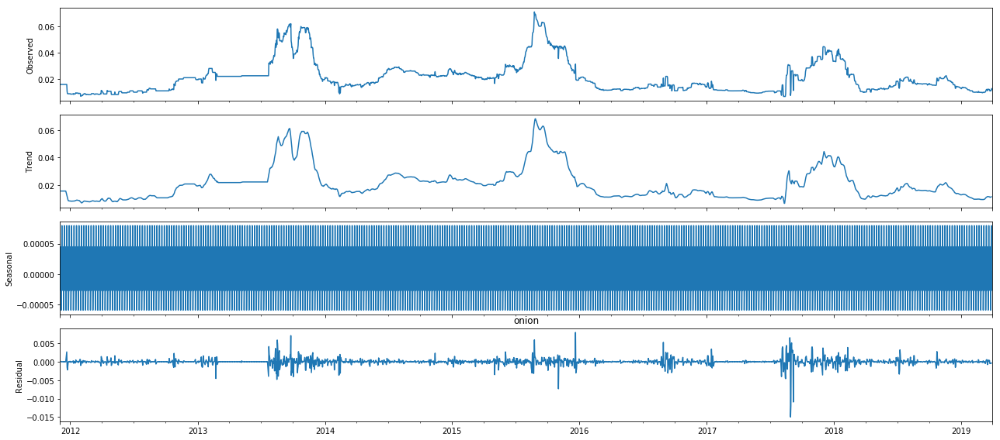



Test Statistic(More -ve, more stationary): -3.3018466841858274


P-Value(If less than 0.05, reject null) 0.014796129188200065
Reject Null Hypothesis(Series is non-stationary): True


/anaconda3/lib/python3.7/site-packages/statsmodels/tsa/base/tsa_model.py:165: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  % freq, ValueWarning)


Log Mean: 2019-01-01   -3.978670
2019-01-02   -3.979440
2019-01-03   -3.979801
2019-01-04   -3.979971
2019-01-05   -3.980051
2019-01-06   -3.980088
2019-01-07   -3.980106
2019-01-08   -3.980114
2019-01-09   -3.980118
2019-01-10   -3.980120
2019-01-11   -3.980120
2019-01-12   -3.980121
2019-01-13   -3.980121
2019-01-14   -3.980121
2019-01-15   -3.980121
2019-01-16   -3.980121
2019-01-17   -3.980121
2019-01-18   -3.980121
2019-01-19   -3.980121
2019-01-20   -3.980121
2019-01-21   -3.980121
2019-01-22   -3.980121
2019-01-23   -3.980121
2019-01-24   -3.980121
2019-01-25   -3.980121
2019-01-26   -3.980121
2019-01-27   -3.980121
2019-01-28   -3.980121
2019-01-29   -3.980121
2019-01-30   -3.980121
Freq: D, dtype: float64
Exp Mean: 2019-01-01    0.018711
2019-01-02    0.018696
2019-01-03    0.018689
2019-01-04    0.018686
2019-01-05    0.018685
2019-01-06    0.018684
2019-01-07    0.018684
2019-01-08    0.018684
2019-01-09    0.018683
2019-01-10    0.018683
2019-01-11    0.018683
2019-01-12   

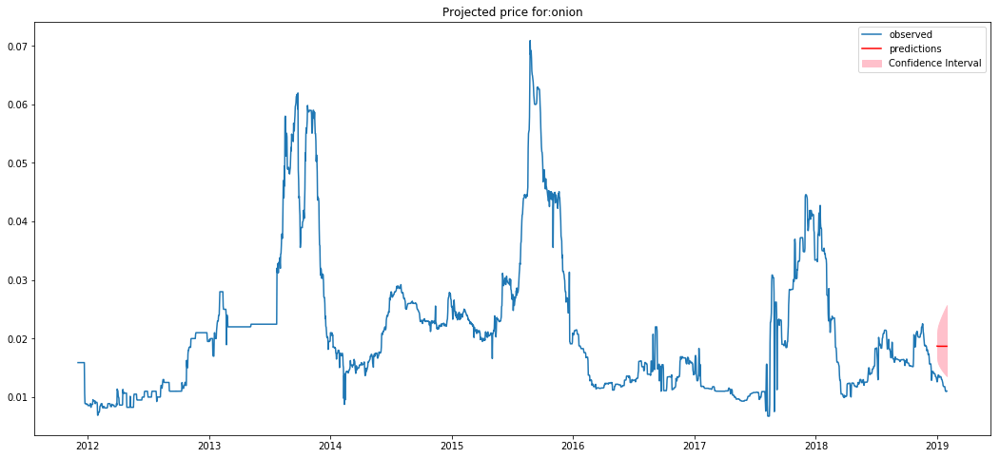

In [71]:
#List to store SKU names of all SKUs for which model has been built
SKU_list = []
#List to store predicted prices of all SKUs for which model has been built
predicted_prices = []
#List to store actual prices of all SKUs for which model has been built
actual_prices = []
#List to store RMSE scores of all SKUs for which model has been built
RMSE_scores = []
#List to store MAE scores of all SKUs for which model has been built
MAE_scores = []
#List to store last 30 dates of all SKUs for which model has been built
dates_list = []

num_observations = []

avg_prices = []
columns_needed = ['cp','Normalized Price','CPI_FB_Vegetables', 'temp_avg_max', 'temp_avg_min','rainfall(mm)']

columns = ['CPI_FB_Vegetables', 'temp_avg_max', 'temp_avg_min','rainfall(mm)']

count = 0
#Iterating over all the SKUs
#Here, I've iterated over the product 'splits', as it makes it easier to obtain normalizing factor
for i,prod in enumerate(unique_products_split):
    #Storing the split priduct in a variable
    selected_sku = prod
    
    #Obtaining the actual name of the SKU
    actual_prod = unique_products[i]
    print("For SKU:",actual_prod)
    
    #Calling the method to obtain the forecast
    cost_price_predictions,actual_price,dates,number_of_observations,avg_price = get_forecast_seasonality(selected_sku,actual_prod)
    
    if len(cost_price_predictions) == 30:
        
        rmse = mean_squared_error(actual_price,cost_price_predictions)
        print("RMSE:",rmse)
        
        mae = mean_absolute_error(actual_price,cost_price_predictions)
        print("MAE:",mae)
        #Storing the last 30 dates of the SKU for which we have obtained the forecast
        dates_list.append(dates)
        #Storing the name of the SKU for which we have obtained the forecast
        SKU_list.append(actual_prod)
        #Storing the predicted prices of the SKU for which we have obtained the forecast
        predicted_prices.append(cost_price_predictions)
        #Storing the RMSE of the SKU for which we have obtained the forecast
        RMSE_scores.append(rmse)
        #Storing the MAE of the SKU for which we have obtained the forecast
        MAE_scores.append(mae)
        #Storing the actual price of the SKU for which we have obtained the forecast
        actual_prices.append(actual_price)
        
        num_observations.append(number_of_observations)
        
        avg_prices.append(avg_price)
    
    print('\n\n\n')
    break

In [64]:
sku_avg_30_day_price = []
for sku in SKU_list:
    avg_price_sku = np.average((df_all[df_all['sku_description']==sku]['cp'][-90:-60]))
    sku_avg_30_day_price.append(avg_price_sku)

In [65]:
MAPE = []
for i,prices in enumerate(actual_prices):
    diff = abs((actual_prices[i] - predicted_prices[i])/(actual_prices[i]))
    sum_diff = np.sum(diff)
    MAPE.append(sum_diff/30)

In [66]:
normalized_rmse = (np.array(RMSE_scores)/np.array(sku_avg_30_day_price))
df_summary_log_metrics = pd.DataFrame({'SKU':SKU_list,'RMSE':RMSE_scores,'Normalized RMSE':normalized_rmse,'Mean Absolute Error':MAE_scores,'Mean Absolute Percentage Error':MAPE,'Observations used':num_observations})
df_summary_log_metrics.sort_values(by=['Mean Absolute Percentage Error'],ascending=True,inplace=True)
df_summary_log_metrics.style

,SKU,RMSE,Normalized RMSE,Mean Absolute Error,Mean Absolute Percentage Error,Observations used
3,Fresho tomato-hybrid 1 kg,1.93449,0.0715842,1.16903,0.0677276,2676
13,Fresho beetroot 1 kg,2.41261,0.121993,1.3391,0.070776,2676
5,Fresho cucumber-english 1 kg,4.55568,0.311046,1.72734,0.0787865,2171
11,Fresho bottle-gourd 1 kg,3.7758,0.28779,1.47608,0.089378,2676
6,Fresho cucumber 1 kg,4.56142,0.282522,1.84293,0.112509,2676
14,Fresho carrot-local 1 kg,10.384,0.510446,2.0685,0.154491,2676
9,Fresho banana-robusta 1 kg,22.5348,0.938938,4.66714,0.198259,2675
4,Fresho potato 1 kg,21.057,1.03544,4.57897,0.325352,2676
8,Fresho ladies-finger 1 kg,179.585,5.62774,12.5117,0.382821,2675
10,Fresho tomato-local 1 kg,37.2822,1.69874,5.94269,0.482607,2676


In [87]:
df_summary_log_metrics.to_csv("/Users/vegi/Documents/USC_Masters/ML/DemandForecasts/df_summary_seasonality_log_metrics.csv", sep=",", float_format='%.6f',index=False, line_terminator='\n',encoding='utf-8')

### Optimization Attempt-1

In [112]:
filename = '/Users/vegi/Documents/USC_Masters/ML/DemandForecasts/df_summary_optimized.csv'
df_summary_optimized = pd.read_csv(filename)

df_summary_optimized.style

,product,p,d,q,ps,ds,qs,trend,LOG
0,onion,2,1,2,0,0,0,n,False
1,banana yelakki,2,1,2,0,0,0,n,False
2,capsicum green,0,0,0,1,0,1,c,False
3,tomato hybrid,1,0,0,0,0,0,c,False
4,potato,1,1,2,0,0,0,n,False
5,cucumber english,2,0,1,0,0,1,c,True
6,cucumber,2,0,2,0,0,0,c,True
7,ridge gourd,0,0,0,1,0,1,c,False
8,ladies finger,1,0,2,0,0,0,c,False
9,banana robusta,2,1,2,0,0,0,n,False


In [90]:
#This function picks up the p,d and q parameters from the df_summary dataframe
def get_pdq_log(prod_group):
    if prod_group in list(df_summary_optimized['product']):
        return df_summary_optimized[df_summary_optimized['product']==prod_group]['p'].item(),df_summary_optimized[df_summary_optimized['product']==prod_group]['d'].item(),df_summary_optimized[df_summary_optimized['product']==prod_group]['q'].item(),df_summary_optimized[df_summary_optimized['product']==prod_group]['ps'].item(),df_summary_optimized[df_summary_optimized['product']==prod_group]['ds'].item(),df_summary_optimized[df_summary_optimized['product']==prod_group]['qs'].item(),df_summary_optimized[df_summary_optimized['product']==prod_group]['trend'].item(),df_summary_optimized[df_summary_optimized['product']==prod_group]['LOG'].item()

In [96]:
def forecast_log(df,p,d,q,ps,ds,qs,trend,name):
    # Instantiate the best model
    df['log np'] = np.log(temp_df_exog['Normalized Price'])
    model = SARIMAX(df[:-90]['log np'].values, order=(p,d,q),seasonal_order=(ps,ds,qs,0),trend=trend,exog =df[:-90][columns])

    # Fit the model
    results = model.fit()

    # Generate predictions
    dynamic_forecast_30_days = results.get_forecast(30, alpha=0.05,exog =df[-90:-60][columns])  # 95% conf

    # Extract prediction mean
    mean_forecast_30_days = dynamic_forecast_30_days.predicted_mean
    print("Log Mean:",mean_forecast_30_days)
    mean_forecast_30_days = np.exp(mean_forecast_30_days)
    print("Exp Mean:",mean_forecast_30_days)
    #print(mean_forecast)
    # Get confidence intervals of predictions
    confidence_intervals_30_days = dynamic_forecast_30_days.conf_int()
    # Select lower and upper confidence limits
    lower_limits_30_days = confidence_intervals_30_days.loc[:,'lower y']
    upper_limits_30_days = confidence_intervals_30_days.loc[:,'upper y']
    lower_limits_30_days = np.exp(lower_limits_30_days)
    upper_limits_30_days = np.exp(upper_limits_30_days)
    #Plot the graph
    dates = df[:-60].index
    dates_2 = mean_forecast_30_days.index
    plt.plot(dates,df[:-60]['Normalized Price'].values, label='observed')
    plt.plot(dates_2,mean_forecast_30_days,color='red', label='predictions')
    plt.fill_between(dates_2,lower_limits_30_days,upper_limits_30_days,color='pink',label='Confidence Interval')
    plt.legend(loc='best')
    plt.title("Projected price for:"+name)

    return mean_forecast_30_days,dates_2

In [97]:
def forecast_no_log(df,p,d,q,ps,ds,qs,trend,name):
    # Instantiate the best model
    model = SARIMAX(df[:-90]['Normalized Price'].values, order=(p,d,q),seasonal_order=(ps,ds,qs,0),trend=trend,exog =df[:-90][columns])

    # Fit the model
    results = model.fit()

    # Generate predictions
    dynamic_forecast_30_days = results.get_forecast(30, alpha=0.05,exog =df[-90:-60][columns])  # 95% conf

    # Extract prediction mean
    mean_forecast_30_days = dynamic_forecast_30_days.predicted_mean
    #print(mean_forecast)
    
    # Get confidence intervals of predictions
    confidence_intervals_30_days = dynamic_forecast_30_days.conf_int()
    # Select lower and upper confidence limits
    lower_limits_30_days = confidence_intervals_30_days.loc[:,'lower y']
    upper_limits_30_days = confidence_intervals_30_days.loc[:,'upper y']
    
    #Plot the graph
    dates = df[:-60].index
    dates_2 = mean_forecast_30_days.index
    plt.plot(dates,df[:-60]['Normalized Price'].values, label='observed')
    plt.plot(dates_2,mean_forecast_30_days,color='red', label='predictions')
    plt.fill_between(dates_2,lower_limits_30_days,upper_limits_30_days,color='pink',label='Confidence Interval')
    plt.legend(loc='best')
    plt.title("Projected price for:"+name)

    return mean_forecast_30_days,dates_2

In [100]:
def get_forecast_optimized(selected_sku,actual_prod):
    #Obtaining the normalizing factor for the SKU
    normalizing_factor_sku = dict_prod_factor[actual_prod]
    print("Normalizing factor:",normalizing_factor_sku)
    
    #Obtaining the product group
    sku_prod_group = get_prod_group(selected_sku)
    print("Product Group:",sku_prod_group)
    
    #Obtaining the model parameters
    p,d,q,ps,ds,qs,trend,log = get_pdq_log(sku_prod_group)
        
    #Printing Model parameters
    print("Model Parameters:")
    print("p:",p)
    print("d:",d)
    print("q:",q)
    print("ps:",ps)
    print("ds:",ds)
    print("qs:",qs)
    print("trend:",trend)
    print("LOG:",log)
    
    #Creating a dataframe with observations from a certain prodcut
    temp_df_exog = df_all[df_all['PROD_GROUP']==sku_prod_group].copy()

    number_of_observations = len(temp_df_exog)
    
    avg_price = np.average(temp_df_exog['cp'])
    
    print("Average Cost Price:",avg_price)
    #Calling function to plot the decomposition plot
    plot_decomposition(temp_df_exog['Normalized Price'],sku_prod_group)
    
    #Obtaining ADF Results
    adf(temp_df_exog['Normalized Price'])
    
    
    #print(temp_df_exog.tail())
    if log:
        predictions,dates = forecast_log(temp_df_exog,p,d,q,ps,ds,qs,trend,sku_prod_group)
    else:
        predictions,dates = forecast_no_log(temp_df_exog,p,d,q,ps,ds,qs,trend,sku_prod_group)
    
    #print("Predicted Normalized Price:",list(predictions))
    cost_price_predictions = np.array(predictions)/normalizing_factor_sku
    #print("Predictions:",cost_price_predictions)
    
    actual_price = (temp_df_exog['Normalized Price'].iloc[-30:].values)/normalizing_factor_sku
    #print("Actual Price:",actual_price)
    
    return cost_price_predictions,actual_price,dates,number_of_observations,avg_price

For SKU: Fresho onion 1 kg
Normalizing factor: 0.001
Product Group: onion
Model Parameters:
p: 2
d: 1
q: 2
ps: 0
ds: 0
qs: 0
trend: n
LOG: False
Average Cost Price: 20.82280269058296


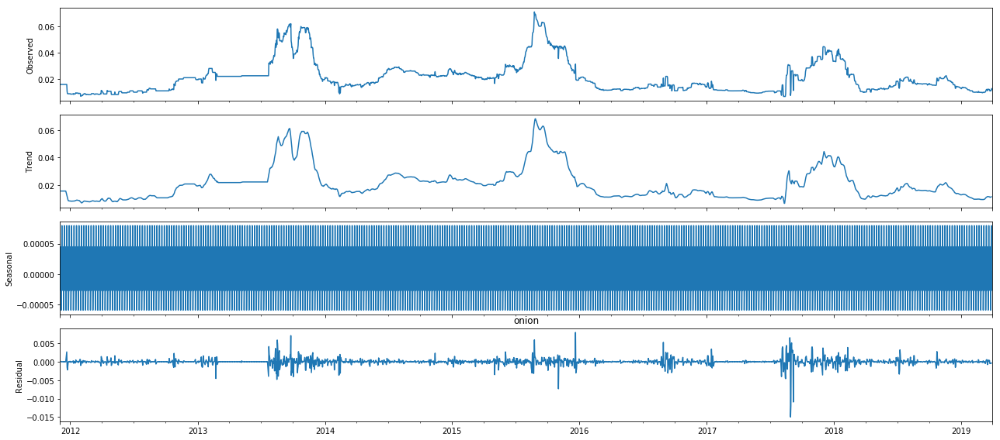



Test Statistic(More -ve, more stationary): -3.3018466841858274


P-Value(If less than 0.05, reject null) 0.014796129188200065
Reject Null Hypothesis(Series is non-stationary): True


/anaconda3/lib/python3.7/site-packages/statsmodels/tsa/base/tsa_model.py:165: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  % freq, ValueWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


RMSE: 3.9518796555148743
MAE: 1.7018060334709237




For SKU: Fresho banana-yelakki 1 kg
Normalizing factor: 0.001
Product Group: banana yelakki
Model Parameters:
p: 2
d: 1
q: 2
ps: 0
ds: 0
qs: 0
trend: n
LOG: False
Average Cost Price: 47.89713378176383


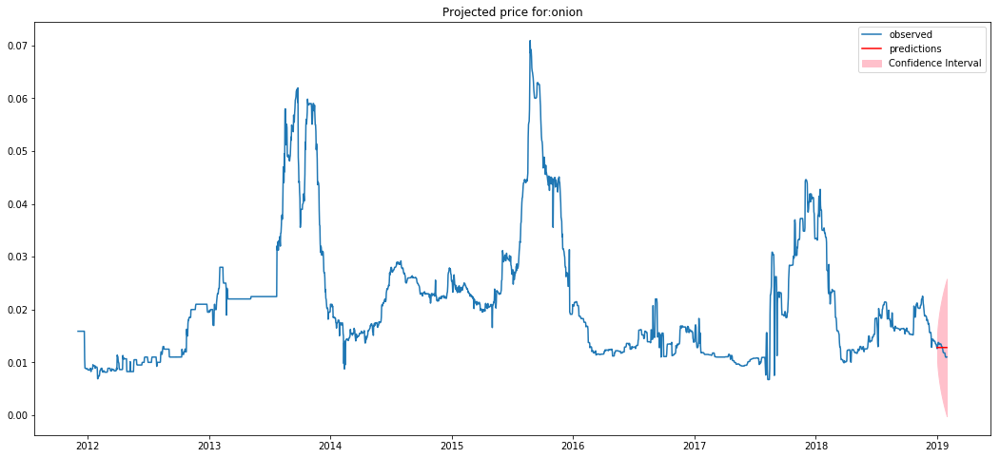

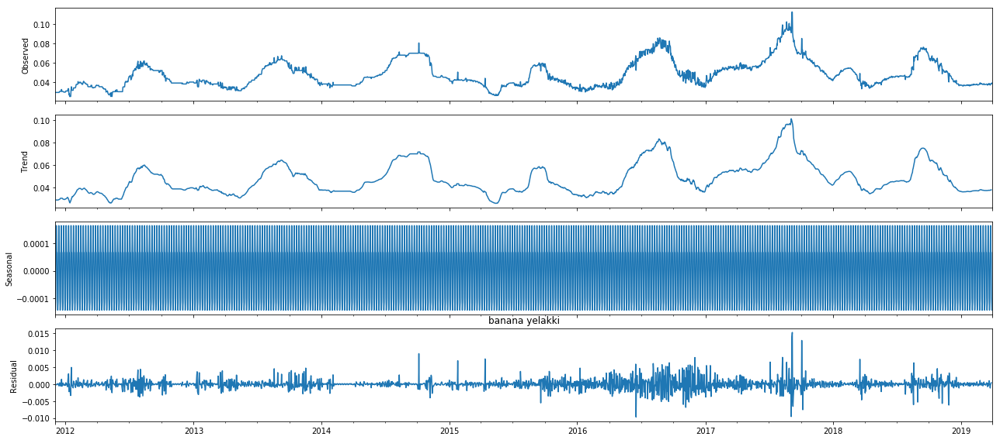



Test Statistic(More -ve, more stationary): -4.295456764777356


P-Value(If less than 0.05, reject null) 0.00045232867073604044
Reject Null Hypothesis(Series is non-stationary): True


/anaconda3/lib/python3.7/site-packages/statsmodels/tsa/base/tsa_model.py:165: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  % freq, ValueWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


RMSE: 1.6586768889363734
MAE: 1.1824257380513818




For SKU: Fresho capsicum-green 1 kg
Normalizing factor: 0.001
Product Group: capsicum green
Model Parameters:
p: 0
d: 0
q: 0
ps: 1
ds: 0
qs: 1
trend: c
LOG: False
Average Cost Price: 26.594613656822432


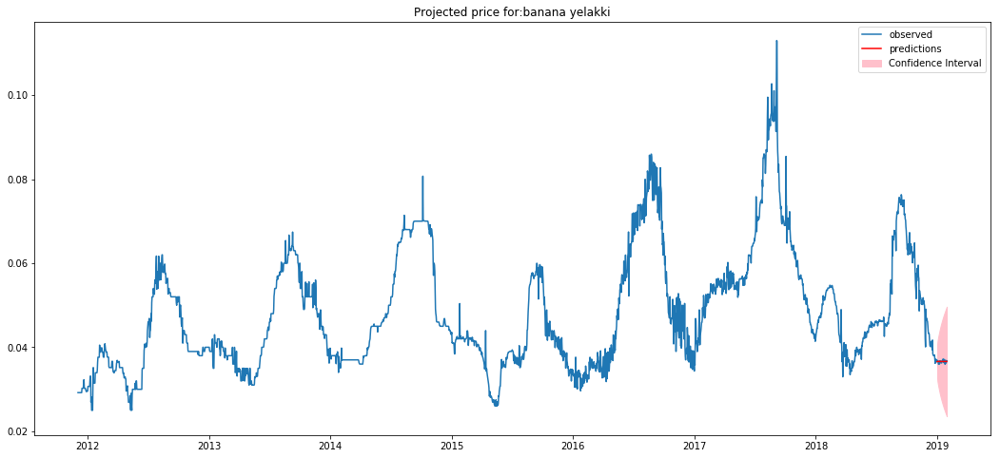

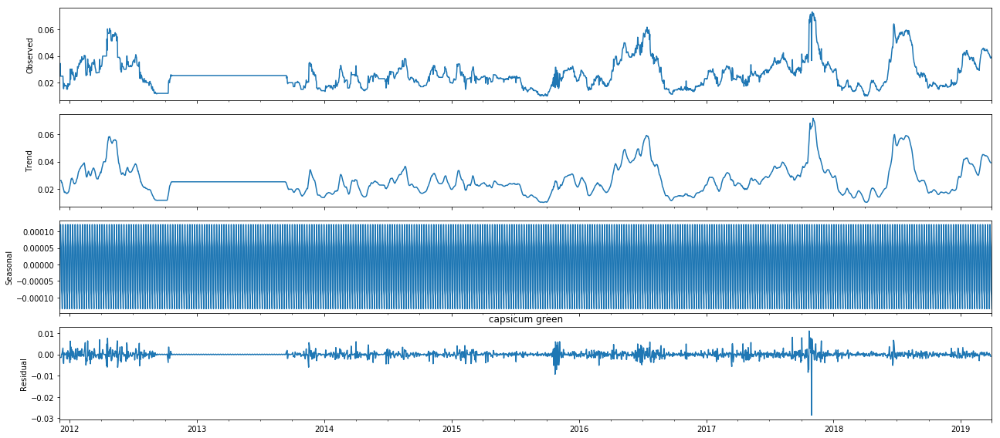



Test Statistic(More -ve, more stationary): -4.402134053525805


P-Value(If less than 0.05, reject null) 0.0002942619064309108
Reject Null Hypothesis(Series is non-stationary): True


/anaconda3/lib/python3.7/site-packages/statsmodels/tsa/base/tsa_model.py:165: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  % freq, ValueWarning)


RMSE: 242.76515377480982
MAE: 15.426478955224953




For SKU: Fresho tomato-hybrid 1 kg
Normalizing factor: 0.001
Product Group: tomato hybrid
Model Parameters:
p: 1
d: 0
q: 0
ps: 0
ds: 0
qs: 0
trend: c
LOG: False
Average Cost Price: 17.397107623318387


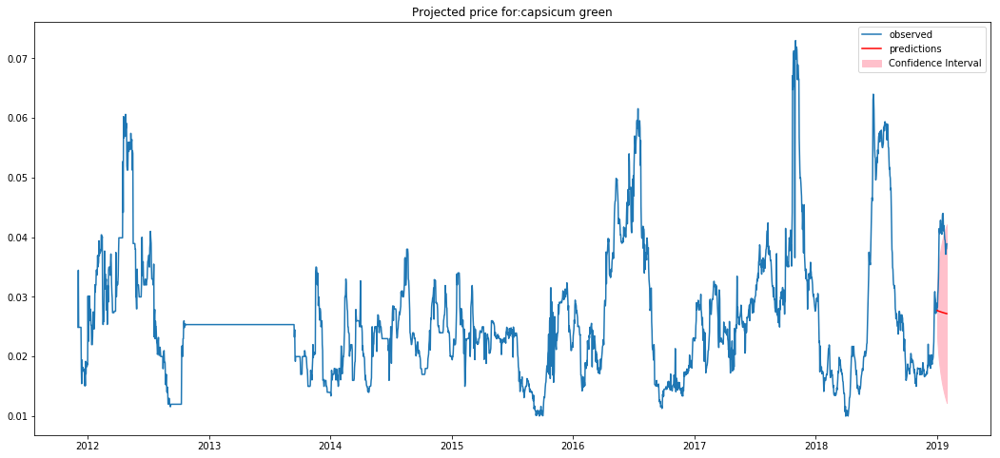

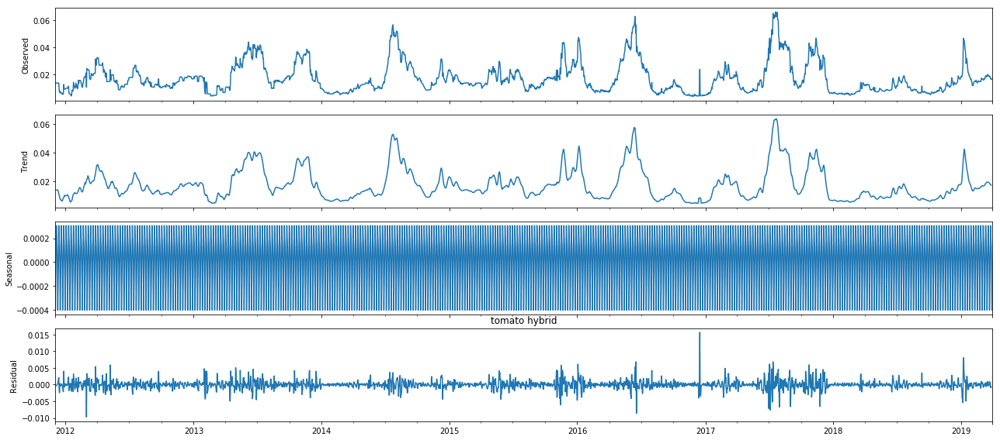



Test Statistic(More -ve, more stationary): -5.866996051572194


P-Value(If less than 0.05, reject null) 3.3075997435953514e-07
Reject Null Hypothesis(Series is non-stationary): True


/anaconda3/lib/python3.7/site-packages/statsmodels/tsa/base/tsa_model.py:165: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  % freq, ValueWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


RMSE: 1.476815196439561
MAE: 1.101109684163382




For SKU: Fresho potato 1 kg
Normalizing factor: 0.001
Product Group: potato
Model Parameters:
p: 1
d: 1
q: 2
ps: 0
ds: 0
qs: 0
trend: n
LOG: False
Average Cost Price: 19.79313527653214


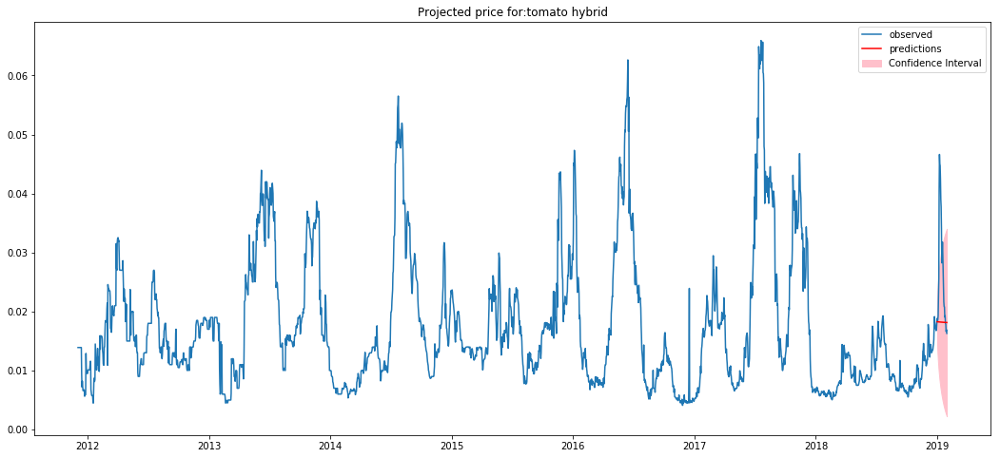

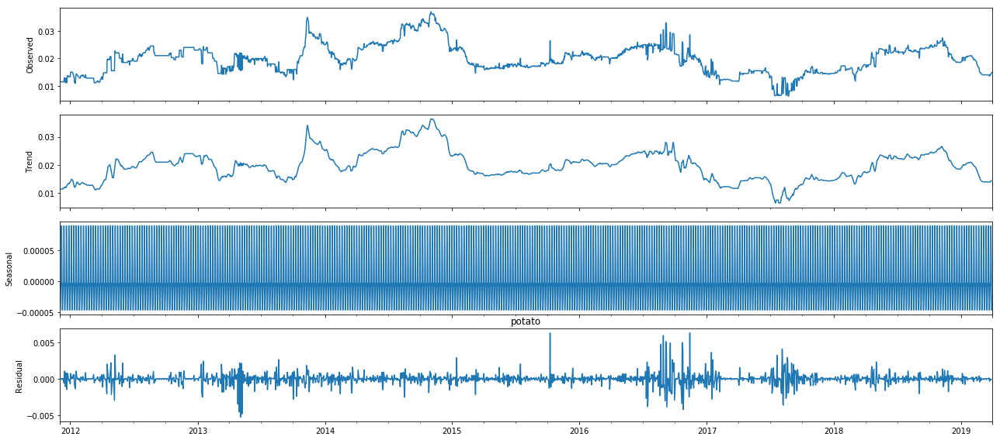



Test Statistic(More -ve, more stationary): -3.1360593021866316


P-Value(If less than 0.05, reject null) 0.023997194575536767
Reject Null Hypothesis(Series is non-stationary): True


/anaconda3/lib/python3.7/site-packages/statsmodels/tsa/base/tsa_model.py:165: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  % freq, ValueWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


RMSE: 20.968920190167587
MAE: 4.569356440366735




For SKU: Fresho cucumber-english 1 kg
Normalizing factor: 0.001
Product Group: cucumber english
Model Parameters:
p: 2
d: 0
q: 1
ps: 0
ds: 0
qs: 1
trend: c
LOG: True
Average Cost Price: 26.788165720405342


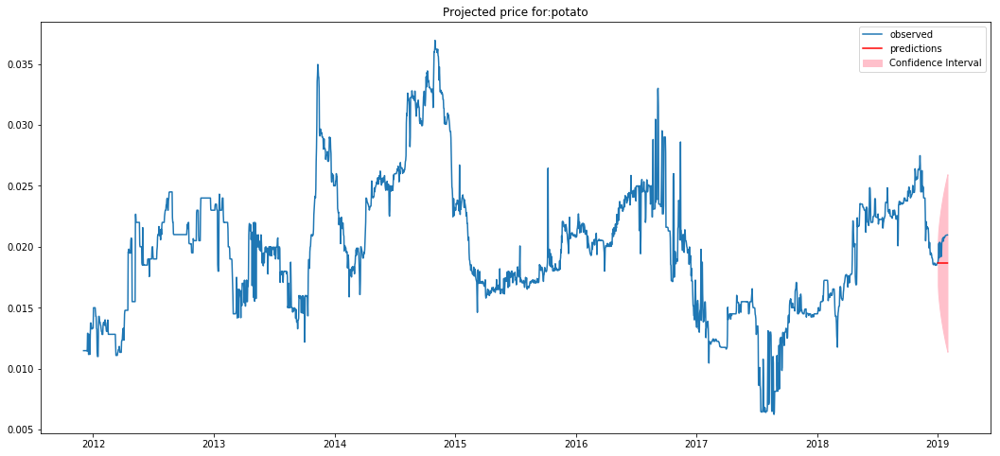

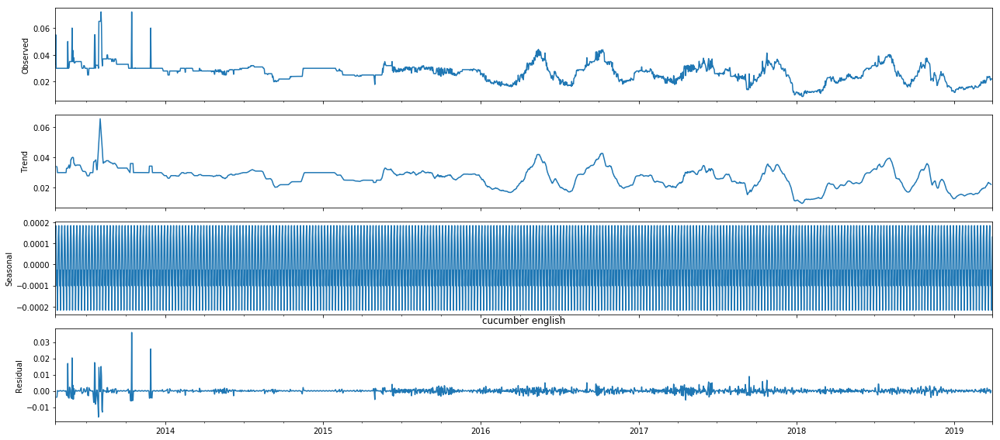



Test Statistic(More -ve, more stationary): -5.314505912662669


P-Value(If less than 0.05, reject null) 5.109253114512109e-06
Reject Null Hypothesis(Series is non-stationary): True


/anaconda3/lib/python3.7/site-packages/statsmodels/tsa/base/tsa_model.py:165: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  % freq, ValueWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/tsa/statespace/sarimax.py:949: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/anaconda3/lib/python3.7/site-packages/statsmodels/tsa/statespace/sarimax.py:961: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Log Mean: 2019-01-01   -3.960533
2019-01-02   -3.958180
2019-01-03   -3.955508
2019-01-04   -3.953237
2019-01-05   -3.950723
2019-01-06   -3.948537
2019-01-07   -3.946168
2019-01-08   -3.944068
2019-01-09   -3.941832
2019-01-10   -3.939818
2019-01-11   -3.937704
2019-01-12   -3.935775
2019-01-13   -3.933775
2019-01-14   -3.931930
2019-01-15   -3.930036
2019-01-16   -3.928273
2019-01-17   -3.926478
2019-01-18   -3.924794
2019-01-19   -3.923092
2019-01-20   -3.921484
2019-01-21   -3.919869
2019-01-22   -3.918336
2019-01-23   -3.916802
2019-01-24   -3.915340
2019-01-25   -3.913884
2019-01-26   -3.912491
2019-01-27   -3.911108
2019-01-28   -3.909780
2019-01-29   -3.908465
2019-01-30   -3.907200
Freq: D, dtype: float64
Exp Mean: 2019-01-01    0.019053
2019-01-02    0.019098
2019-01-03    0.019149
2019-01-04    0.019192
2019-01-05    0.019241
2019-01-06    0.019283
2019-01-07    0.019329
2019-01-08    0.019369
2019-01-09    0.019413
2019-01-10    0.019452
2019-01-11    0.019493
2019-01-12   

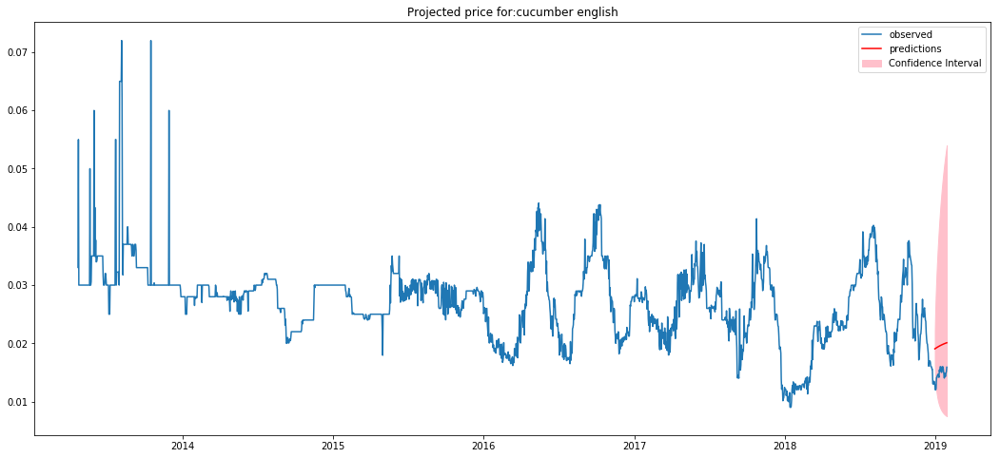

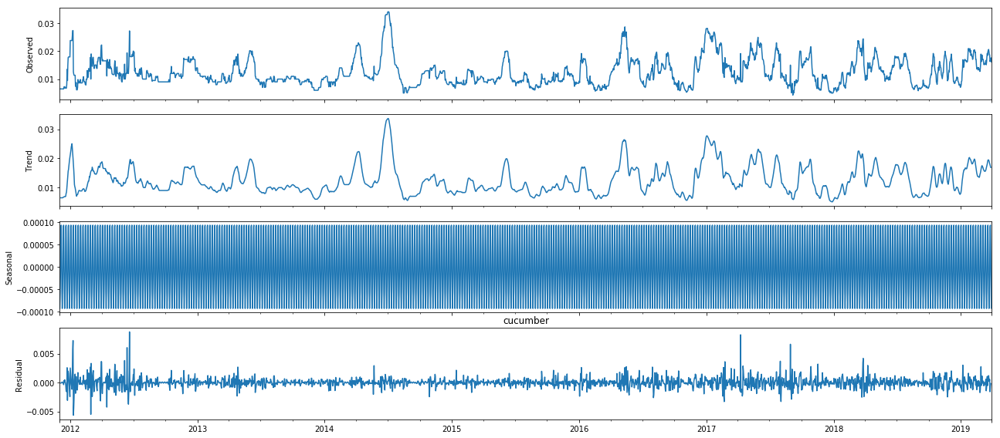



Test Statistic(More -ve, more stationary): -7.459873991172547


P-Value(If less than 0.05, reject null) 5.389147875862422e-11
Reject Null Hypothesis(Series is non-stationary): True


/anaconda3/lib/python3.7/site-packages/statsmodels/tsa/base/tsa_model.py:165: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  % freq, ValueWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Log Mean: 2019-01-01   -3.979686
2019-01-02   -3.980485
2019-01-03   -3.980778
2019-01-04   -3.980871
2019-01-05   -3.980885
2019-01-06   -3.980868
2019-01-07   -3.980838
2019-01-08   -3.980805
2019-01-09   -3.980769
2019-01-10   -3.980734
2019-01-11   -3.980698
2019-01-12   -3.980663
2019-01-13   -3.980628
2019-01-14   -3.980593
2019-01-15   -3.980559
2019-01-16   -3.980525
2019-01-17   -3.980491
2019-01-18   -3.980458
2019-01-19   -3.980425
2019-01-20   -3.980392
2019-01-21   -3.980360
2019-01-22   -3.980328
2019-01-23   -3.980296
2019-01-24   -3.980265
2019-01-25   -3.980234
2019-01-26   -3.980203
2019-01-27   -3.980173
2019-01-28   -3.980143
2019-01-29   -3.980113
2019-01-30   -3.980083
Freq: D, dtype: float64
Exp Mean: 2019-01-01    0.018692
2019-01-02    0.018677
2019-01-03    0.018671
2019-01-04    0.018669
2019-01-05    0.018669
2019-01-06    0.018669
2019-01-07    0.018670
2019-01-08    0.018671
2019-01-09    0.018671
2019-01-10    0.018672
2019-01-11    0.018673
2019-01-12   

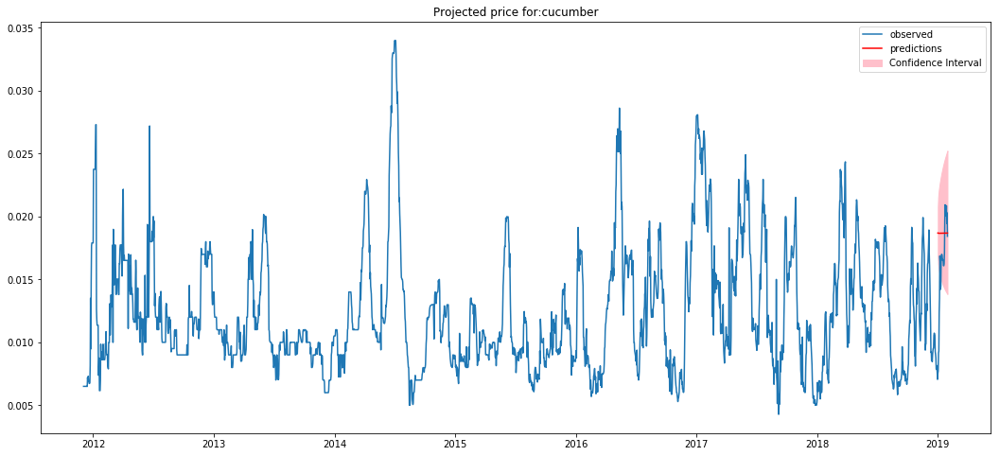

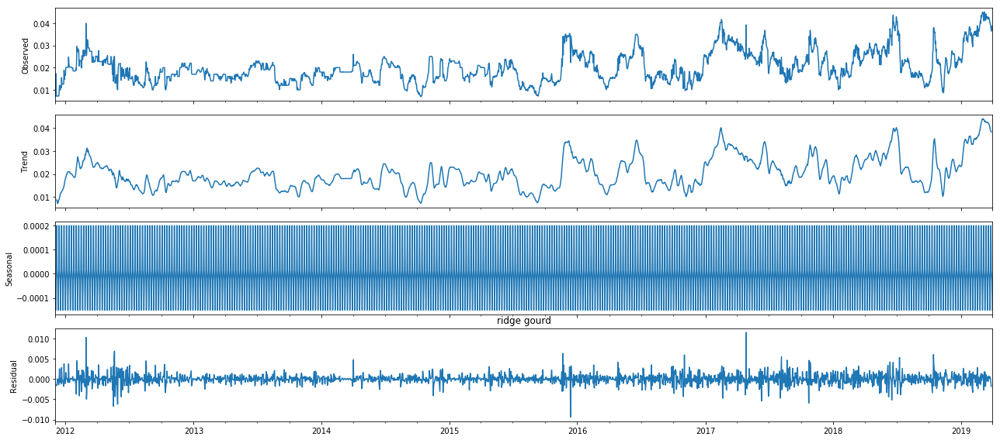



Test Statistic(More -ve, more stationary): -3.942627422861216


P-Value(If less than 0.05, reject null) 0.0017425936088421507
Reject Null Hypothesis(Series is non-stationary): True


/anaconda3/lib/python3.7/site-packages/statsmodels/tsa/base/tsa_model.py:165: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  % freq, ValueWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


RMSE: 363.15637755748503
MAE: 18.946189303144177




For SKU: Fresho ladies-finger 1 kg
Normalizing factor: 0.001
Product Group: ladies finger
Model Parameters:
p: 1
d: 0
q: 2
ps: 0
ds: 0
qs: 0
trend: c
LOG: False
Average Cost Price: 24.198768371214953


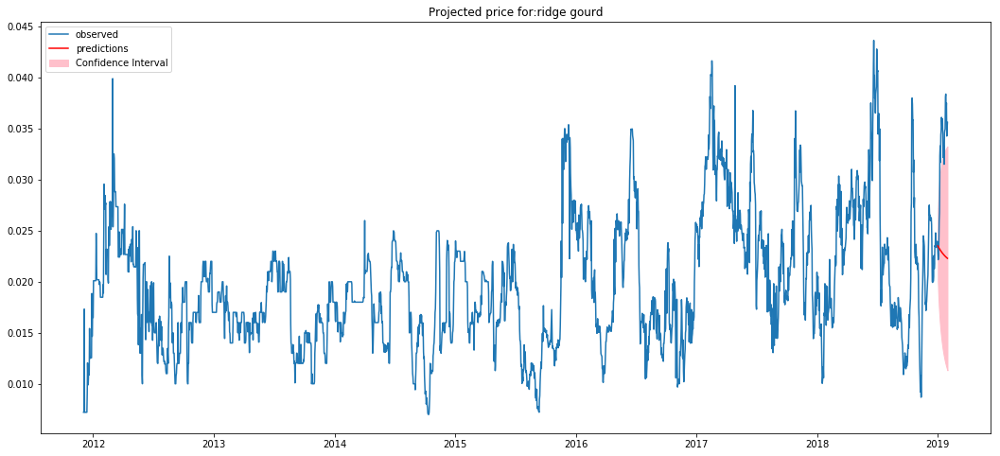

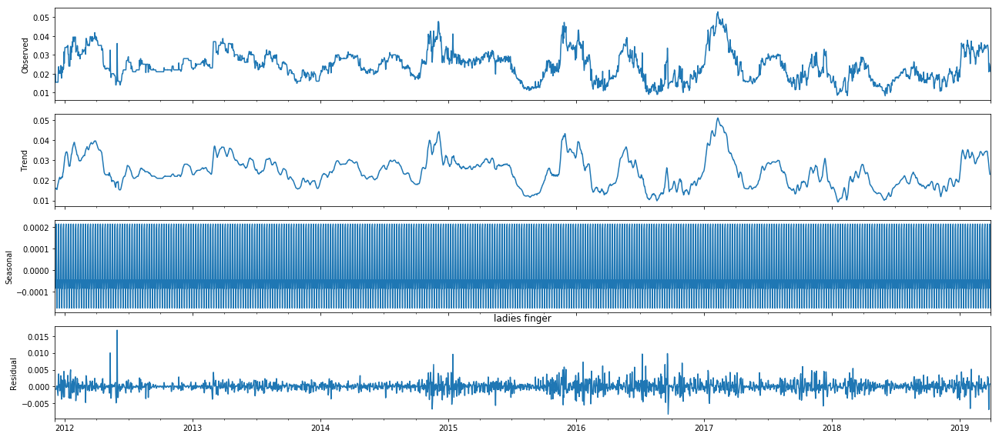



Test Statistic(More -ve, more stationary): -5.389884640255018


P-Value(If less than 0.05, reject null) 3.5569059145509054e-06
Reject Null Hypothesis(Series is non-stationary): True


/anaconda3/lib/python3.7/site-packages/statsmodels/tsa/base/tsa_model.py:165: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  % freq, ValueWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


RMSE: 106.98491944188633
MAE: 9.34472184393865




For SKU: Fresho banana-robusta 1 kg
Normalizing factor: 0.001
Product Group: banana robusta
Model Parameters:
p: 2
d: 1
q: 2
ps: 0
ds: 0
qs: 0
trend: n
LOG: False
Average Cost Price: 21.828481673644863


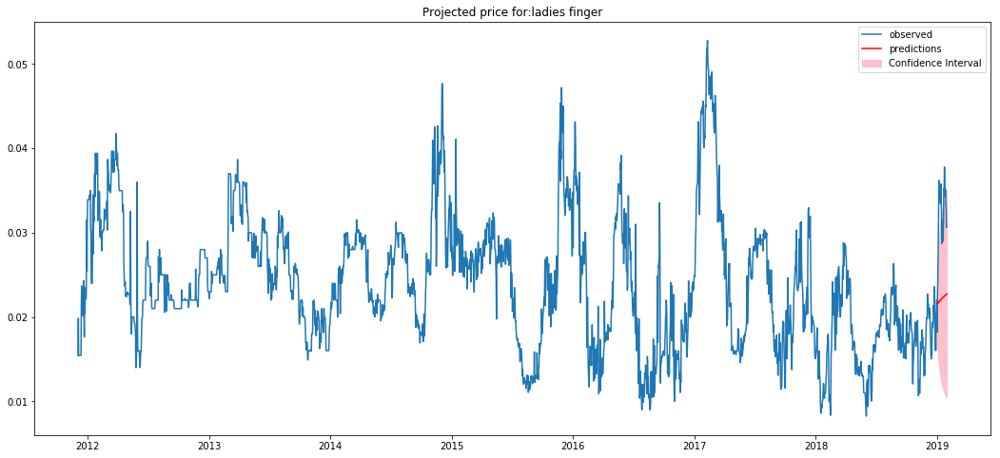

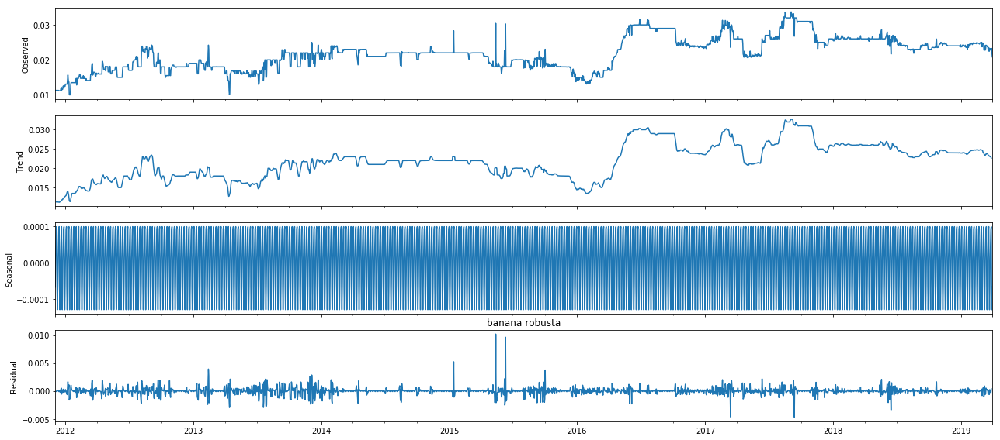



Test Statistic(More -ve, more stationary): -2.892951827629298


P-Value(If less than 0.05, reject null) 0.04617376439790287
Reject Null Hypothesis(Series is non-stationary): True


/anaconda3/lib/python3.7/site-packages/statsmodels/tsa/base/tsa_model.py:165: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  % freq, ValueWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


RMSE: 1.2628405386264303
MAE: 0.8951209449987527




For SKU: Fresho tomato-local 1 kg
Normalizing factor: 0.001
Product Group: tomato local
Model Parameters:
p: 2
d: 0
q: 1
ps: 0
ds: 0
qs: 0
trend: c
LOG: False
Average Cost Price: 17.92701054147982


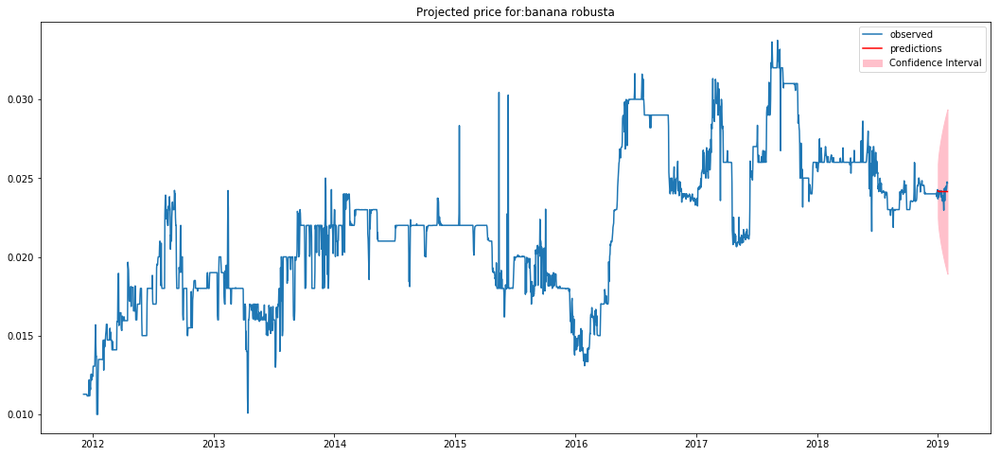

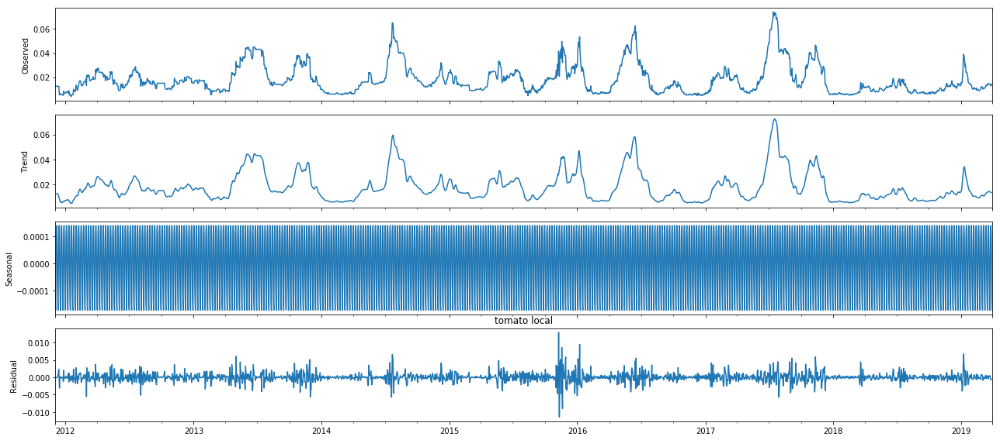



Test Statistic(More -ve, more stationary): -5.480300431288646


P-Value(If less than 0.05, reject null) 2.2923129533752914e-06
Reject Null Hypothesis(Series is non-stationary): True


/anaconda3/lib/python3.7/site-packages/statsmodels/tsa/base/tsa_model.py:165: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  % freq, ValueWarning)


RMSE: 2.5405072044159374
MAE: 1.2559375117194056




For SKU: Fresho bottle-gourd 1 kg
Normalizing factor: 0.001
Product Group: bottle gourd
Model Parameters:
p: 1
d: 0
q: 1
ps: 0
ds: 0
qs: 0
trend: c
LOG: True
Average Cost Price: 13.242073770553066


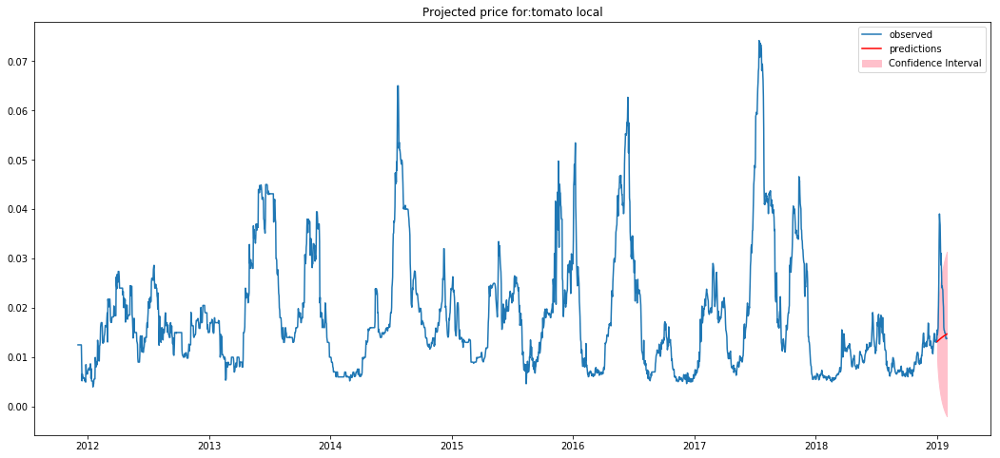

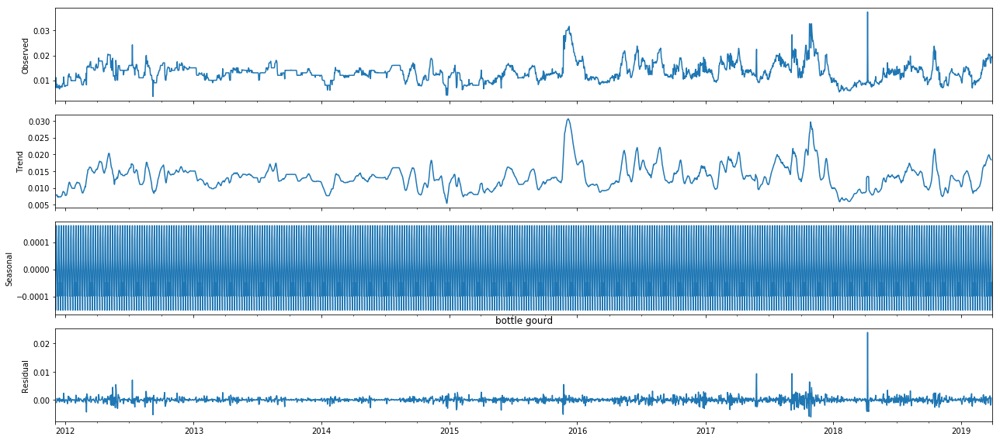



Test Statistic(More -ve, more stationary): -7.585925326878383


P-Value(If less than 0.05, reject null) 2.6069274206656233e-11
Reject Null Hypothesis(Series is non-stationary): True


/anaconda3/lib/python3.7/site-packages/statsmodels/tsa/base/tsa_model.py:165: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  % freq, ValueWarning)


Log Mean: 2019-01-01   -3.978863
2019-01-02   -3.978611
2019-01-03   -3.978363
2019-01-04   -3.978119
2019-01-05   -3.977880
2019-01-06   -3.977646
2019-01-07   -3.977416
2019-01-08   -3.977190
2019-01-09   -3.976968
2019-01-10   -3.976750
2019-01-11   -3.976537
2019-01-12   -3.976327
2019-01-13   -3.976122
2019-01-14   -3.975920
2019-01-15   -3.975722
2019-01-16   -3.975527
2019-01-17   -3.975336
2019-01-18   -3.975149
2019-01-19   -3.974965
2019-01-20   -3.974785
2019-01-21   -3.974608
2019-01-22   -3.974434
2019-01-23   -3.974263
2019-01-24   -3.974096
2019-01-25   -3.973932
2019-01-26   -3.973770
2019-01-27   -3.973612
2019-01-28   -3.973457
2019-01-29   -3.973304
2019-01-30   -3.973155
Freq: D, dtype: float64
Exp Mean: 2019-01-01    0.018707
2019-01-02    0.018712
2019-01-03    0.018716
2019-01-04    0.018721
2019-01-05    0.018725
2019-01-06    0.018730
2019-01-07    0.018734
2019-01-08    0.018738
2019-01-09    0.018742
2019-01-10    0.018746
2019-01-11    0.018750
2019-01-12   

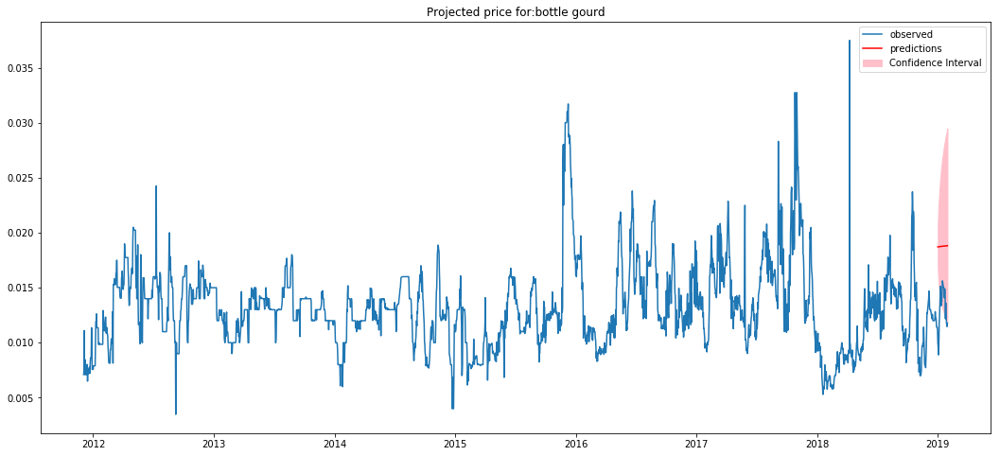

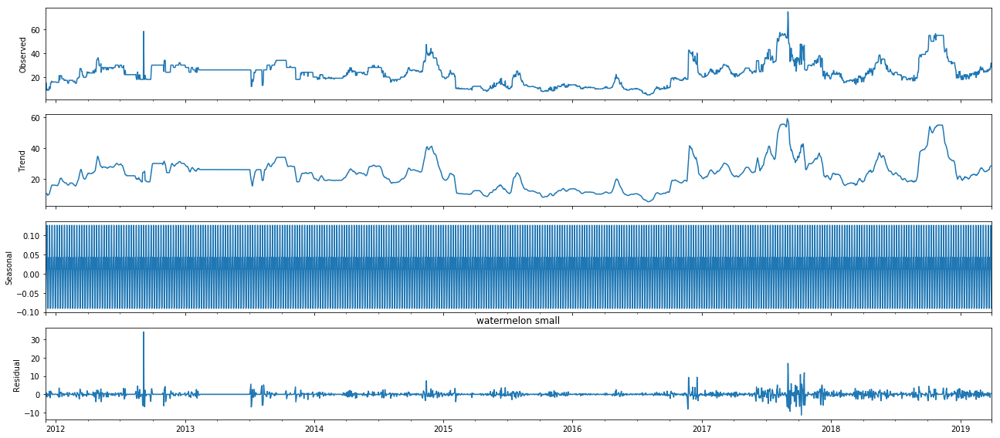



Test Statistic(More -ve, more stationary): -3.932587648800317


P-Value(If less than 0.05, reject null) 0.001807688326800827
Reject Null Hypothesis(Series is non-stationary): True


/anaconda3/lib/python3.7/site-packages/statsmodels/tsa/base/tsa_model.py:165: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  % freq, ValueWarning)


RMSE: 6.843723250951126
MAE: 1.9609331254505549




For SKU: Fresho beetroot 1 kg
Normalizing factor: 0.001
Product Group: beetroot
Model Parameters:
p: 1
d: 0
q: 2
ps: 0
ds: 0
qs: 0
trend: c
LOG: True
Average Cost Price: 19.203162278400598


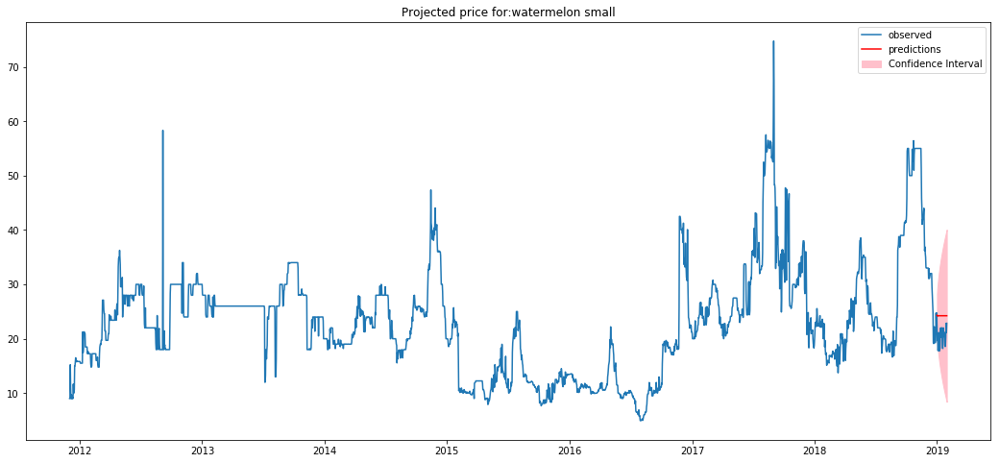

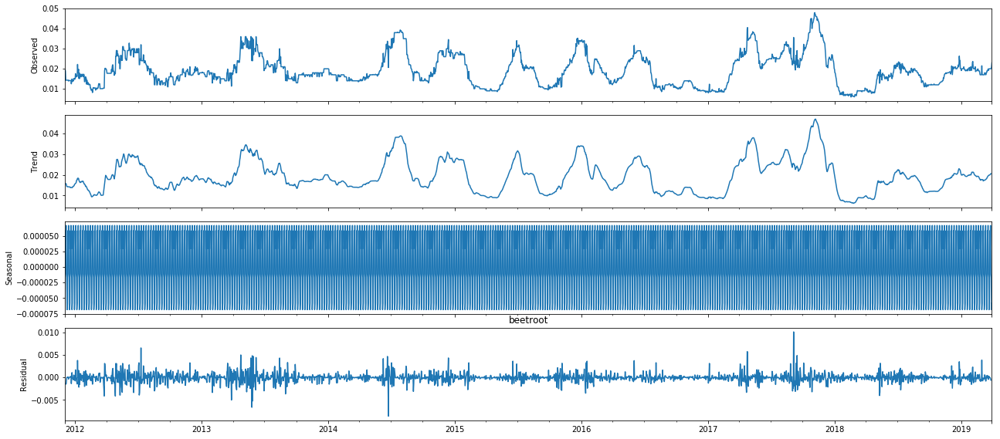



Test Statistic(More -ve, more stationary): -5.546773918182153


P-Value(If less than 0.05, reject null) 1.654053728045891e-06
Reject Null Hypothesis(Series is non-stationary): True


/anaconda3/lib/python3.7/site-packages/statsmodels/tsa/base/tsa_model.py:165: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  % freq, ValueWarning)
/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Log Mean: 2019-01-01   -3.978822
2019-01-02   -3.979186
2019-01-03   -3.978951
2019-01-04   -3.978720
2019-01-05   -3.978493
2019-01-06   -3.978268
2019-01-07   -3.978047
2019-01-08   -3.977829
2019-01-09   -3.977614
2019-01-10   -3.977402
2019-01-11   -3.977193
2019-01-12   -3.976987
2019-01-13   -3.976784
2019-01-14   -3.976584
2019-01-15   -3.976387
2019-01-16   -3.976193
2019-01-17   -3.976001
2019-01-18   -3.975813
2019-01-19   -3.975627
2019-01-20   -3.975443
2019-01-21   -3.975263
2019-01-22   -3.975084
2019-01-23   -3.974909
2019-01-24   -3.974736
2019-01-25   -3.974565
2019-01-26   -3.974397
2019-01-27   -3.974231
2019-01-28   -3.974068
2019-01-29   -3.973907
2019-01-30   -3.973748
Freq: D, dtype: float64
Exp Mean: 2019-01-01    0.018708
2019-01-02    0.018701
2019-01-03    0.018705
2019-01-04    0.018710
2019-01-05    0.018714
2019-01-06    0.018718
2019-01-07    0.018722
2019-01-08    0.018726
2019-01-09    0.018730
2019-01-10    0.018734
2019-01-11    0.018738
2019-01-12   

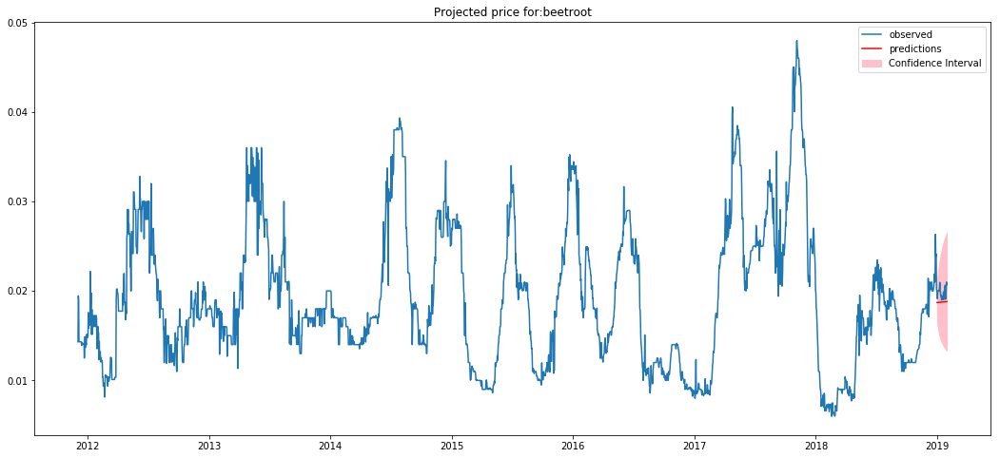

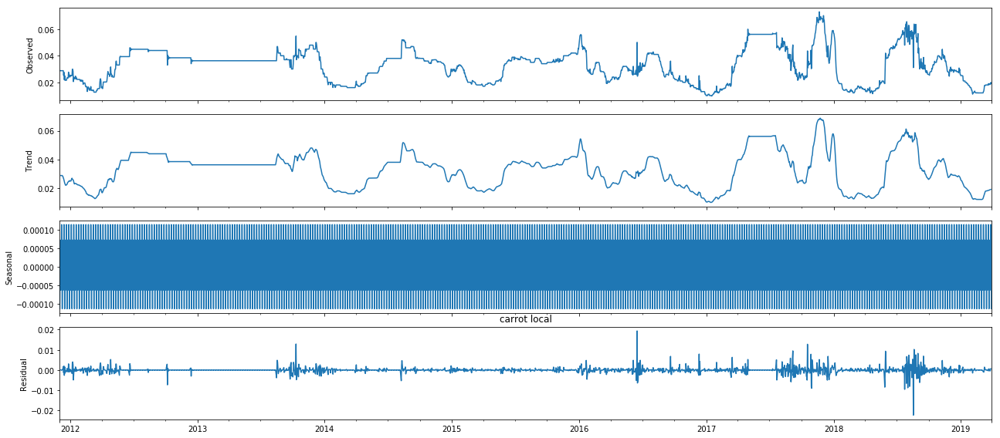



Test Statistic(More -ve, more stationary): -4.685255269390687


P-Value(If less than 0.05, reject null) 8.968684775088775e-05
Reject Null Hypothesis(Series is non-stationary): True


/anaconda3/lib/python3.7/site-packages/statsmodels/tsa/base/tsa_model.py:165: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  % freq, ValueWarning)


Log Mean: 2019-01-01   -3.978474
2019-01-02   -3.978474
2019-01-03   -3.978474
2019-01-04   -3.978474
2019-01-05   -3.978474
2019-01-06   -3.978474
2019-01-07   -3.978474
2019-01-08   -3.978474
2019-01-09   -3.978474
2019-01-10   -3.978474
2019-01-11   -3.978474
2019-01-12   -3.978474
2019-01-13   -3.978474
2019-01-14   -3.978474
2019-01-15   -3.978474
2019-01-16   -3.978474
2019-01-17   -3.978474
2019-01-18   -3.978474
2019-01-19   -3.978474
2019-01-20   -3.978474
2019-01-21   -3.978474
2019-01-22   -3.978474
2019-01-23   -3.978474
2019-01-24   -3.978474
2019-01-25   -3.978474
2019-01-26   -3.978474
2019-01-27   -3.978474
2019-01-28   -3.978474
2019-01-29   -3.978474
2019-01-30   -3.978474
Freq: D, dtype: float64
Exp Mean: 2019-01-01    0.018714
2019-01-02    0.018714
2019-01-03    0.018714
2019-01-04    0.018714
2019-01-05    0.018714
2019-01-06    0.018714
2019-01-07    0.018714
2019-01-08    0.018714
2019-01-09    0.018714
2019-01-10    0.018714
2019-01-11    0.018714
2019-01-12   

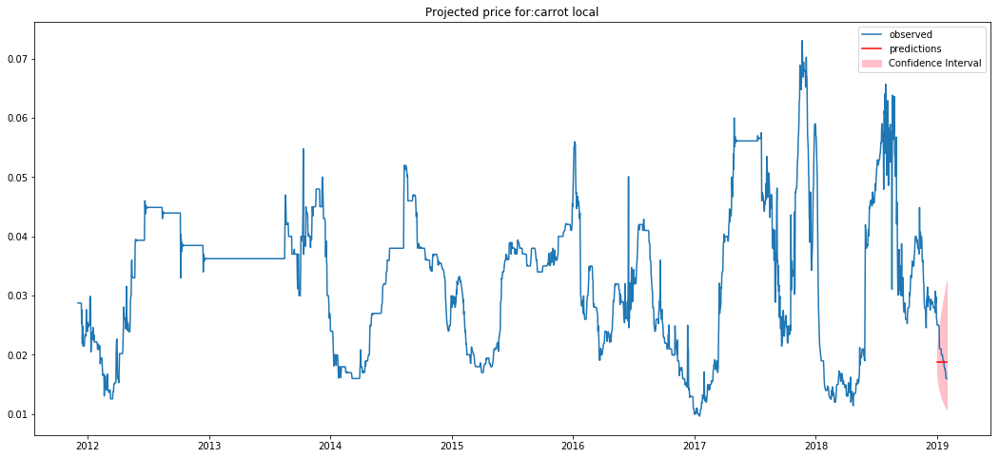

In [101]:
#List to store SKU names of all SKUs for which model has been built
SKU_list = []
#List to store predicted prices of all SKUs for which model has been built
predicted_prices = []
#List to store actual prices of all SKUs for which model has been built
actual_prices = []
#List to store RMSE scores of all SKUs for which model has been built
RMSE_scores = []
#List to store MAE scores of all SKUs for which model has been built
MAE_scores = []
#List to store last 30 dates of all SKUs for which model has been built
dates_list = []

num_observations = []

avg_prices = []
columns_needed = ['cp','Normalized Price','CPI_FB_Vegetables', 'temp_avg_max', 'temp_avg_min','rainfall(mm)']

columns = ['CPI_FB_Vegetables', 'temp_avg_max', 'temp_avg_min','rainfall(mm)']

count = 0
#Iterating over all the SKUs
#Here, I've iterated over the product 'splits', as it makes it easier to obtain normalizing factor
for i,prod in enumerate(unique_products_split):
    #Storing the split priduct in a variable
    selected_sku = prod
    
    #Obtaining the actual name of the SKU
    actual_prod = unique_products[i]
    print("For SKU:",actual_prod)
    
    #Calling the method to obtain the forecast
    cost_price_predictions,actual_price,dates,number_of_observations,avg_price = get_forecast_optimized(selected_sku,actual_prod)
    
    if len(cost_price_predictions) == 30:
        
        rmse = mean_squared_error(actual_price,cost_price_predictions)
        print("RMSE:",rmse)
        
        mae = mean_absolute_error(actual_price,cost_price_predictions)
        print("MAE:",mae)
        #Storing the last 30 dates of the SKU for which we have obtained the forecast
        dates_list.append(dates)
        #Storing the name of the SKU for which we have obtained the forecast
        SKU_list.append(actual_prod)
        #Storing the predicted prices of the SKU for which we have obtained the forecast
        predicted_prices.append(cost_price_predictions)
        #Storing the RMSE of the SKU for which we have obtained the forecast
        RMSE_scores.append(rmse)
        #Storing the MAE of the SKU for which we have obtained the forecast
        MAE_scores.append(mae)
        #Storing the actual price of the SKU for which we have obtained the forecast
        actual_prices.append(actual_price)
        
        num_observations.append(number_of_observations)
        
        avg_prices.append(avg_price)
    
    print('\n\n\n')

In [102]:
sku_avg_30_day_price = []
for sku in SKU_list:
    avg_price_sku = np.average((df_all[df_all['sku_description']==sku]['cp'][-90:-60]))
    sku_avg_30_day_price.append(avg_price_sku)

In [103]:
MAPE = []
for i,prices in enumerate(actual_prices):
    diff = abs((actual_prices[i] - predicted_prices[i])/(actual_prices[i]))
    sum_diff = np.sum(diff)
    MAPE.append(sum_diff/30)

In [110]:
normalized_rmse = (np.array(RMSE_scores)/np.array(sku_avg_30_day_price))
df_summary_optimized_metrics = pd.DataFrame({'SKU':SKU_list,'RMSE':RMSE_scores,'Normalized RMSE':normalized_rmse,'Mean Absolute Error':MAE_scores,'Mean Absolute Percentage Error':MAPE,'Observations used':num_observations})
df_summary_optimized_metrics.sort_values(by=['Mean Absolute Percentage Error'],ascending=True,inplace=True)
df_summary_optimized_metrics.style

,SKU,RMSE,Normalized RMSE,Mean Absolute Error,Mean Absolute Percentage Error,Observations used
1,Fresho banana-yelakki 1 kg,1.65868,0.0453356,1.18243,0.0310993,2676
9,Fresho banana-robusta 1 kg,1.26284,0.0526176,0.895121,0.0392734,2675
3,Fresho tomato-hybrid 1 kg,1.47682,0.0546483,1.10111,0.0624178,2676
13,Fresho beetroot 1 kg,2.41261,0.121993,1.3391,0.070776,2676
12,Fresho watermelon-small 1 pc 1.7 - 2.5 kg,6.84372,0.335971,1.96093,0.0711313,2676
5,Fresho cucumber-english 1 kg,4.55568,0.311046,1.72734,0.0787865,2171
11,Fresho bottle-gourd 1 kg,3.7758,0.28779,1.47608,0.089378,2676
10,Fresho tomato-local 1 kg,2.54051,0.115756,1.25594,0.108066,2676
6,Fresho cucumber 1 kg,4.56142,0.282522,1.84293,0.112509,2676
14,Fresho carrot-local 1 kg,10.384,0.510446,2.0685,0.154491,2676


In [111]:
df_summary_optimized_metrics.to_csv("/Users/vegi/Documents/USC_Masters/ML/DemandForecasts/df_summary_optimized_metrics.csv", sep=",", float_format='%.6f',index=False, line_terminator='\n',encoding='utf-8')